### MAIN CODE LOOP

In [2]:
import os
import numpy as np
from tqdm.notebook import tqdm
import pandas as pd
from scipy import stats
import numpy as np
# normalize the Hr data
from sklearn.preprocessing import MinMaxScaler,PowerTransformer,StandardScaler
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.pyplot as plt
import os
from tqdm import tqdm
from tqdm import tqdm_notebook as tqdm
import scipy.stats as stats

In [3]:
# create a directory to store the generated files
try:
    os.makedirs("../generated_data/train/", exist_ok=True)
    os.makedirs("../generated_data/test/", exist_ok=True)
    
    os.makedirs("../generated_data/train/Hr", exist_ok=True)
    os.makedirs("../Archive/generated_data/test/Hr", exist_ok=True)
    
    os.makedirs("../generated_data/train/HaHb", exist_ok=True)
    os.makedirs("../generated_data/test/HaHb", exist_ok=True)
    print("Directory created successfully or already exists.")
except Exception as e:
    print(f"Error creating directory: {e}")

Directory created successfully or already exists.


In [6]:
def get_HaHb_array(data,hydropathy_scale):
    HaHb_list = []
    #print(len(HaHb_list))
    # For one scale get all HaHb values
    # iterate over the dataset
    for i in range(data.shape[0]):
        row = data.iloc[i]
        resA_ = row['resA']
        resB_ = row['resB']
        resB_1 = row['resB_1']
        resB_2 = row['resB_2']
        resB_3 = row['resB_3']
        resB_4 = row['resB_4']
        resB_5 = row['resB_5']
        resB_6 = row['resB_6']
        resB_7 = row['resB_7']
        resB_8 = row['resB_8']
        resB_9 = row['resB_9']

        # get values from the scale
        resA_scale_value = hydropathy_scale[resA_].iloc[0]
        resB_scale_value = hydropathy_scale[resB_].iloc[0]
        resB_1_scale_value = hydropathy_scale[resB_1].iloc[0]
        resB_2_scale_value = hydropathy_scale[resB_2].iloc[0]
        resB_3_scale_value = hydropathy_scale[resB_3].iloc[0]
        resB_4_scale_value = hydropathy_scale[resB_4].iloc[0]
        resB_5_scale_value = hydropathy_scale[resB_5].iloc[0]
        resB_6_scale_value = hydropathy_scale[resB_6].iloc[0]
        resB_7_scale_value = hydropathy_scale[resB_7].iloc[0]
        resB_8_scale_value = hydropathy_scale[resB_8].iloc[0]
        resB_9_scale_value = hydropathy_scale[resB_9].iloc[0]

        # calculate HaHb values
        currentcombination = [resA_scale_value*resB_scale_value, 
        resA_scale_value*resB_1_scale_value, 
        resA_scale_value*resB_2_scale_value, 
        resA_scale_value*resB_3_scale_value, 
        resA_scale_value*resB_4_scale_value, 
        resA_scale_value*resB_5_scale_value, 
        resA_scale_value*resB_6_scale_value, 
        resA_scale_value*resB_7_scale_value, 
        resA_scale_value*resB_8_scale_value, 
        resA_scale_value*resB_9_scale_value]

        HaHb_list.append(currentcombination)
    return np.array(HaHb_list)

In [7]:
def get_values_for_ab(HaHb_max):
    a = 4 / (HaHb_max ** 2)
    b = 4 / HaHb_max
    return a,b

In [9]:
# read the main dataset
filename = "../dataset/train/dataset.txt"
dataset = pd.read_csv(filename)

# drop the pdb column
data_train= dataset.drop(columns=['pdb'], axis=1)

In [10]:
# read the test dataset
# read the main dataset
filename = "../dataset/test/dataset.txt"
dataset_test = pd.read_csv(filename)

# drop the pdb column
data_test = dataset_test.drop(columns=['pdb'], axis=1)
print(data_test.shape)
data_test.head()

(1282, 11)


,resA,resB,resB_1,resB_2,resB_3,resB_4,resB_5,resB_6,resB_7,resB_8,resB_9
0,HIS,HIS,THR,GLN,ASP,LEU,ILE,PRO,TYR,VAL,ARG
1,GLU,GLY,PRO,SER,GLU,PHE,LEU,TYR,THR,GLU,ARG
2,PHE,VAL,ILE,SER,LEU,VAL,ASP,GLU,PHE,ILE,GLU
3,GLU,LYS,LEU,LEU,ALA,ARG,GLU,GLU,LEU,ASP,ASP
4,GLY,THR,GLU,ARG,PHE,THR,ARG,GLN,PHE,SER,LEU


In [11]:
data_test_no_header = data_test.iloc[1:].reset_index(drop=True)

# Concatenate without reintroducing headers
data_combined = pd.concat([data_train, data_test_no_header], axis=0, ignore_index=True)



# Print shape and preview
print(data_combined.shape)
data_combined.head()

(4271, 11)


,resA,resB,resB_1,resB_2,resB_3,resB_4,resB_5,resB_6,resB_7,resB_8,resB_9
0,TRP,LEU,LEU,ILE,TRP,MET,ILE,TYR,LYS,ILE,TRP
1,THR,HIS,GLY,GLY,VAL,THR,GLY,VAL,ILE,THR,ASP
2,LYS,HIS,ASP,THR,GLU,LYS,ARG,TYR,GLU,LEU,ASN
3,LYS,HIS,PHE,CYS,PHE,THR,CYS,TRP,GLU,GLY,ASN
4,VAL,LEU,ALA,LYS,LEU,VAL,GLU,LEU,ASP,SER,SER


In [ ]:
# loop through hydropathy folder and pick scale one by one, generate HaHb values and save them in a list
# iterate over the directory
directory = "../hydropathy/"


for file_path in tqdm(os.listdir(directory)):

    # ----------------------------------------------------------------------------
    # calculate HaHb
    # final list to save the HaHb values
    HaHb_list = []

    hydropathy_scale = pd.read_csv(directory + file_path,header = None)
    hydropathy_scale.columns = ['aa', 'hydropathy']

    # typecast hydropathy values to float
    hydropathy_scale['hydropathy'] = hydropathy_scale['hydropathy'].astype(float)

    hydropathy_scale = hydropathy_scale.T
    # make first row as header
    new_header = hydropathy_scale.iloc[0]
    hydropathy_scale = hydropathy_scale[1:]
    hydropathy_scale.columns = new_header
    hydropathy_scale.reset_index(drop=True, inplace=True)
    #print("train")
    # for training data
    HaHb_train = get_HaHb_array(data_train,hydropathy_scale)

    #print("test")
    # for test data
    HaHb_test = get_HaHb_array(data_test,hydropathy_scale)
    
    #print("combined")
    # for a,b calculation
    HaHb_combined = get_HaHb_array(data_combined,hydropathy_scale)
    #print(HaHb.shape)
    HaHb_min = np.min(HaHb_combined)
    HaHb_max = np.max(HaHb_combined)
   
    try:
        # pre normalization
        a, b= get_values_for_ab(HaHb_max)
        
        # saving value to print later
        a_, b_ = get_values_for_ab(HaHb_max)

    except np.linalg.LinAlgError as e:
        print(f"Processing file: {directory+file_path}")
        print(f"Error calculating values for a, b: {e}")
        print("Skipping this iteration due to singular matrix.")
        #print(HaHb)
        continue
    
    # get Hr values
    Hr_train= np.array(list(map(lambda HaHb_train: (-a * (HaHb_train ** 2)) + ((b * HaHb_train)), HaHb_train.flatten()))).reshape(HaHb_train.shape)
    Hr_test = np.array(list(map(lambda HaHb_test: (-a * (HaHb_test ** 2)) + ((b * HaHb_test)), HaHb_test.flatten()))).reshape(HaHb_test.shape) 
    
    # save train hr files
    file_name = file_path.replace('.csv', '')
    np.savetxt(f"../generated_data/train/HaHb/{file_name}.txt", HaHb_train)
    np.savetxt(f"../generated_data/train/Hr/{file_name}.txt", Hr_train)
    # save test hr files
    np.savetxt(f"../generated_data/test/HaHb/{file_name}.txt", HaHb_test)
    np.savetxt(f"../generated_data/test/Hr/{file_name}.txt", Hr_test)
    
    if HaHb_min <= 0.0:
        HaHb_combined = HaHb_combined + (0 - HaHb_min)
        HaHb_test = HaHb_test + (0 - HaHb_min)
        HaHb_train = HaHb_train + (0 - HaHb_min)
        HaHb_max = np.max(HaHb_combined)
    
    try:
        # pre normalization
        a, b= get_values_for_ab(HaHb_max)
        
        # saving value to print later
        a_, b_ = get_values_for_ab(HaHb_max)

    except np.linalg.LinAlgError as e:
        print(f"Processing file: {directory+file_path}")
        print(f"Error calculating values for a, b: {e}")
        print("Skipping this iteration due to singular matrix.")
        #print(HaHb)
        continue
    
    # get Hr values
    Hr_train= np.array(list(map(lambda HaHb_train: (-a * (HaHb_train ** 2)) + ((b * HaHb_train)), HaHb_train.flatten()))).reshape(HaHb_train.shape)
    Hr_test = np.array(list(map(lambda HaHb_test: (-a * (HaHb_test ** 2)) + ((b * HaHb_test)), HaHb_test.flatten()))).reshape(HaHb_test.shape)

    # normalize the Hr values
    #Hr_train_norm = scaler.fit_transform(Hr_train)
    #Hr_test_norm = scaler.fit_transform(Hr_test)

    # save train hr files
    file_name = file_path.replace('.csv', '')
    np.savetxt(f"../generated_data/train/HaHb_modified/{file_name}.txt", HaHb_train)
    np.savetxt(f"../generated_data/train/Hr_modified/{file_name}.txt", Hr_train)
    # save test hr files
    np.savetxt(f"../generated_data/test/HaHb_modified/{file_name}.txt", HaHb_test)
    np.savetxt(f"../generated_data/test/Hr_modified/{file_name}.txt", Hr_test)

Found 28 common data files to process


Processing files:   0%|                                                                         | 0/28 [00:00<?, ?it/s]

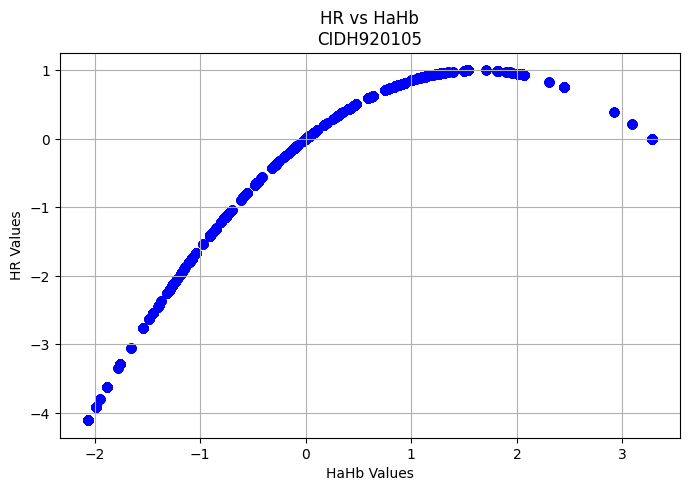

Processing files:   4%|██▎                                                              | 1/28 [00:01<00:48,  1.78s/it]

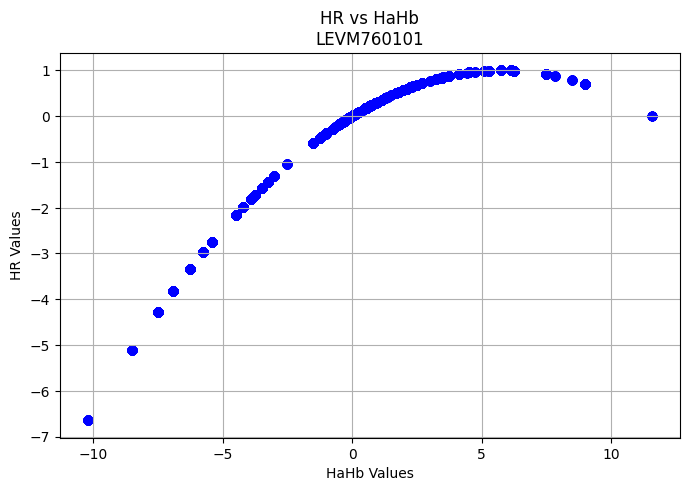

Processing files:   7%|████▋                                                            | 2/28 [00:02<00:36,  1.41s/it]

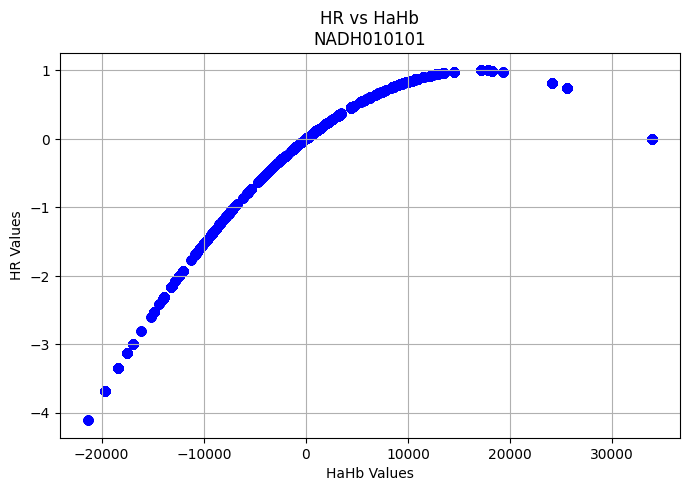

Processing files:  11%|██████▉                                                          | 3/28 [00:04<00:32,  1.28s/it]

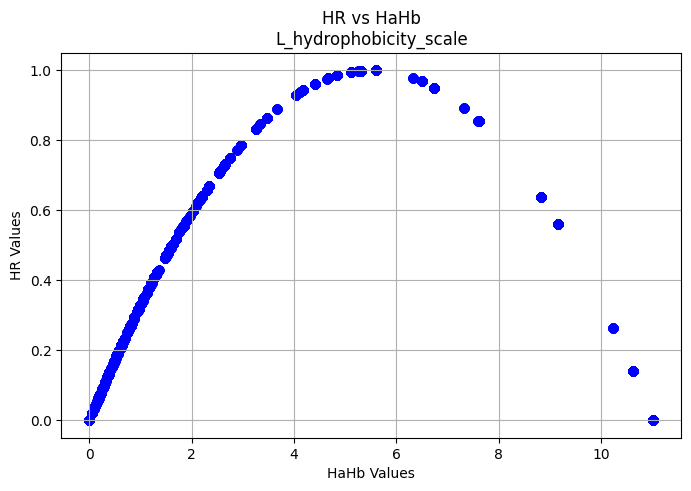

Processing files:  14%|█████████▎                                                       | 4/28 [00:05<00:31,  1.31s/it]

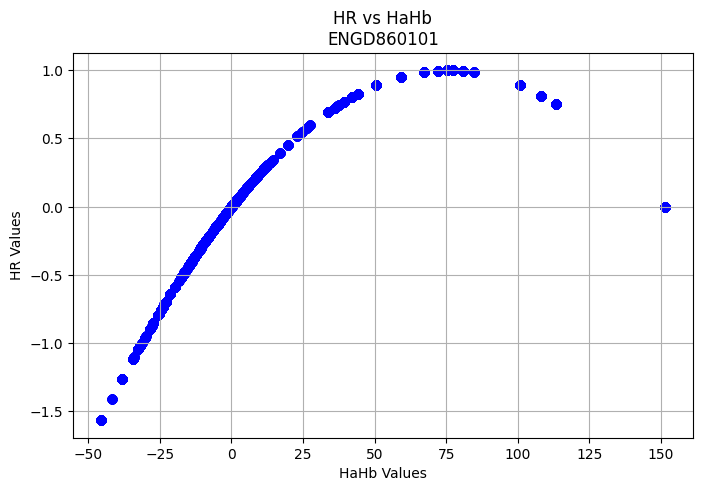

Processing files:  18%|███████████▌                                                     | 5/28 [00:06<00:28,  1.25s/it]

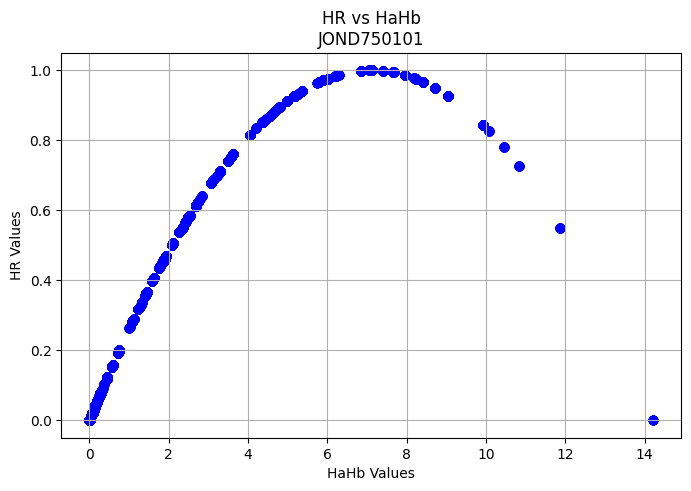

Processing files:  21%|█████████████▉                                                   | 6/28 [00:07<00:28,  1.31s/it]

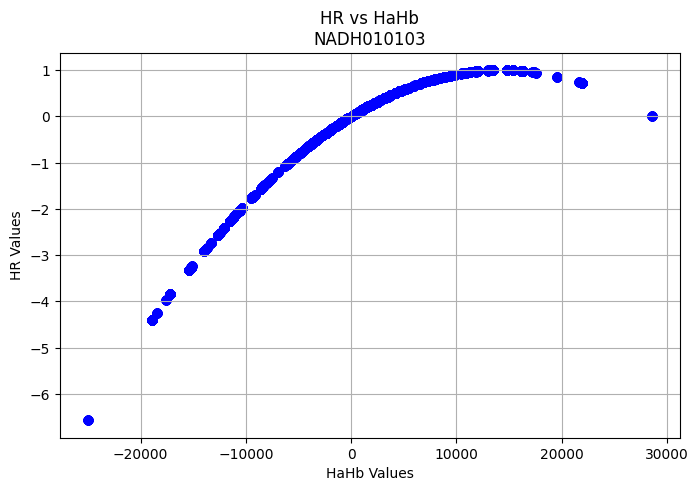

Processing files:  25%|████████████████▎                                                | 7/28 [00:09<00:27,  1.31s/it]

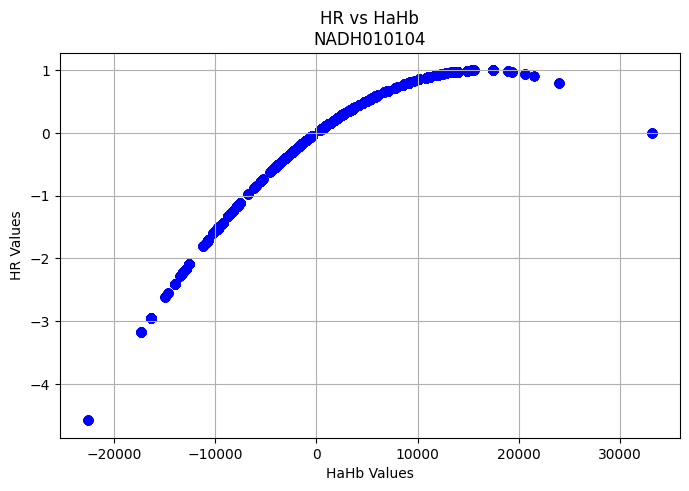

Processing files:  29%|██████████████████▌                                              | 8/28 [00:10<00:25,  1.27s/it]

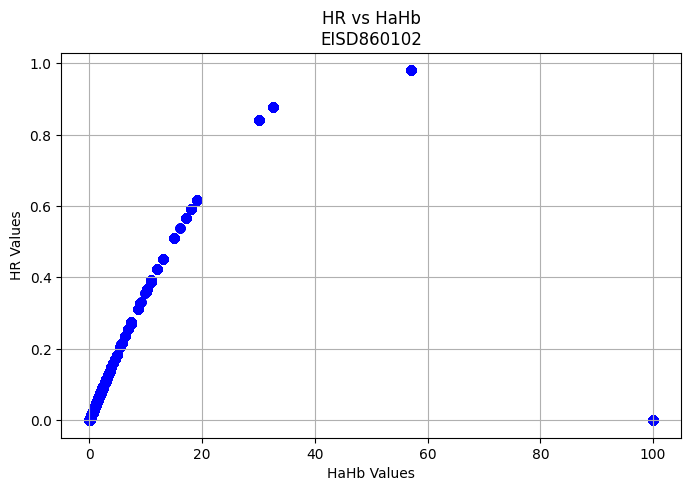

Processing files:  32%|████████████████████▉                                            | 9/28 [00:11<00:23,  1.25s/it]

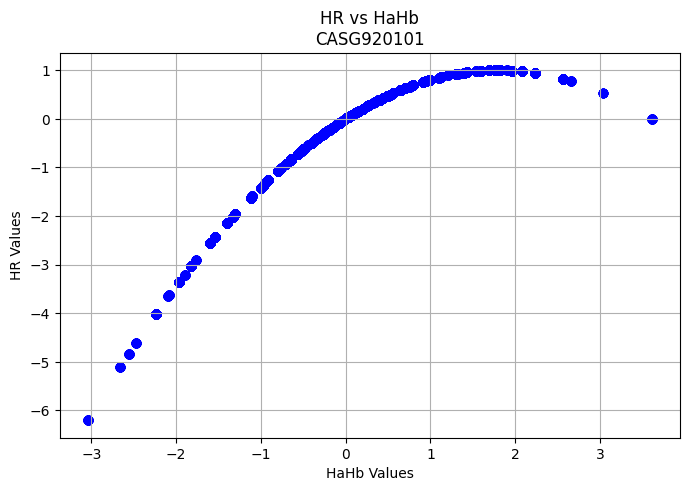

Processing files:  36%|██████████████████████▊                                         | 10/28 [00:12<00:22,  1.27s/it]

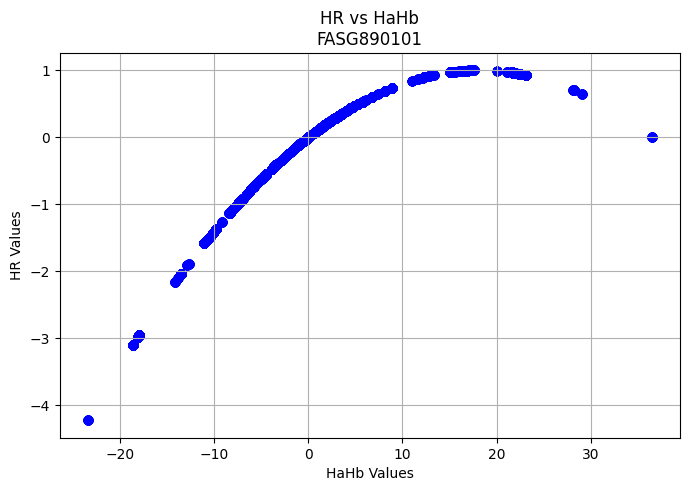

Processing files:  39%|█████████████████████████▏                                      | 11/28 [00:14<00:21,  1.28s/it]

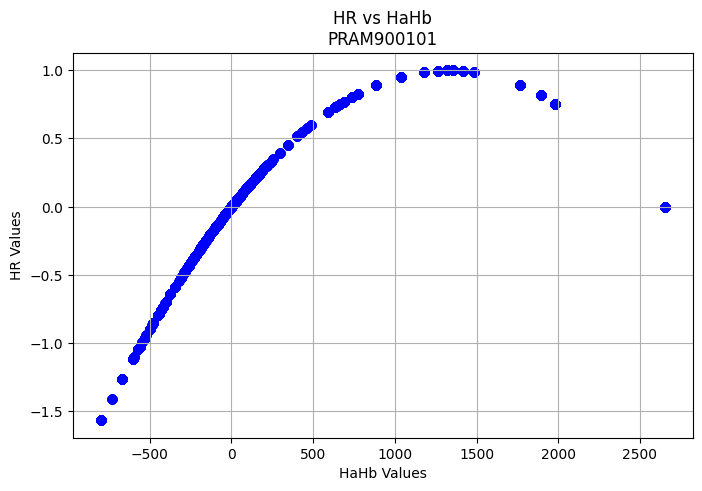

Processing files:  43%|███████████████████████████▍                                    | 12/28 [00:15<00:20,  1.27s/it]

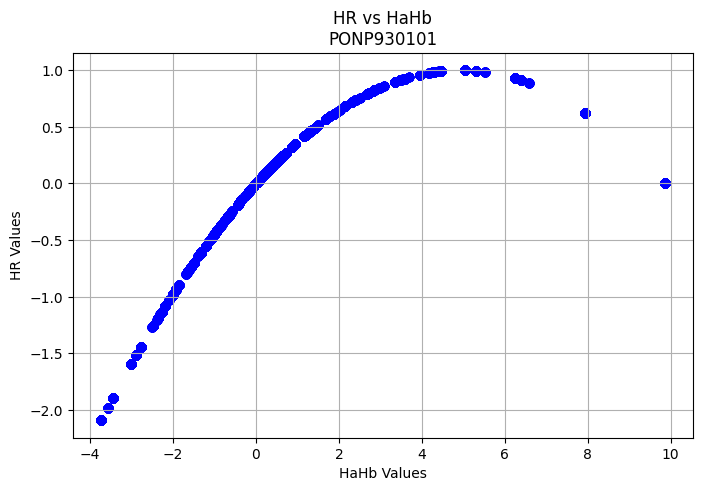

Processing files:  46%|█████████████████████████████▋                                  | 13/28 [00:16<00:18,  1.24s/it]

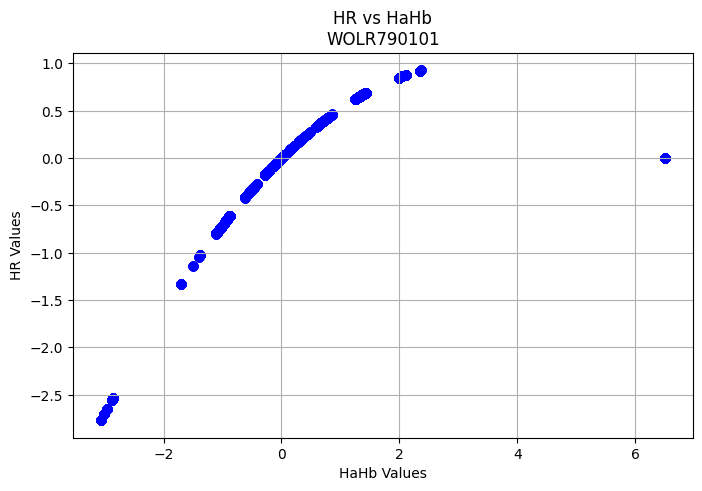

Processing files:  50%|████████████████████████████████                                | 14/28 [00:18<00:17,  1.26s/it]

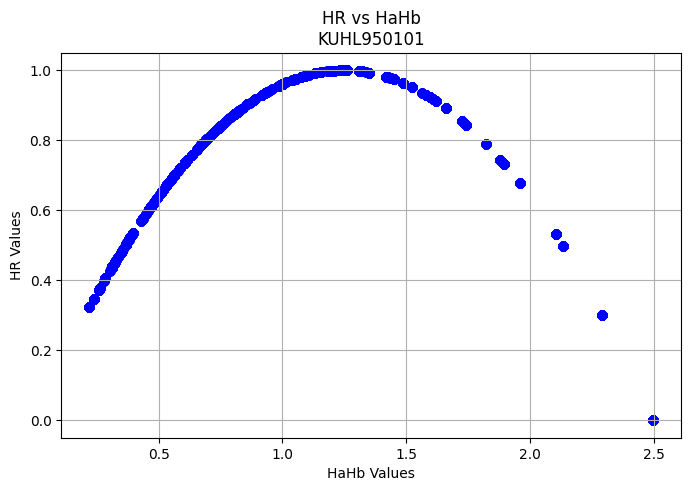

Processing files:  54%|██████████████████████████████████▎                             | 15/28 [00:19<00:16,  1.27s/it]

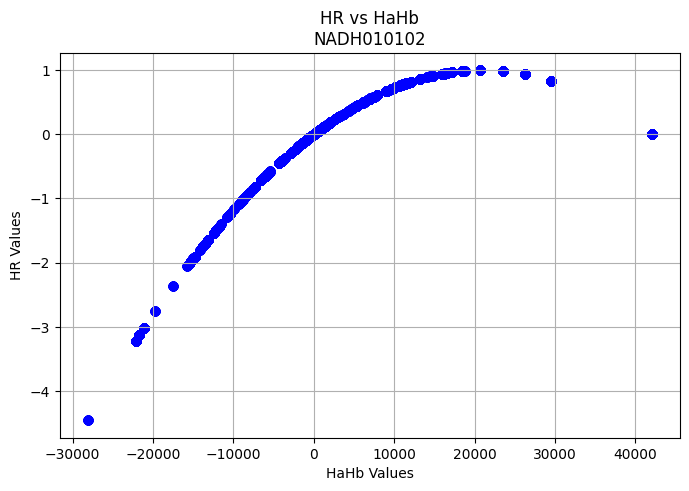

Processing files:  57%|████████████████████████████████████▌                           | 16/28 [00:20<00:14,  1.21s/it]

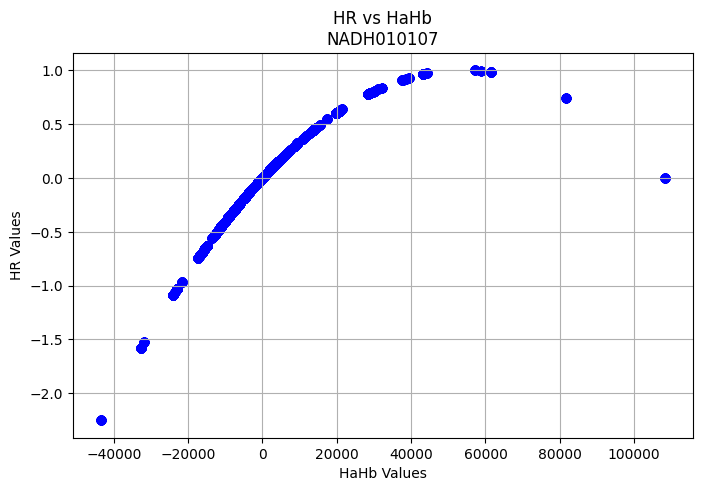

Processing files:  61%|██████████████████████████████████████▊                         | 17/28 [00:21<00:14,  1.28s/it]

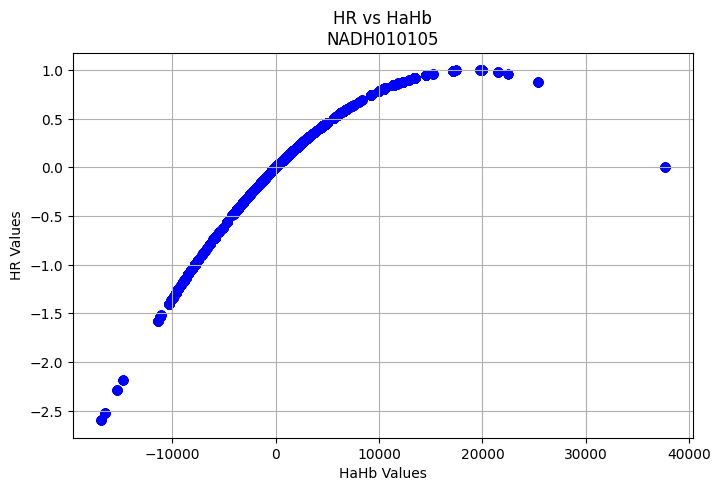

Processing files:  64%|█████████████████████████████████████████▏                      | 18/28 [00:22<00:12,  1.23s/it]

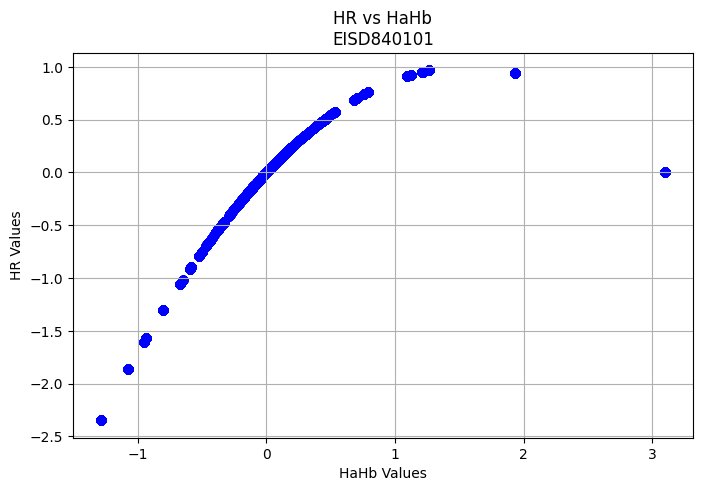

Processing files:  68%|███████████████████████████████████████████▍                    | 19/28 [00:24<00:11,  1.23s/it]

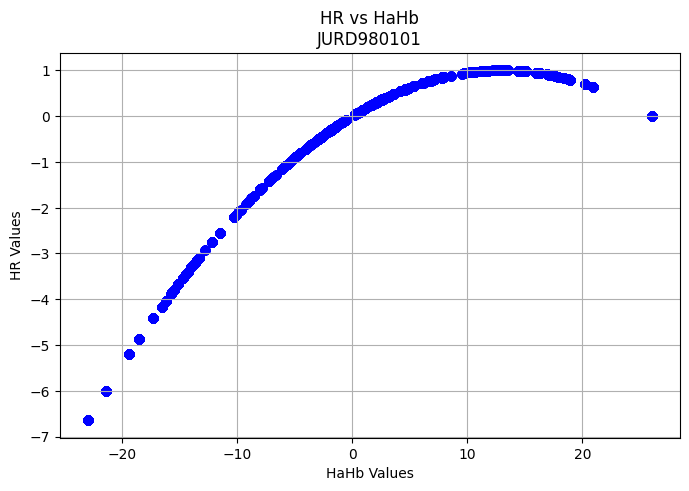

Processing files:  71%|█████████████████████████████████████████████▋                  | 20/28 [00:25<00:09,  1.24s/it]

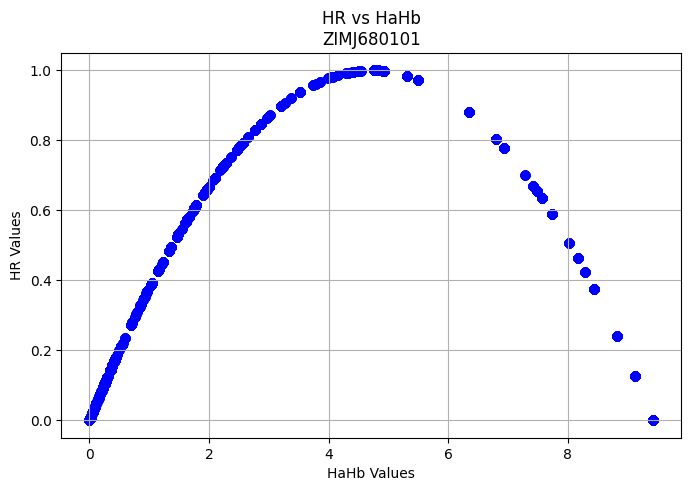

Processing files:  75%|████████████████████████████████████████████████                | 21/28 [00:26<00:08,  1.19s/it]

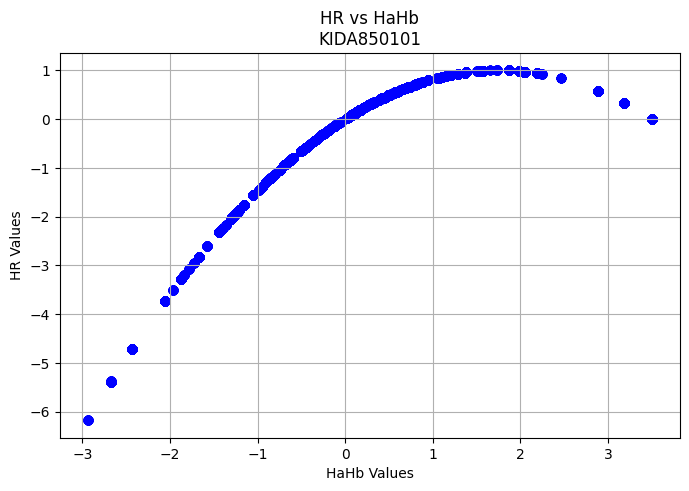

Processing files:  79%|██████████████████████████████████████████████████▎             | 22/28 [00:27<00:07,  1.20s/it]

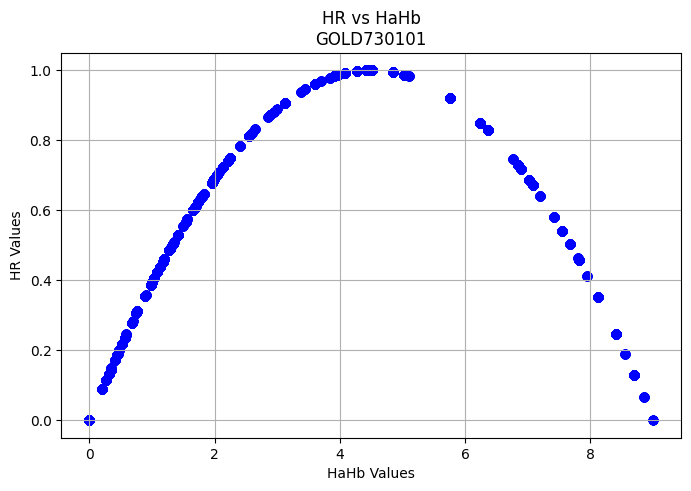

Processing files:  82%|████████████████████████████████████████████████████▌           | 23/28 [00:28<00:05,  1.20s/it]

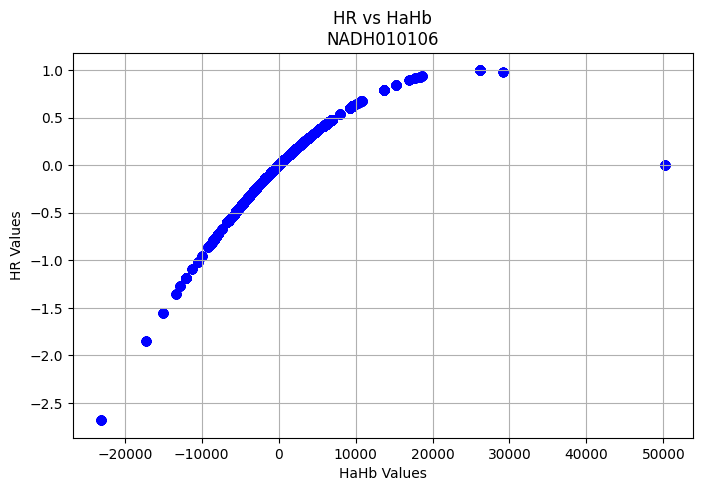

Processing files:  86%|██████████████████████████████████████████████████████▊         | 24/28 [00:30<00:04,  1.24s/it]

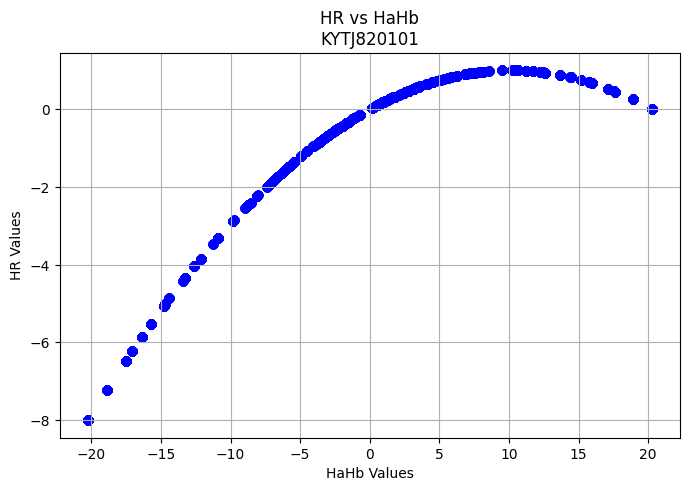

Processing files:  89%|█████████████████████████████████████████████████████████▏      | 25/28 [00:31<00:03,  1.26s/it]

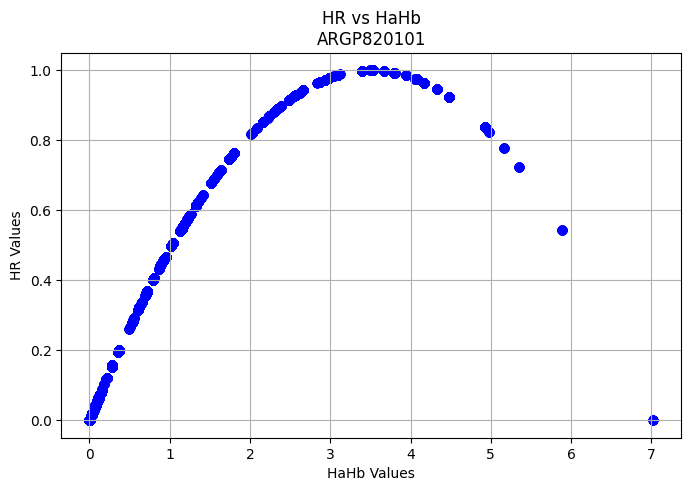

Processing files:  93%|███████████████████████████████████████████████████████████▍    | 26/28 [00:32<00:02,  1.28s/it]

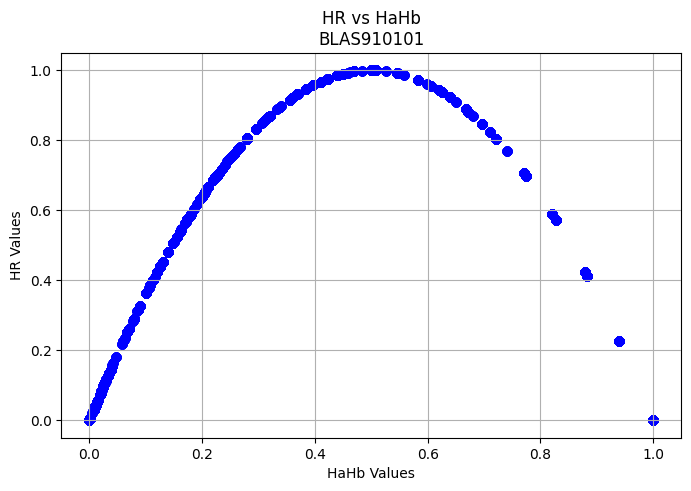

Processing files:  96%|█████████████████████████████████████████████████████████████▋  | 27/28 [00:34<00:01,  1.28s/it]

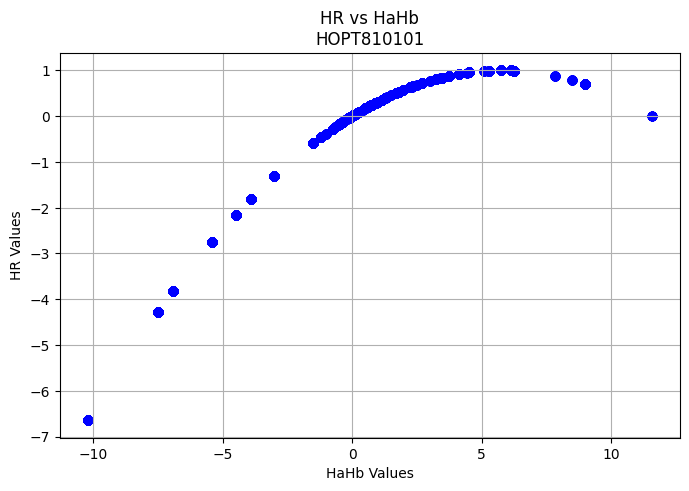

Processing files: 100%|████████████████████████████████████████████████████████████████| 28/28 [00:35<00:00,  1.26s/it]

Processing complete! All plots displayed.


In [20]:
# Directory paths
base_dir = "../generated_data/"
train_hr_dir = os.path.join(base_dir, "train/Hr/")
test_hr_dir = os.path.join(base_dir, "test/Hr/")
train_hahb_dir = os.path.join(base_dir, "train/HaHb/")
test_hahb_dir = os.path.join(base_dir, "test/HaHb/")

# Get all unique file names (without extension)
def get_file_list(directory):
    return {f.replace('.txt', '') for f in os.listdir(directory) if f.endswith('.txt')}

# Find common files across all directories
common_files = (get_file_list(train_hr_dir) & 
                get_file_list(test_hr_dir) & 
                get_file_list(train_hahb_dir) & 
                get_file_list(test_hahb_dir))

print(f"Found {len(common_files)} common data files to process")

# Process each file
for file_name in tqdm(common_files, desc="Processing files"):
    try:
        # Load all data
        train_hr = np.loadtxt(os.path.join(train_hr_dir, f"{file_name}.txt"))
        test_hr = np.loadtxt(os.path.join(test_hr_dir, f"{file_name}.txt"))
        train_hahb = np.loadtxt(os.path.join(train_hahb_dir, f"{file_name}.txt"))
        test_hahb = np.loadtxt(os.path.join(test_hahb_dir, f"{file_name}.txt"))
        
        # Combine data
        combined_hr = np.concatenate([train_hr.flatten(), test_hr.flatten()])
        combined_hahb = np.concatenate([train_hahb.flatten(), test_hahb.flatten()])
        
        # Create and display plot
        plt.figure(figsize=(8, 5))
        plt.scatter(combined_hahb, combined_hr, alpha=0.5, color='blue')
        plt.xlabel('HaHb Values')
        plt.ylabel('HR Values')
        plt.title(f'HR vs HaHb\n{file_name}')
        plt.grid(True)
        plt.show()  # This displays the plot instead of saving it
        
    except Exception as e:
        print(f"Error processing {file_name}: {str(e)}")
        continue

print("Processing complete! All plots displayed.")

In [1]:
# Directory paths - modified to use _modified directories
base_dir = "../generated_data/"
train_hr_dir = os.path.join(base_dir, "train/Hr_modified/")
test_hr_dir = os.path.join(base_dir, "test/Hr_modified/")
train_hahb_dir = os.path.join(base_dir, "train/HaHb_modified/")
test_hahb_dir = os.path.join(base_dir, "test/HaHb_modified/")
plot_dir = os.path.join(base_dir, "plots_modified")

# Create the plot directory if it doesn't exist
os.makedirs(plot_dir, exist_ok=True)

# Get all unique file names (without extension)
def get_file_list(directory):
    return {f.replace('.txt', '') for f in os.listdir(directory) if f.endswith('.txt')}

# Find common files across all modified directories
common_files = (get_file_list(train_hr_dir) & 
                get_file_list(test_hr_dir) & 
                get_file_list(train_hahb_dir) & 
                get_file_list(test_hahb_dir))

print(f"Found {len(common_files)} modified data files to process")

# Process each file
for file_name in tqdm(common_files, desc="Processing modified files"):
    try:
        # Load all modified data
        train_hr = np.loadtxt(os.path.join(train_hr_dir, f"{file_name}.txt"))
        test_hr = np.loadtxt(os.path.join(test_hr_dir, f"{file_name}.txt"))
        train_hahb = np.loadtxt(os.path.join(train_hahb_dir, f"{file_name}.txt"))
        test_hahb = np.loadtxt(os.path.join(test_hahb_dir, f"{file_name}.txt"))
        
        # Combine data
        combined_hr = np.concatenate([train_hr.flatten(), test_hr.flatten()])
        combined_hahb = np.concatenate([train_hahb.flatten(), test_hahb.flatten()])
        
        # Create plot
        plt.figure(figsize=(8, 5))
        plt.scatter(combined_hahb, combined_hr, alpha=0.5, color='red')
        plt.xlabel('Modified HaHb Values')
        plt.ylabel('Modified HR Values')
        plt.title(f'Modified HR vs HaHb\n{file_name}')
        plt.grid(True)
        
        # Save plot
        plot_path = os.path.join(plot_dir, f"{file_name}_scatter.png")
        plt.savefig(plot_path)
        plt.close()
        
    except Exception as e:
        print(f"Error processing {file_name}: {str(e)}")
        continue

print("Processing of modified files complete! All plots saved.")


Found 28 modified data files to process


Processing modified files: 100%|███████████████████████████████████████████████████████| 28/28 [00:46<00:00,  1.66s/it]

Processing of modified files complete! All plots saved.


Found 28 files with both normal and modified data


Processing files:   0%|                                                                         | 0/28 [00:00<?, ?it/s]

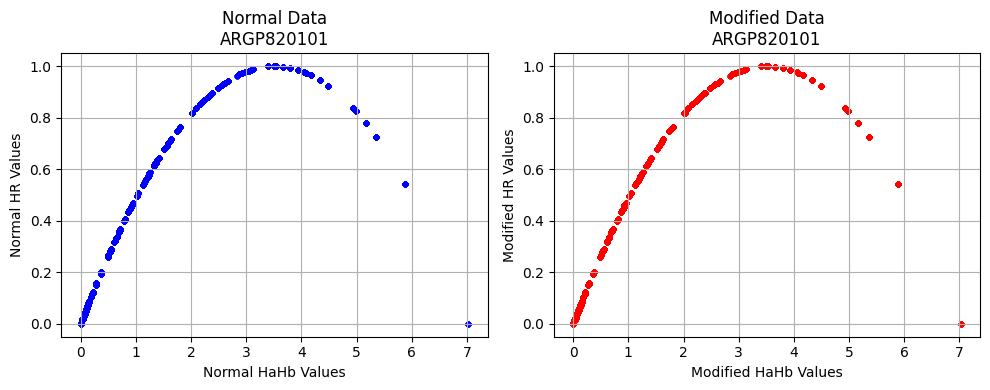

Processing files:   4%|██▎                                                              | 1/28 [00:02<00:54,  2.03s/it]

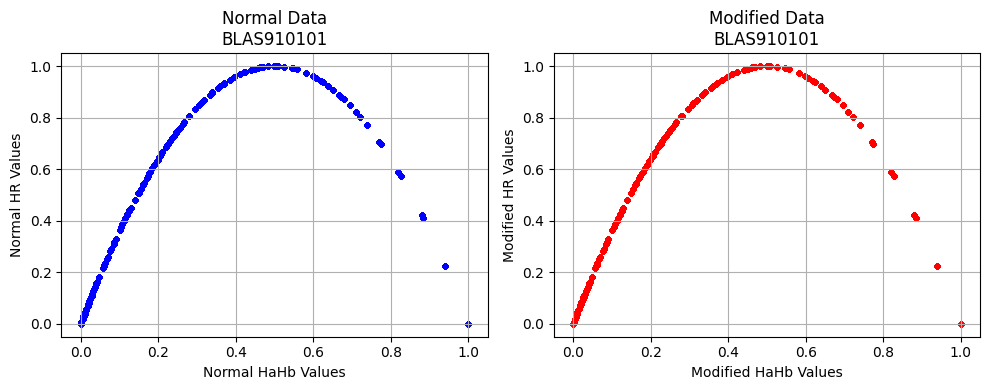

Processing files:   7%|████▋                                                            | 2/28 [00:03<00:47,  1.82s/it]

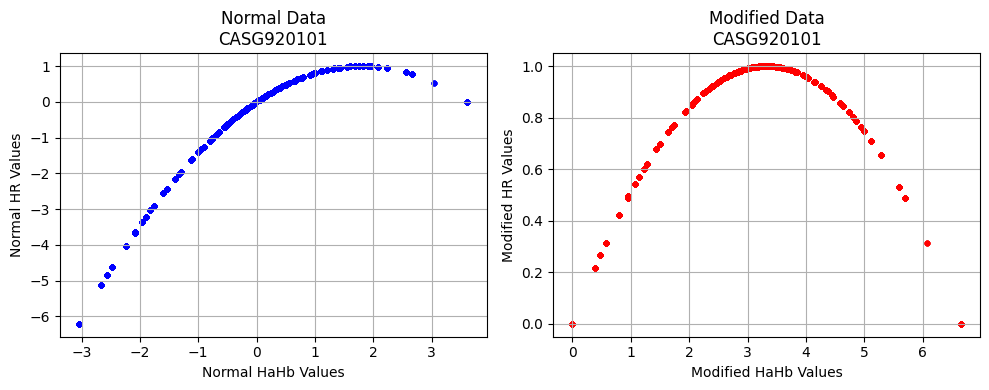

Processing files:  11%|██████▉                                                          | 3/28 [00:05<00:45,  1.80s/it]

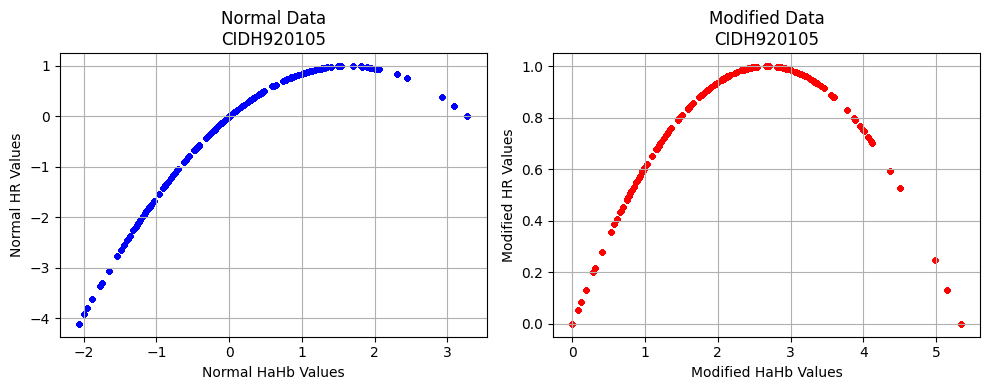

Processing files:  14%|█████████▎                                                       | 4/28 [00:07<00:41,  1.73s/it]

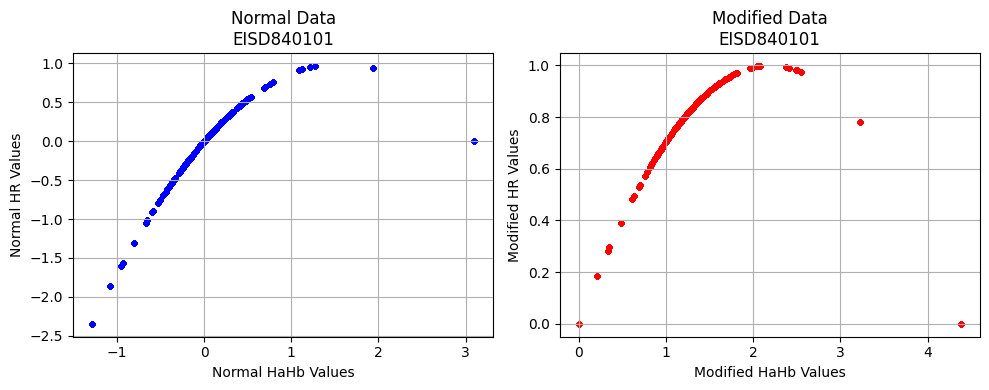

Processing files:  18%|███████████▌                                                     | 5/28 [00:08<00:40,  1.77s/it]

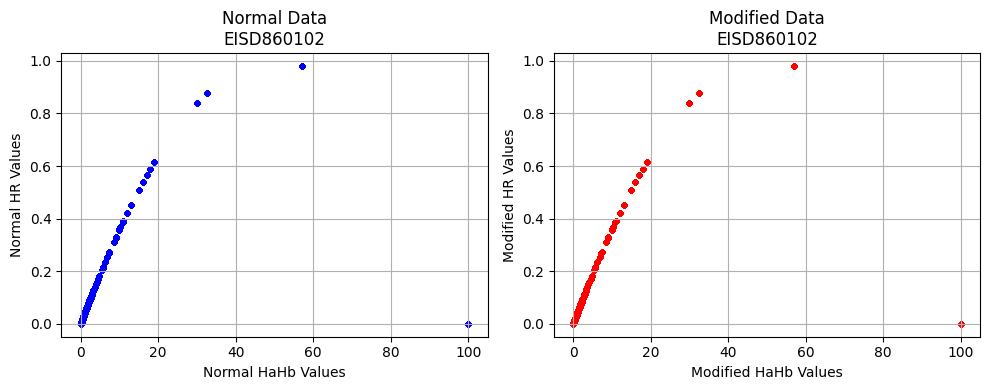

Processing files:  21%|█████████████▉                                                   | 6/28 [00:10<00:39,  1.80s/it]

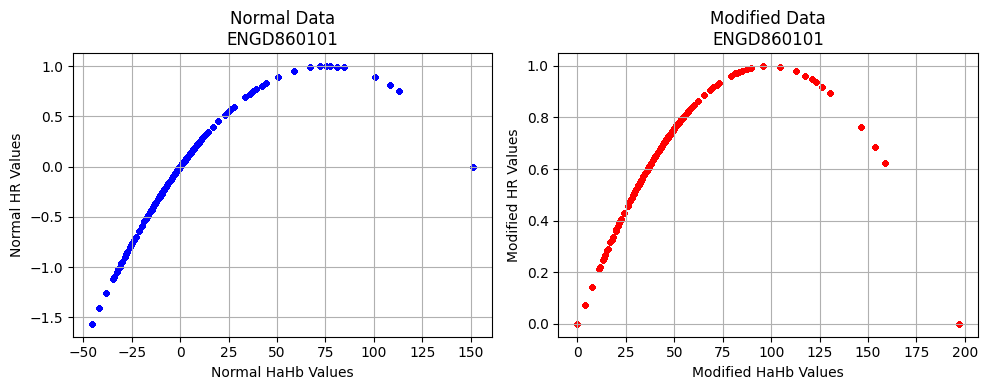

Processing files:  25%|████████████████▎                                                | 7/28 [00:12<00:38,  1.83s/it]

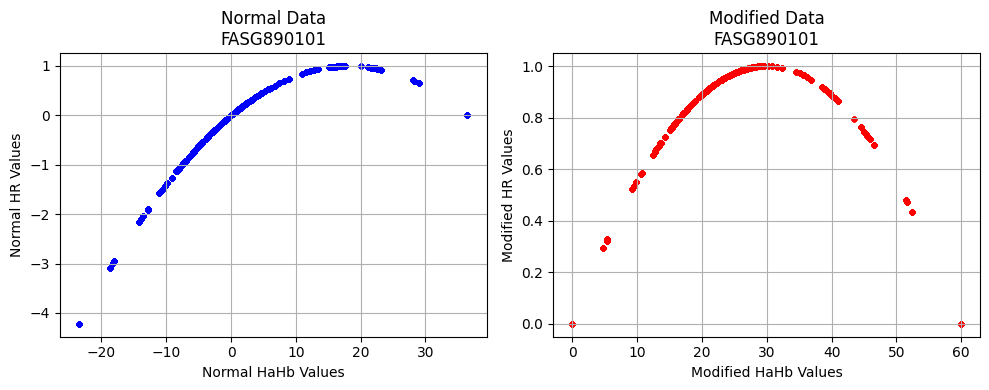

Processing files:  29%|██████████████████▌                                              | 8/28 [00:14<00:36,  1.85s/it]

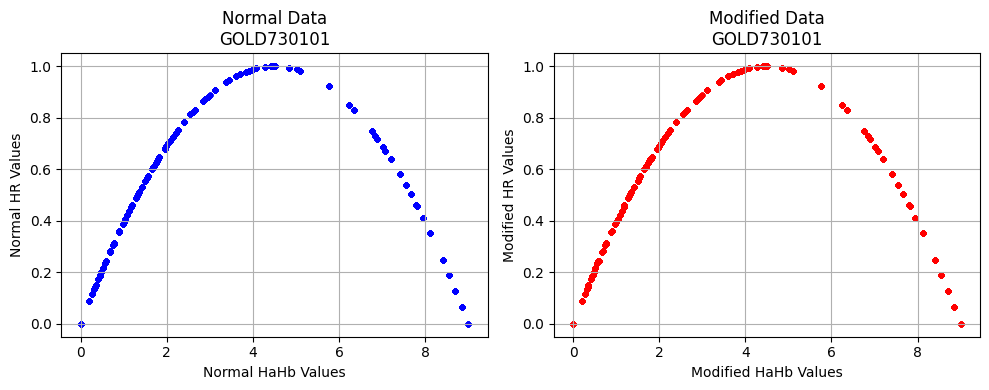

Processing files:  32%|████████████████████▉                                            | 9/28 [00:16<00:34,  1.83s/it]

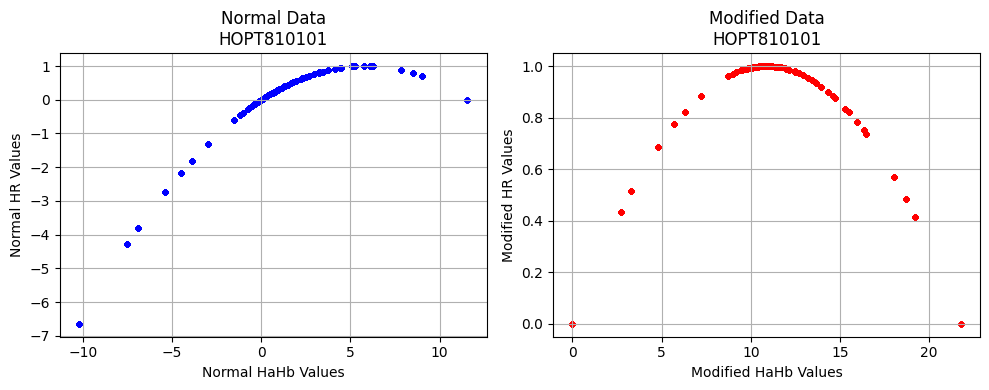

Processing files:  36%|██████████████████████▊                                         | 10/28 [00:18<00:32,  1.81s/it]

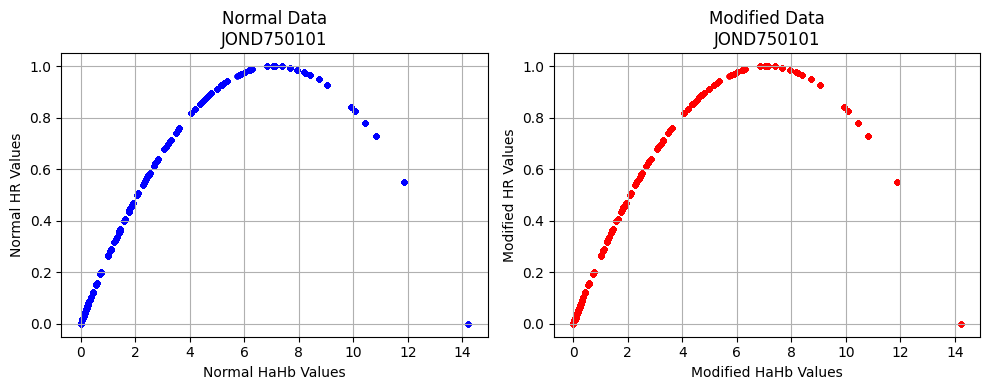

Processing files:  39%|█████████████████████████▏                                      | 11/28 [00:20<00:32,  1.90s/it]

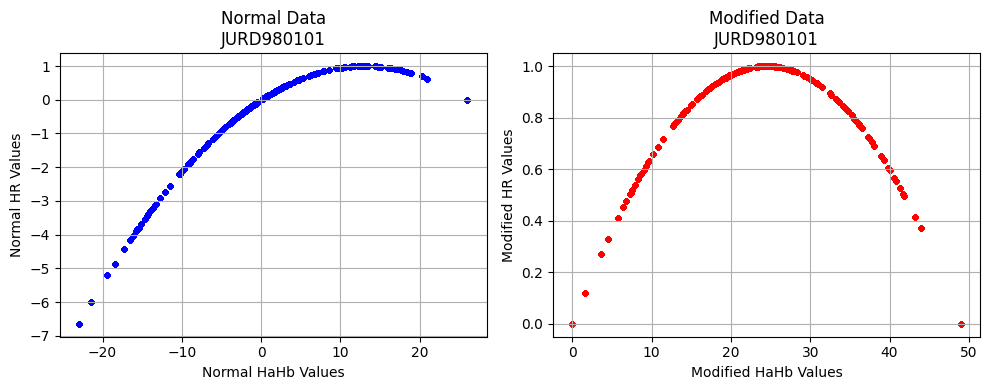

Processing files:  43%|███████████████████████████▍                                    | 12/28 [00:21<00:29,  1.86s/it]

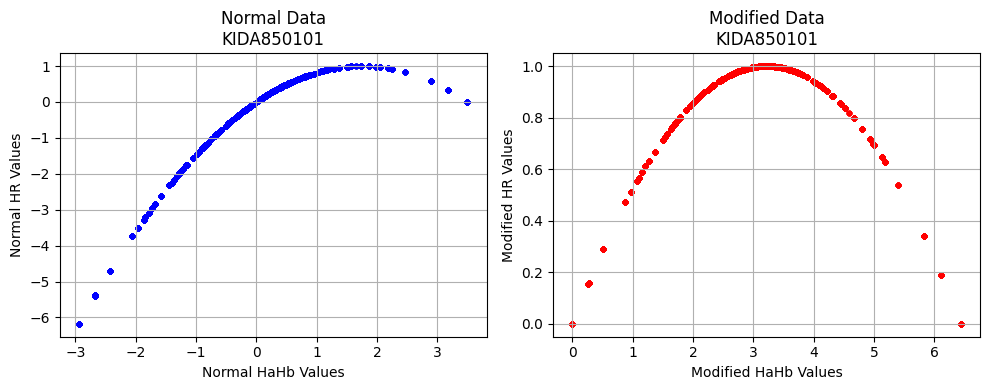

Processing files:  46%|█████████████████████████████▋                                  | 13/28 [00:23<00:27,  1.86s/it]

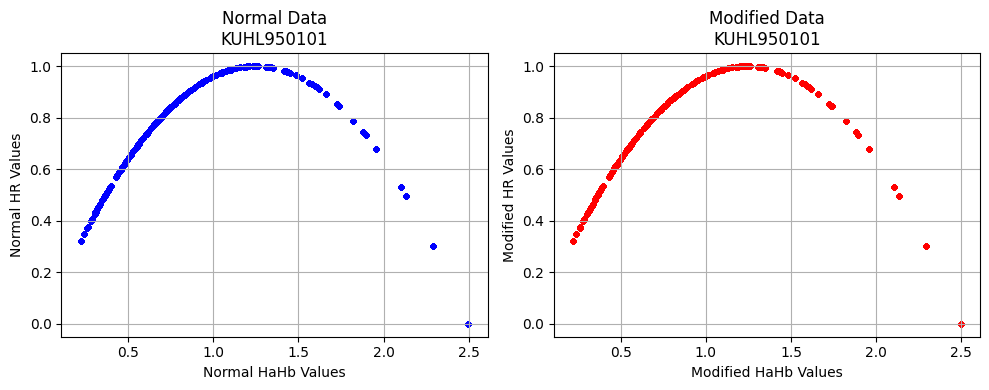

Processing files:  50%|████████████████████████████████                                | 14/28 [00:25<00:25,  1.82s/it]

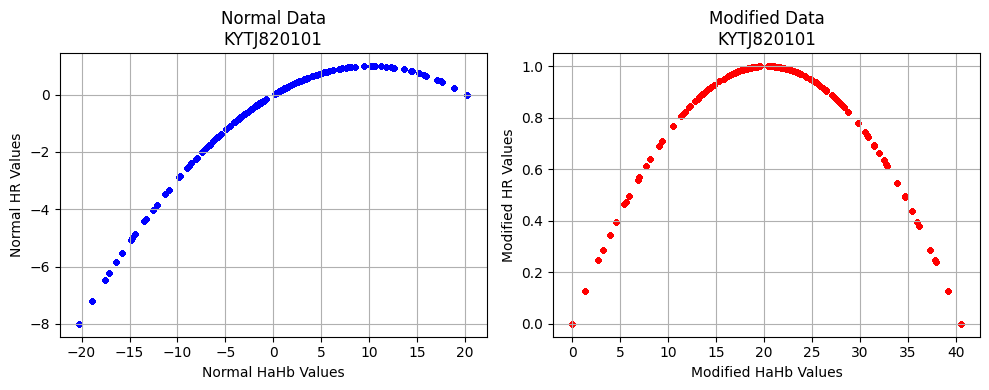

Processing files:  54%|██████████████████████████████████▎                             | 15/28 [00:27<00:24,  1.86s/it]

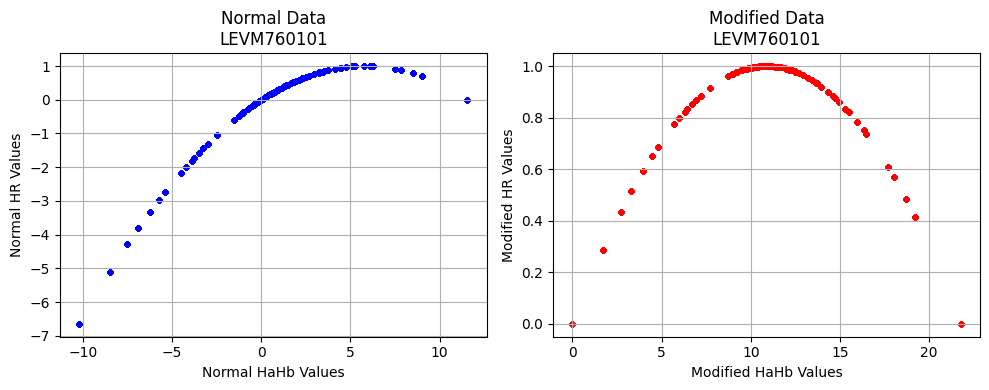

Processing files:  57%|████████████████████████████████████▌                           | 16/28 [00:29<00:22,  1.84s/it]

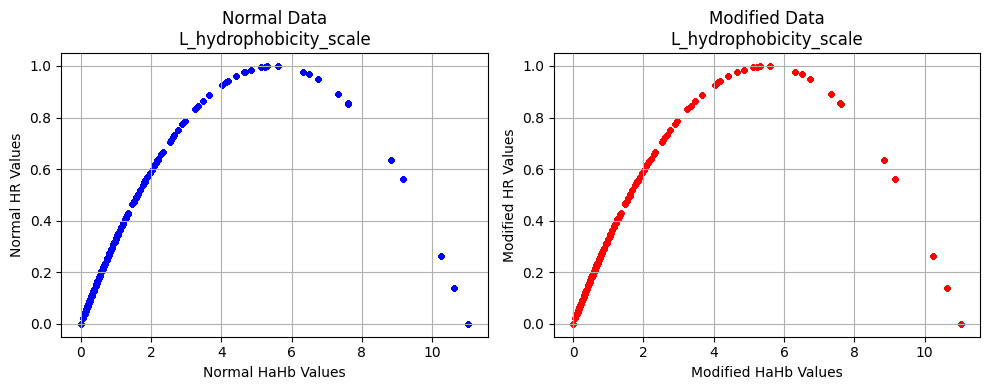

Processing files:  61%|██████████████████████████████████████▊                         | 17/28 [00:31<00:21,  1.92s/it]

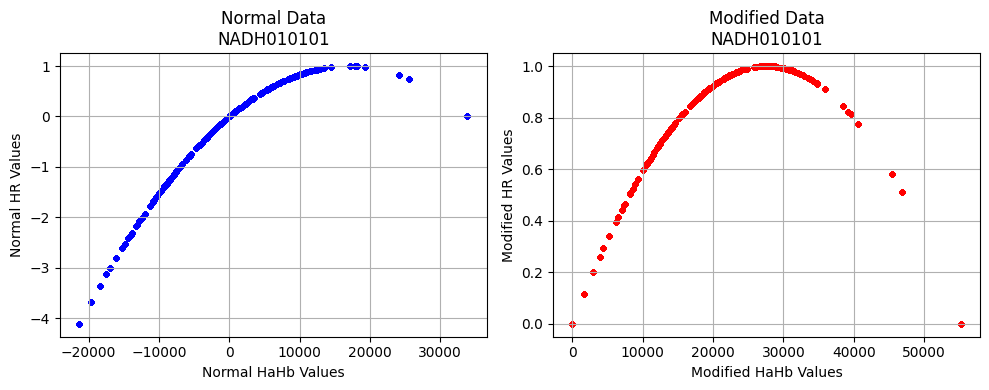

Processing files:  64%|█████████████████████████████████████████▏                      | 18/28 [00:33<00:19,  1.97s/it]

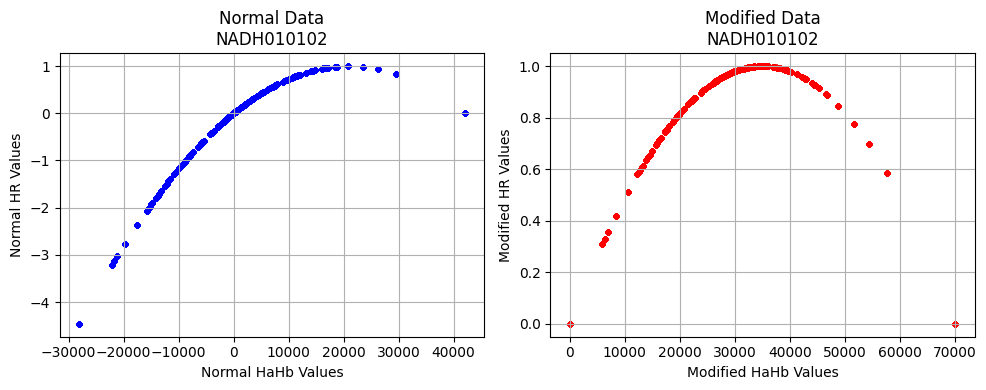

Processing files:  68%|███████████████████████████████████████████▍                    | 19/28 [00:35<00:18,  2.06s/it]

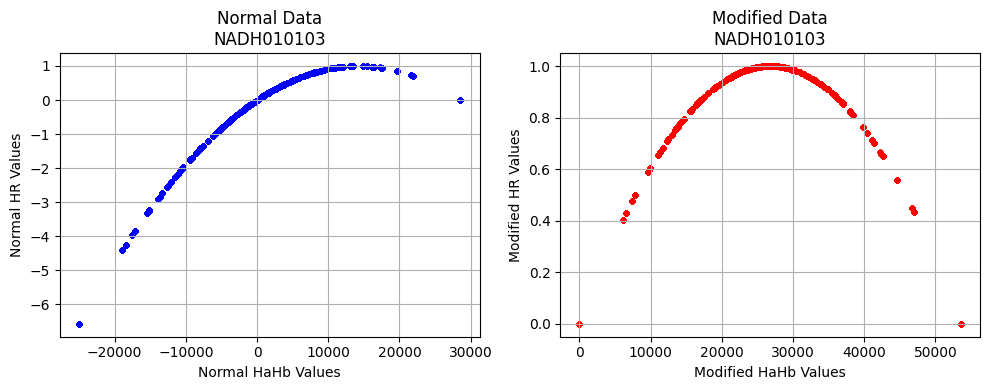

Processing files:  71%|█████████████████████████████████████████████▋                  | 20/28 [00:38<00:17,  2.16s/it]

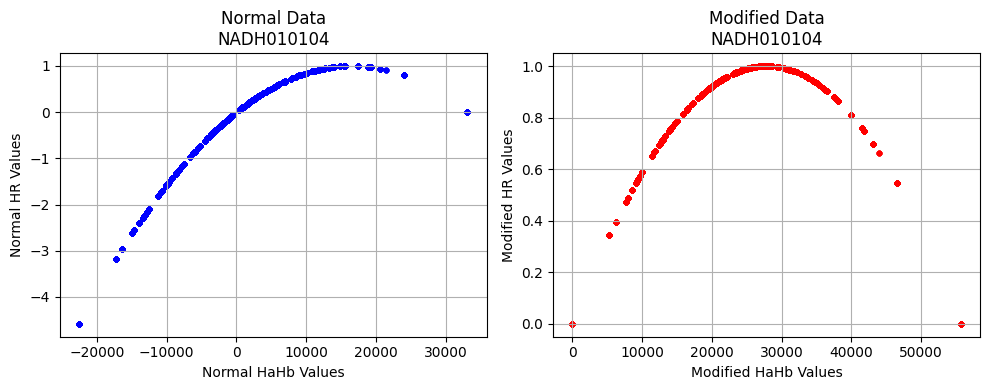

Processing files:  75%|████████████████████████████████████████████████                | 21/28 [00:40<00:14,  2.09s/it]

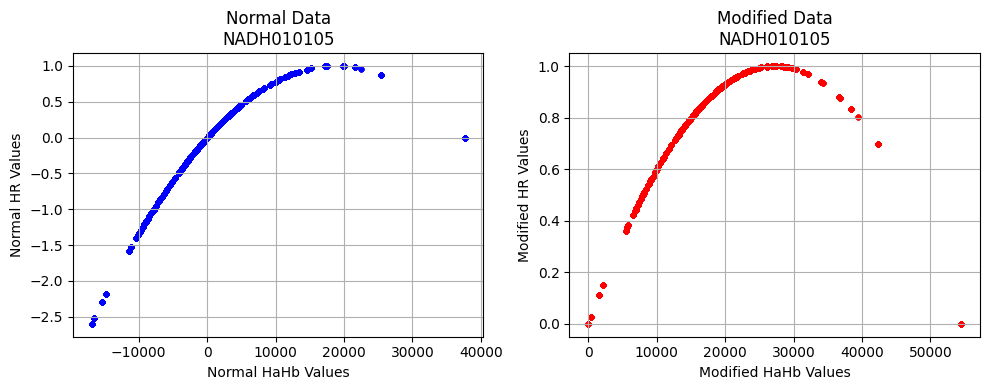

Processing files:  79%|██████████████████████████████████████████████████▎             | 22/28 [00:42<00:12,  2.04s/it]

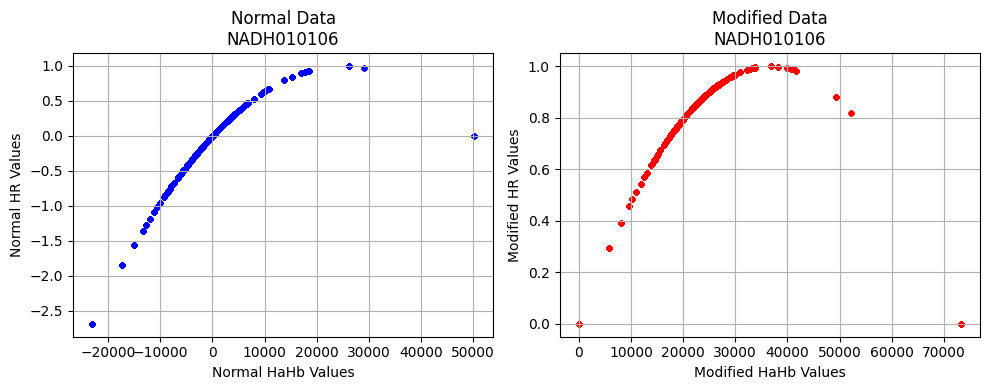

Processing files:  82%|████████████████████████████████████████████████████▌           | 23/28 [00:43<00:10,  2.00s/it]

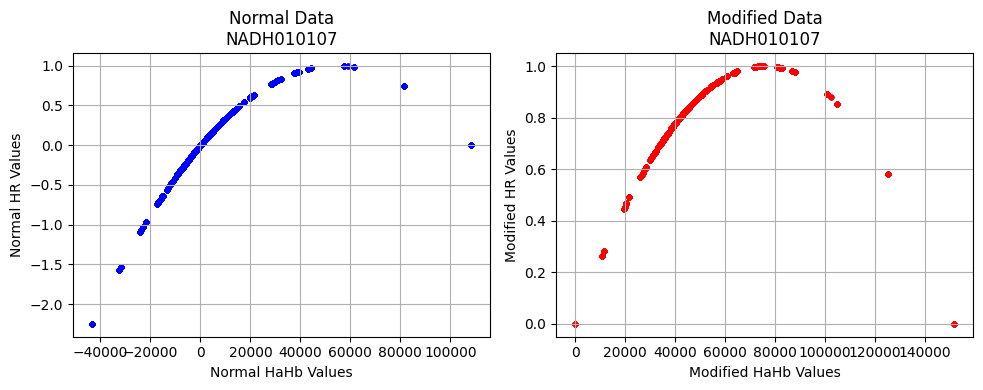

Processing files:  86%|██████████████████████████████████████████████████████▊         | 24/28 [00:45<00:07,  1.94s/it]

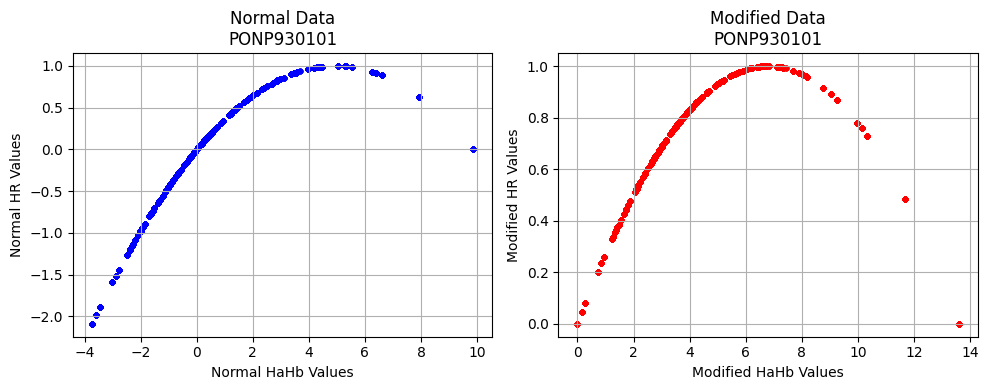

Processing files:  89%|█████████████████████████████████████████████████████████▏      | 25/28 [00:47<00:05,  1.93s/it]

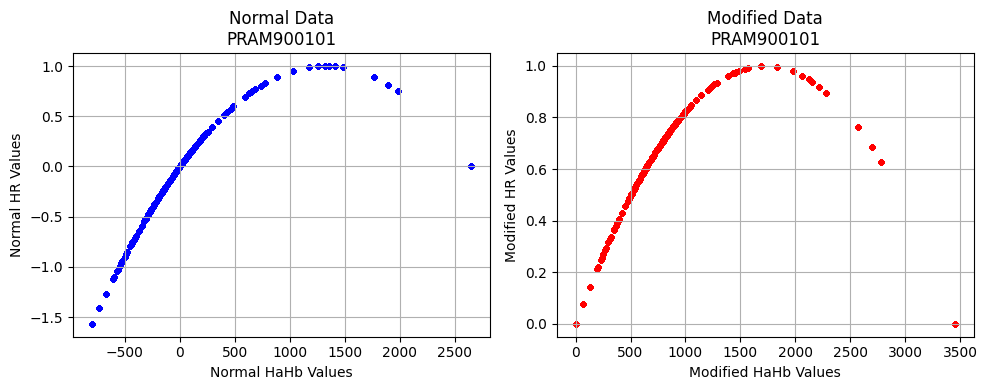

Processing files:  93%|███████████████████████████████████████████████████████████▍    | 26/28 [00:49<00:03,  1.90s/it]

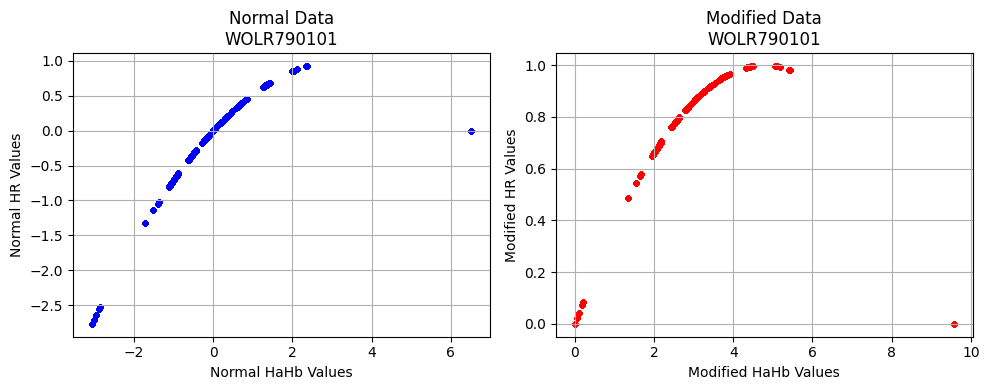

Processing files:  96%|█████████████████████████████████████████████████████████████▋  | 27/28 [00:51<00:01,  1.87s/it]

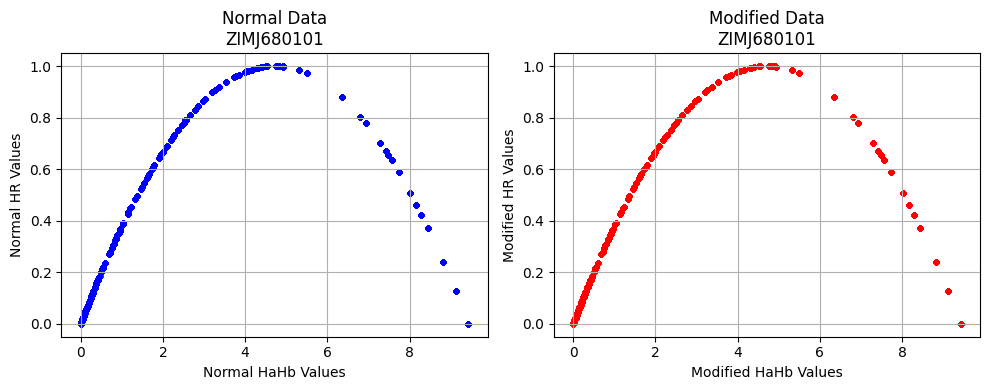

Processing files: 100%|████████████████████████████████████████████████████████████████| 28/28 [00:53<00:00,  1.90s/it]

Processing complete! All plots displayed.


In [24]:
# Directory setup
base_dir = "../generated_data/"
dirs = {
    'normal': {
        'train_hr': os.path.join(base_dir, "train/Hr/"),
        'test_hr': os.path.join(base_dir, "test/Hr/"),
        'train_hahb': os.path.join(base_dir, "train/HaHb/"),
        'test_hahb': os.path.join(base_dir, "test/HaHb/")
    },
    'modified': {
        'train_hr': os.path.join(base_dir, "train/Hr_modified/"),
        'test_hr': os.path.join(base_dir, "test/Hr_modified/"),
        'train_hahb': os.path.join(base_dir, "train/HaHb_modified/"),
        'test_hahb': os.path.join(base_dir, "test/HaHb_modified/")
    }
}

# Get common files across all directories
def get_common_files():
    normal_files = {f.replace('.txt', '') for f in os.listdir(dirs['normal']['train_hr']) if f.endswith('.txt')}
    modified_files = {f.replace('.txt', '') for f in os.listdir(dirs['modified']['train_hr']) if f.endswith('.txt')}
    return sorted(normal_files & modified_files)

common_files = get_common_files()
print(f"Found {len(common_files)} files with both normal and modified data")

# Set smaller figure size
plt.rcParams['figure.figsize'] = [10, 4]  # Width, height in inches

# Process each file
for file_name in tqdm(common_files, desc="Processing files"):
    try:
        fig, (ax1, ax2) = plt.subplots(1, 2)  # 1 row, 2 columns
        
        # Load and plot NORMAL data
        for data_type, ax in zip(['normal', 'modified'], [ax1, ax2]):
            # Load data
            train_hr = np.loadtxt(os.path.join(dirs[data_type]['train_hr'], f"{file_name}.txt"))
            test_hr = np.loadtxt(os.path.join(dirs[data_type]['test_hr'], f"{file_name}.txt"))
            train_hahb = np.loadtxt(os.path.join(dirs[data_type]['train_hahb'], f"{file_name}.txt"))
            test_hahb = np.loadtxt(os.path.join(dirs[data_type]['test_hahb'], f"{file_name}.txt"))
            
            # Combine data
            combined_hr = np.concatenate([train_hr.flatten(), test_hr.flatten()])
            combined_hahb = np.concatenate([train_hahb.flatten(), test_hahb.flatten()])
            
            # Plot
            ax.scatter(combined_hahb, combined_hr, alpha=0.3, 
                      color='blue' if data_type == 'normal' else 'red',
                      s=10)  # Smaller point size
            ax.set_xlabel(f'{data_type.capitalize()} HaHb Values')
            ax.set_ylabel(f'{data_type.capitalize()} HR Values')
            ax.set_title(f'{data_type.capitalize()} Data\n{file_name}')
            ax.grid(True)
        
        plt.tight_layout()  # Prevent label overlap
        plt.show()
        
    except Exception as e:
        print(f"Error processing {file_name}: {str(e)}")
        continue

print("Processing complete! All plots displayed.")

In [1]:
# Directory setup
base_dir = "../generated_data/"
dirs = {
    'normal': {
        'train_hr': os.path.join(base_dir, "train/Hr/"),
        'test_hr': os.path.join(base_dir, "test/Hr/"),
        'train_hahb': os.path.join(base_dir, "train/HaHb/"),
        'test_hahb': os.path.join(base_dir, "test/HaHb/")
    },
    'modified': {
        'train_hr': os.path.join(base_dir, "train/Hr_modified/"),
        'test_hr': os.path.join(base_dir, "test/Hr_modified/"),
        'train_hahb': os.path.join(base_dir, "train/HaHb_modified/"),
        'test_hahb': os.path.join(base_dir, "test/HaHb_modified/")
    }
}

# Create output directory for plots
plot_dir = os.path.join(base_dir, "plots")
os.makedirs(plot_dir, exist_ok=True)

# Get common files across all directories
def get_common_files():
    normal_files = {f.replace('.txt', '') for f in os.listdir(dirs['normal']['train_hr']) if f.endswith('.txt')}
    modified_files = {f.replace('.txt', '') for f in os.listdir(dirs['modified']['train_hr']) if f.endswith('.txt')}
    return sorted(normal_files & modified_files)

common_files = get_common_files()
print(f"Found {len(common_files)} files with both normal and modified data")

# Set smaller figure size
plt.rcParams['figure.figsize'] = [10, 4]  # Width, height in inches

# Process and save plots
for file_name in tqdm(common_files, desc="Processing files"):
    try:
        fig, (ax1, ax2) = plt.subplots(1, 2)  # 1 row, 2 columns
        
        for data_type, ax in zip(['normal', 'modified'], [ax1, ax2]):
            # Load data
            train_hr = np.loadtxt(os.path.join(dirs[data_type]['train_hr'], f"{file_name}.txt"))
            test_hr = np.loadtxt(os.path.join(dirs[data_type]['test_hr'], f"{file_name}.txt"))
            train_hahb = np.loadtxt(os.path.join(dirs[data_type]['train_hahb'], f"{file_name}.txt"))
            test_hahb = np.loadtxt(os.path.join(dirs[data_type]['test_hahb'], f"{file_name}.txt"))
            
            # Combine data
            combined_hr = np.concatenate([train_hr.flatten(), test_hr.flatten()])
            combined_hahb = np.concatenate([train_hahb.flatten(), test_hahb.flatten()])
            
            # Plot
            ax.scatter(combined_hahb, combined_hr, alpha=0.3,
                       color='blue' if data_type == 'normal' else 'red', s=10)
            ax.set_xlabel(f'{data_type.capitalize()} HaHb Values')
            ax.set_ylabel(f'{data_type.capitalize()} HR Values')
            ax.set_title(f'{data_type.capitalize()} Data\n{file_name}')
            ax.grid(True)

        plt.tight_layout()

        # Save figure
        save_path = os.path.join(plot_dir, f"{file_name}.png")
        plt.savefig(save_path, dpi=150)
        plt.close(fig)  # Close figure to release memory
        
    except Exception as e:
        print(f"Error processing {file_name}: {str(e)}")
        continue

print("Processing complete! All plots saved to:", plot_dir)


Found 28 files with both normal and modified data


Processing files: 100%|████████████████████████████████████████████████████████████████| 28/28 [01:22<00:00,  2.96s/it]

Processing complete! All plots saved to: ../generated_data/plots


In [3]:
# Directory setup
base_dir = "../generated_data/"
train_hr_dir = os.path.join(base_dir, "train/Hr_modified/")
test_hr_dir = os.path.join(base_dir, "test/Hr_modified/")
plot_dir = os.path.join(base_dir, "hr_transform_plots/")
os.makedirs(plot_dir, exist_ok=True)  # Ensure plot directory exists

# Get all files
def get_file_list(directory):
    return {f.replace('.txt', '') for f in os.listdir(directory) if f.endswith('.txt')}

common_files = get_file_list(train_hr_dir) & get_file_list(test_hr_dir)

if not common_files:
    print("No common files found!")
    exit()

print(f"Found {len(common_files)} files to process")

plt.style.use('ggplot')
plt.rcParams['figure.figsize'] = [16, 8]

for file_name in tqdm(sorted(common_files), desc="Processing files"):
    try:
        # Load and combine data
        train_hr = np.loadtxt(os.path.join(train_hr_dir, f"{file_name}.txt"))
        test_hr = np.loadtxt(os.path.join(test_hr_dir, f"{file_name}.txt"))
        combined_hr = np.concatenate([train_hr.ravel(), test_hr.ravel()])
        
        # Power transformation
        transformer = PowerTransformer(method='yeo-johnson')
        hr_transformed = transformer.fit_transform(combined_hr.reshape(-1, 1)).flatten()
        
        # Create figure
        fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(16, 12))
        fig.suptitle(f'HR Data Analysis: {file_name}', y=1.02)
        
        # Original histogram
        ax1.hist(combined_hr, bins='auto', color='skyblue', alpha=0.7)
        ax1.set_title('Original Distribution')
        ax1.set_xlabel('HR Values')
        
        # Transformed histogram
        ax2.hist(hr_transformed, bins='auto', color='salmon', alpha=0.7)
        ax2.set_title('Power Transformed Distribution')
        ax2.set_xlabel('Transformed Values')
        
        # Original Q-Q plot
        stats.probplot(combined_hr, dist="norm", plot=ax3)
        ax3.set_title('Q-Q Plot: Original Data')
        ax3.get_lines()[0].set_markerfacecolor('blue')
        ax3.get_lines()[0].set_markersize(5.0)
        
        # Transformed Q-Q plot
        stats.probplot(hr_transformed, dist="norm", plot=ax4)
        ax4.set_title('Q-Q Plot: Transformed Data') 
        ax4.get_lines()[0].set_markerfacecolor('red')
        
        plt.tight_layout()
        
        # Save the figure
        save_path = os.path.join(plot_dir, f"{file_name}_hr_transform.png")
        plt.savefig(save_path, dpi=150)
        plt.close(fig)
        
    except Exception as e:
        print(f"\nError processing {file_name}: {str(e)}")
        continue

print("\nAnalysis complete! All plots saved to:", plot_dir)


Found 28 files to process


Processing files: 100%|████████████████████████████████████████████████████████████████| 28/28 [02:26<00:00,  5.25s/it]


Analysis complete! All plots saved to: ../generated_data/hr_transform_plots/


Found 28 files to process


Processing files:   0%|                                                                         | 0/28 [00:00<?, ?it/s]

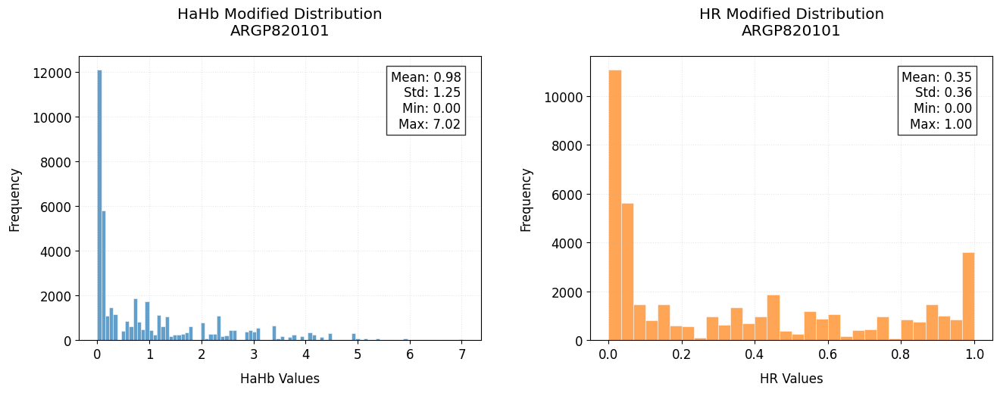

Processing files:   4%|██▎                                                              | 1/28 [00:02<01:01,  2.27s/it]

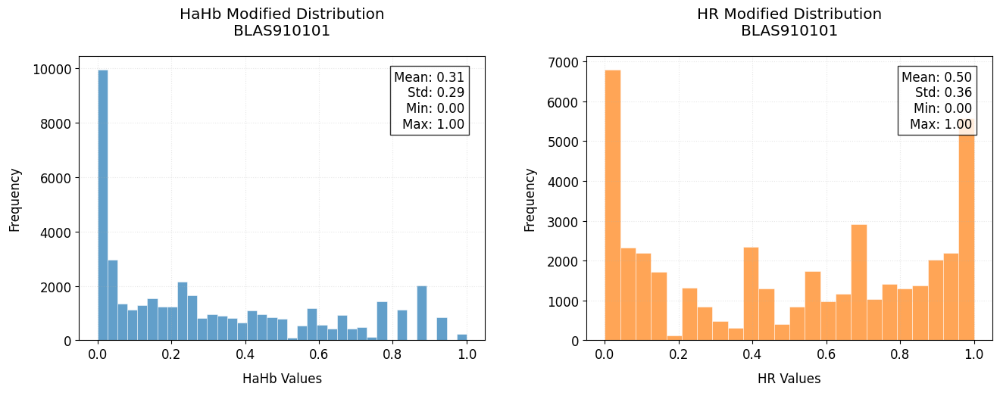

Processing files:   7%|████▋                                                            | 2/28 [00:03<00:48,  1.88s/it]

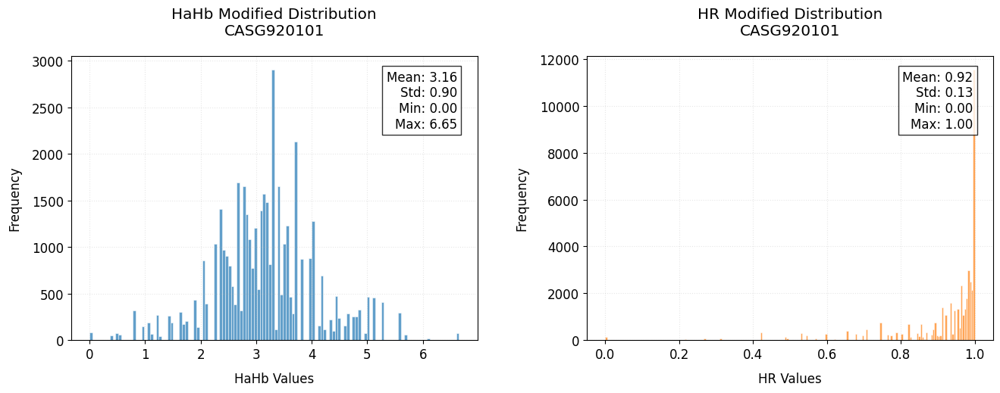

Processing files:  11%|██████▉                                                          | 3/28 [00:06<01:00,  2.43s/it]

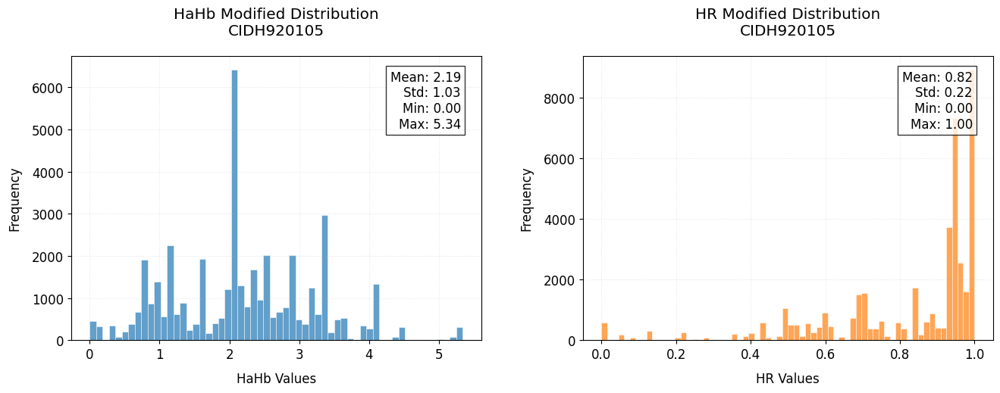

Processing files:  14%|█████████▎                                                       | 4/28 [00:08<00:52,  2.17s/it]

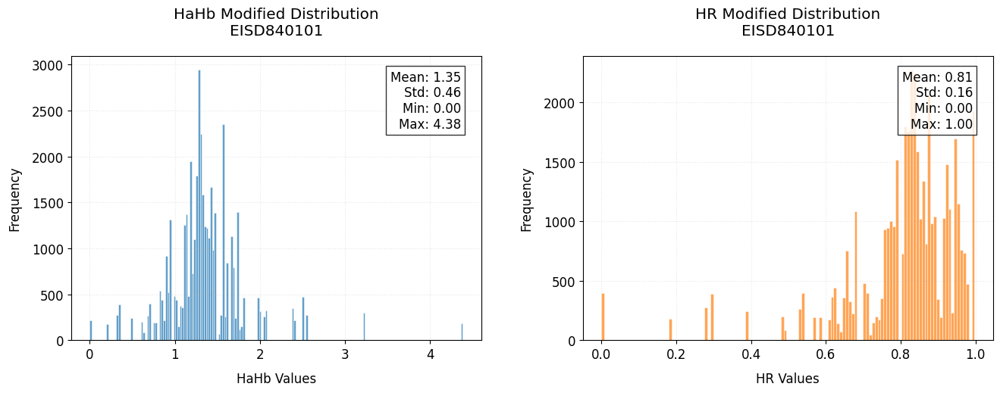

Processing files:  18%|███████████▌                                                     | 5/28 [00:11<00:54,  2.39s/it]

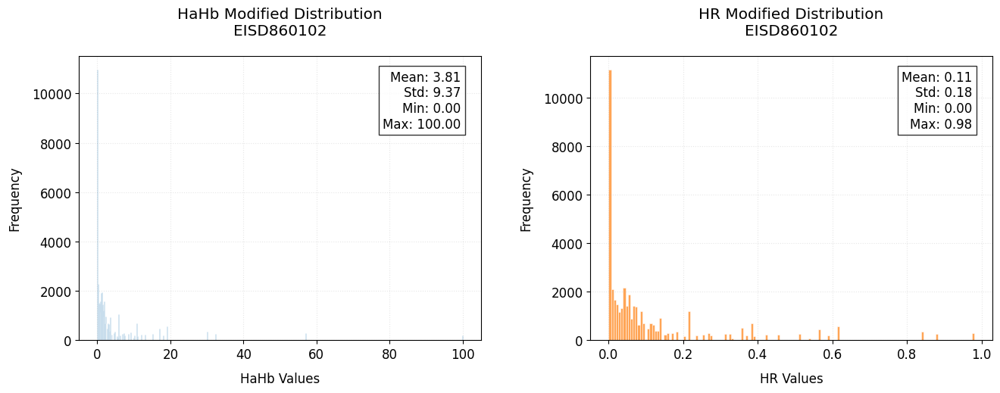

Processing files:  21%|█████████████▉                                                   | 6/28 [00:16<01:12,  3.30s/it]

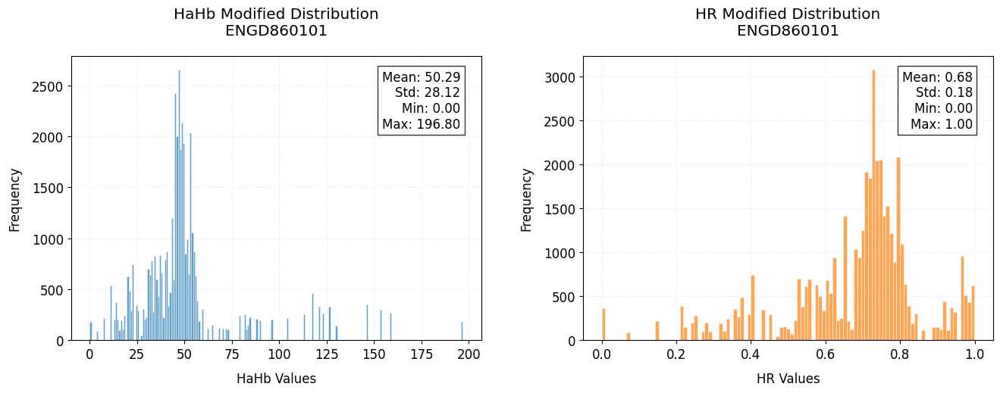

Processing files:  25%|████████████████▎                                                | 7/28 [00:19<01:07,  3.23s/it]

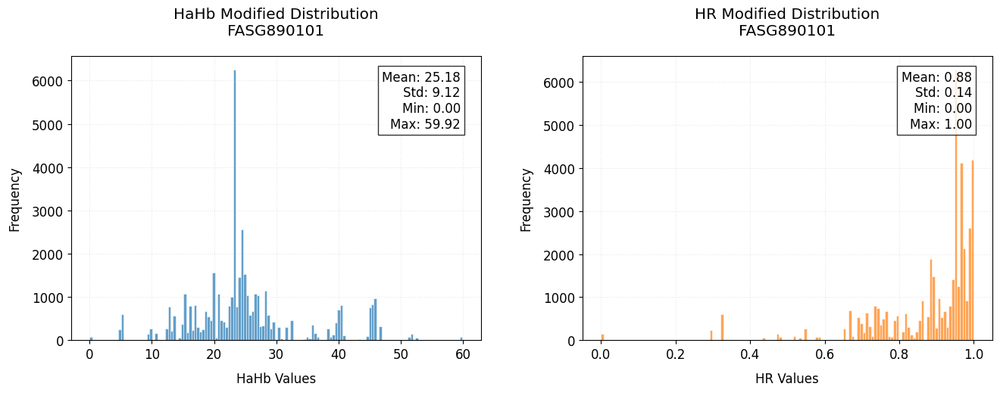

Processing files:  29%|██████████████████▌                                              | 8/28 [00:22<01:04,  3.20s/it]

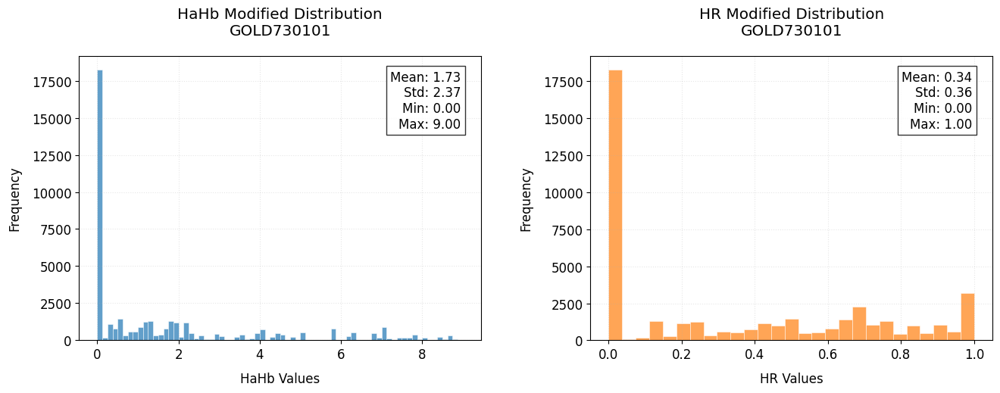

Processing files:  32%|████████████████████▉                                            | 9/28 [00:24<00:52,  2.79s/it]

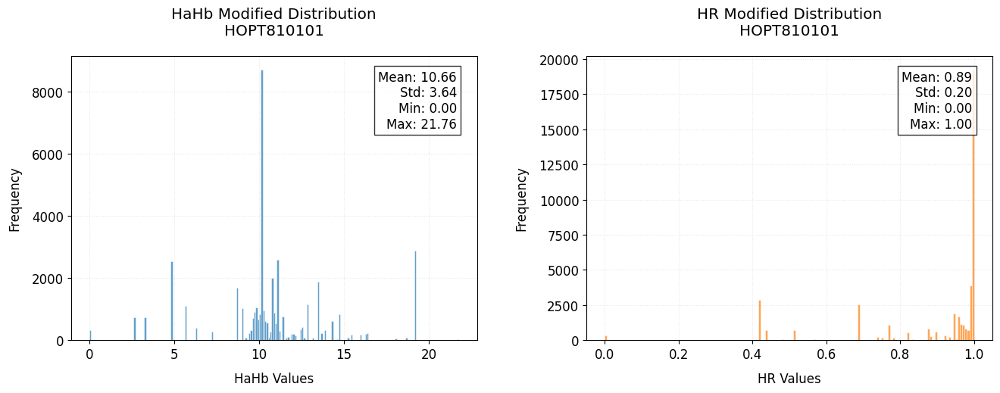

Processing files:  36%|██████████████████████▊                                         | 10/28 [00:27<00:51,  2.88s/it]

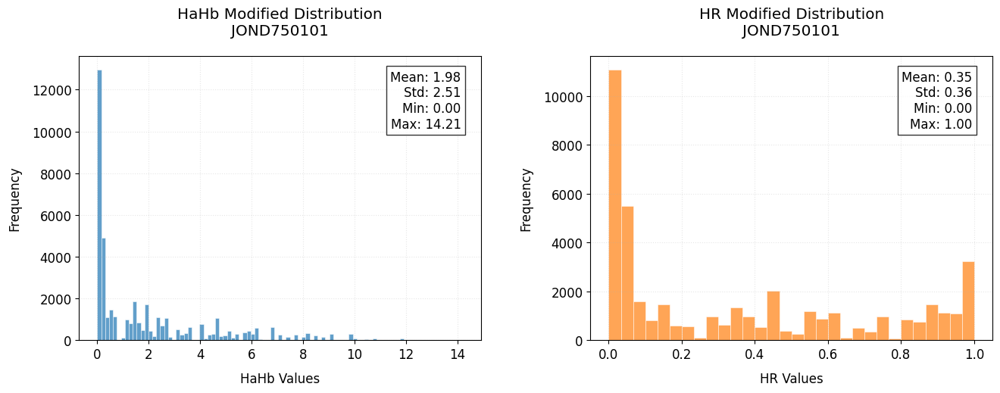

Processing files:  39%|█████████████████████████▏                                      | 11/28 [00:29<00:44,  2.64s/it]

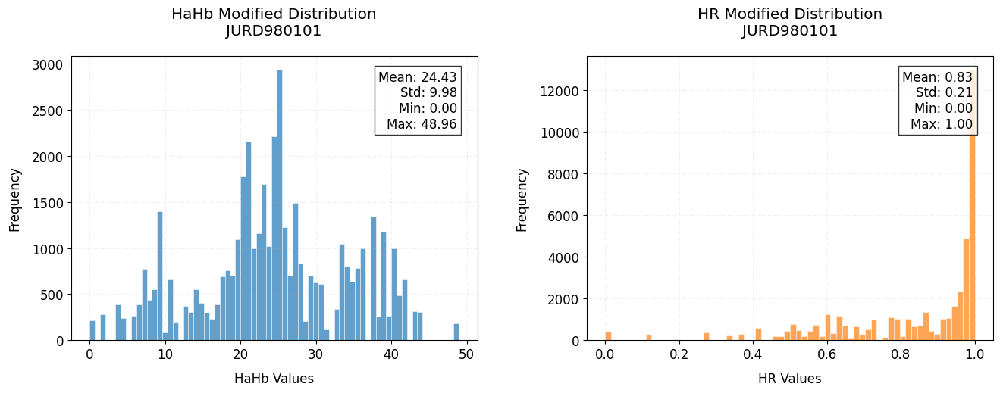

Processing files:  43%|███████████████████████████▍                                    | 12/28 [00:32<00:41,  2.60s/it]

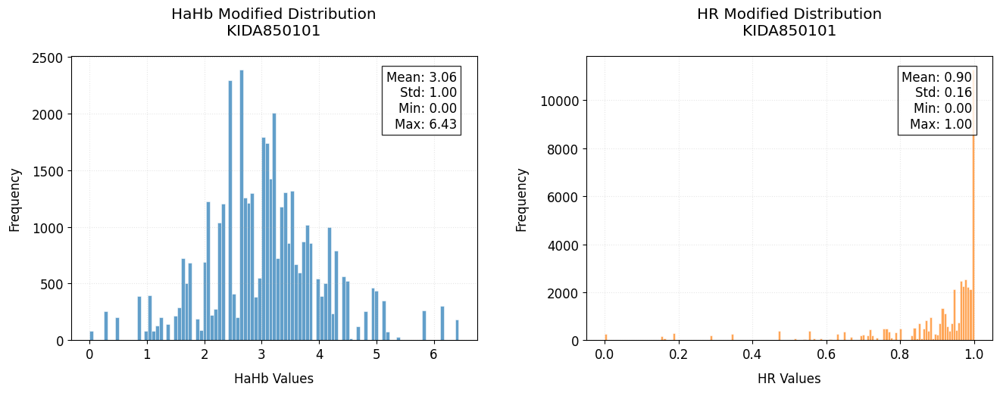

Processing files:  46%|█████████████████████████████▋                                  | 13/28 [00:34<00:37,  2.53s/it]

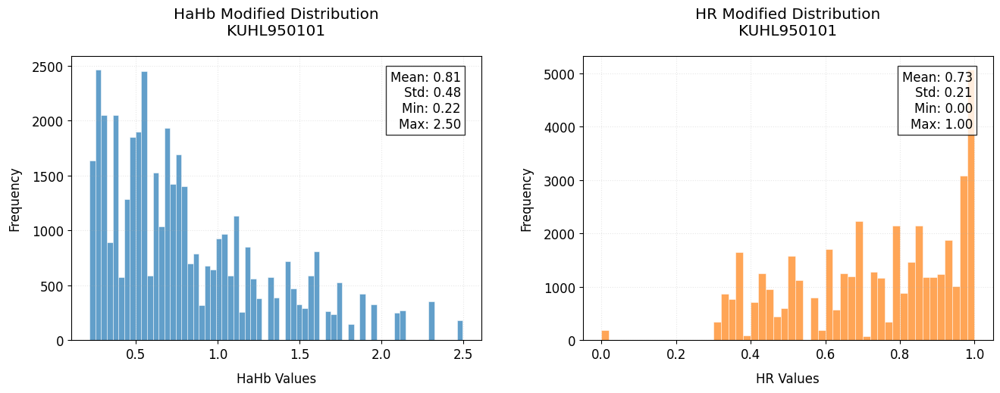

Processing files:  50%|████████████████████████████████                                | 14/28 [00:36<00:32,  2.29s/it]

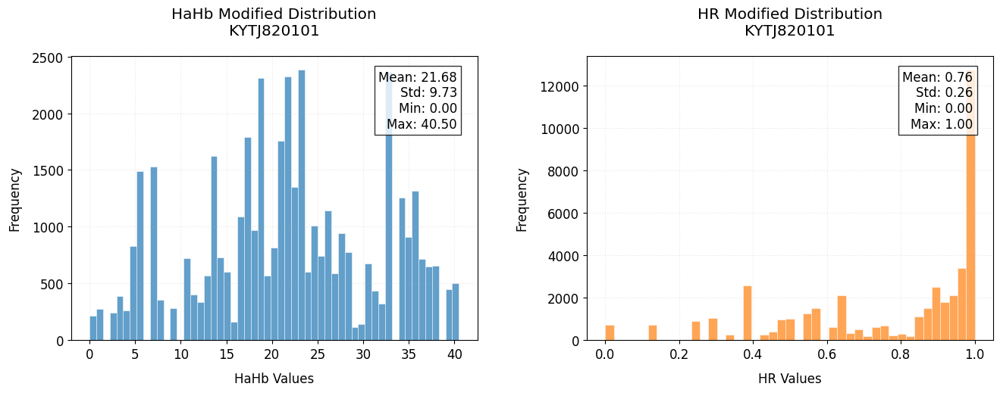

Processing files:  54%|██████████████████████████████████▎                             | 15/28 [00:38<00:28,  2.16s/it]

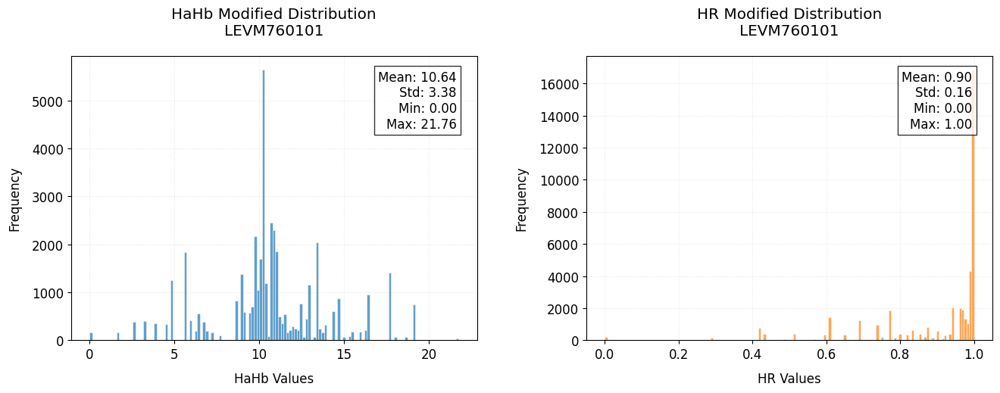

Processing files:  57%|████████████████████████████████████▌                           | 16/28 [00:41<00:29,  2.43s/it]

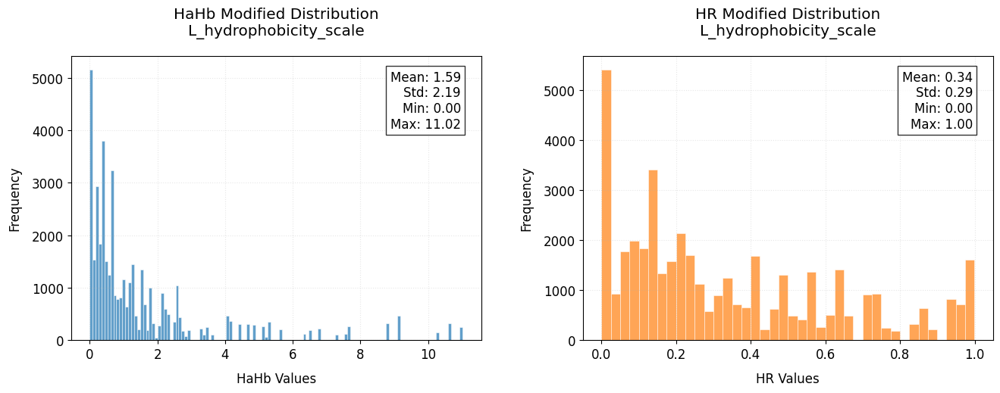

Processing files:  61%|██████████████████████████████████████▊                         | 17/28 [00:43<00:25,  2.34s/it]

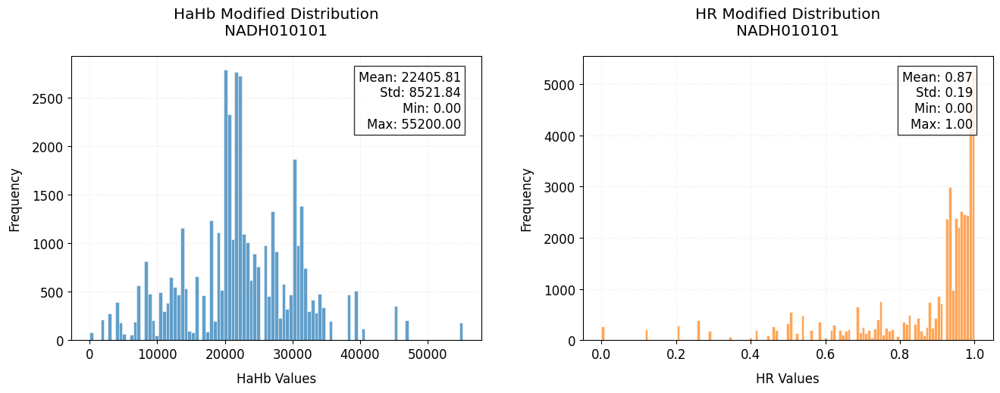

Processing files:  64%|█████████████████████████████████████████▏                      | 18/28 [00:45<00:23,  2.35s/it]

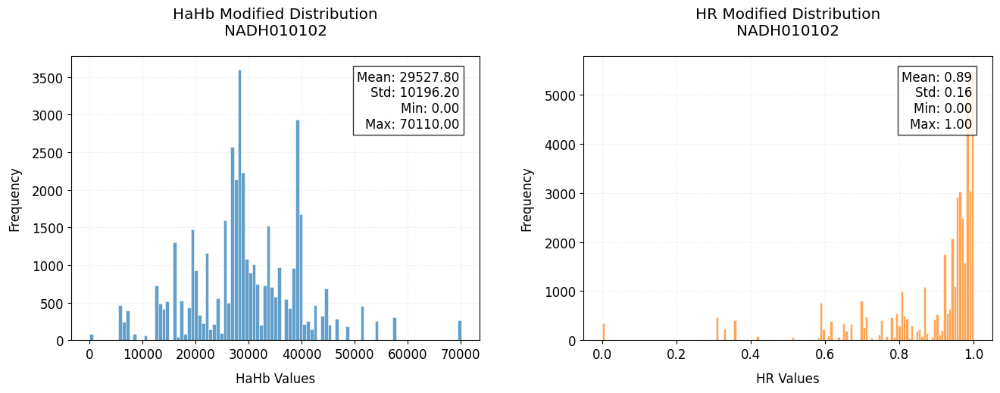

Processing files:  68%|███████████████████████████████████████████▍                    | 19/28 [00:48<00:21,  2.43s/it]

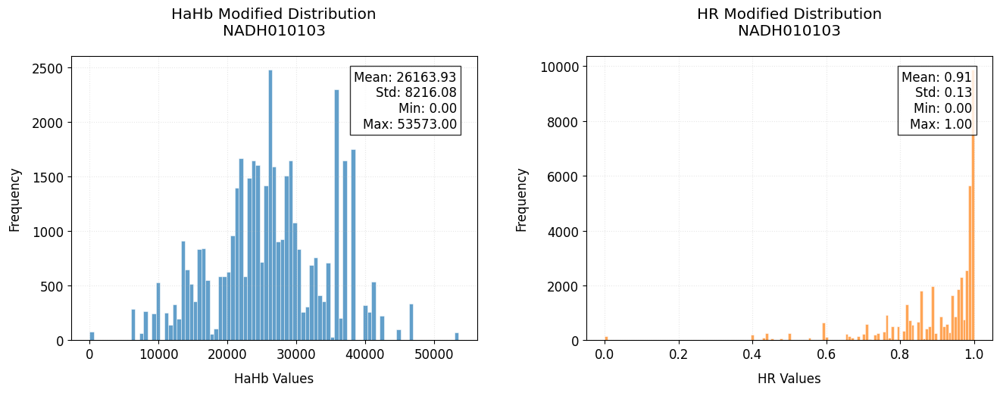

Processing files:  71%|█████████████████████████████████████████████▋                  | 20/28 [00:51<00:20,  2.52s/it]

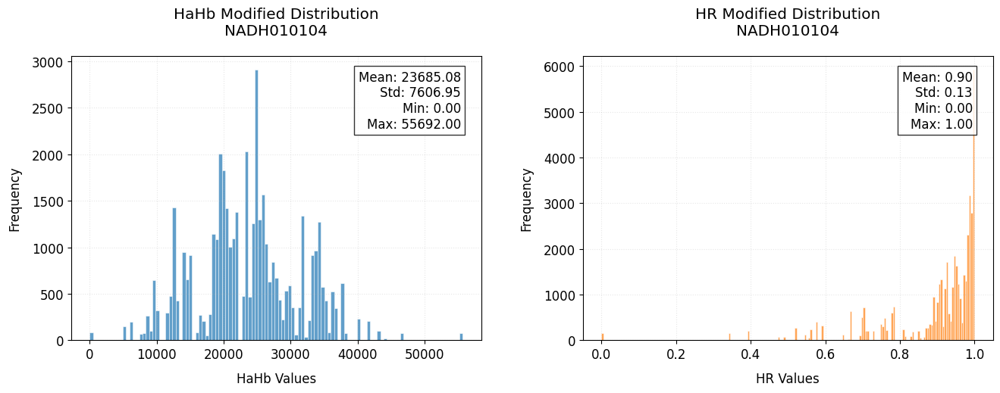

Processing files:  75%|████████████████████████████████████████████████                | 21/28 [00:53<00:17,  2.53s/it]

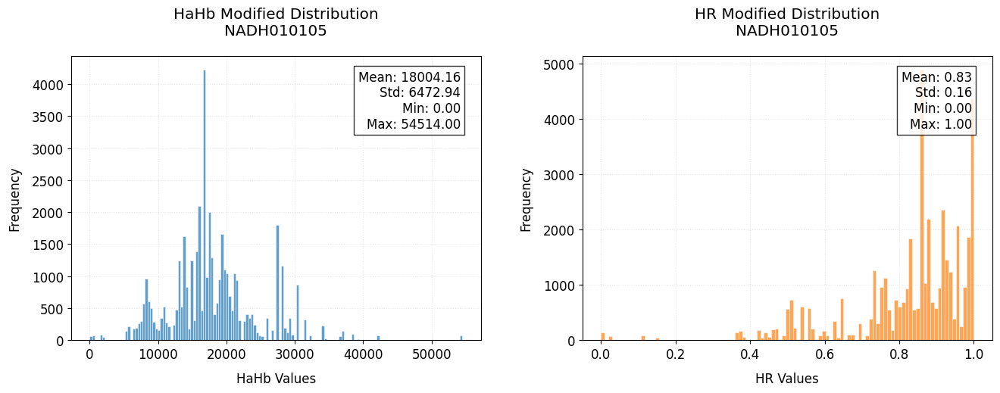

Processing files:  79%|██████████████████████████████████████████████████▎             | 22/28 [00:56<00:15,  2.67s/it]

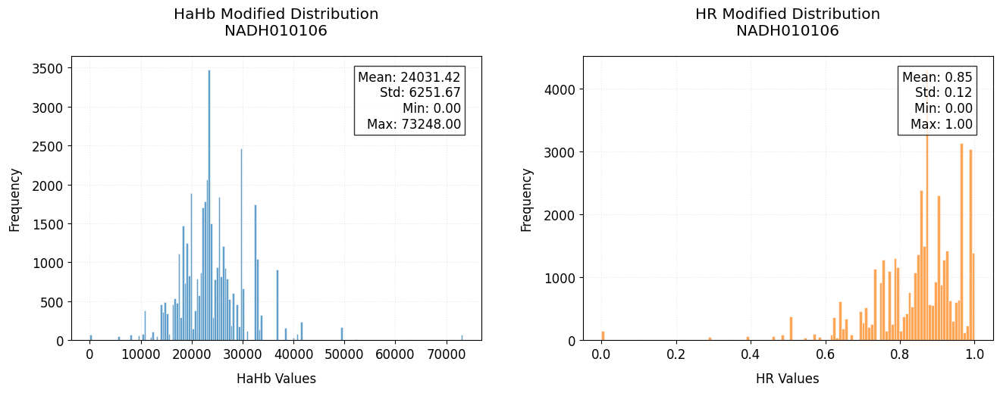

Processing files:  82%|████████████████████████████████████████████████████▌           | 23/28 [00:59<00:14,  2.83s/it]

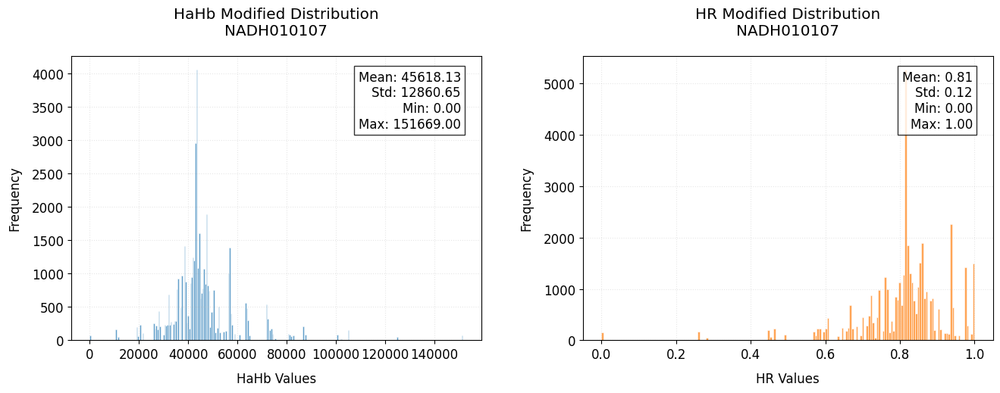

Processing files:  86%|██████████████████████████████████████████████████████▊         | 24/28 [01:03<00:12,  3.02s/it]

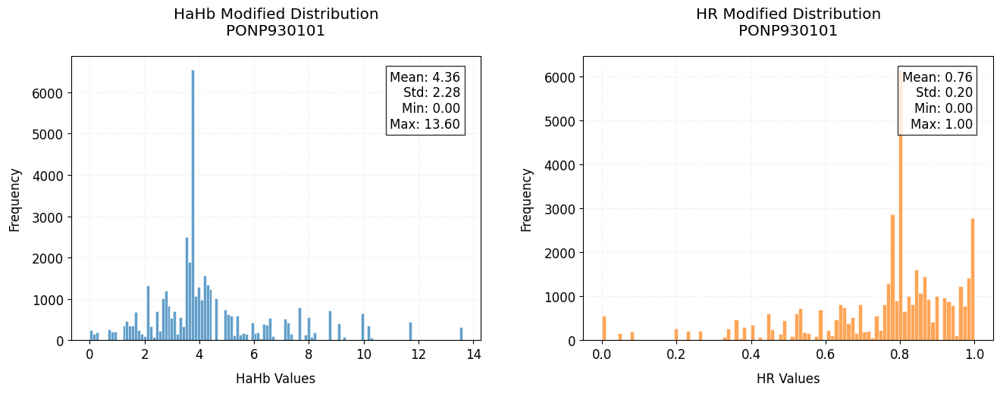

Processing files:  89%|█████████████████████████████████████████████████████████▏      | 25/28 [01:06<00:08,  2.90s/it]

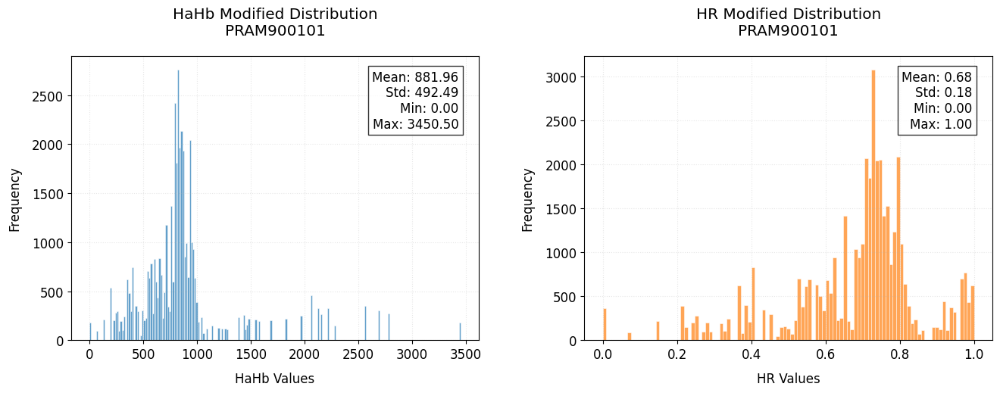

Processing files:  93%|███████████████████████████████████████████████████████████▍    | 26/28 [01:09<00:05,  2.91s/it]

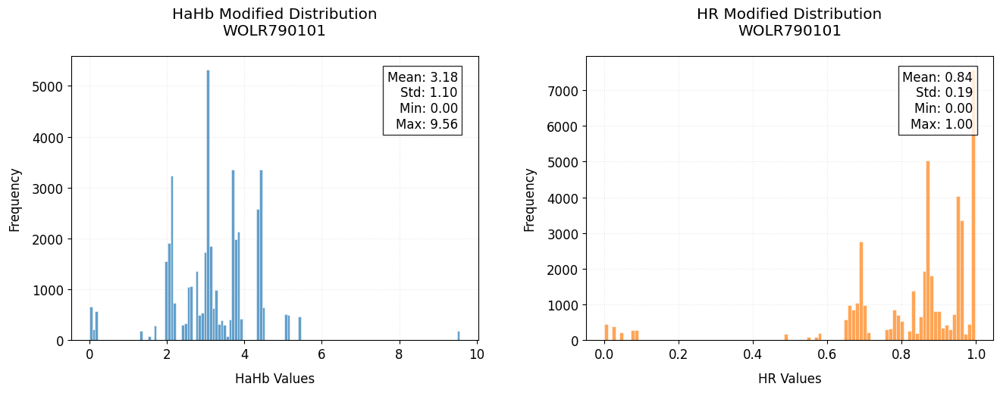

Processing files:  96%|█████████████████████████████████████████████████████████████▋  | 27/28 [01:10<00:02,  2.59s/it]

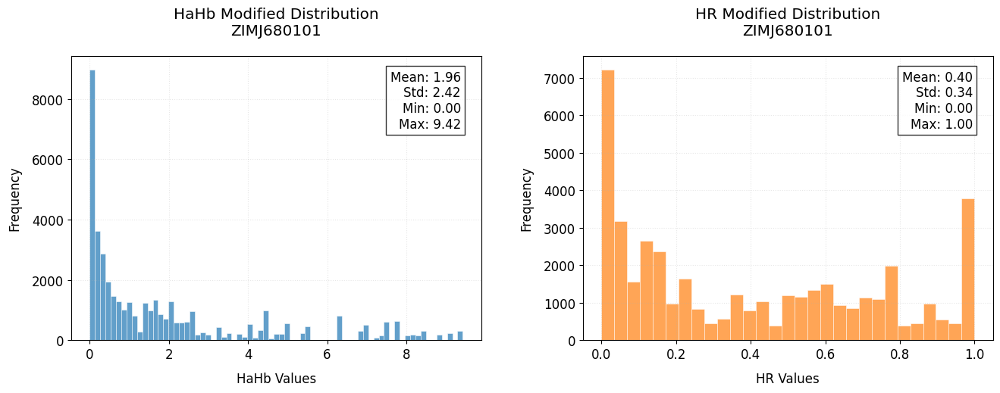

Processing files: 100%|████████████████████████████████████████████████████████████████| 28/28 [01:12<00:00,  2.60s/it]


Histogram plotting complete!


In [30]:

# Directory base_dir = "../generated_data/"
train_hahb_dir = os.path.join(base_dir, "train/HaHb_modified/")
test_hahb_dir = os.path.join(base_dir, "test/HaHb_modified/")
train_hr_dir = os.path.join(base_dir, "train/Hr_modified/")
test_hr_dir = os.path.join(base_dir, "test/Hr_modified/")

# Get all files
def get_file_list(directory):
    try:
        return {f.replace('.txt', '') for f in os.listdir(directory) if f.endswith('.txt')}
    except FileNotFoundError:
        print(f"Directory not found: {directory}")
        return set()

common_files = (get_file_list(train_hahb_dir) & 
               get_file_list(test_hahb_dir) & 
               get_file_list(train_hr_dir) & 
               get_file_list(test_hr_dir))

if not common_files:
    print("No common files found across all directories!")
    exit()

print(f"Found {len(common_files)} files to process")

# Set up figure size and style
plt.style.use('default')  # Using default style which is clean and modern
plt.rcParams['figure.figsize'] = [14, 6]
plt.rcParams['font.size'] = 12
plt.rcParams['axes.grid'] = True
plt.rcParams['grid.alpha'] = 0.3
plt.rcParams['grid.linestyle'] = ':'

for file_name in tqdm(sorted(common_files), desc="Processing files"):
    try:
        # Load all modified data with error checking
        def safe_load(path):
            data = np.loadtxt(path)
            if data.size == 0:
                raise ValueError("Empty data file")
            return data
            
        train_hahb = safe_load(os.path.join(train_hahb_dir, f"{file_name}.txt"))
        test_hahb = safe_load(os.path.join(test_hahb_dir, f"{file_name}.txt"))
        train_hr = safe_load(os.path.join(train_hr_dir, f"{file_name}.txt"))
        test_hr = safe_load(os.path.join(test_hr_dir, f"{file_name}.txt"))
        
        # Combine train and test data
        combined_hahb = np.concatenate([train_hahb.ravel(), test_hahb.ravel()])
        combined_hr = np.concatenate([train_hr.ravel(), test_hr.ravel()])
        
        # Create figure with two subplots
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 6))
        
        # Plot HaHb histogram on left
        n1, bins1, patches1 = ax1.hist(combined_hahb, bins='auto', 
                                      color='#1f77b4', alpha=0.7, 
                                      edgecolor='white', linewidth=0.5)
        ax1.set_title(f'HaHb Modified Distribution\n{file_name}', pad=20)
        ax1.set_xlabel('HaHb Values', labelpad=10)
        ax1.set_ylabel('Frequency', labelpad=10)
        
        # Add statistics box
        stats_text = (f"Mean: {combined_hahb.mean():.2f}\n"
                     f"Std: {combined_hahb.std():.2f}\n"
                     f"Min: {combined_hahb.min():.2f}\n"
                     f"Max: {combined_hahb.max():.2f}")
        ax1.text(0.95, 0.95, stats_text, transform=ax1.transAxes,
                ha='right', va='top', bbox=dict(facecolor='white', alpha=0.8))
        
        # Plot HR histogram on right
        n2, bins2, patches2 = ax2.hist(combined_hr, bins='auto',
                                      color='#ff7f0e', alpha=0.7,
                                      edgecolor='white', linewidth=0.5)
        ax2.set_title(f'HR Modified Distribution\n{file_name}', pad=20)
        ax2.set_xlabel('HR Values', labelpad=10)
        ax2.set_ylabel('Frequency', labelpad=10)
        
        # Add statistics box
        stats_text = (f"Mean: {combined_hr.mean():.2f}\n"
                     f"Std: {combined_hr.std():.2f}\n"
                     f"Min: {combined_hr.min():.2f}\n"
                     f"Max: {combined_hr.max():.2f}")
        ax2.text(0.95, 0.95, stats_text, transform=ax2.transAxes,
                ha='right', va='top', bbox=dict(facecolor='white', alpha=0.8))
        
        plt.tight_layout(pad=3.0)
        plt.show()
        
    except Exception as e:
        print(f"\nError processing {file_name}: {str(e)}")
        if 'combined_hahb' in locals() and 'combined_hr' in locals():
            print(f"HaHb data shape: {combined_hahb.shape}")
            print(f"HR data shape: {combined_hr.shape}")
        continue

print("\nHistogram plotting complete!")


# HR Data Power Transformation Analysis

This code performs Yeo-Johnson power transformation on HR data from training and test sets, comparing original and transformed distributionsrocessing {file_name}: {str(e)}")
            continue

Found 28 files to process


Processing files:   0%|                                                                         | 0/28 [00:00<?, ?it/s]

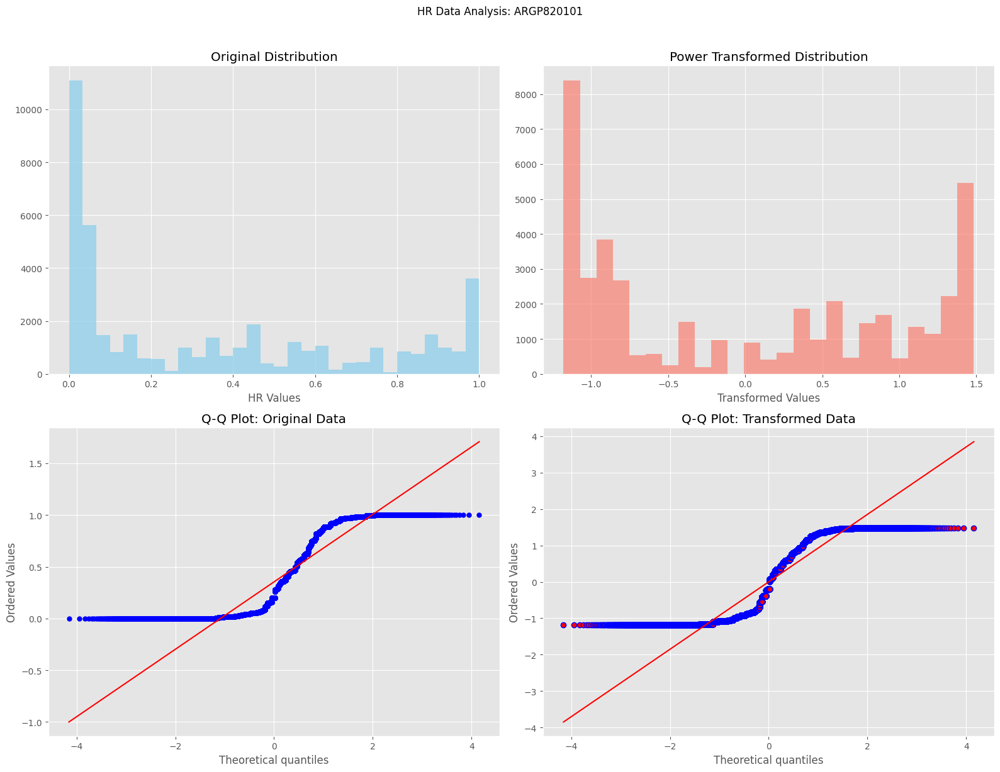

Processing files:   4%|██▎                                                              | 1/28 [00:03<01:36,  3.58s/it]

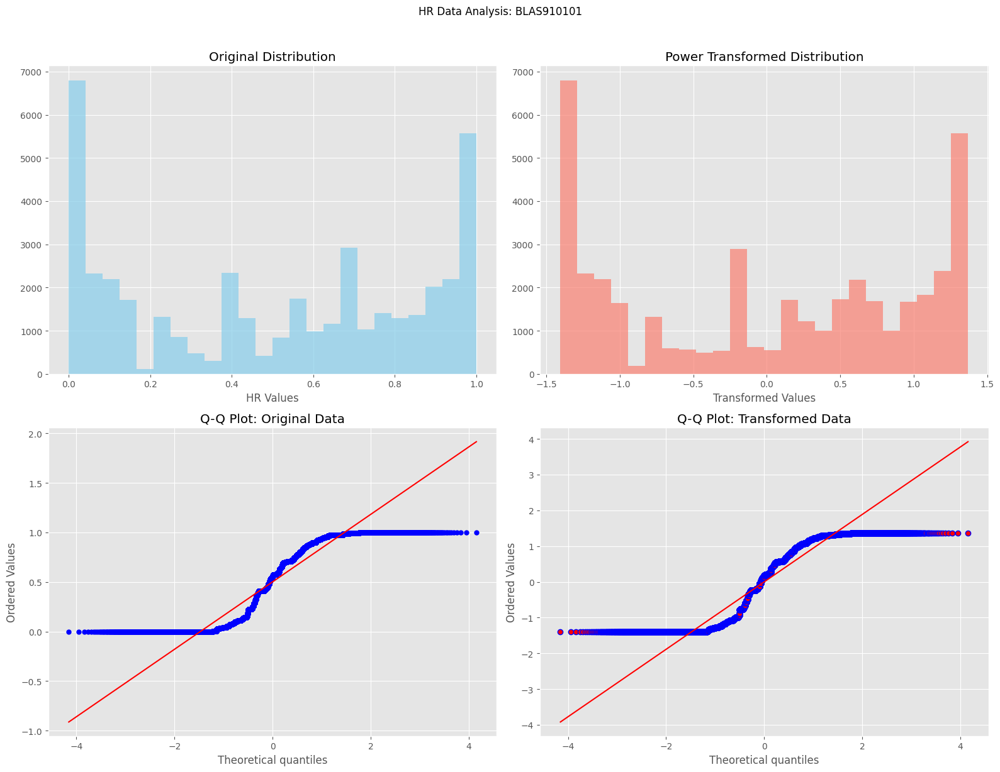

Processing files:   7%|████▋                                                            | 2/28 [00:07<01:34,  3.65s/it]

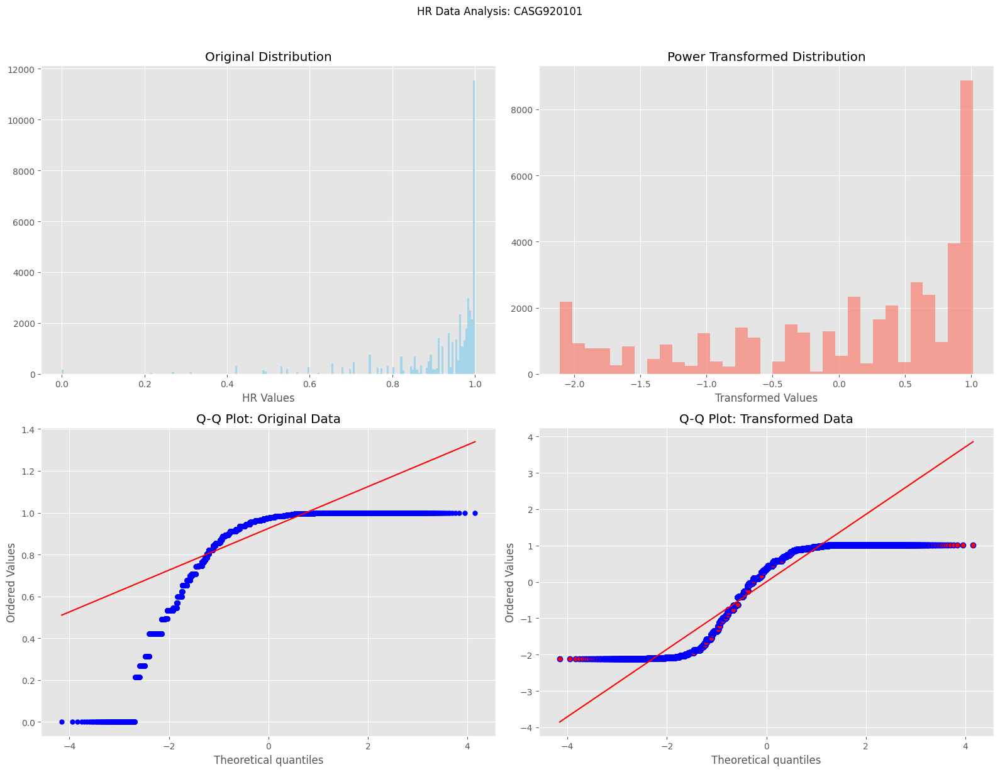

Processing files:  11%|██████▉                                                          | 3/28 [00:11<01:38,  3.92s/it]

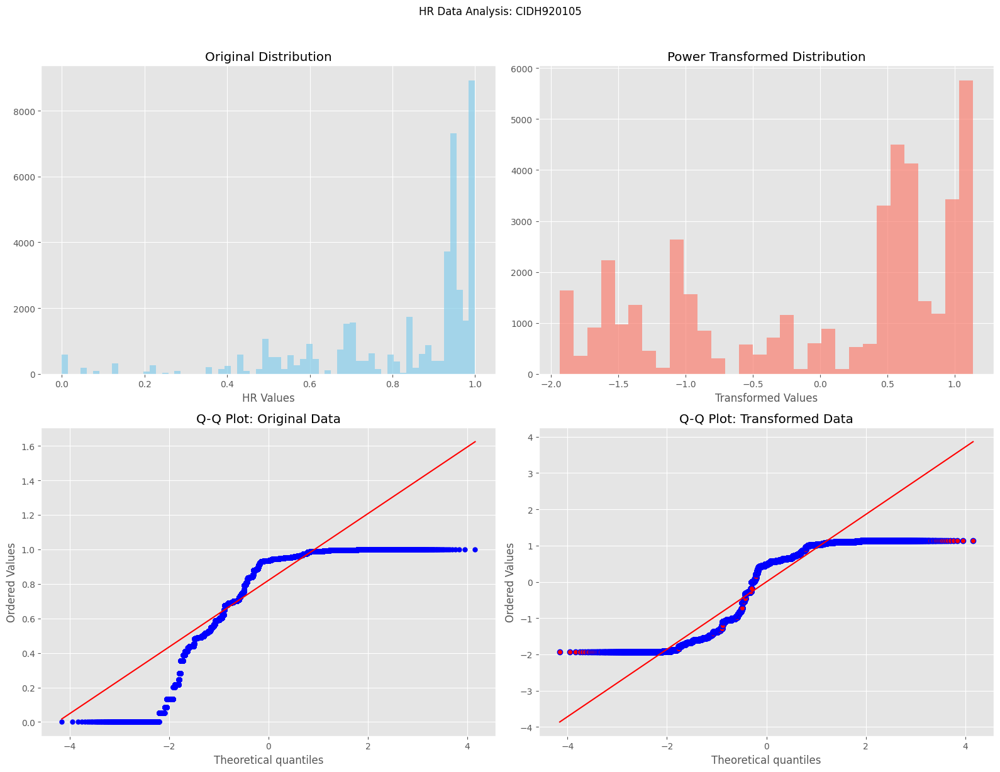

Processing files:  14%|█████████▎                                                       | 4/28 [00:15<01:32,  3.87s/it]

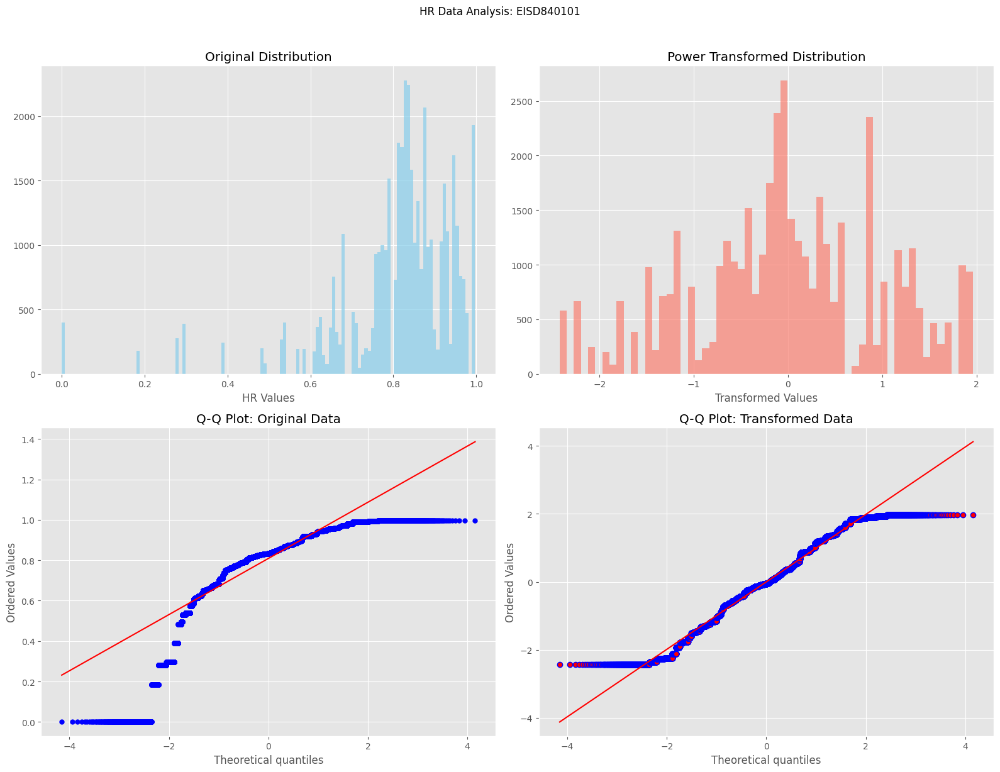

Processing files:  18%|███████████▌                                                     | 5/28 [00:18<01:25,  3.72s/it]

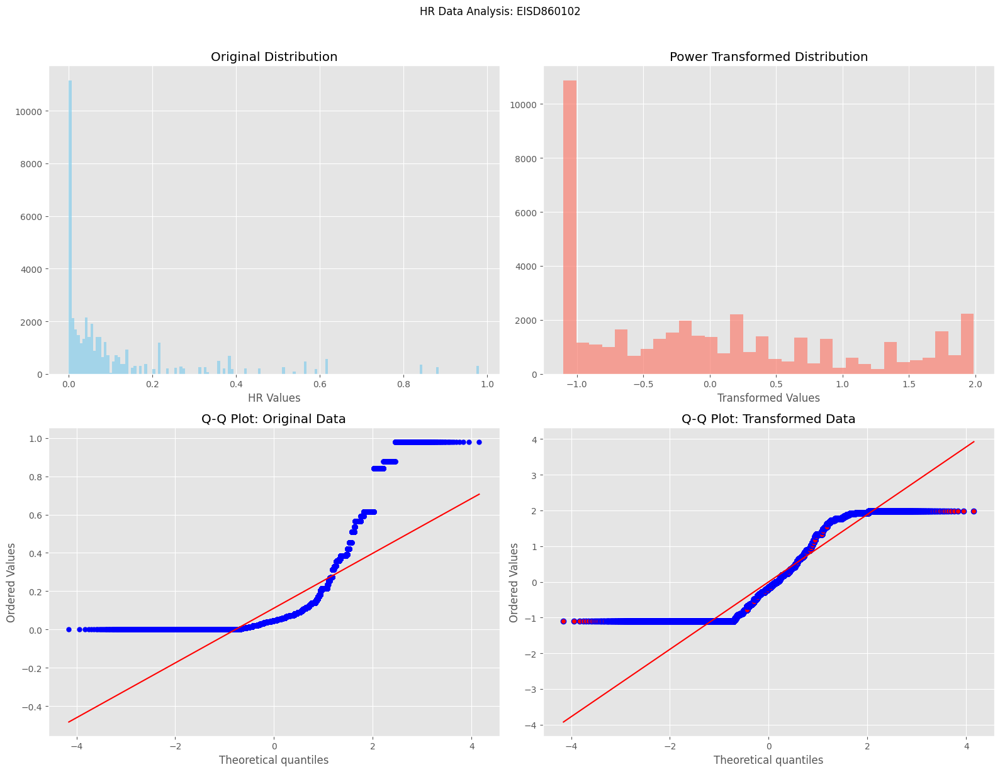

Processing files:  21%|█████████████▉                                                   | 6/28 [00:22<01:24,  3.83s/it]

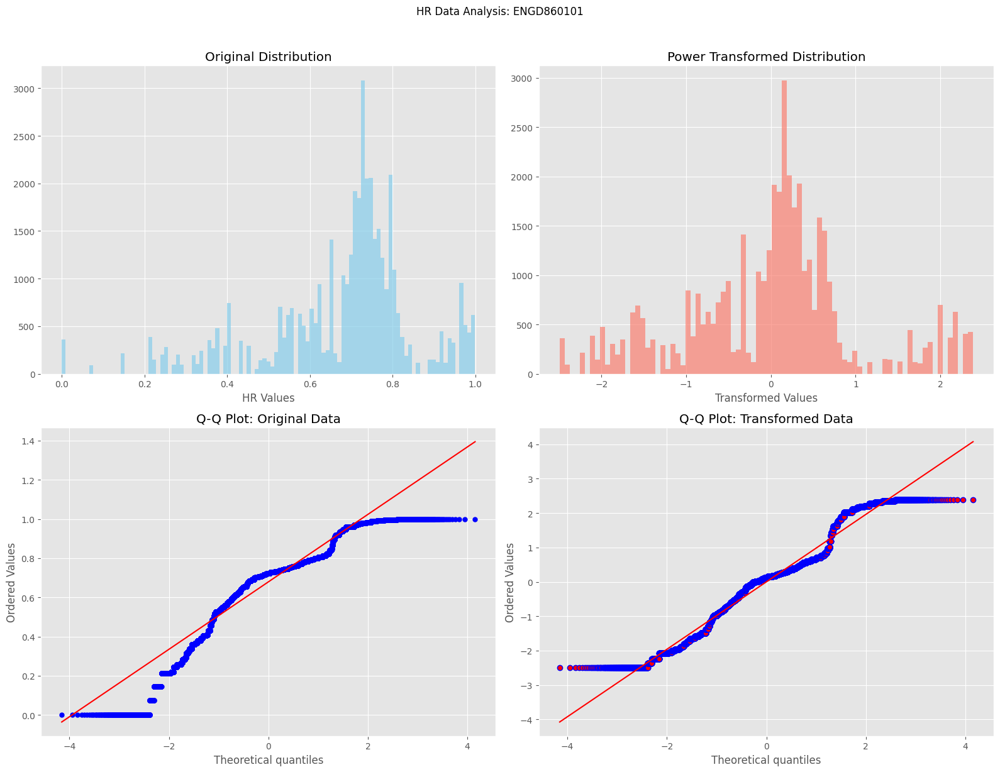

Processing files:  25%|████████████████▎                                                | 7/28 [00:27<01:23,  3.99s/it]

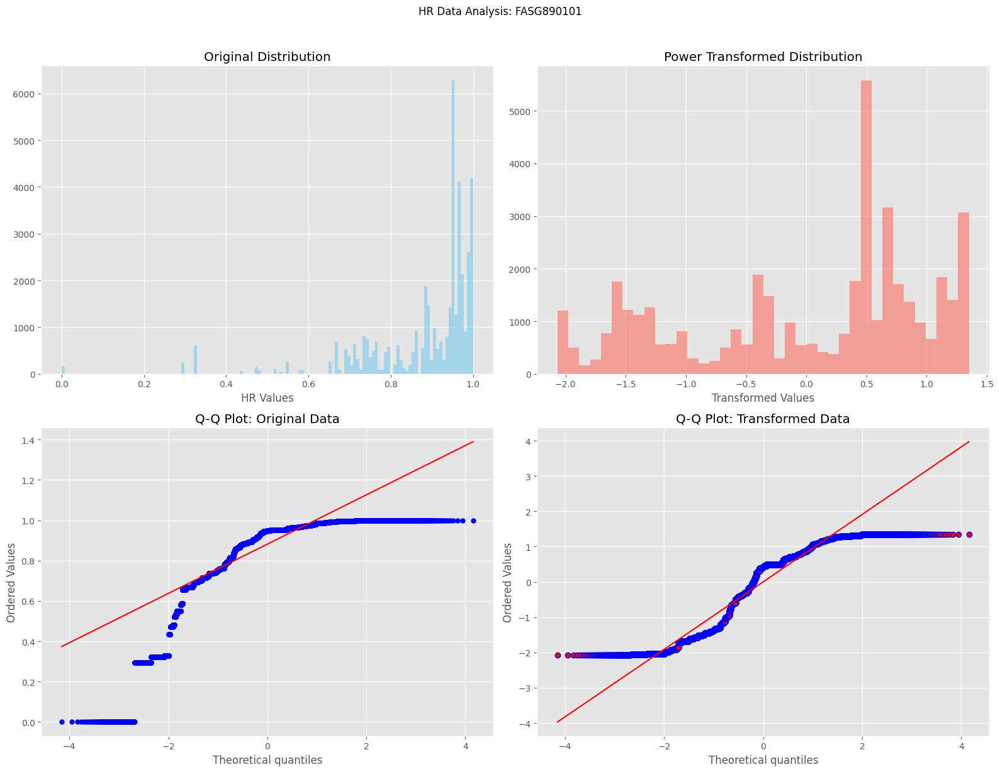

Processing files:  29%|██████████████████▌                                              | 8/28 [00:30<01:18,  3.90s/it]

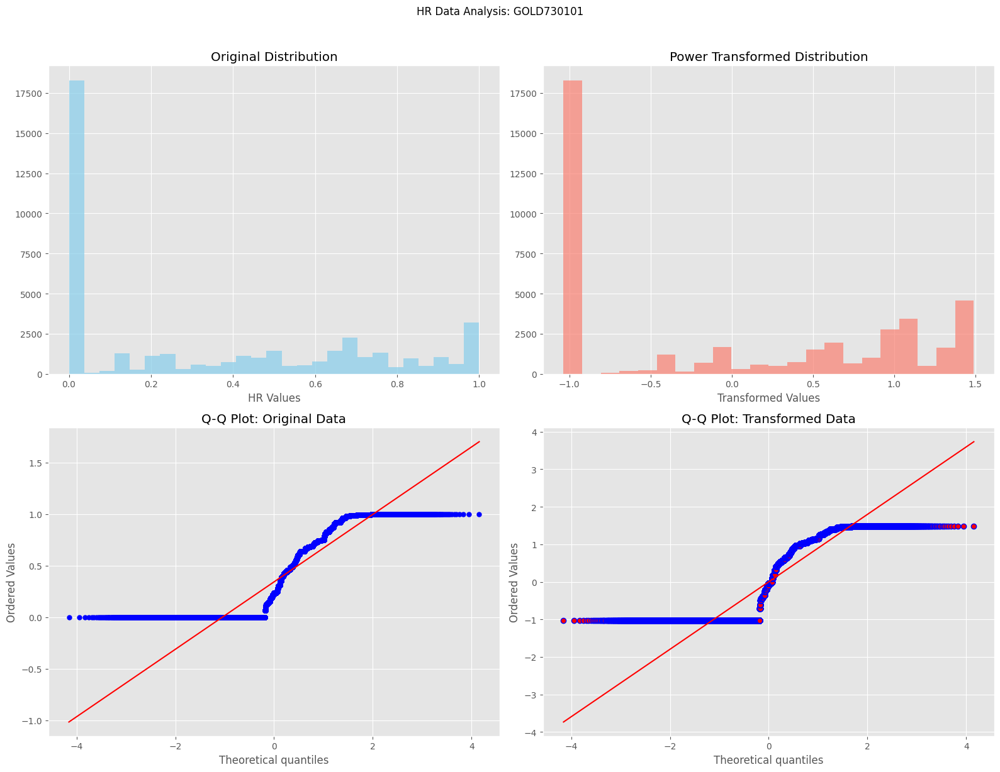

Processing files:  32%|████████████████████▉                                            | 9/28 [00:34<01:11,  3.76s/it]

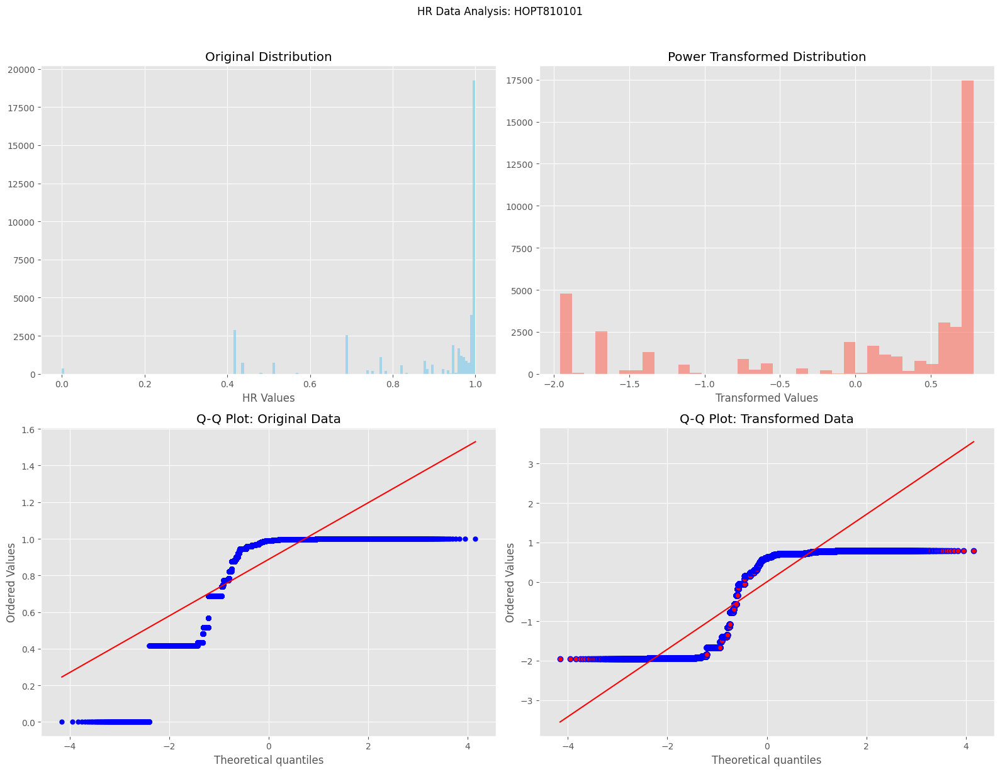

Processing files:  36%|██████████████████████▊                                         | 10/28 [00:38<01:11,  3.95s/it]

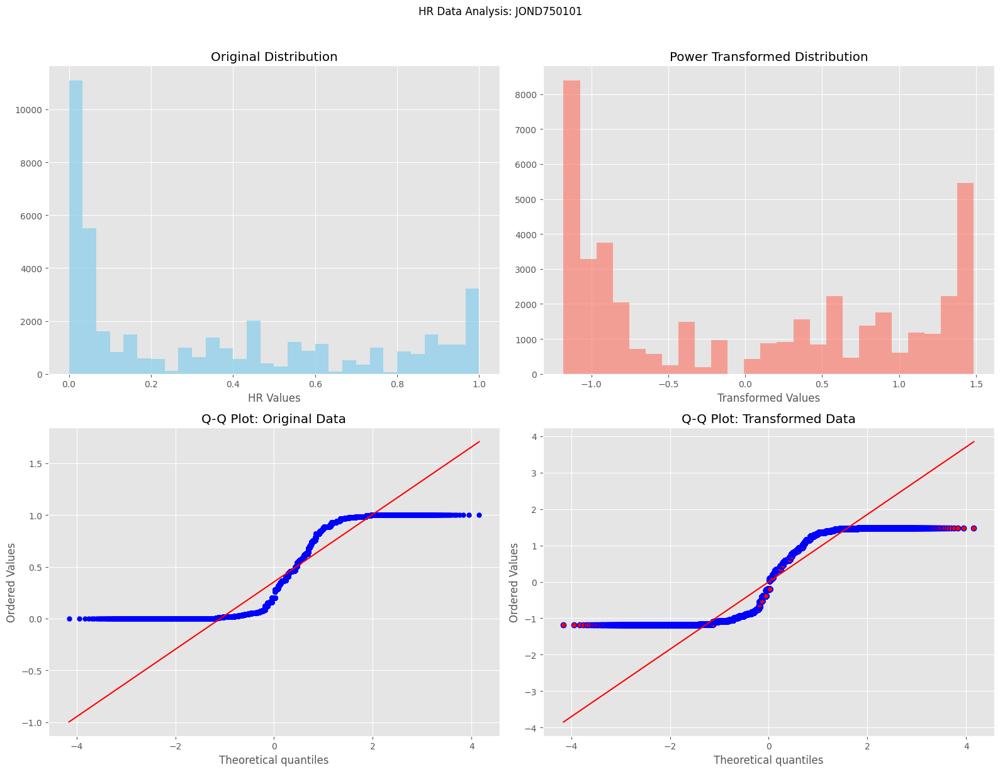

Processing files:  39%|█████████████████████████▏                                      | 11/28 [00:42<01:04,  3.78s/it]

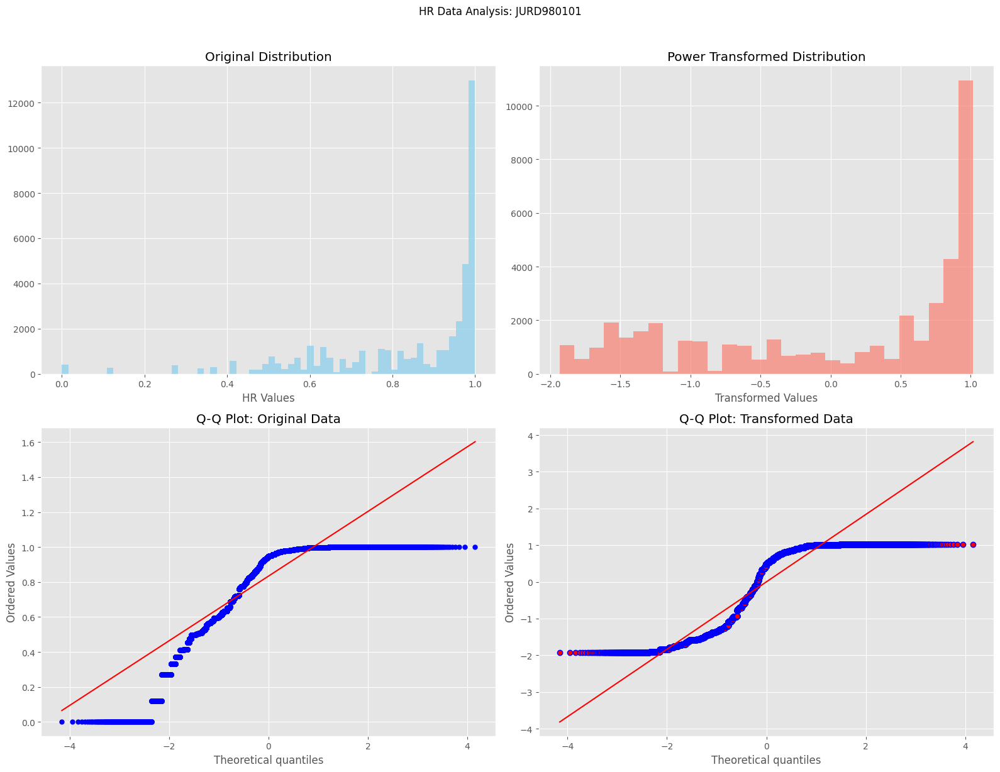

Processing files:  43%|███████████████████████████▍                                    | 12/28 [00:45<00:59,  3.71s/it]

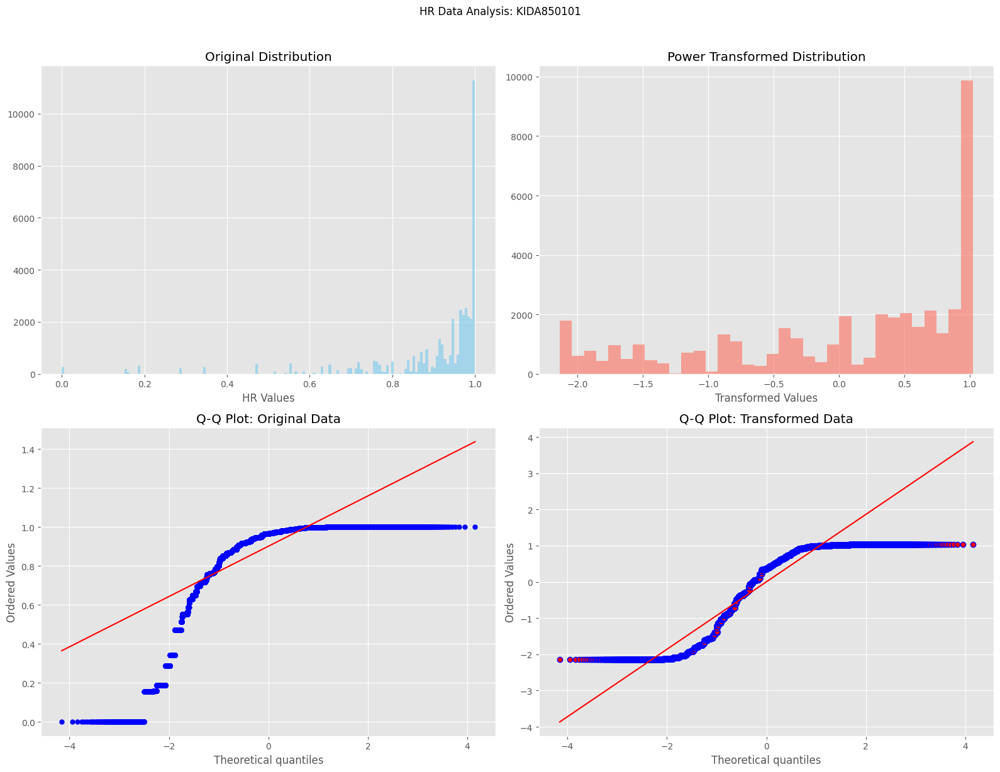

Processing files:  46%|█████████████████████████████▋                                  | 13/28 [00:49<00:56,  3.79s/it]

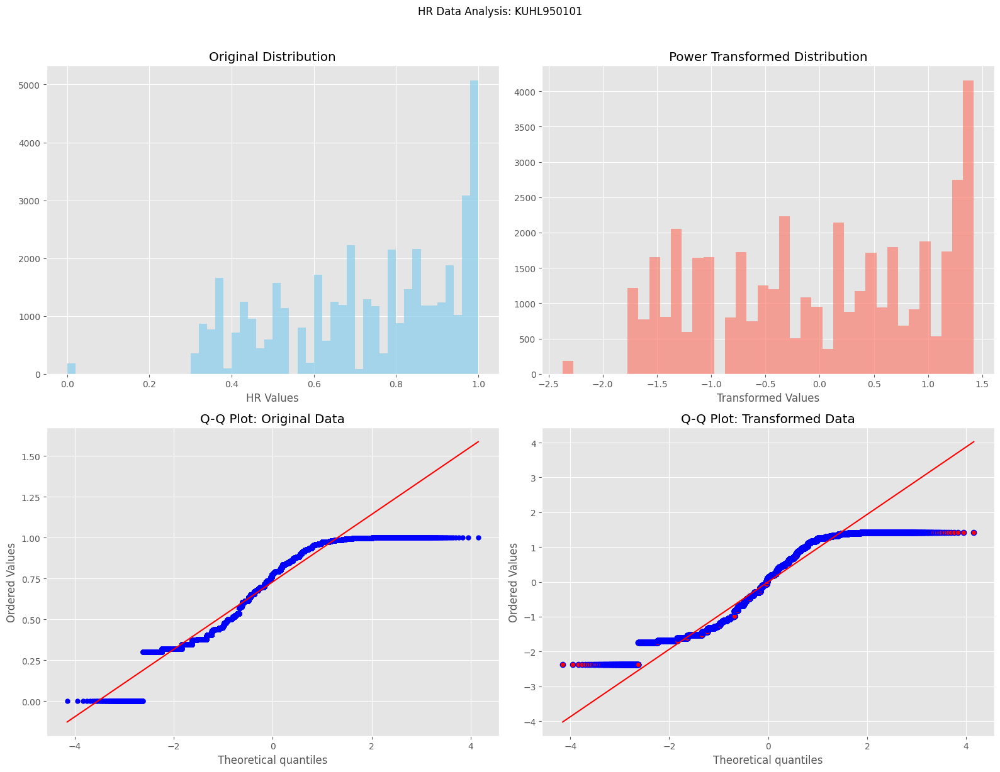

Processing files:  50%|████████████████████████████████                                | 14/28 [00:53<00:52,  3.76s/it]

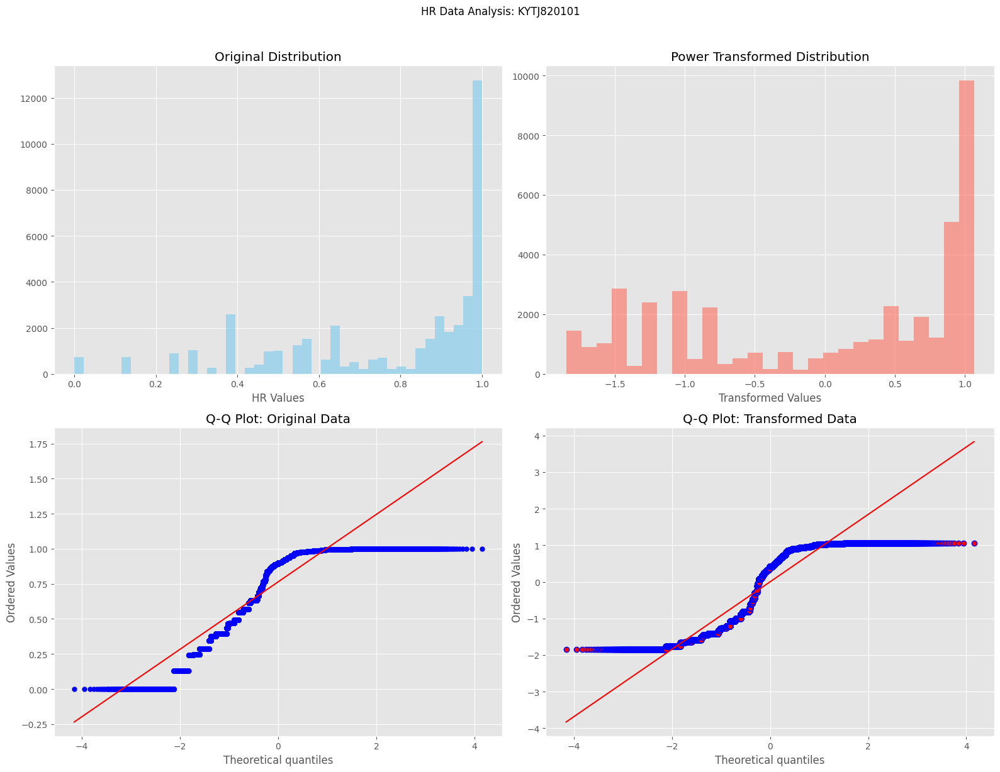

Processing files:  54%|██████████████████████████████████▎                             | 15/28 [00:56<00:48,  3.70s/it]

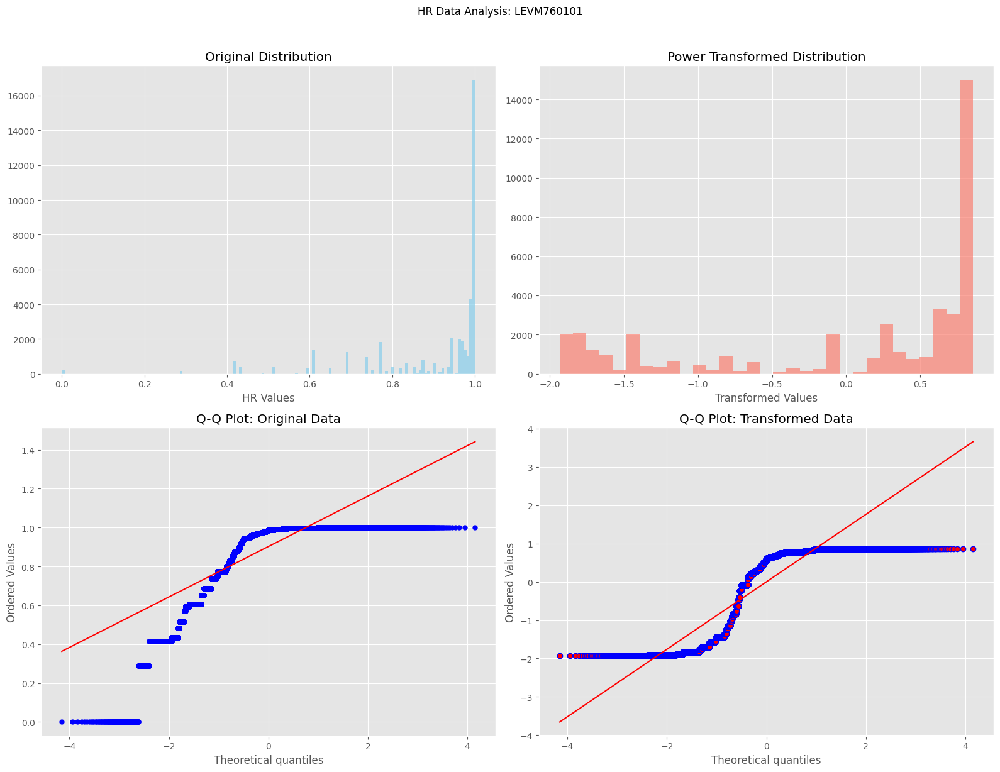

Processing files:  57%|████████████████████████████████████▌                           | 16/28 [01:01<00:47,  3.94s/it]

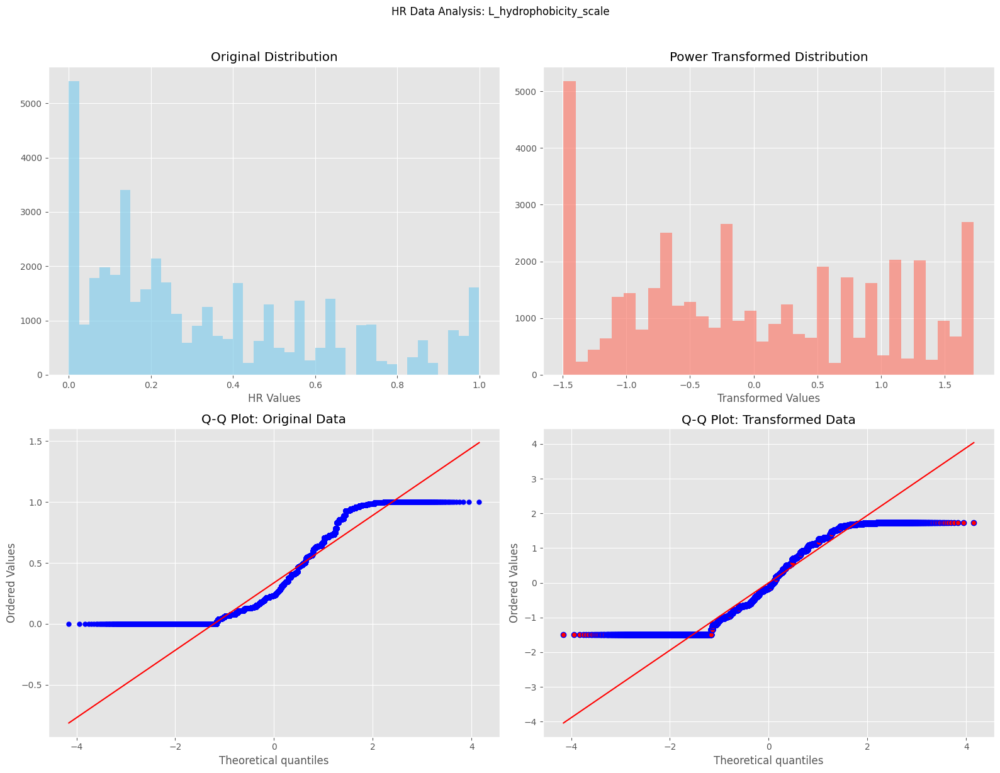

Processing files:  61%|██████████████████████████████████████▊                         | 17/28 [01:05<00:42,  3.86s/it]

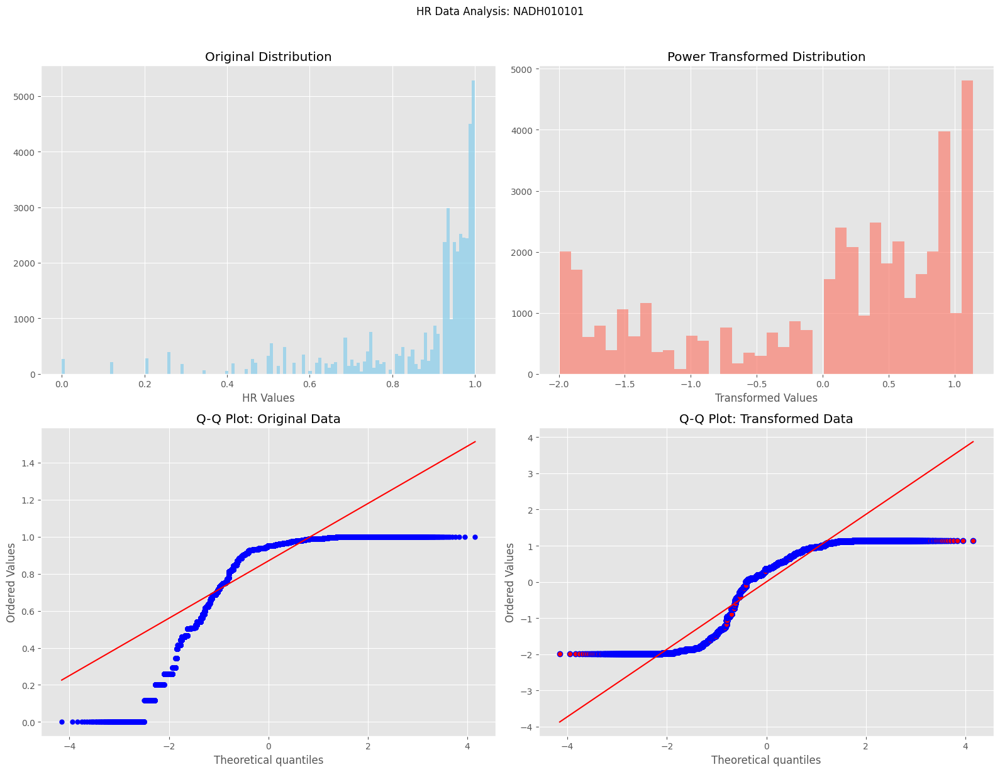

Processing files:  64%|█████████████████████████████████████████▏                      | 18/28 [01:08<00:38,  3.83s/it]

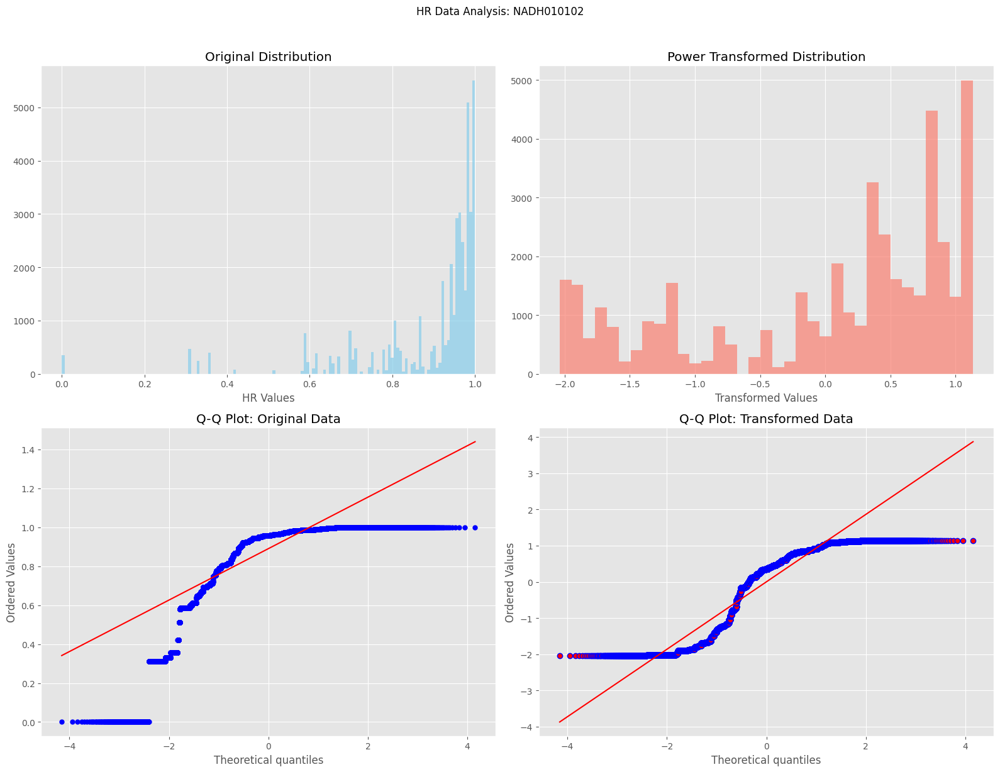

Processing files:  68%|███████████████████████████████████████████▍                    | 19/28 [01:12<00:34,  3.84s/it]

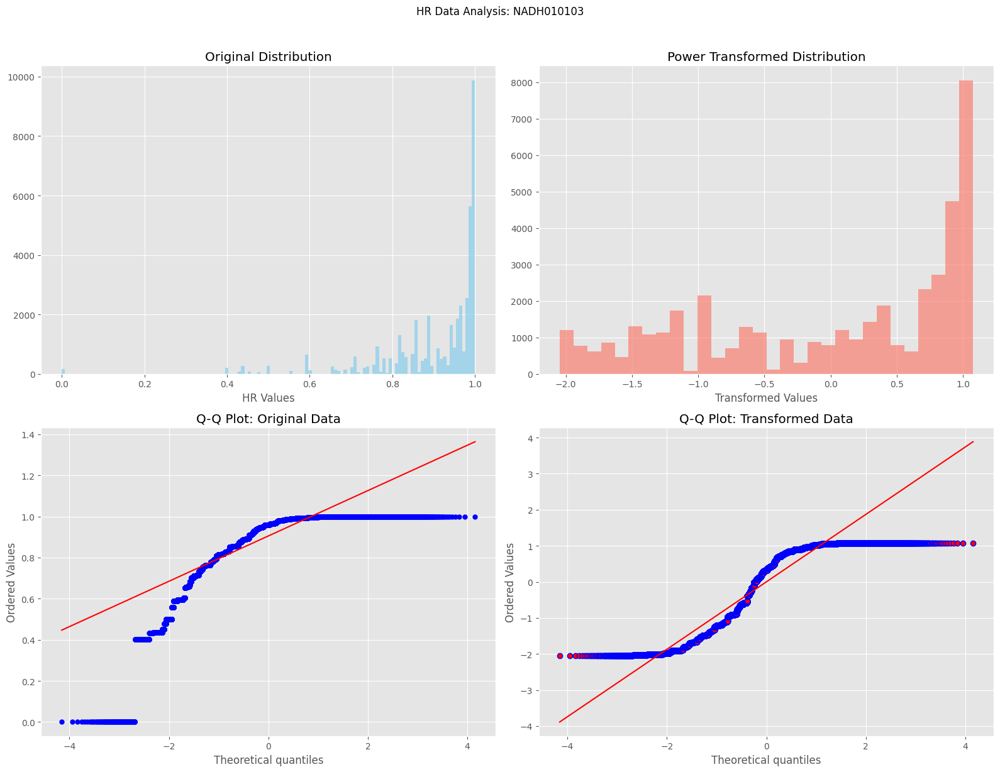

Processing files:  71%|█████████████████████████████████████████████▋                  | 20/28 [01:16<00:31,  3.90s/it]

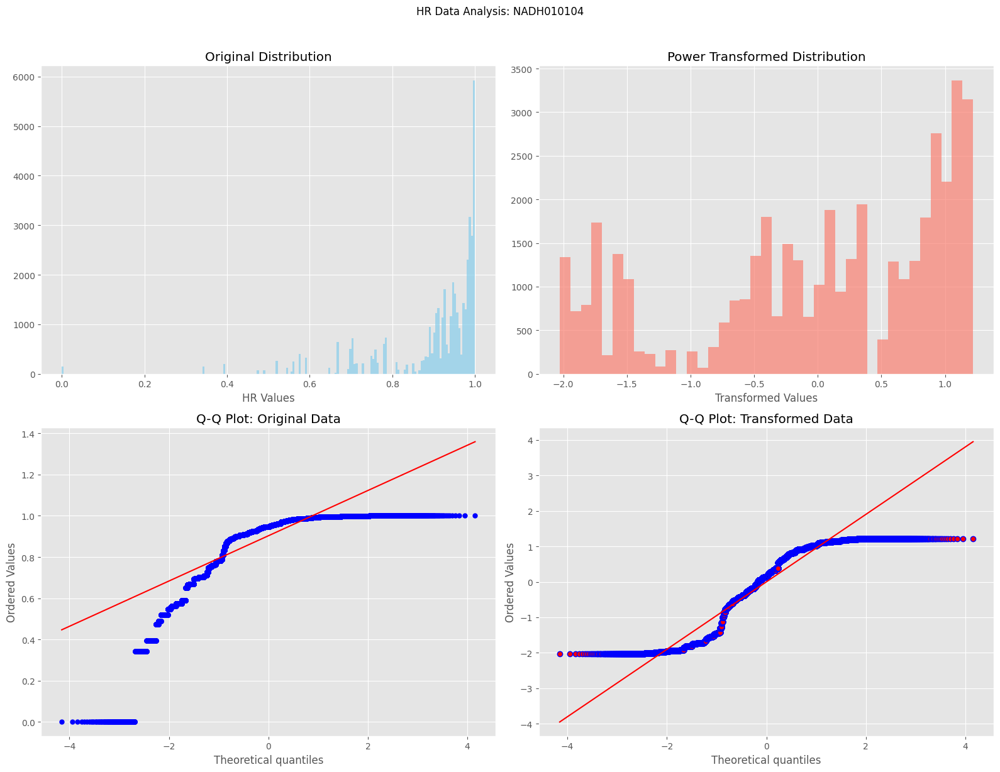

Processing files:  75%|████████████████████████████████████████████████                | 21/28 [01:20<00:27,  3.98s/it]

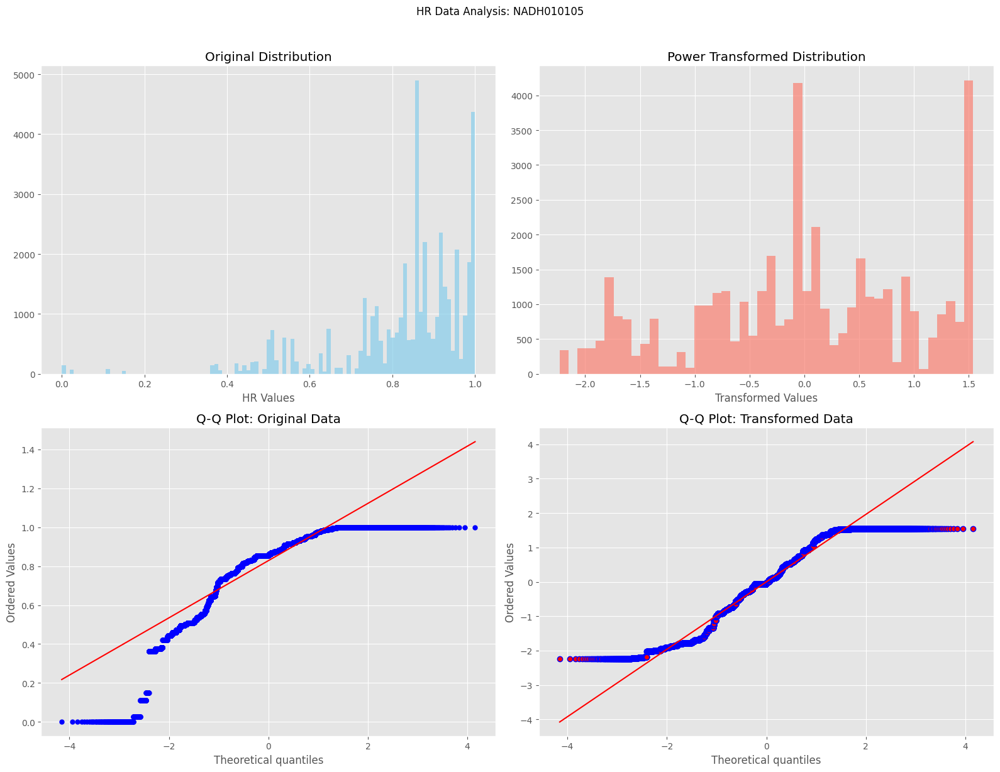

Processing files:  79%|██████████████████████████████████████████████████▎             | 22/28 [01:25<00:24,  4.11s/it]

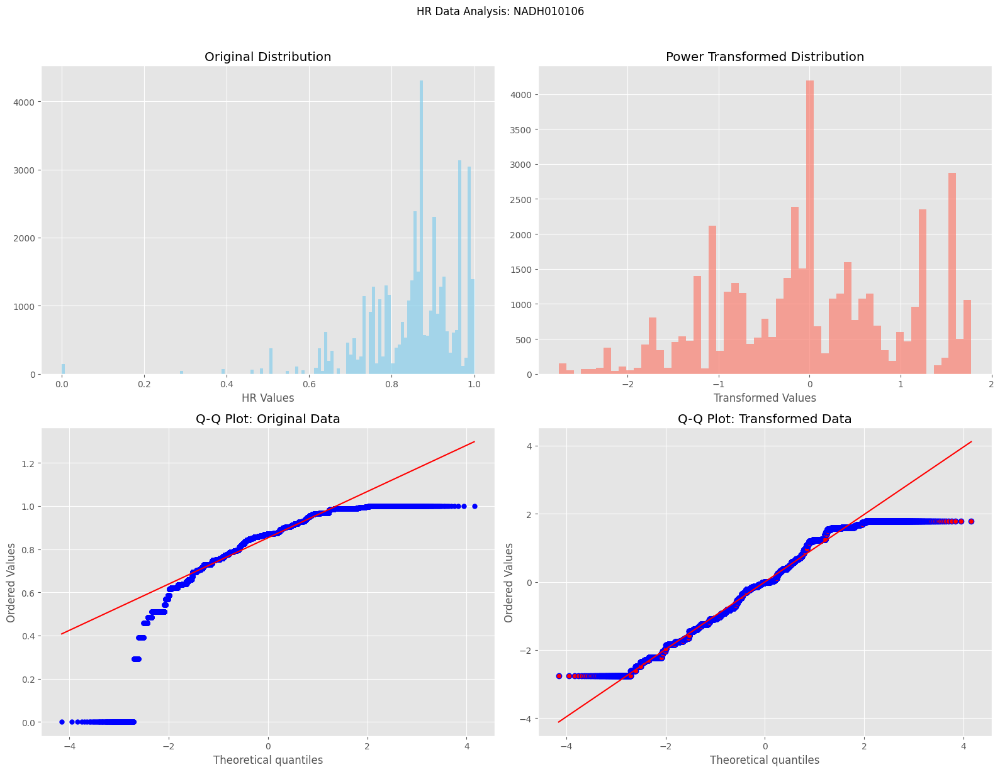

Processing files:  82%|████████████████████████████████████████████████████▌           | 23/28 [01:29<00:21,  4.23s/it]

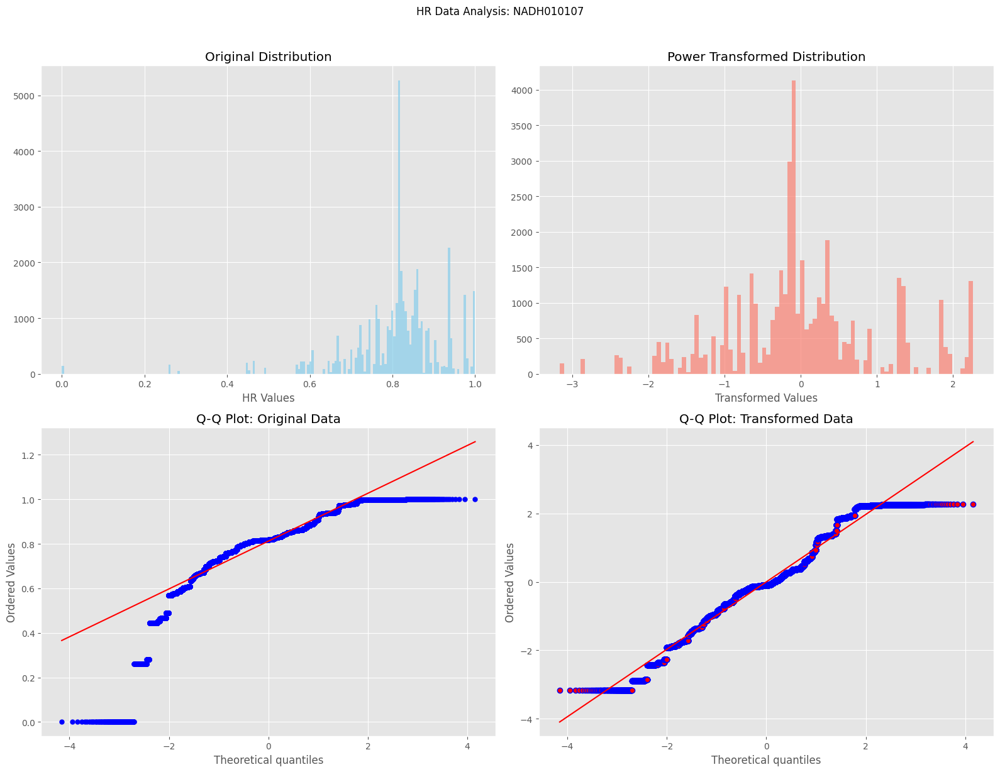

Processing files:  86%|██████████████████████████████████████████████████████▊         | 24/28 [01:34<00:17,  4.42s/it]

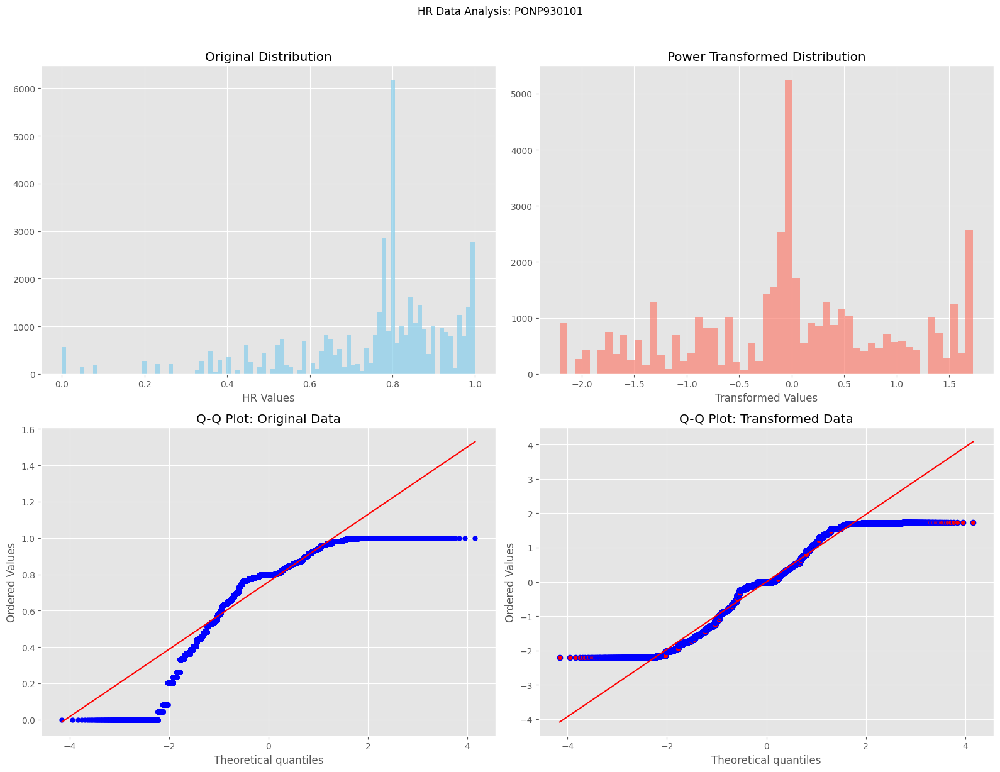

Processing files:  89%|█████████████████████████████████████████████████████████▏      | 25/28 [01:38<00:13,  4.39s/it]

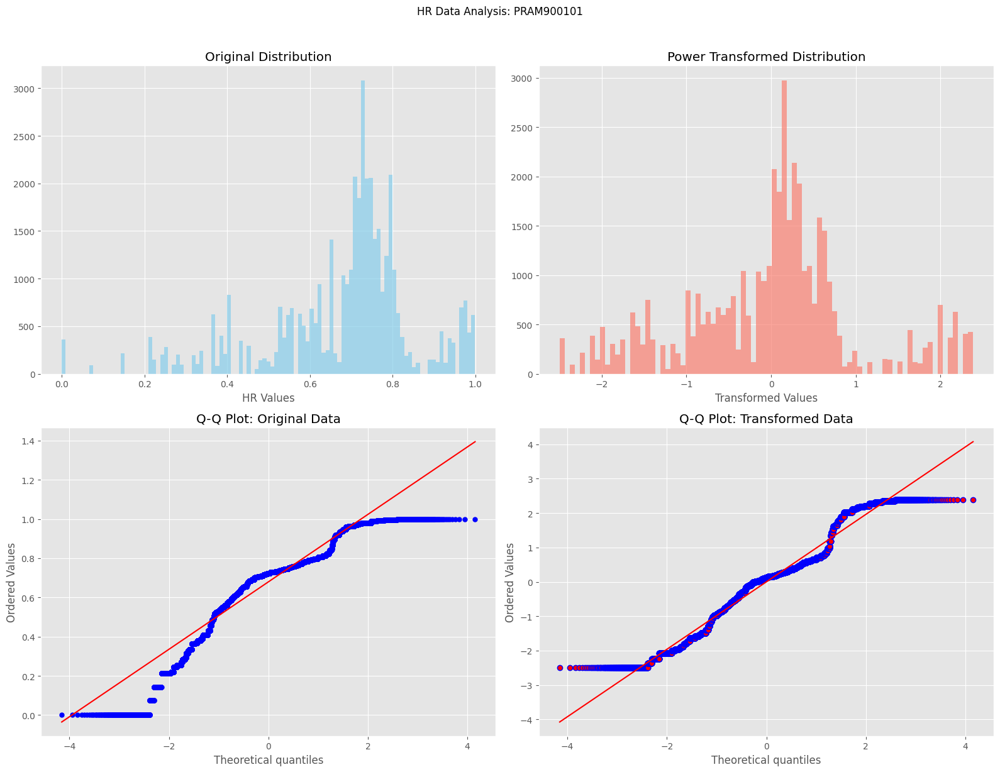

Processing files:  93%|███████████████████████████████████████████████████████████▍    | 26/28 [01:43<00:08,  4.40s/it]

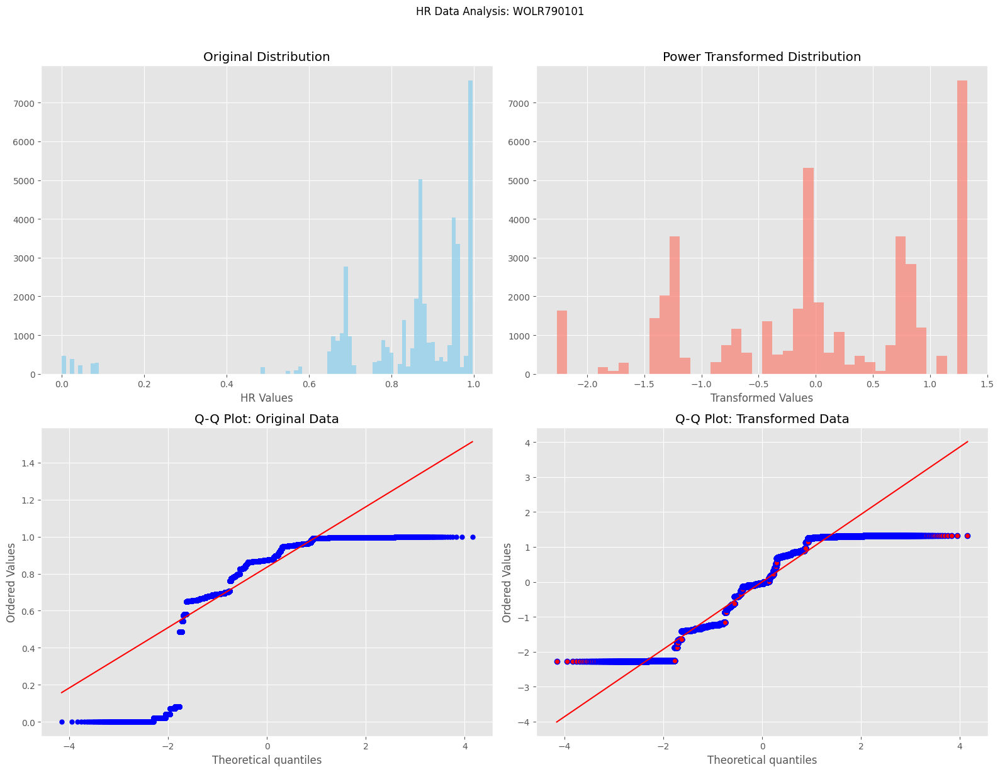

Processing files:  96%|█████████████████████████████████████████████████████████████▋  | 27/28 [01:47<00:04,  4.24s/it]

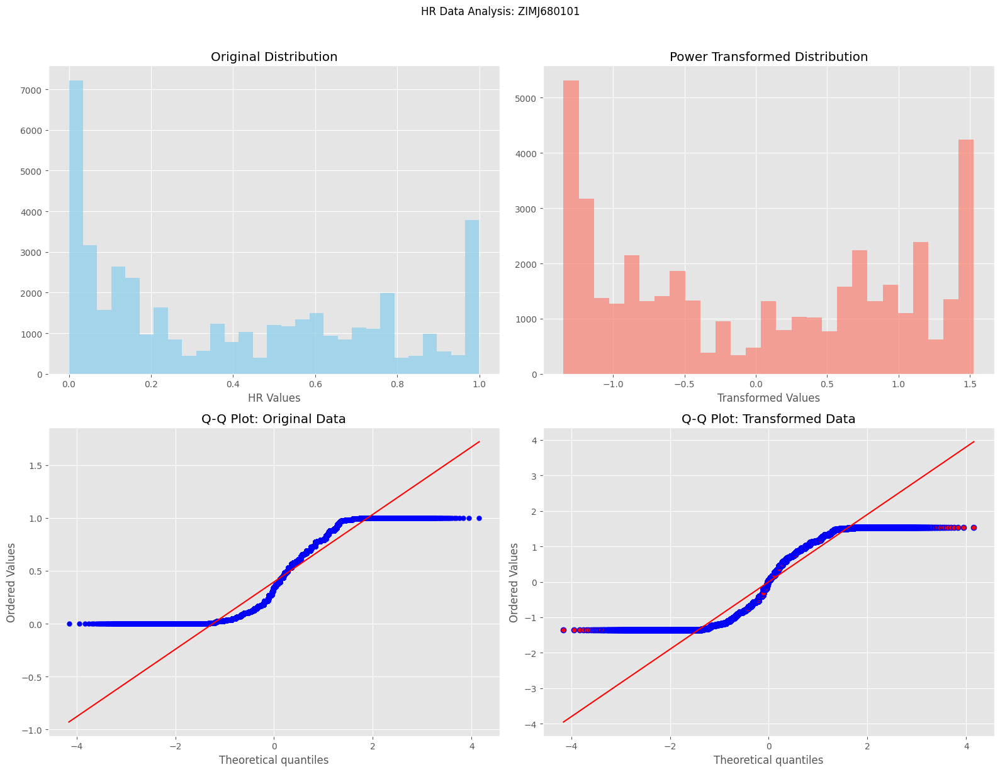

Processing files: 100%|████████████████████████████████████████████████████████████████| 28/28 [01:50<00:00,  3.96s/it]


Analysis complete!


In [1]:


# Get all files
def get_file_list(directory):
    return {f.replace('.txt', '') for f in os.listdir(directory) if f.endswith('.txt')}

common_files = get_file_list(train_hr_dir) & get_file_list(test_hr_dir)

if not common_files:
    print("No common files found!")
    exit()

print(f"Found {len(common_files)} files to process")

plt.style.use('ggplot')
plt.rcParams['figure.figsize'] = [16, 8]

for file_name in tqdm(sorted(common_files), desc="Processing files"):
    try:
        # Load and combine data
        train_hr = np.loadtxt(os.path.join(train_hr_dir, f"{file_name}.txt"))
        test_hr = np.loadtxt(os.path.join(test_hr_dir, f"{file_name}.txt"))
        combined_hr = np.concatenate([train_hr.ravel(), test_hr.ravel()])
        
        # Power transformation
        transformer = PowerTransformer(method='yeo-johnson')
        hr_transformed = transformer.fit_transform(combined_hr.reshape(-1, 1)).flatten()
        
        # Create figure
        fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(16, 12))
        fig.suptitle(f'HR Data Analysis: {file_name}', y=1.02)
        
        # Original histogram
        ax1.hist(combined_hr, bins='auto', color='skyblue', alpha=0.7)
        ax1.set_title('Original Distribution')
        ax1.set_xlabel('HR Values')
        
        # Transformed histogram
        ax2.hist(hr_transformed, bins='auto', color='salmon', alpha=0.7)
        ax2.set_title('Power Transformed Distribution')
        ax2.set_xlabel('Transformed Values')
        
        # Original Q-Q plot
        stats.probplot(combined_hr, dist="norm", plot=ax3)
        ax3.set_title('Q-Q Plot: Original Data')
        ax3.get_lines()[0].set_markerfacecolor('blue')
        ax3.get_lines()[0].set_markersize(5.0)
        
        # Transformed Q-Q plot
        stats.probplot(hr_transformed, dist="norm", plot=ax4)
        ax4.set_title('Q-Q Plot: Transformed Data') 
        ax4.get_lines()[0].set_markerfacecolor('red')
        
        plt.tight_layout()
        plt.show()
        
    except Exception as e:
        print(f"\nError processing {file_name}: {str(e)}")
        continue

print("\nAnalysis complete!")

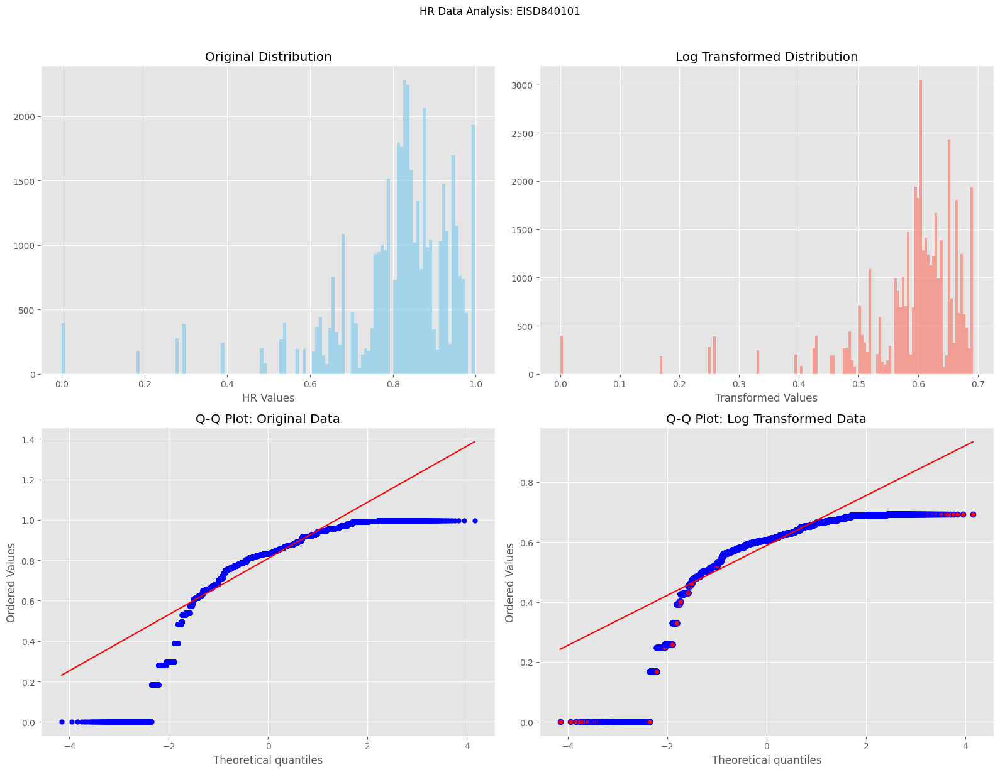

In [13]:

# Directory setup
base_dir = "../generated_data/"
train_hr_dir = os.path.join(base_dir, "train/Hr_modified/")
test_hr_dir = os.path.join(base_dir, "test/Hr_modified/")

# File to process
file_name = "EISD840101"

try:
    # Load and combine data
    train_hr = np.loadtxt(os.path.join(train_hr_dir, f"{file_name}.txt"))
    test_hr = np.loadtxt(os.path.join(test_hr_dir, f"{file_name}.txt"))
    combined_hr = np.concatenate([train_hr.ravel(), test_hr.ravel()])
    
    # Apply Log Transformation (adding a small constant to avoid log(0))
    log_transformed = np.log1p(combined_hr)
    
    # Create figure
    fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(16, 12))
    fig.suptitle(f'HR Data Analysis: {file_name}', y=1.02)
    
    # Original histogram
    ax1.hist(combined_hr, bins='auto', color='skyblue', alpha=0.7)
    ax1.set_title('Original Distribution')
    ax1.set_xlabel('HR Values')
    
    # Transformed histogram
    ax2.hist(log_transformed, bins='auto', color='salmon', alpha=0.7)
    ax2.set_title('Log Transformed Distribution')
    ax2.set_xlabel('Transformed Values')
    
    # Original Q-Q plot
    stats.probplot(combined_hr, dist="norm", plot=ax3)
    ax3.set_title('Q-Q Plot: Original Data')
    ax3.get_lines()[0].set_markerfacecolor('blue')
    ax3.get_lines()[0].set_markersize(5.0)
    
    # Transformed Q-Q plot
    stats.probplot(log_transformed, dist="norm", plot=ax4)
    ax4.set_title('Q-Q Plot: Log Transformed Data')
    ax4.get_lines()[0].set_markerfacecolor('red')
    
    plt.tight_layout()
    plt.show()
    
except Exception as e:
    print(f"\nError processing {file_name}: {str(e)}")

In [5]:
import os
import numpy as np
import matplotlib.pyplot as plt
import scipy.stats as stats
from sklearn.preprocessing import PowerTransformer
from tqdm import tqdm

# Directory setup
base_dir = "../generated_data/"
train_hr_dir = os.path.join(base_dir, "train/Hr_modified/")
test_hr_dir = os.path.join(base_dir, "test/Hr_modified/")

# Get all files
def get_file_list(directory):
    return {f.replace('.txt', '') for f in os.listdir(directory) if f.endswith('.txt')}

common_files = get_file_list(train_hr_dir) & get_file_list(test_hr_dir)

if not common_files:
    print("No common files found!")
    exit()

print(f"Found {len(common_files)} files to process")

plt.style.use('ggplot')
plt.rcParams['figure.figsize'] = [16, 8]

for file_name in tqdm(sorted(common_files), desc="Processing files"):
    try:
        # Load and combine data
        train_hr = np.loadtxt(os.path.join(train_hr_dir, f"{file_name}.txt"))
        test_hr = np.loadtxt(os.path.join(test_hr_dir, f"{file_name}.txt"))
        combined_hr = np.concatenate([train_hr.ravel(), test_hr.ravel()])
        
        # Check if data contains non-positive values (Box-Cox requires strictly positive values)
        if np.any(combined_hr <= 0):
            print(f"Skipping Box-Cox transformation for {file_name} (contains zero or negative values)")
            continue
        
        # Apply Box-Cox transformation
        transformer = PowerTransformer(method='box-cox')
        hr_transformed = transformer.fit_transform(combined_hr.reshape(-1, 1)).flatten()
        
        # Create figure
        fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(16, 12))
        fig.suptitle(f'HR Data Analysis: {file_name}', y=1.02)
        
        # Original histogram
        ax1.hist(combined_hr, bins='auto', color='skyblue', alpha=0.7)
        ax1.set_title('Original Distribution')
        ax1.set_xlabel('HR Values')
        
        # Transformed histogram
        ax2.hist(hr_transformed, bins='auto', color='salmon', alpha=0.7)
        ax2.set_title('Box-Cox Transformed Distribution')
        ax2.set_xlabel('Transformed Values')
        
        # Original Q-Q plot
        stats.probplot(combined_hr, dist="norm", plot=ax3)
        ax3.set_title('Q-Q Plot: Original Data')
        ax3.get_lines()[0].set_markerfacecolor('blue')
        ax3.get_lines()[0].set_markersize(5.0)
        
        # Transformed Q-Q plot
        stats.probplot(hr_transformed, dist="norm", plot=ax4)
        ax4.set_title('Q-Q Plot: Box-Cox Transformed Data')
        ax4.get_lines()[0].set_markerfacecolor('red')
        
        plt.tight_layout()
        plt.show()
        
    except Exception as e:
        print(f"\nError processing {file_name}: {str(e)}")
        continue

print("\nAnalysis complete!")

Found 28 files to process


Processing files:   7%|████▋                                                            | 2/28 [00:00<00:05,  5.09it/s]

Skipping Box-Cox transformation for ARGP820101 (contains zero or negative values)
Skipping Box-Cox transformation for BLAS910101 (contains zero or negative values)


Processing files:  18%|███████████▌                                                     | 5/28 [00:00<00:02,  8.94it/s]

Skipping Box-Cox transformation for CASG920101 (contains zero or negative values)
Skipping Box-Cox transformation for CIDH920105 (contains zero or negative values)
Skipping Box-Cox transformation for EISD840101 (contains zero or negative values)


Processing files:  25%|████████████████▎                                                | 7/28 [00:00<00:01, 10.56it/s]

Skipping Box-Cox transformation for EISD860102 (contains zero or negative values)
Skipping Box-Cox transformation for ENGD860101 (contains zero or negative values)
Skipping Box-Cox transformation for FASG890101 (contains zero or negative values)


Processing files:  32%|████████████████████▉                                            | 9/28 [00:00<00:01, 11.78it/s]

Skipping Box-Cox transformation for GOLD730101 (contains zero or negative values)
Skipping Box-Cox transformation for HOPT810101 (contains zero or negative values)


Processing files:  39%|█████████████████████████▏                                      | 11/28 [00:01<00:01, 10.20it/s]

Skipping Box-Cox transformation for JOND750101 (contains zero or negative values)
Skipping Box-Cox transformation for JURD980101 (contains zero or negative values)


Processing files:  54%|██████████████████████████████████▎                             | 15/28 [00:01<00:01, 10.15it/s]

Skipping Box-Cox transformation for KIDA850101 (contains zero or negative values)
Skipping Box-Cox transformation for KUHL950101 (contains zero or negative values)
Skipping Box-Cox transformation for KYTJ820101 (contains zero or negative values)


Processing files:  61%|██████████████████████████████████████▊                         | 17/28 [00:01<00:01, 10.70it/s]

Skipping Box-Cox transformation for LEVM760101 (contains zero or negative values)
Skipping Box-Cox transformation for L_hydrophobicity_scale (contains zero or negative values)
Skipping Box-Cox transformation for NADH010101 (contains zero or negative values)


Processing files:  68%|███████████████████████████████████████████▍                    | 19/28 [00:01<00:00, 11.45it/s]

Skipping Box-Cox transformation for NADH010102 (contains zero or negative values)
Skipping Box-Cox transformation for NADH010103 (contains zero or negative values)


Processing files:  82%|████████████████████████████████████████████████████▌           | 23/28 [00:02<00:00, 10.96it/s]

Skipping Box-Cox transformation for NADH010104 (contains zero or negative values)
Skipping Box-Cox transformation for NADH010105 (contains zero or negative values)
Skipping Box-Cox transformation for NADH010106 (contains zero or negative values)


Processing files:  89%|█████████████████████████████████████████████████████████▏      | 25/28 [00:02<00:00, 11.55it/s]

Skipping Box-Cox transformation for NADH010107 (contains zero or negative values)
Skipping Box-Cox transformation for PONP930101 (contains zero or negative values)
Skipping Box-Cox transformation for PRAM900101 (contains zero or negative values)


Processing files: 100%|████████████████████████████████████████████████████████████████| 28/28 [00:02<00:00,  9.98it/s]

Skipping Box-Cox transformation for WOLR790101 (contains zero or negative values)
Skipping Box-Cox transformation for ZIMJ680101 (contains zero or negative values)

Analysis complete!


Found 28 files to process


Processing files:   0%|                                                                         | 0/28 [00:00<?, ?it/s]

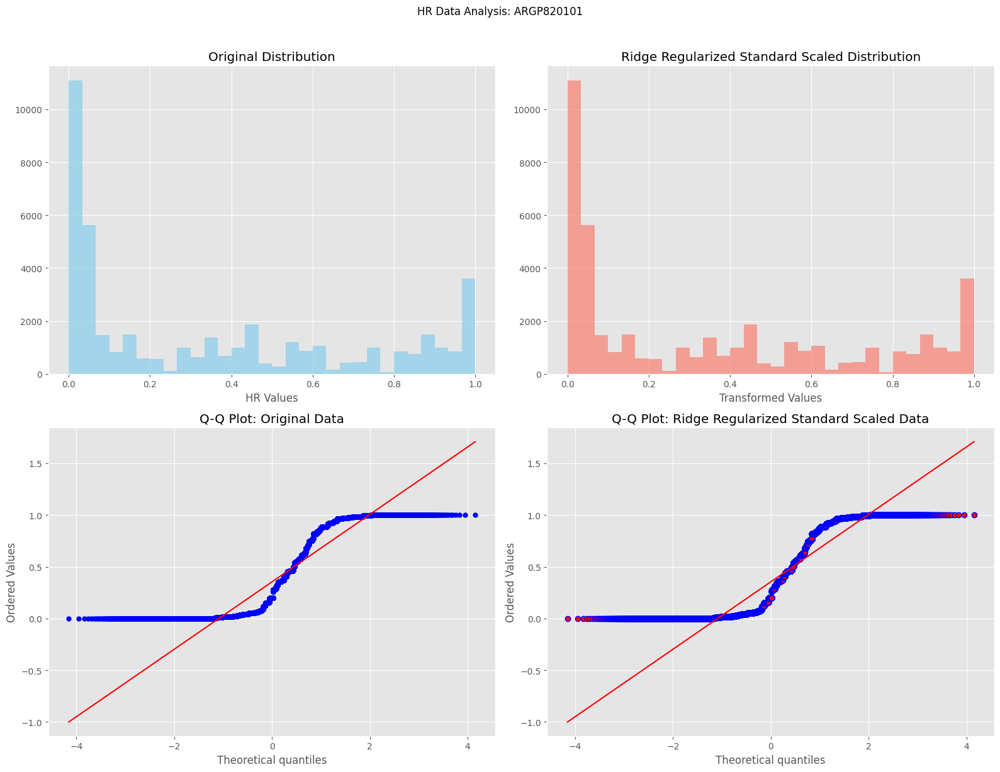

Processing files:   4%|██▎                                                              | 1/28 [00:03<01:44,  3.88s/it]

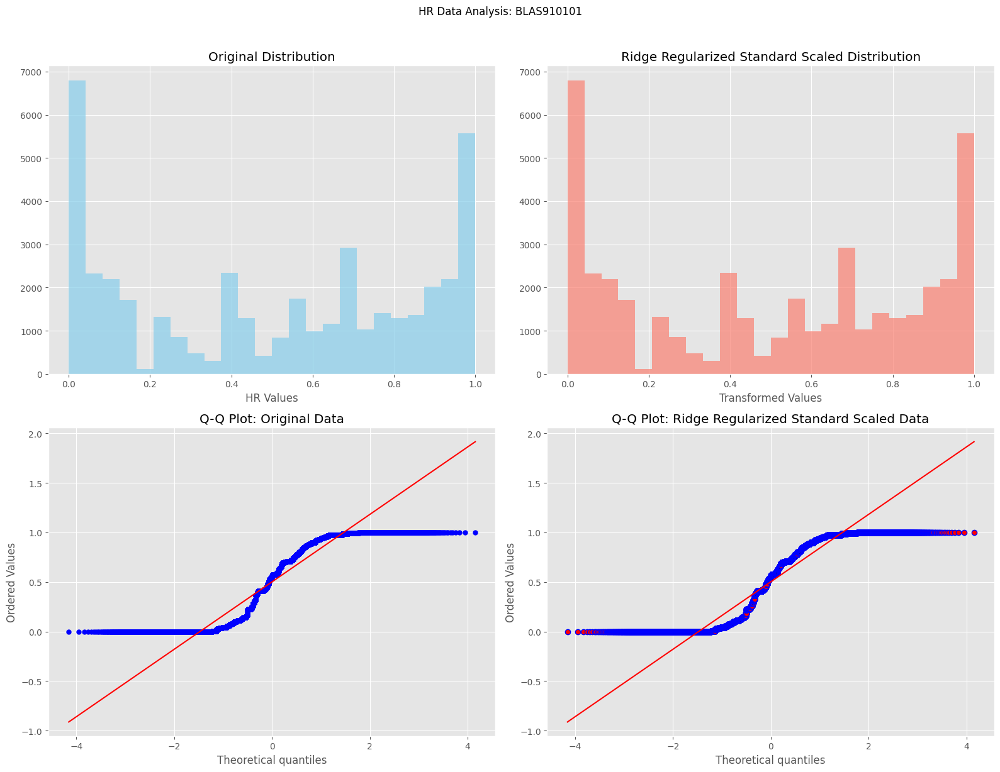

Processing files:   7%|████▋                                                            | 2/28 [00:07<01:30,  3.47s/it]

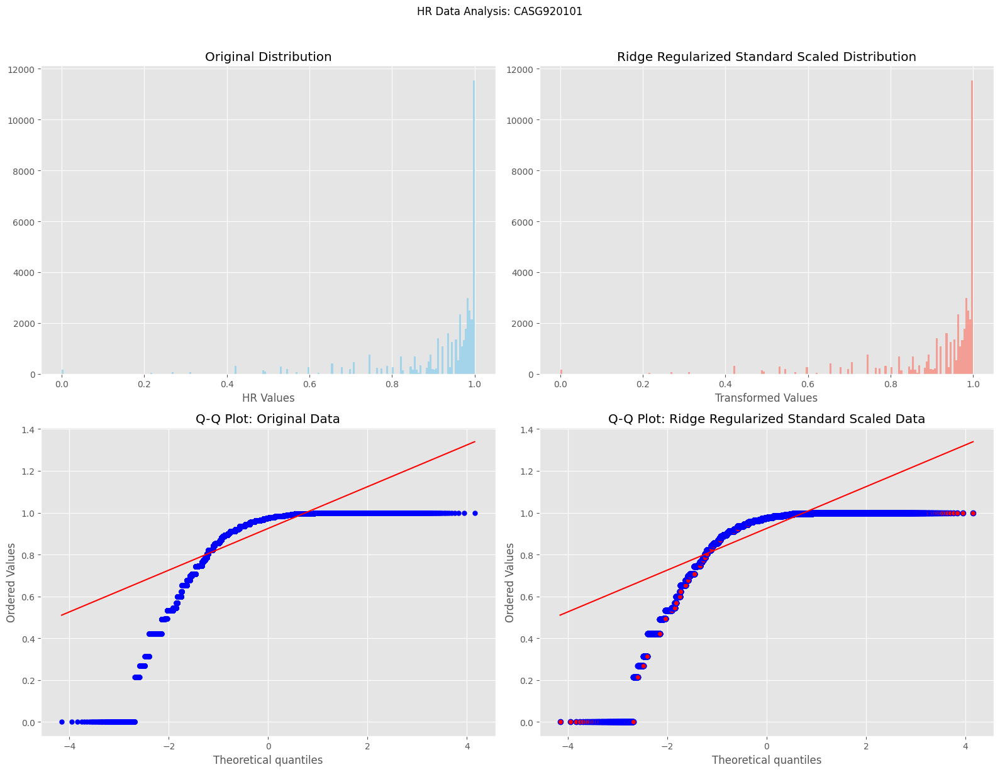

Processing files:  11%|██████▉                                                          | 3/28 [00:11<01:42,  4.11s/it]

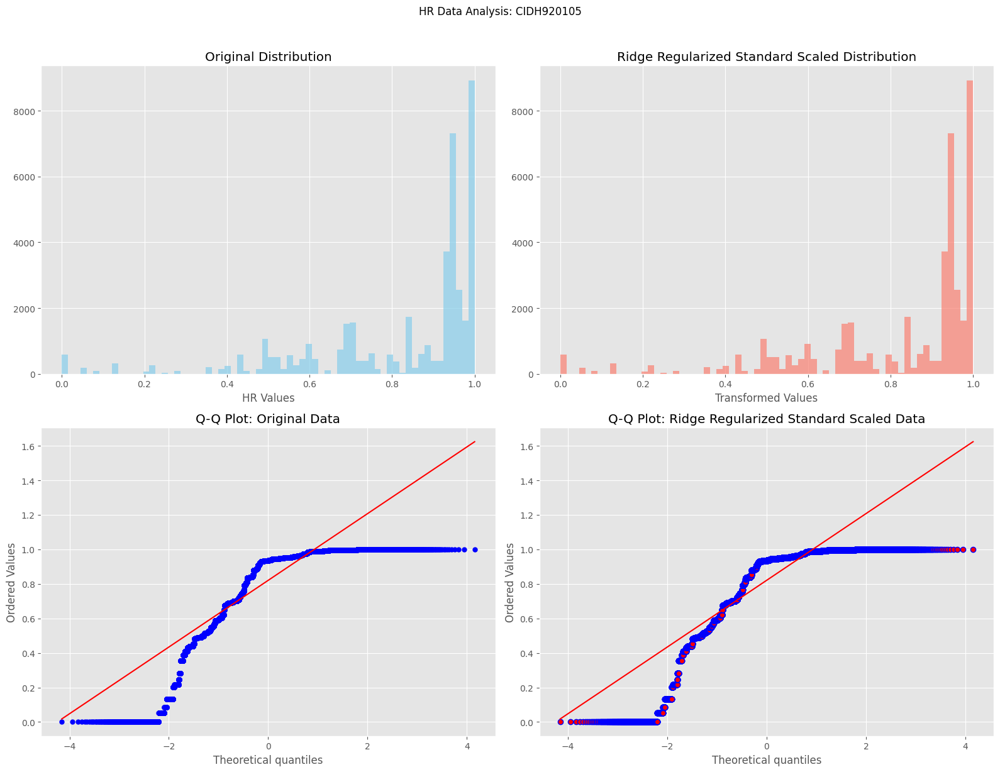

Processing files:  14%|█████████▎                                                       | 4/28 [00:16<01:38,  4.10s/it]

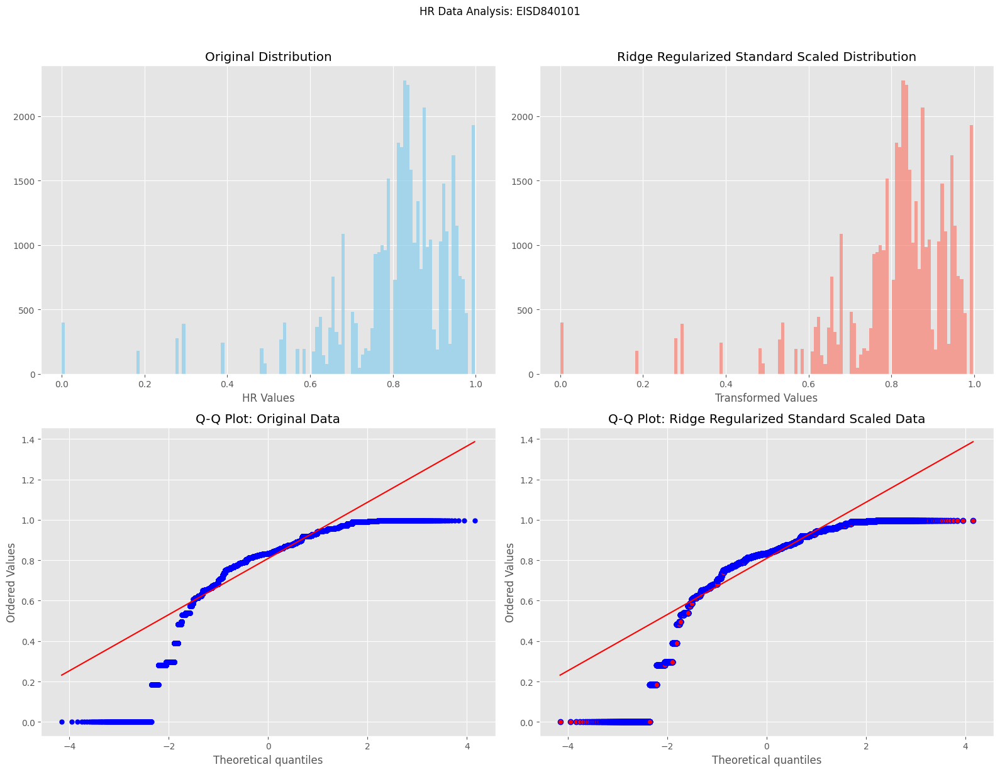

Processing files:  18%|███████████▌                                                     | 5/28 [00:20<01:36,  4.21s/it]

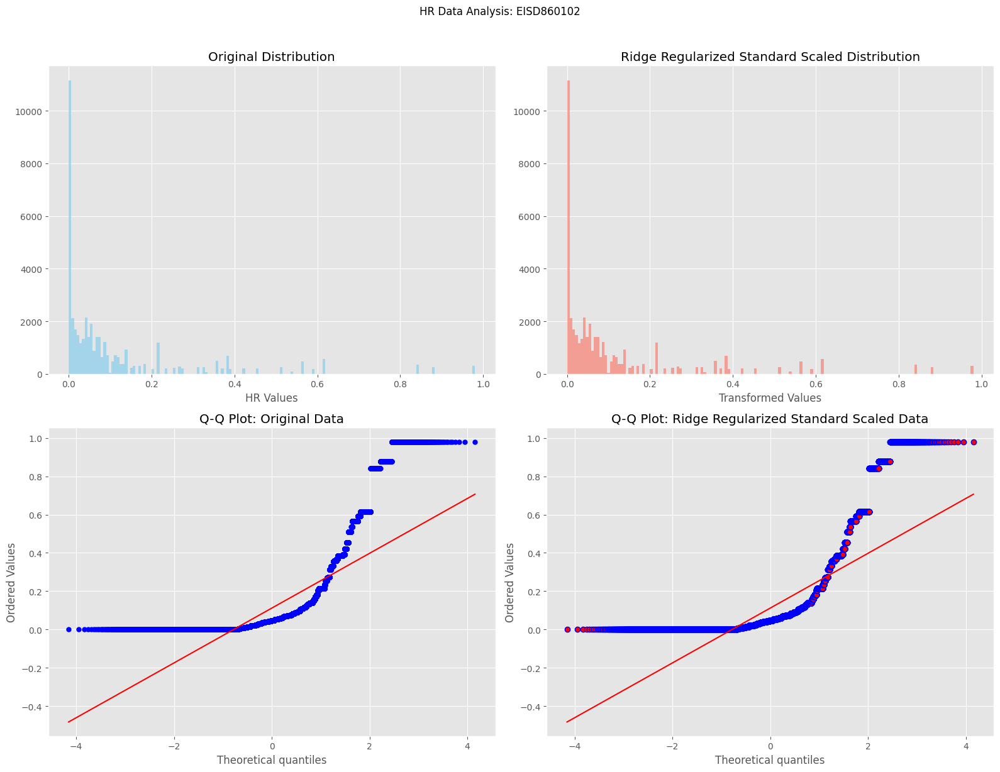

Processing files:  21%|█████████████▉                                                   | 6/28 [00:24<01:35,  4.33s/it]

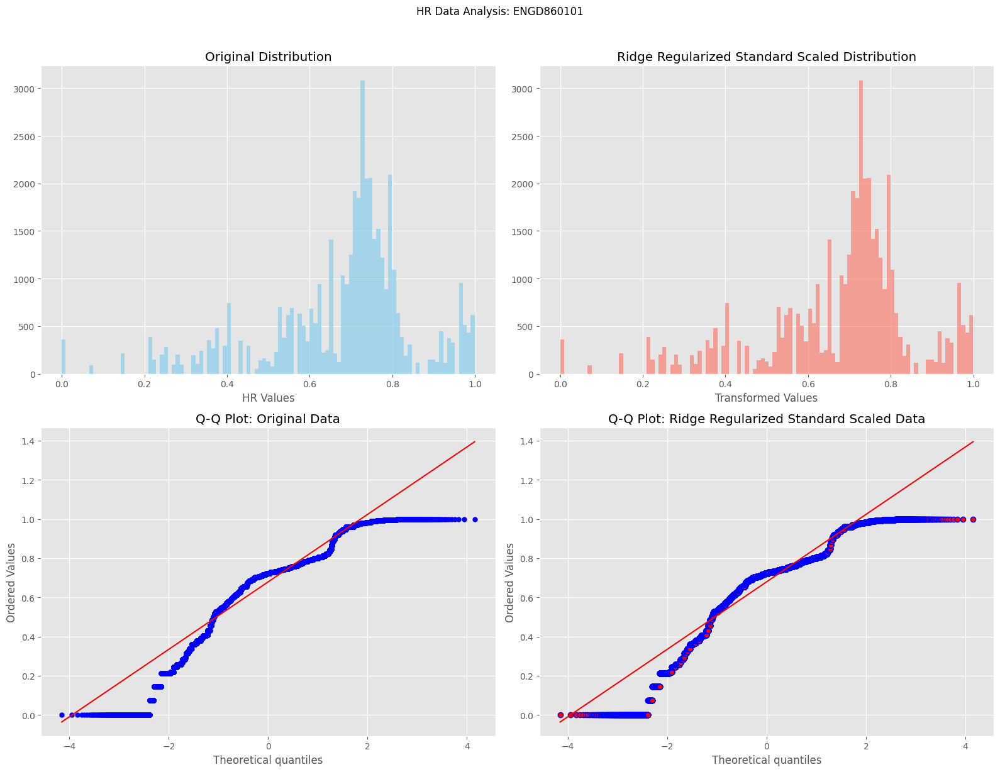

Processing files:  25%|████████████████▎                                                | 7/28 [00:29<01:30,  4.31s/it]

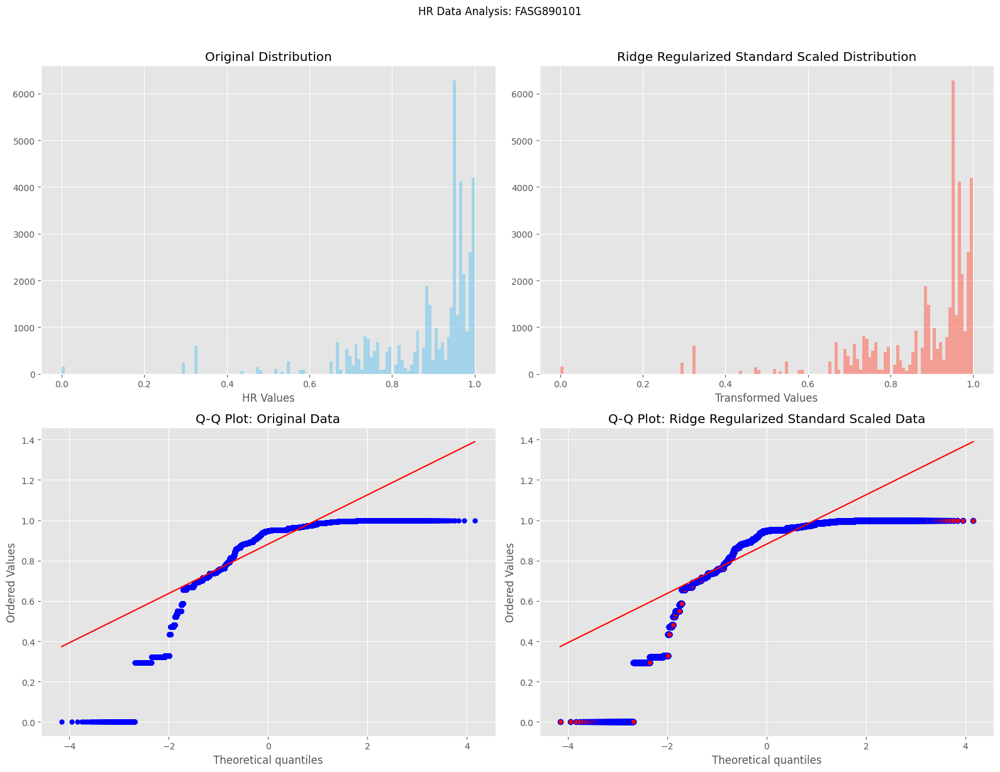

Processing files:  29%|██████████████████▌                                              | 8/28 [00:33<01:26,  4.33s/it]

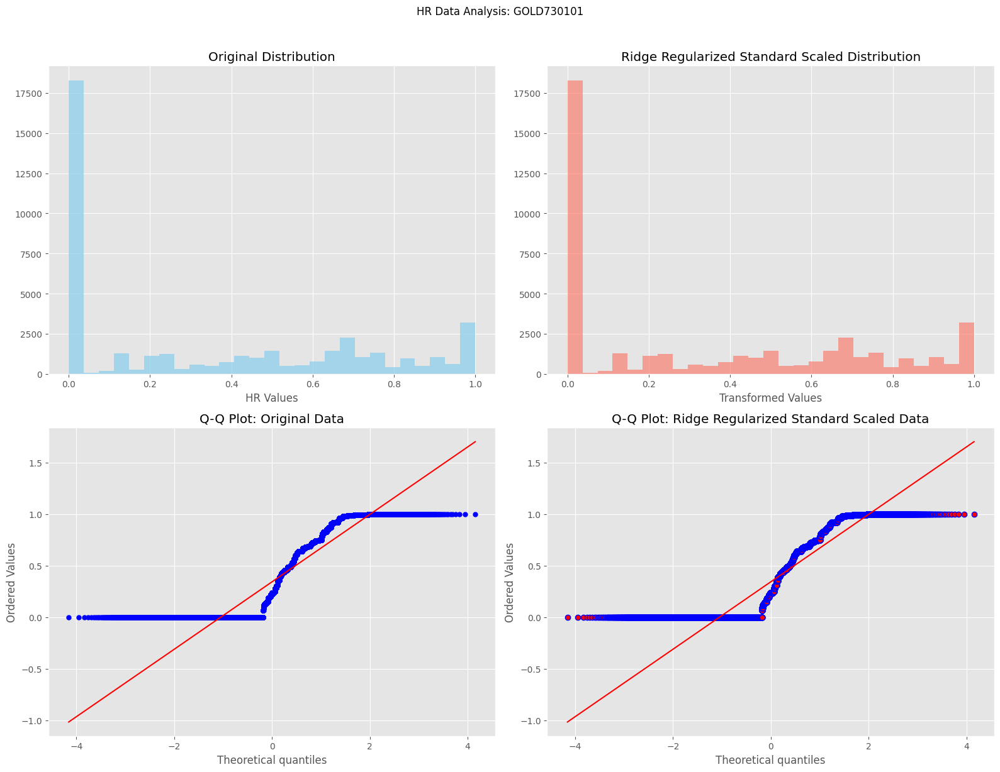

Processing files:  32%|████████████████████▉                                            | 9/28 [00:37<01:21,  4.29s/it]

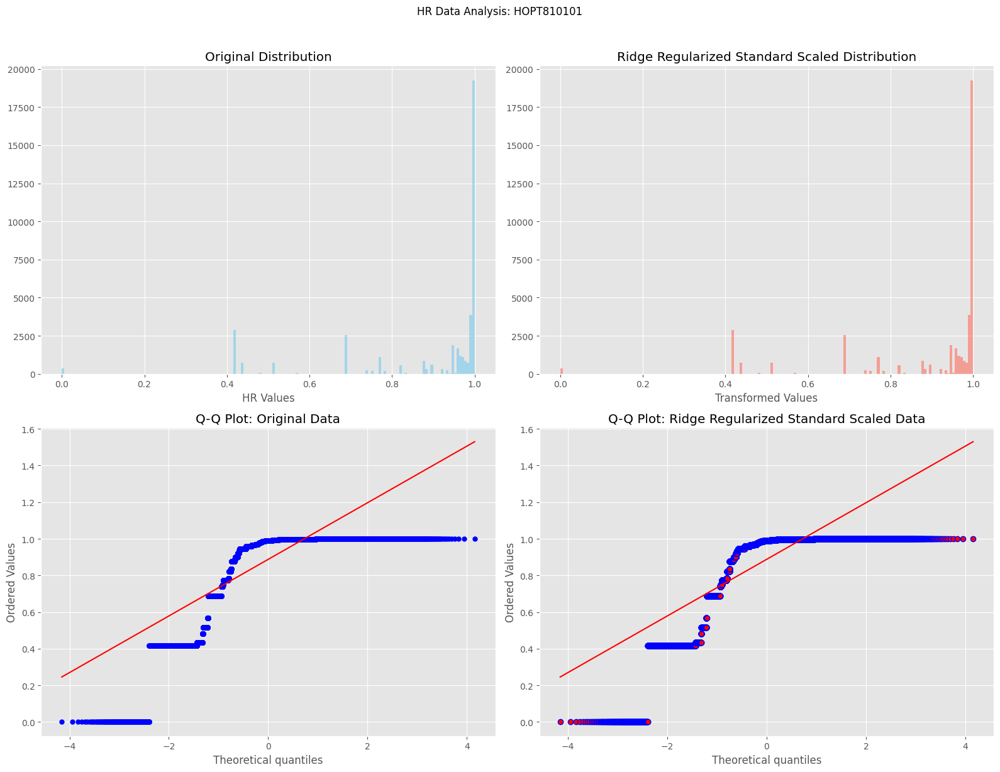

Processing files:  36%|██████████████████████▊                                         | 10/28 [00:43<01:23,  4.66s/it]

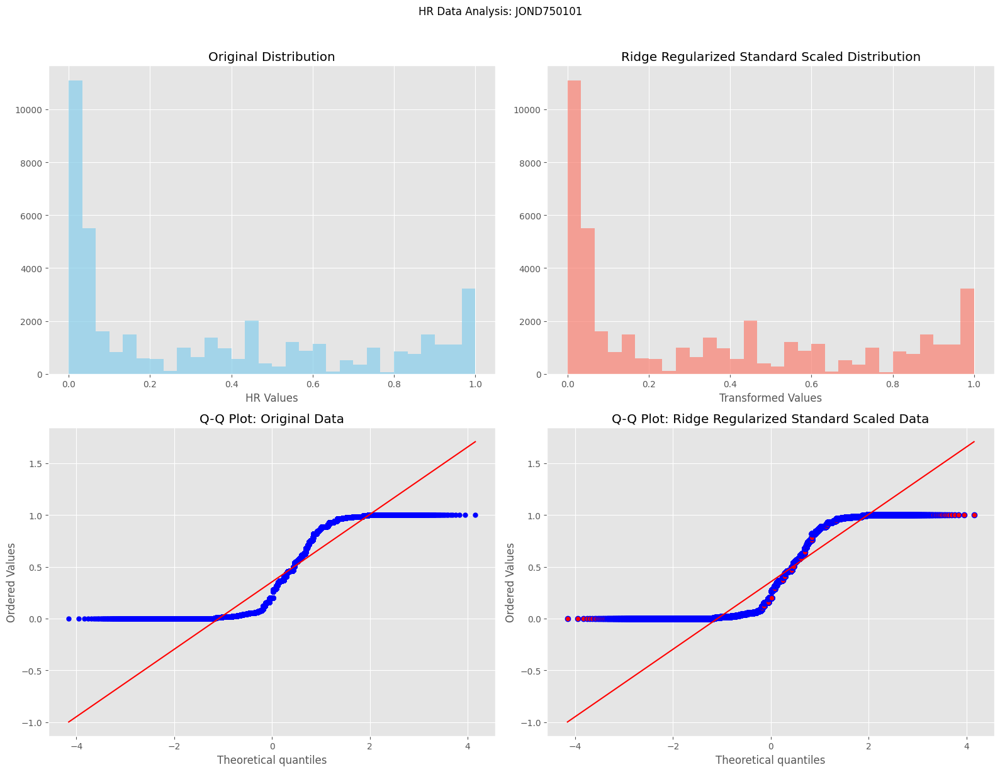

Processing files:  39%|█████████████████████████▏                                      | 11/28 [00:46<01:10,  4.17s/it]

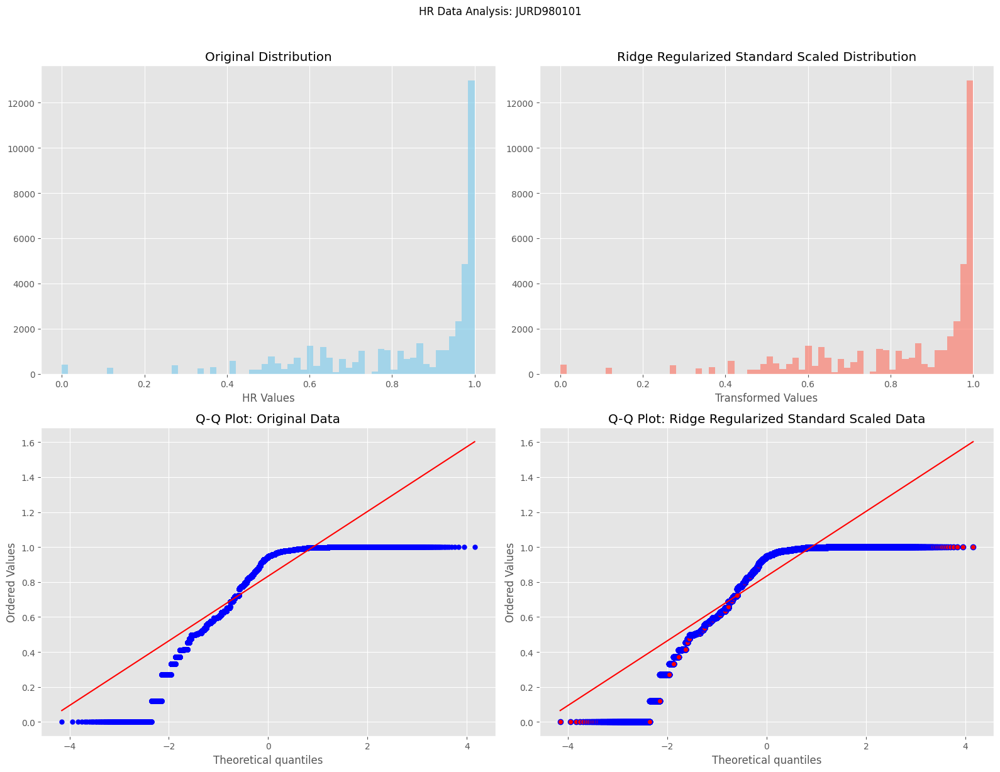

Processing files:  43%|███████████████████████████▍                                    | 12/28 [00:50<01:07,  4.22s/it]

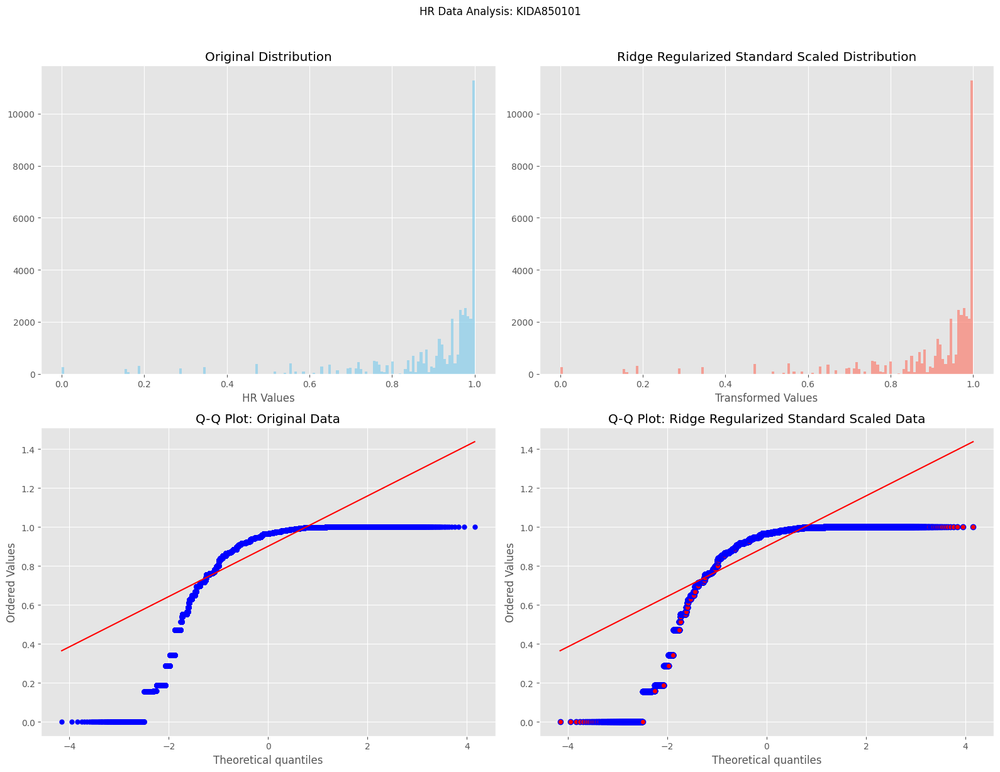

Processing files:  46%|█████████████████████████████▋                                  | 13/28 [00:55<01:06,  4.44s/it]

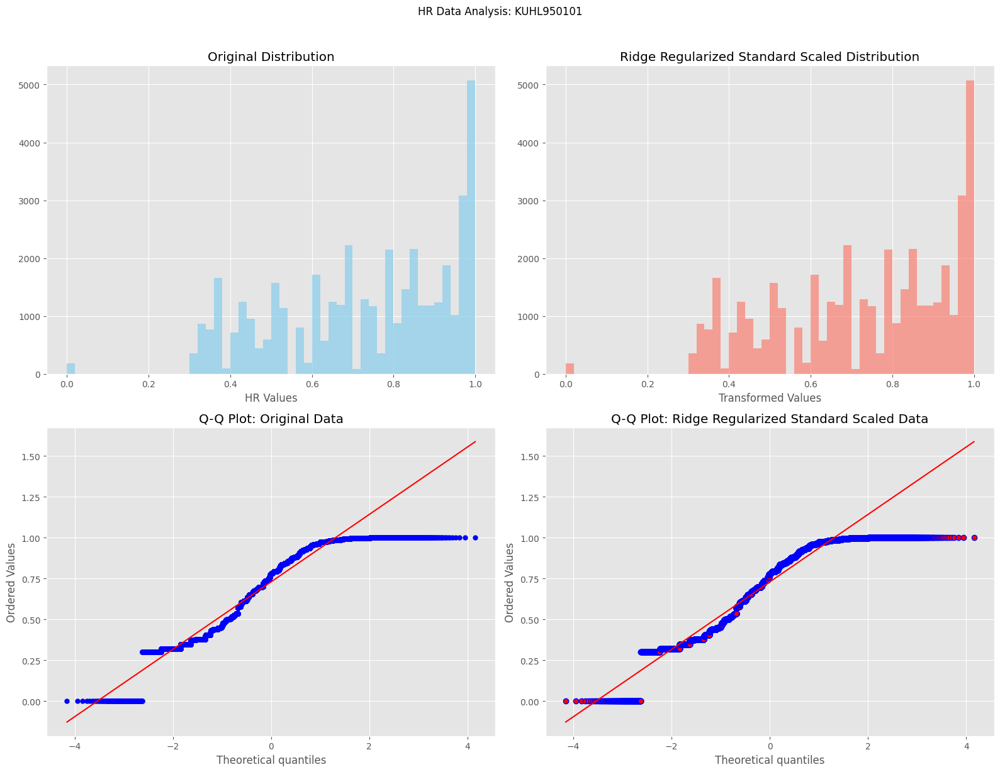

Processing files:  50%|████████████████████████████████                                | 14/28 [00:58<00:57,  4.10s/it]

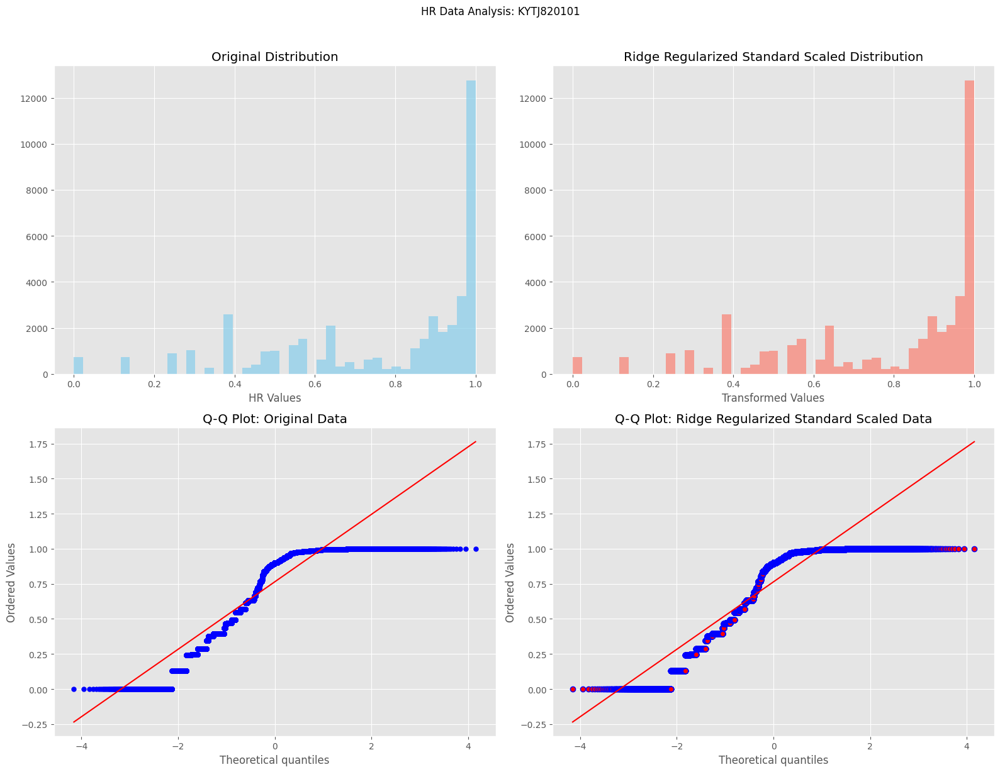

Processing files:  54%|██████████████████████████████████▎                             | 15/28 [01:02<00:50,  3.90s/it]

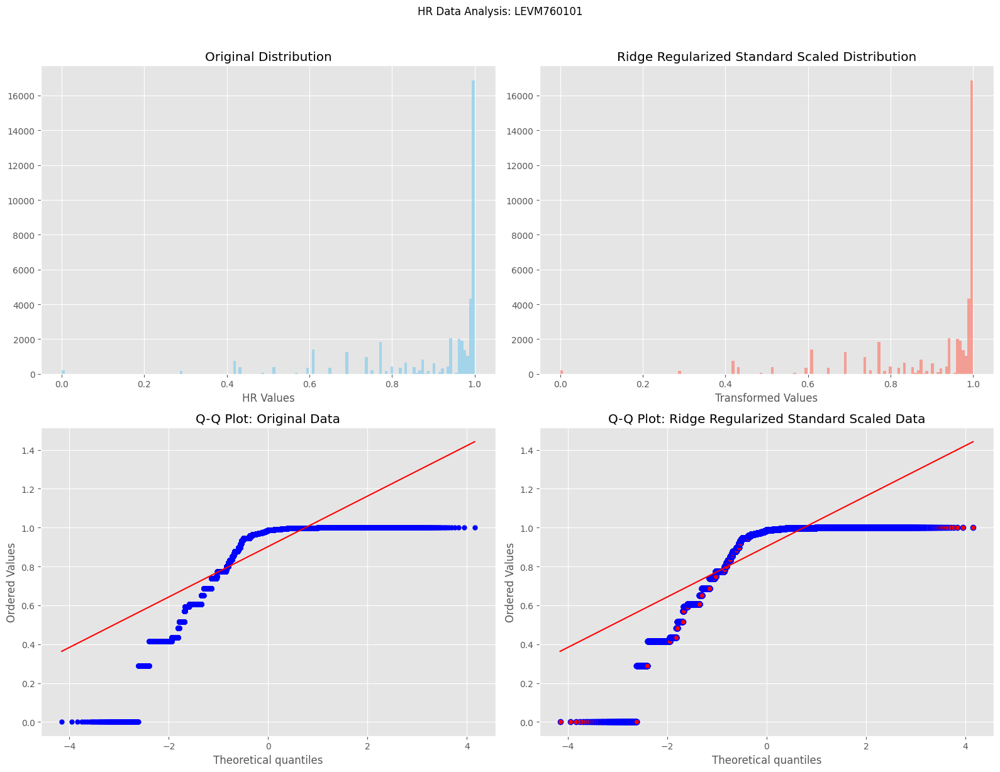

Processing files:  57%|████████████████████████████████████▌                           | 16/28 [01:07<00:50,  4.24s/it]

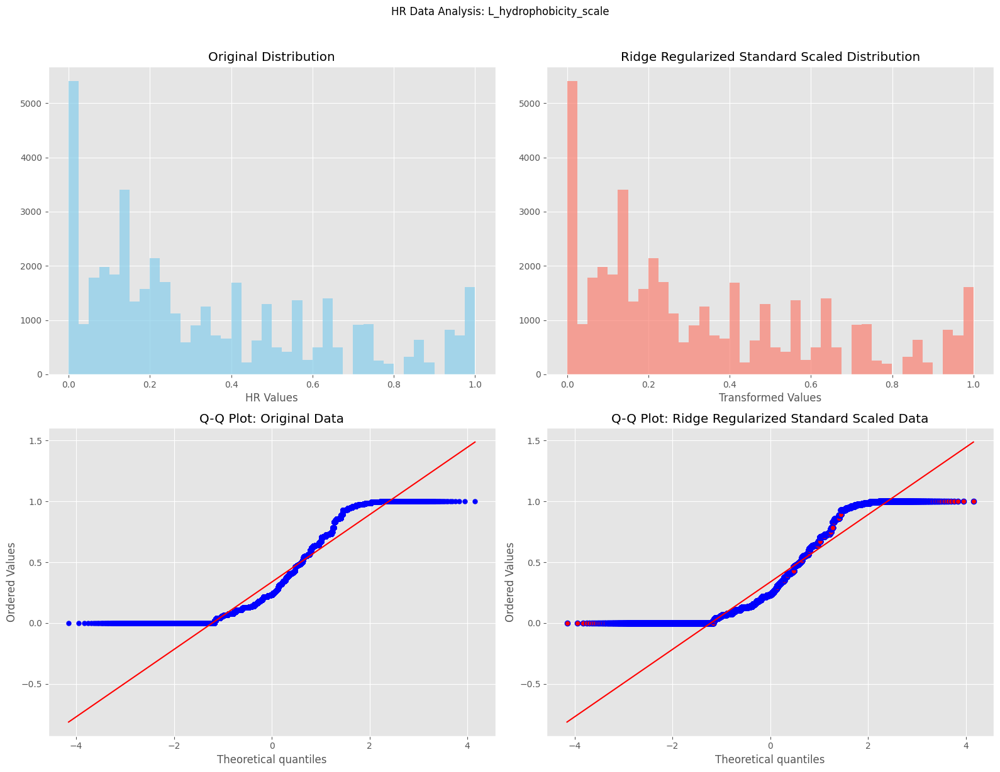

Processing files:  61%|██████████████████████████████████████▊                         | 17/28 [01:10<00:43,  3.98s/it]

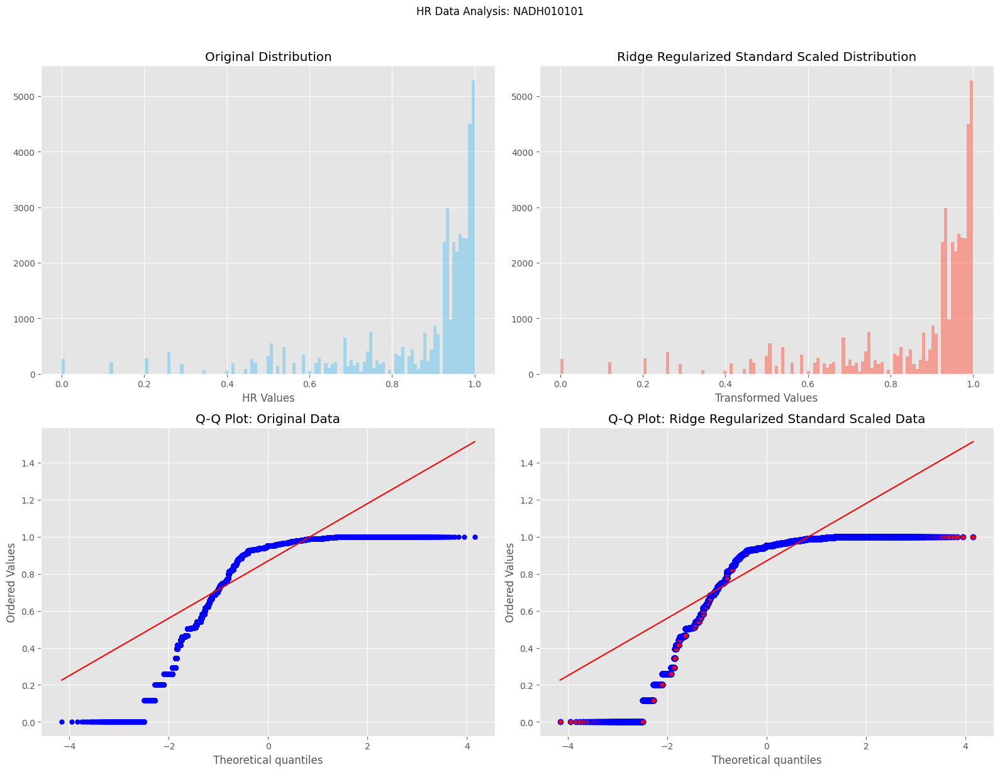

Processing files:  64%|█████████████████████████████████████████▏                      | 18/28 [01:15<00:41,  4.18s/it]

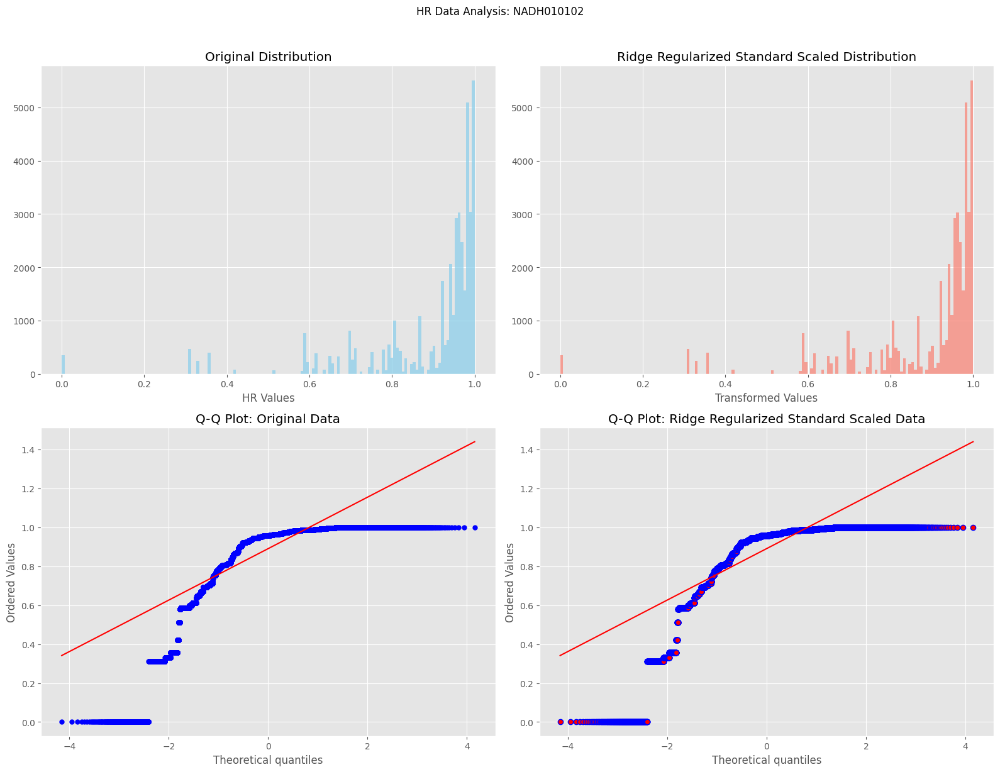

Processing files:  68%|███████████████████████████████████████████▍                    | 19/28 [01:20<00:39,  4.35s/it]

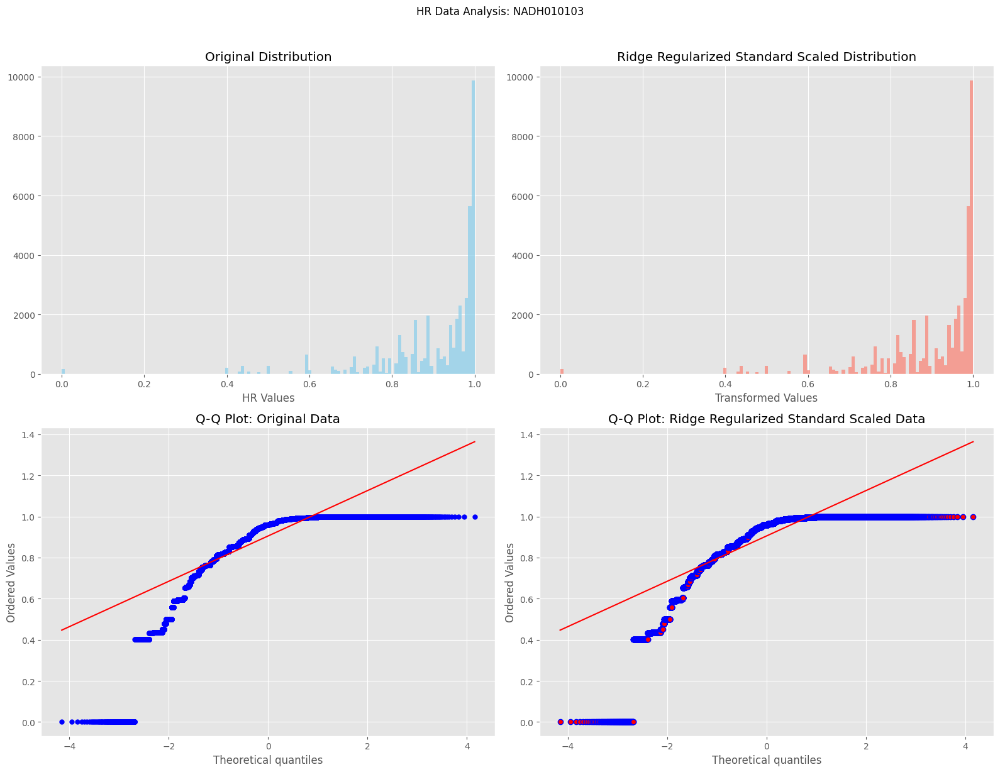

Processing files:  71%|█████████████████████████████████████████████▋                  | 20/28 [01:24<00:34,  4.30s/it]

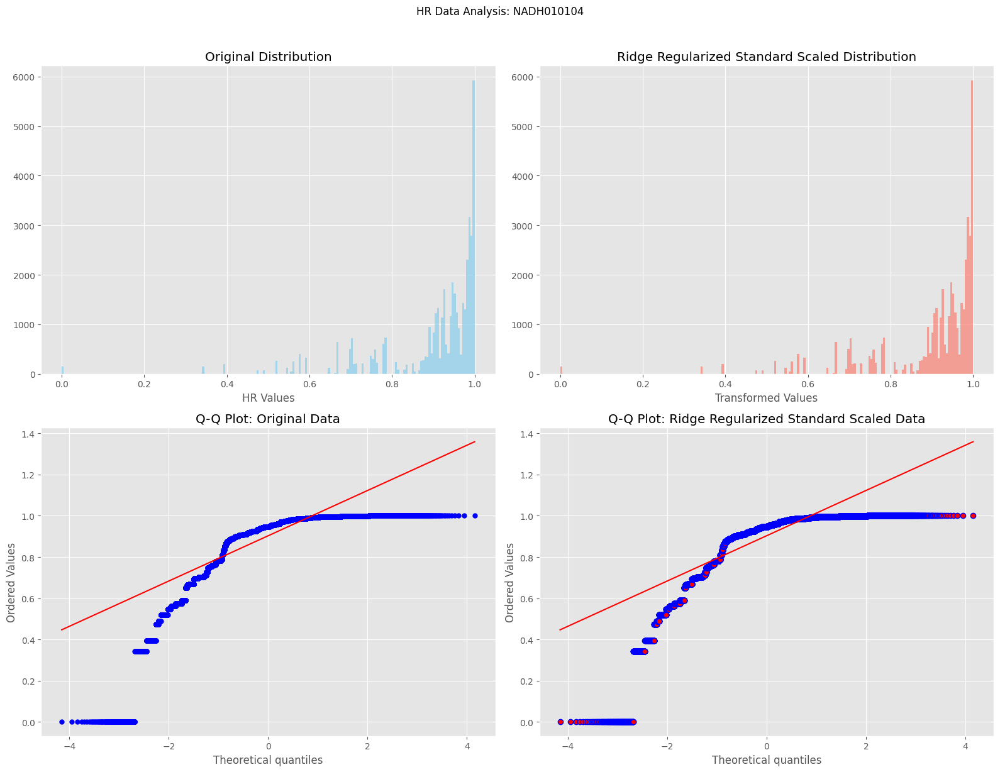

Processing files:  75%|████████████████████████████████████████████████                | 21/28 [01:29<00:31,  4.55s/it]

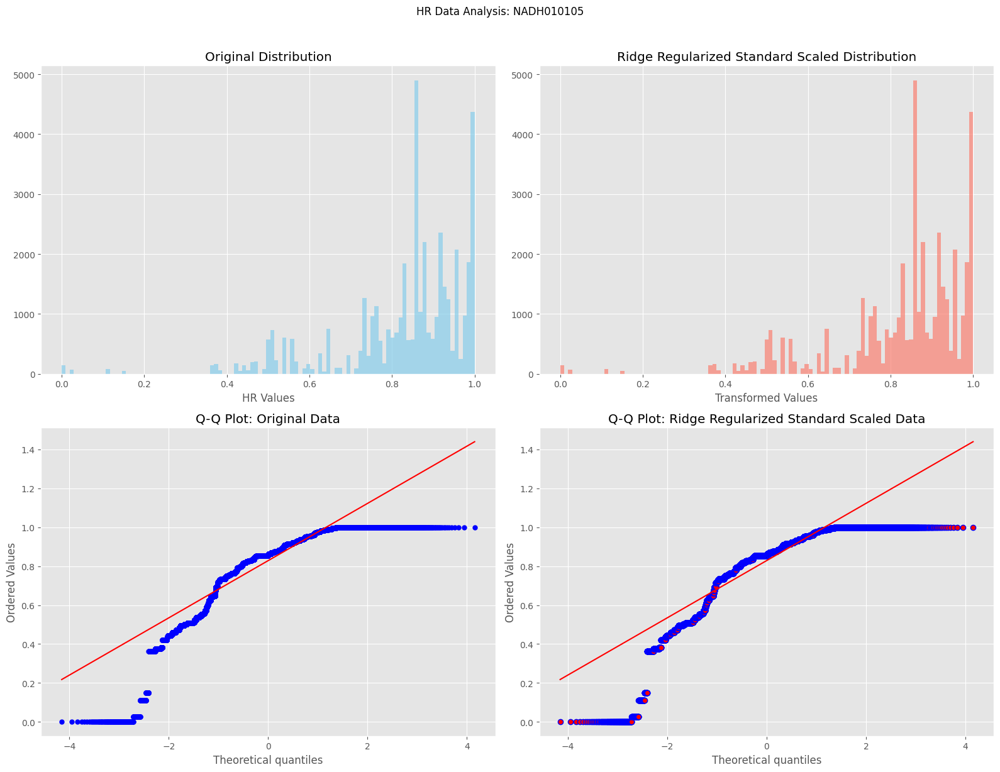

Processing files:  79%|██████████████████████████████████████████████████▎             | 22/28 [01:33<00:26,  4.34s/it]

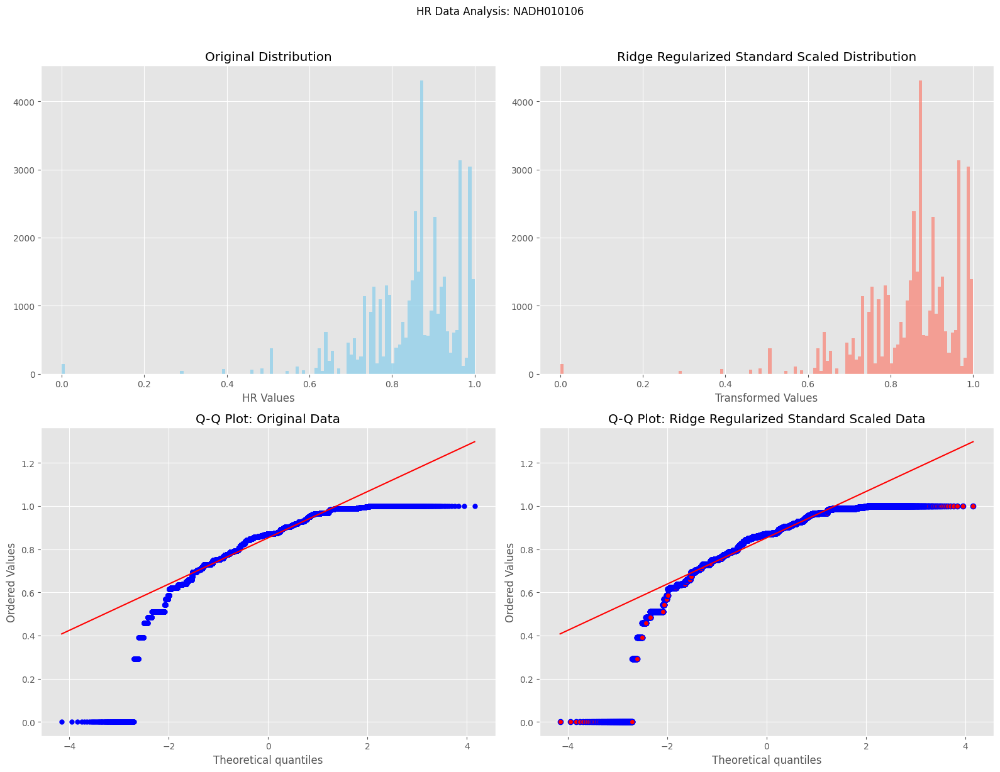

Processing files:  82%|████████████████████████████████████████████████████▌           | 23/28 [01:37<00:21,  4.39s/it]

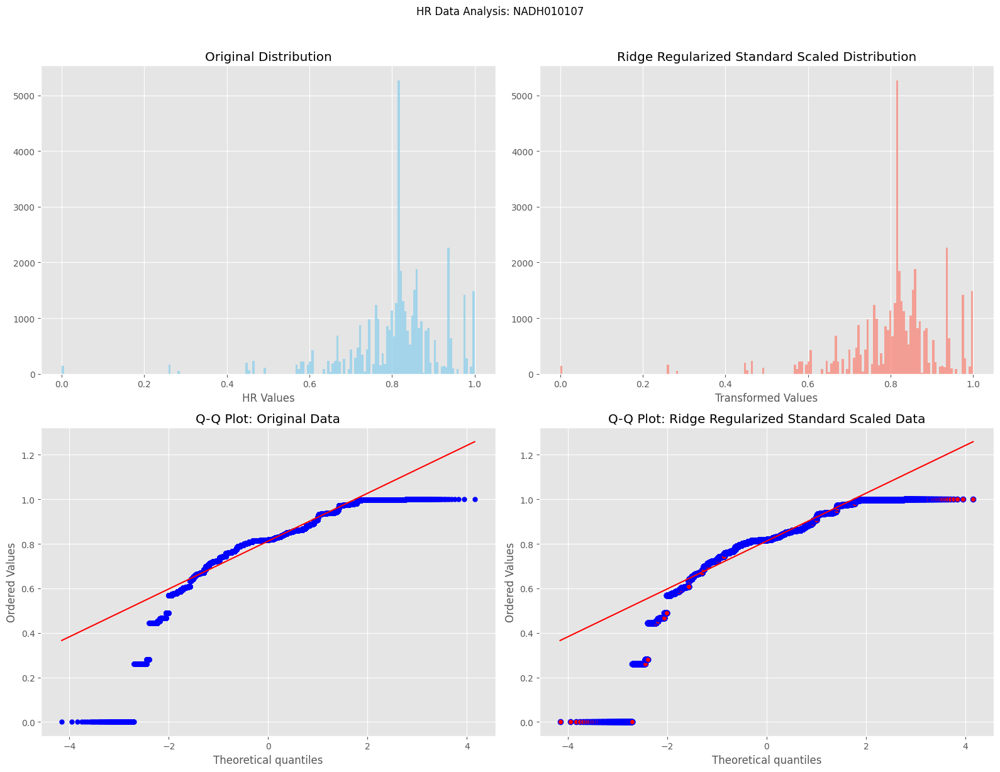

Processing files:  86%|██████████████████████████████████████████████████████▊         | 24/28 [01:42<00:17,  4.48s/it]

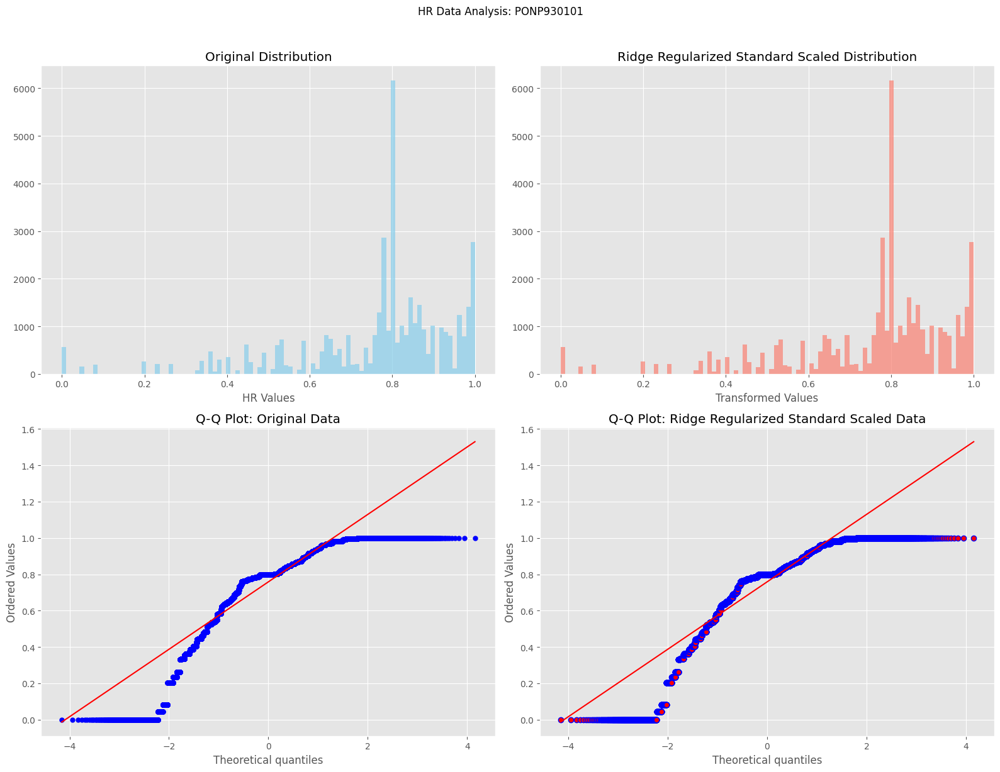

Processing files:  89%|█████████████████████████████████████████████████████████▏      | 25/28 [01:46<00:12,  4.24s/it]

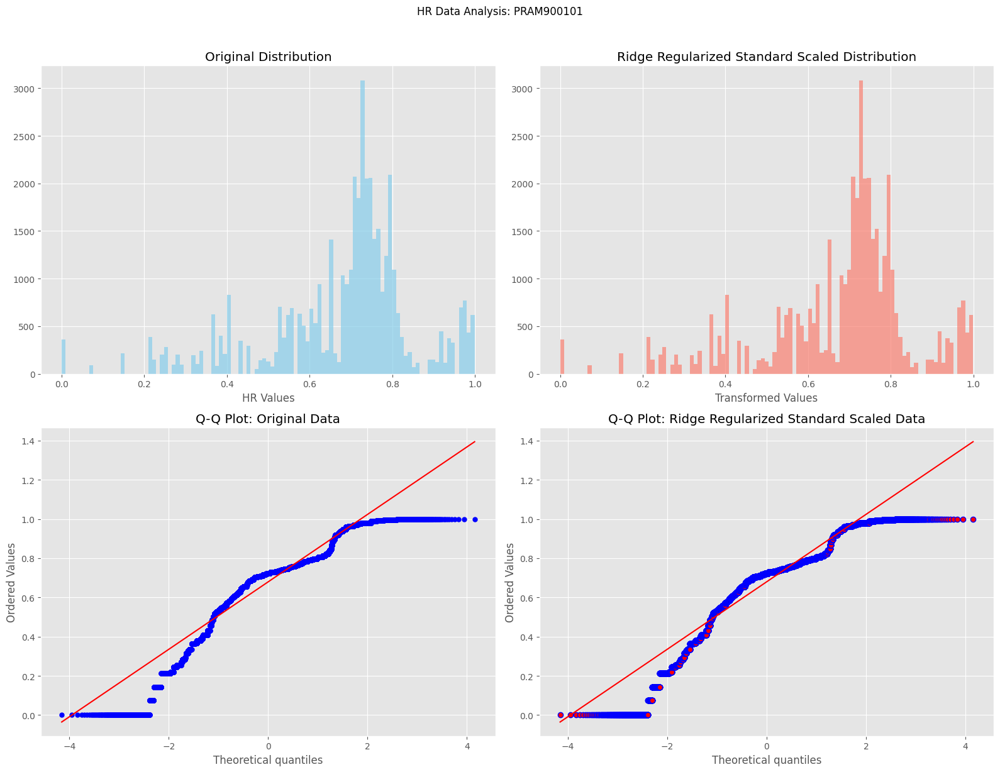

Processing files:  93%|███████████████████████████████████████████████████████████▍    | 26/28 [01:50<00:08,  4.26s/it]

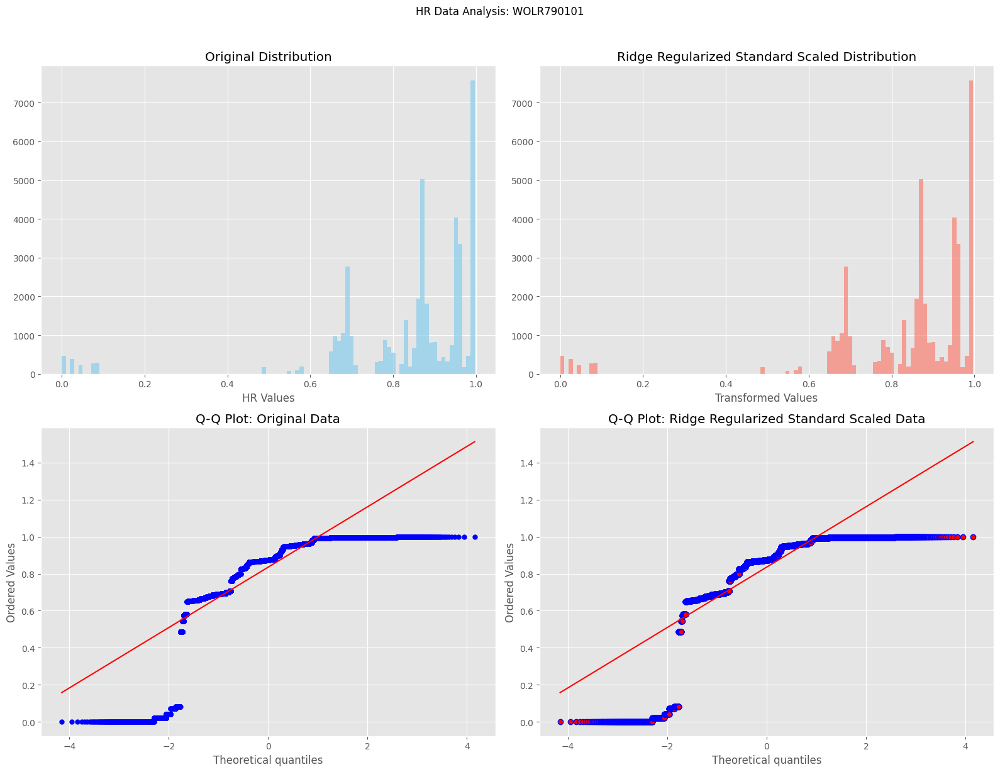

Processing files:  96%|█████████████████████████████████████████████████████████████▋  | 27/28 [01:54<00:04,  4.14s/it]

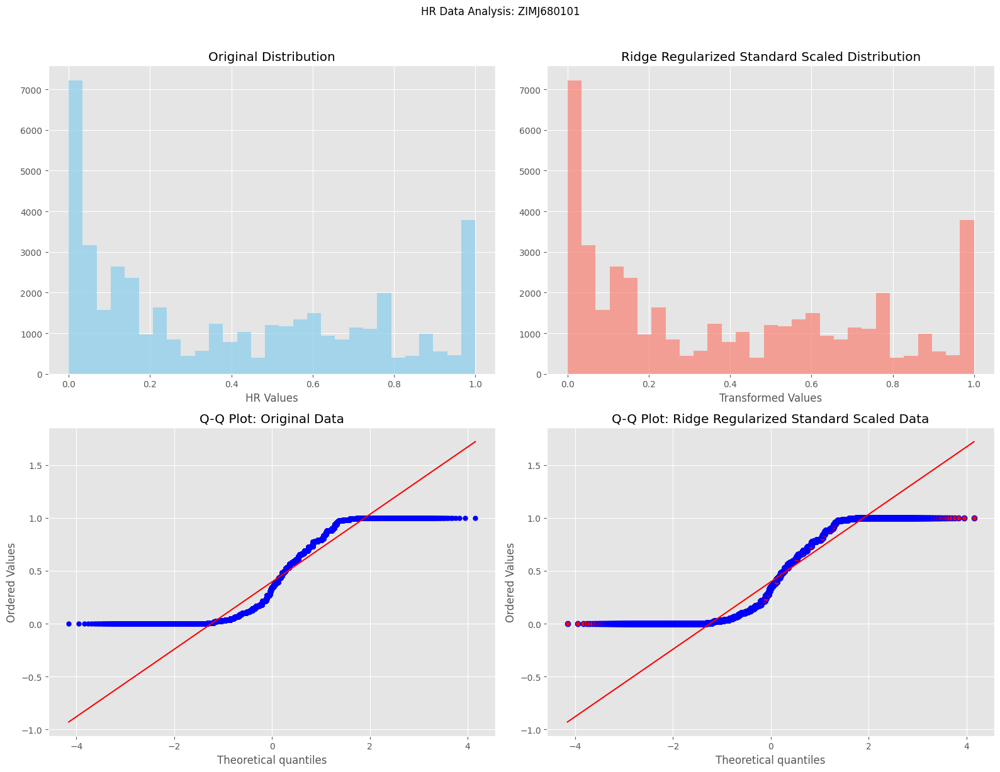

Processing files: 100%|████████████████████████████████████████████████████████████████| 28/28 [01:58<00:00,  4.22s/it]


Analysis complete!


In [9]:
# Directory setup
base_dir = "../generated_data/"
train_hr_dir = os.path.join(base_dir, "train/Hr_modified/")
test_hr_dir = os.path.join(base_dir, "test/Hr_modified/")

# Get all files
def get_file_list(directory):
    return {f.replace('.txt', '') for f in os.listdir(directory) if f.endswith('.txt')}

common_files = get_file_list(train_hr_dir) & get_file_list(test_hr_dir)

if not common_files:
    print("No common files found!")
    exit()

print(f"Found {len(common_files)} files to process")

plt.style.use('ggplot')
plt.rcParams['figure.figsize'] = [16, 8]

for file_name in tqdm(sorted(common_files), desc="Processing files"):
    try:
        # Load and combine data
        train_hr = np.loadtxt(os.path.join(train_hr_dir, f"{file_name}.txt"))
        test_hr = np.loadtxt(os.path.join(test_hr_dir, f"{file_name}.txt"))
        combined_hr = np.concatenate([train_hr.ravel(), test_hr.ravel()])
        
        # Apply L2 (Ridge) transformation using Standard Scaler
        scaler = StandardScaler()
        hr_transformed = scaler.fit_transform(combined_hr.reshape(-1, 1)).flatten()
        
        # Apply Ridge (L2 Regularization)
        ridge = Ridge(alpha=0.1)
        hr_transformed = hr_transformed.reshape(-1, 1)
        ridge.fit(hr_transformed, combined_hr)  # Fit Ridge on transformed data
        hr_ridge = ridge.predict(hr_transformed)  # Get Ridge predictions
        
        # Create figure
        fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(16, 12))
        fig.suptitle(f'HR Data Analysis: {file_name}', y=1.02)
        
        # Original histogram
        ax1.hist(combined_hr, bins='auto', color='skyblue', alpha=0.7)
        ax1.set_title('Original Distribution')
        ax1.set_xlabel('HR Values')
        
        # Transformed histogram
        ax2.hist(hr_ridge, bins='auto', color='salmon', alpha=0.7)
        ax2.set_title('Ridge Regularized Standard Scaled Distribution')
        ax2.set_xlabel('Transformed Values')
        
        # Original Q-Q plot
        stats.probplot(combined_hr, dist="norm", plot=ax3)
        ax3.set_title('Q-Q Plot: Original Data')
        ax3.get_lines()[0].set_markerfacecolor('blue')
        ax3.get_lines()[0].set_markersize(5.0)
        
        # Transformed Q-Q plot
        stats.probplot(hr_ridge, dist="norm", plot=ax4)
        ax4.set_title('Q-Q Plot: Ridge Regularized Standard Scaled Data')
        ax4.get_lines()[0].set_markerfacecolor('red')
        
        plt.tight_layout()
        plt.show()
        
    except Exception as e:
        print(f"\nError processing {file_name}: {str(e)}")
        continue

print("\nAnalysis complete!")

Found 28 files to process


Processing files:   0%|                                                                         | 0/28 [00:00<?, ?it/s]

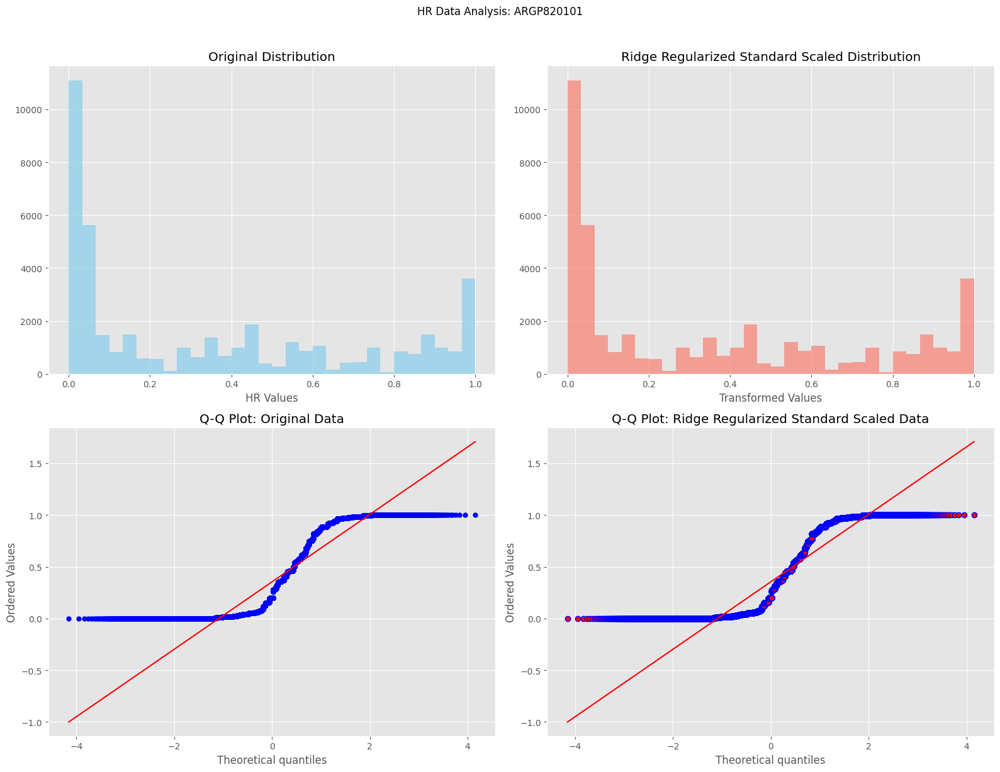

Processing files:   4%|██▎                                                              | 1/28 [00:03<01:32,  3.44s/it]

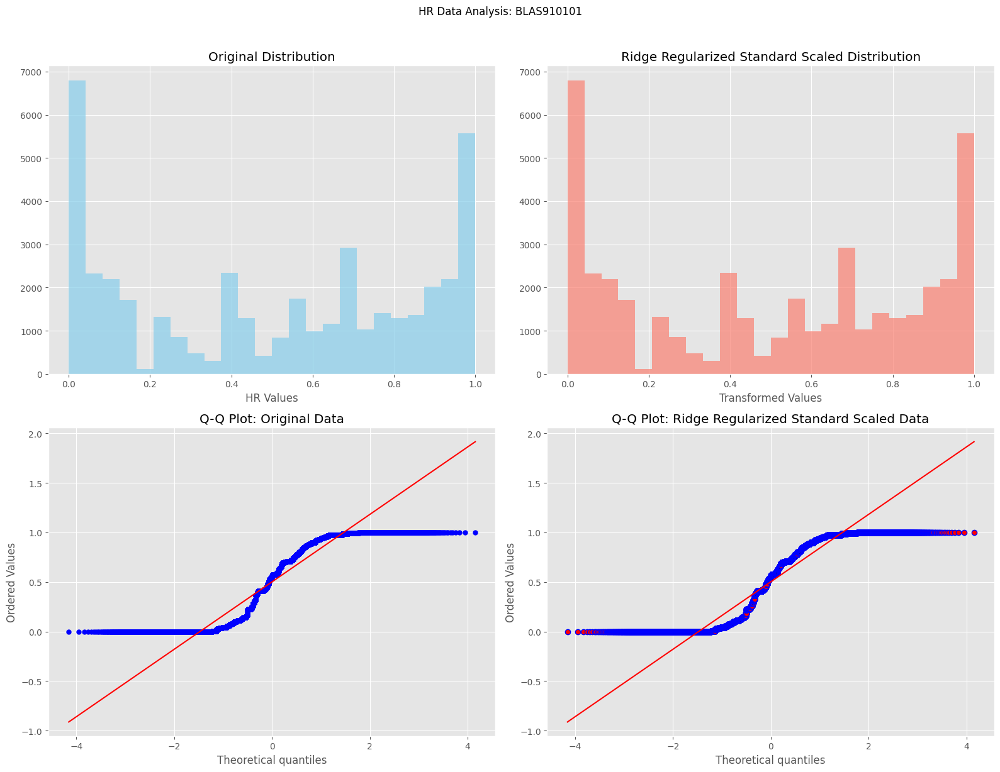

Processing files:   7%|████▋                                                            | 2/28 [00:06<01:26,  3.33s/it]

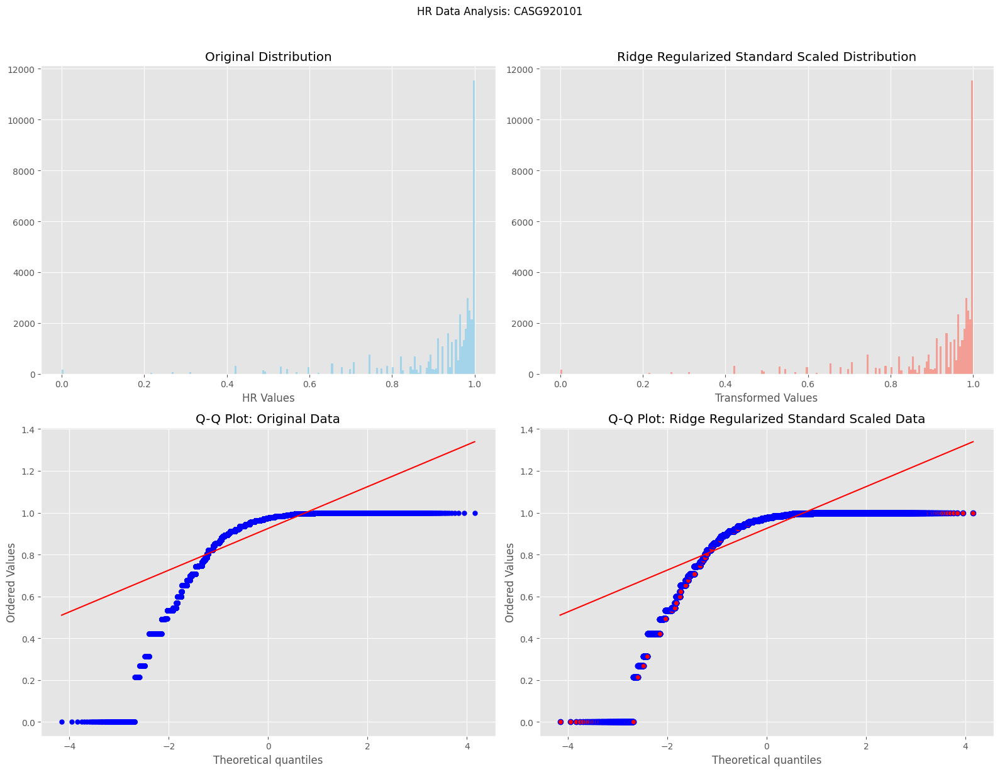

Processing files:  11%|██████▉                                                          | 3/28 [00:11<01:38,  3.95s/it]

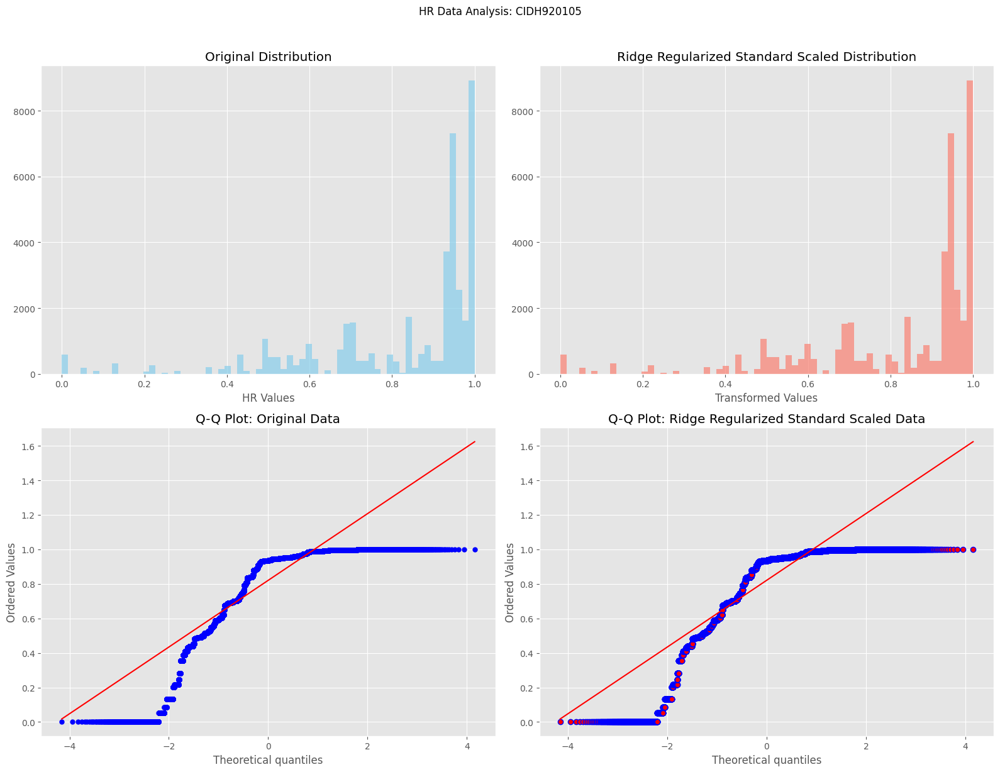

Processing files:  14%|█████████▎                                                       | 4/28 [00:15<01:36,  4.00s/it]

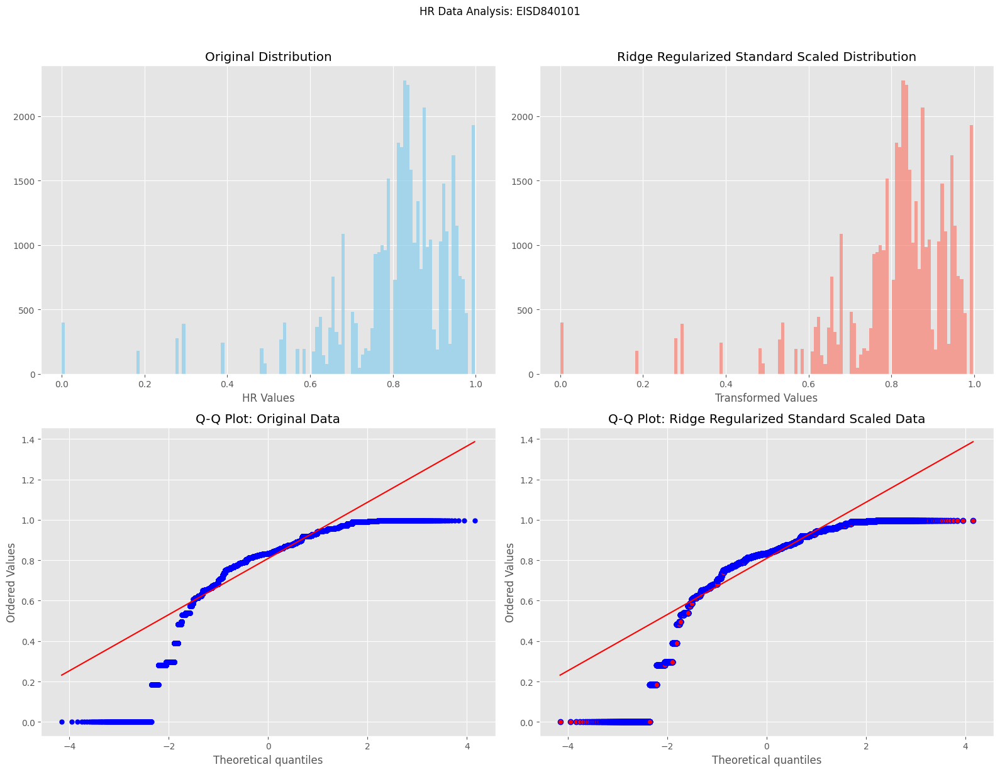

Processing files:  18%|███████████▌                                                     | 5/28 [00:20<01:39,  4.31s/it]

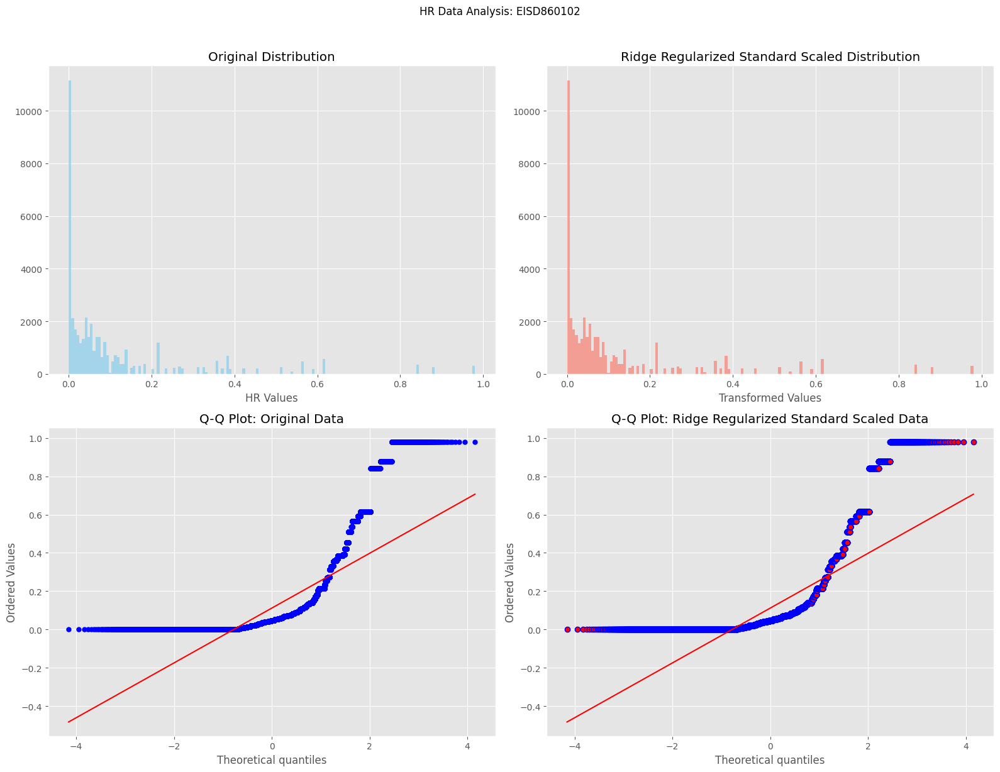

Processing files:  21%|█████████████▉                                                   | 6/28 [00:24<01:36,  4.40s/it]

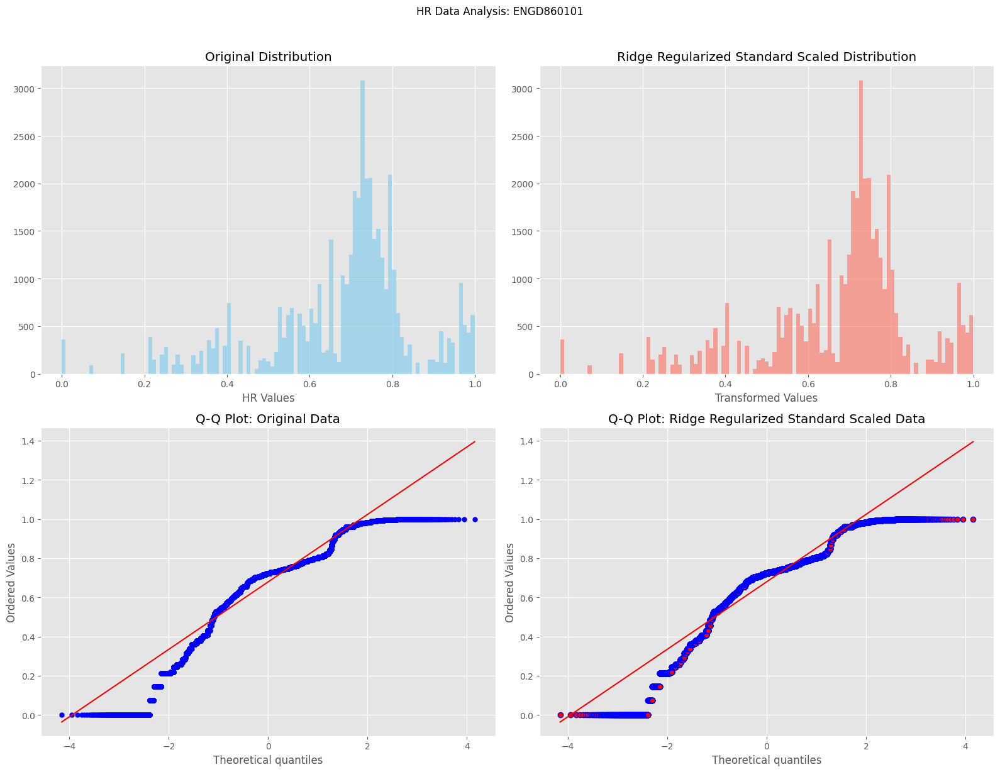

Processing files:  25%|████████████████▎                                                | 7/28 [00:29<01:34,  4.48s/it]

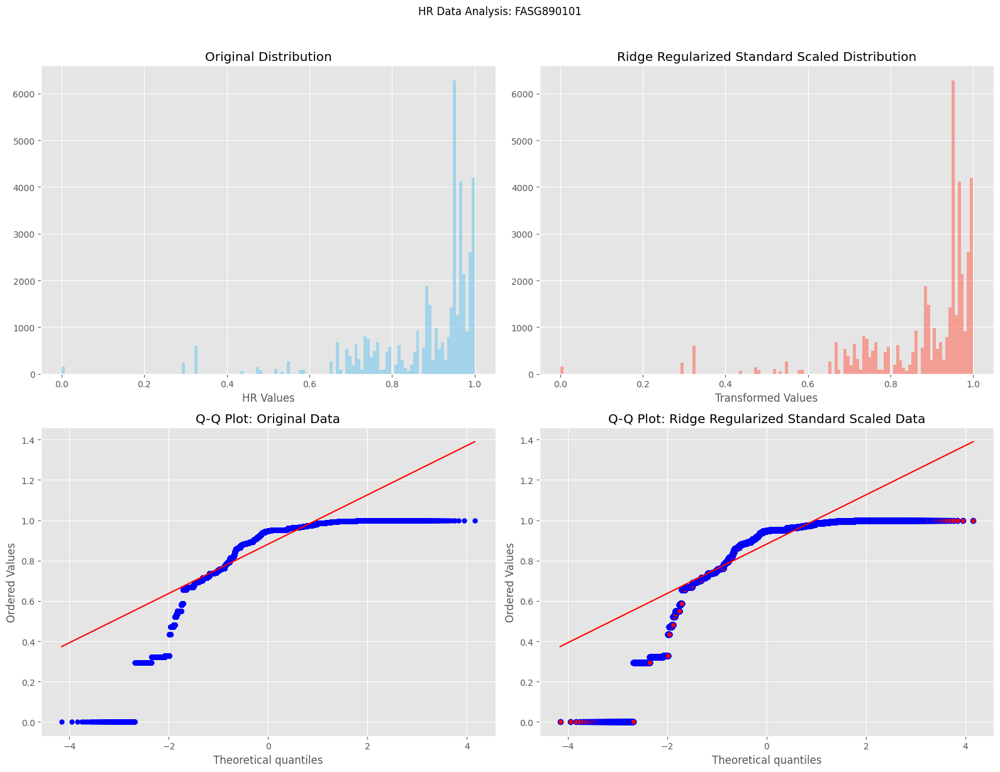

Processing files:  29%|██████████████████▌                                              | 8/28 [00:33<01:28,  4.40s/it]

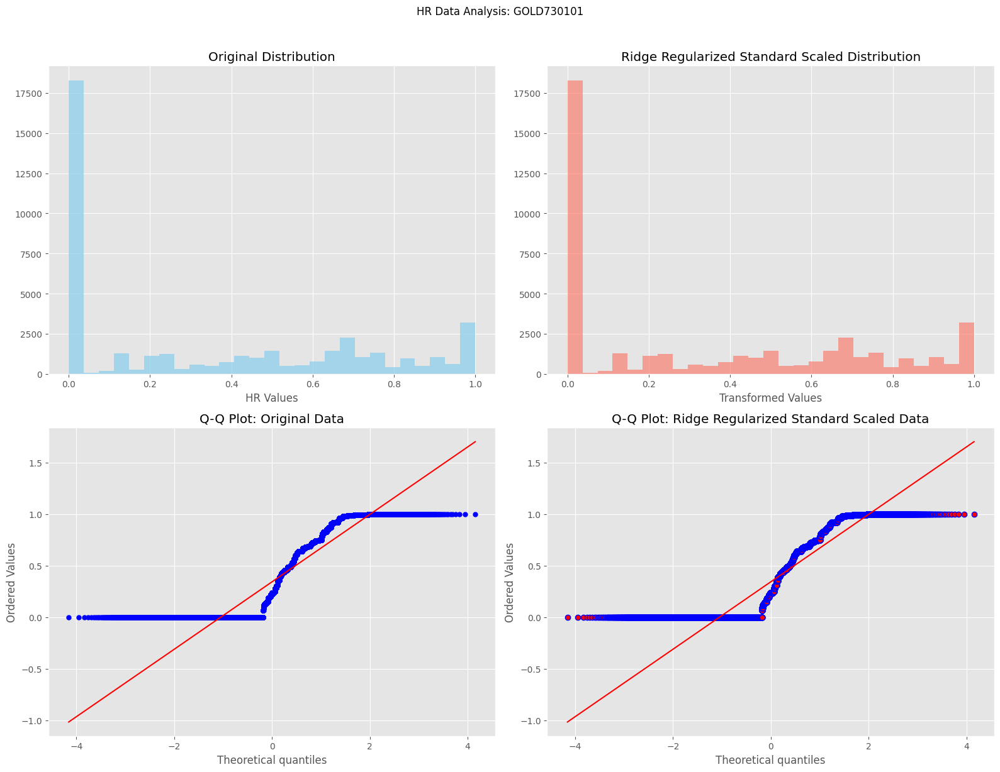

Processing files:  32%|████████████████████▉                                            | 9/28 [00:36<01:15,  3.98s/it]

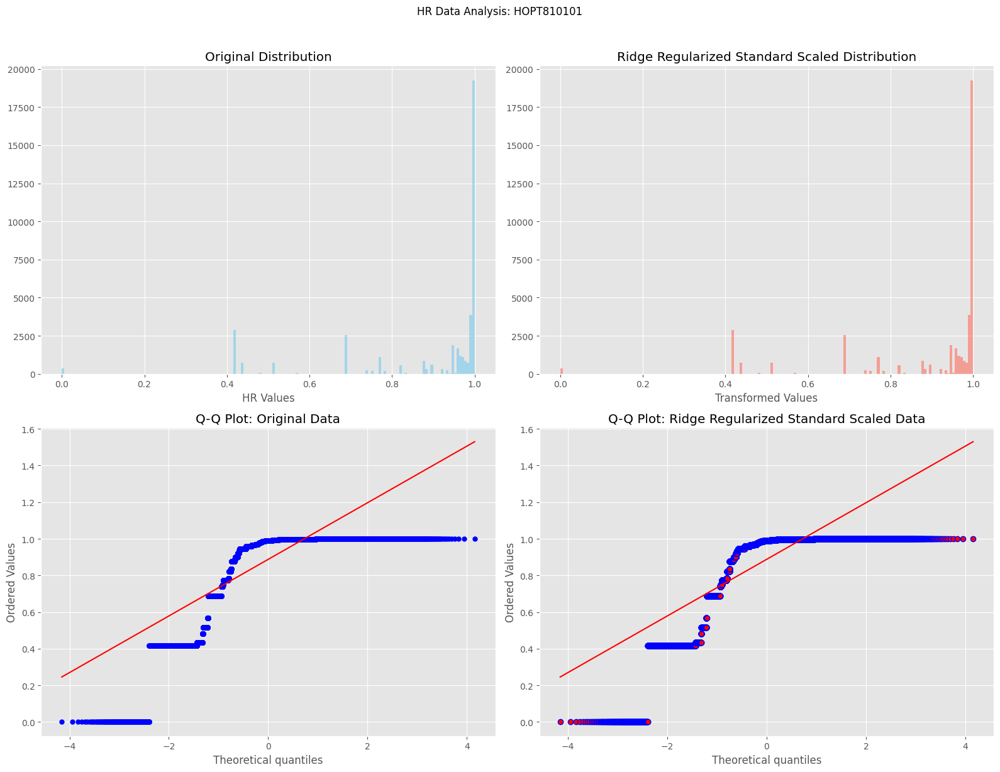

Processing files:  36%|██████████████████████▊                                         | 10/28 [00:41<01:16,  4.26s/it]

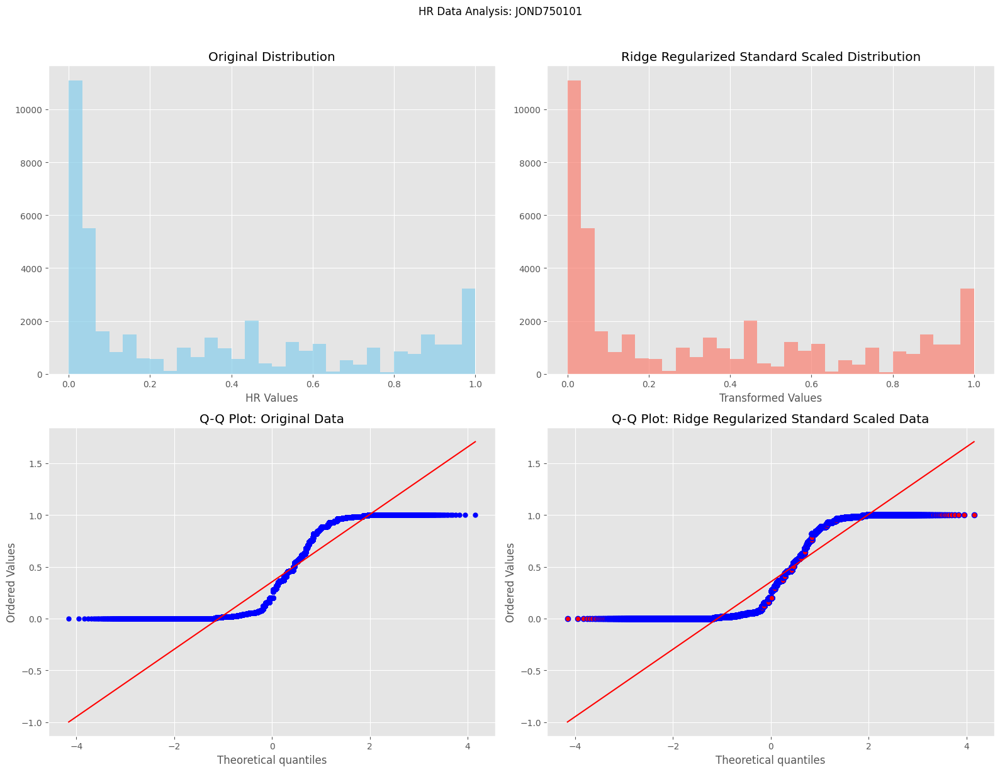

Processing files:  39%|█████████████████████████▏                                      | 11/28 [00:45<01:09,  4.09s/it]

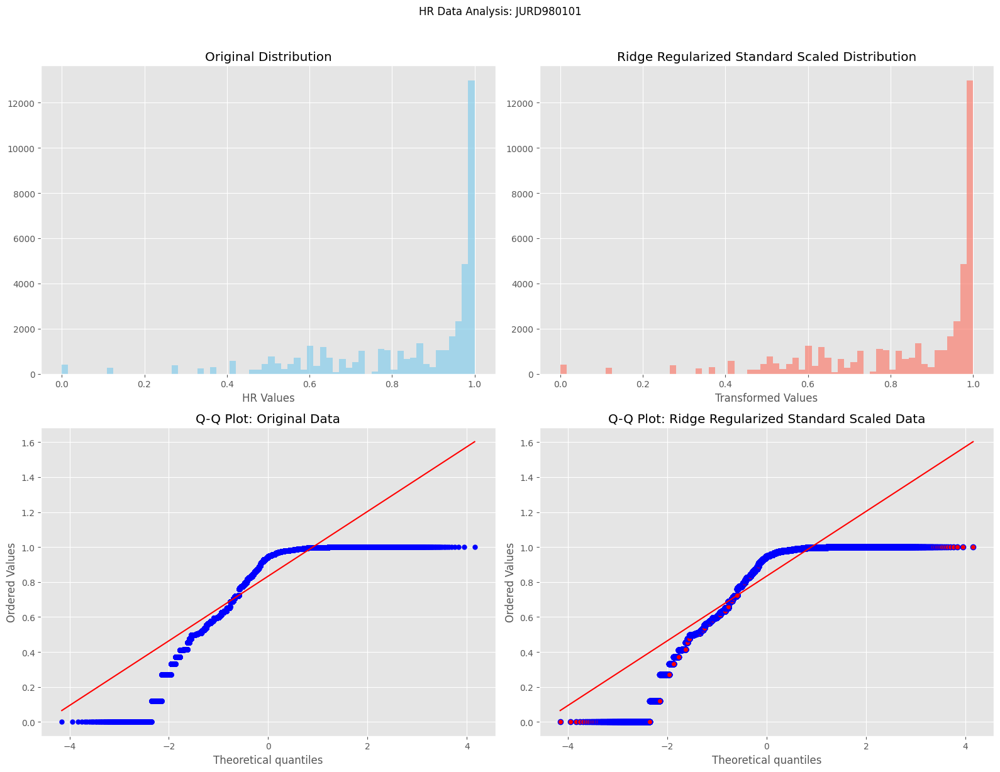

Processing files:  43%|███████████████████████████▍                                    | 12/28 [00:50<01:11,  4.50s/it]

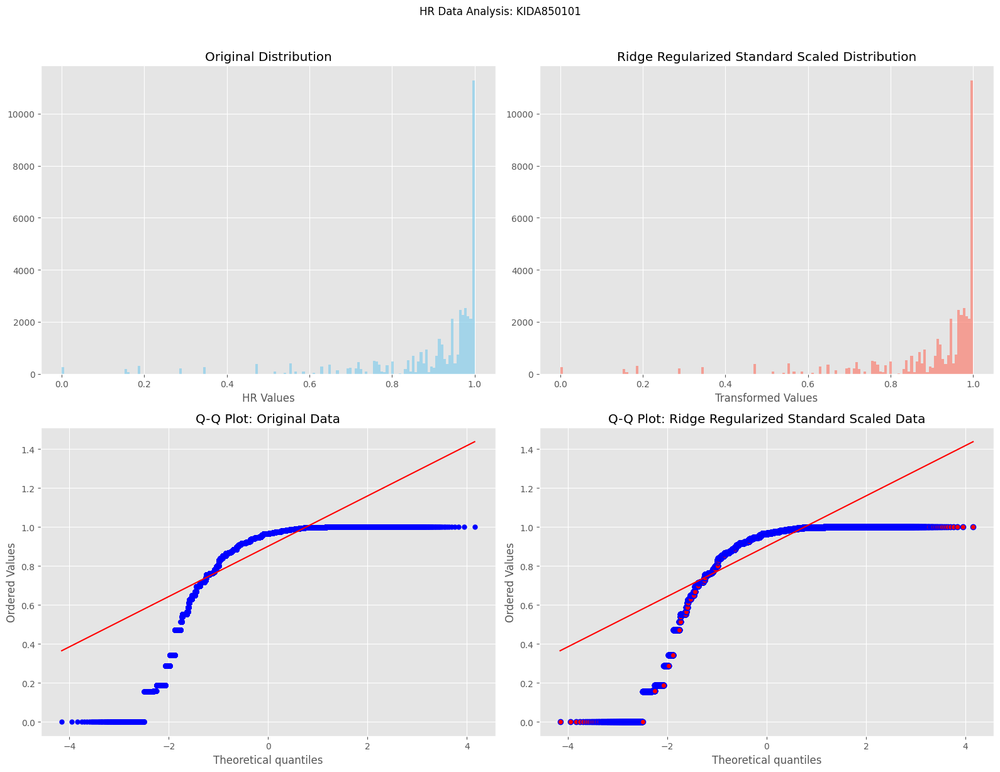

Processing files:  46%|█████████████████████████████▋                                  | 13/28 [00:54<01:05,  4.39s/it]

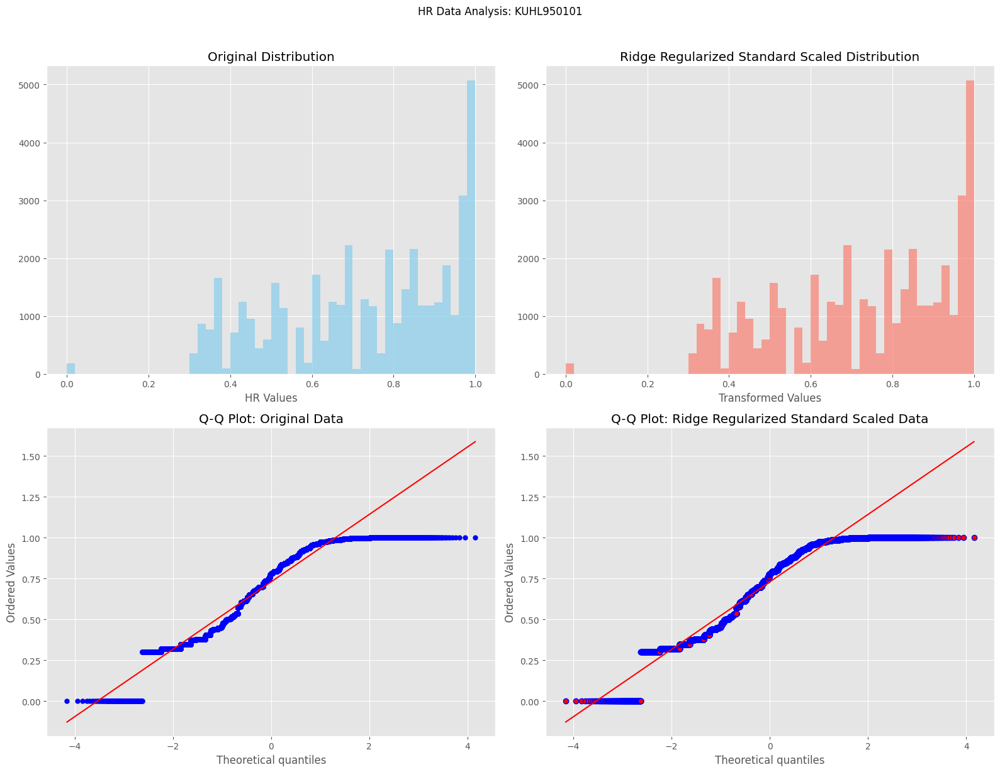

Processing files:  50%|████████████████████████████████                                | 14/28 [00:58<00:57,  4.12s/it]

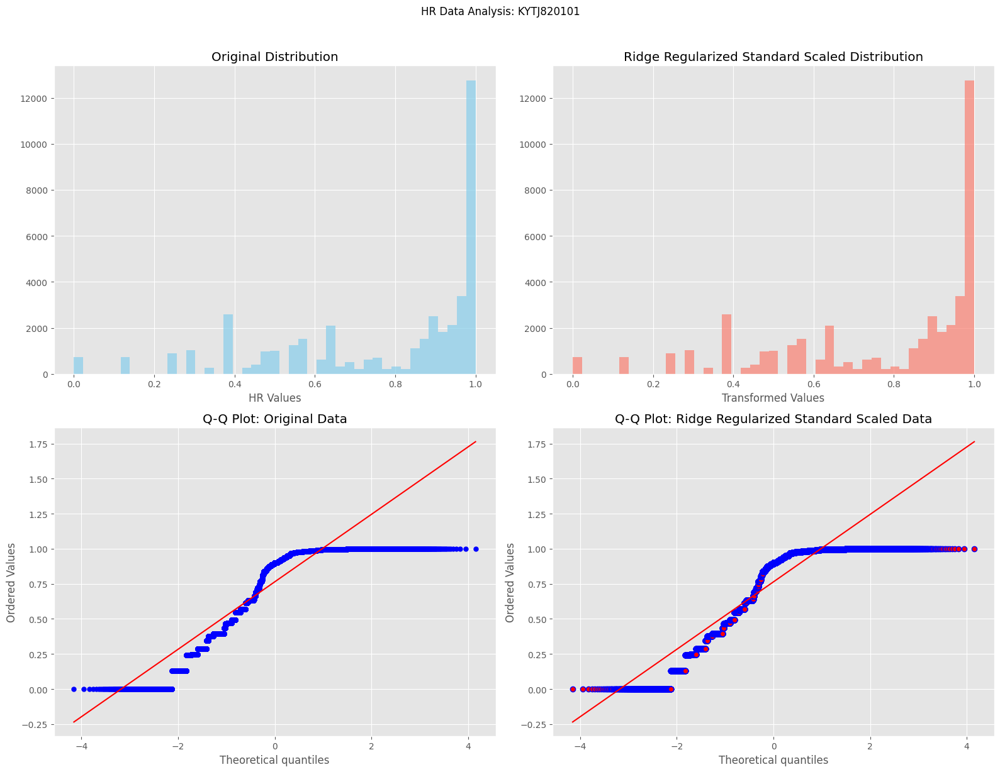

Processing files:  54%|██████████████████████████████████▎                             | 15/28 [01:02<00:53,  4.13s/it]

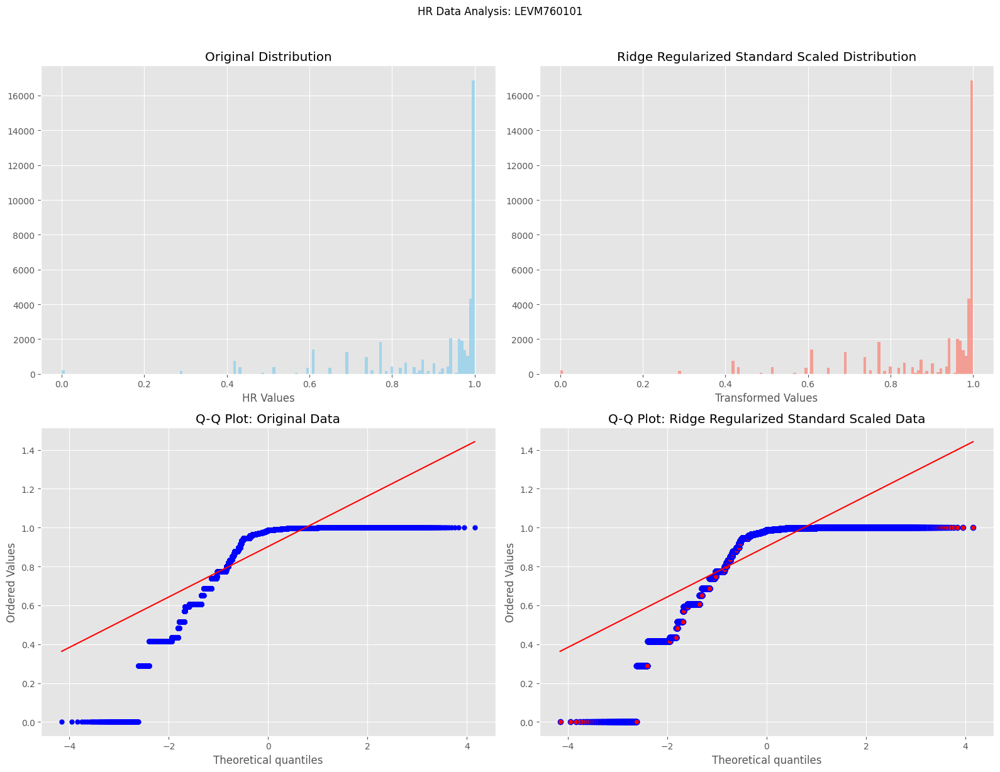

Processing files:  57%|████████████████████████████████████▌                           | 16/28 [01:08<00:55,  4.59s/it]

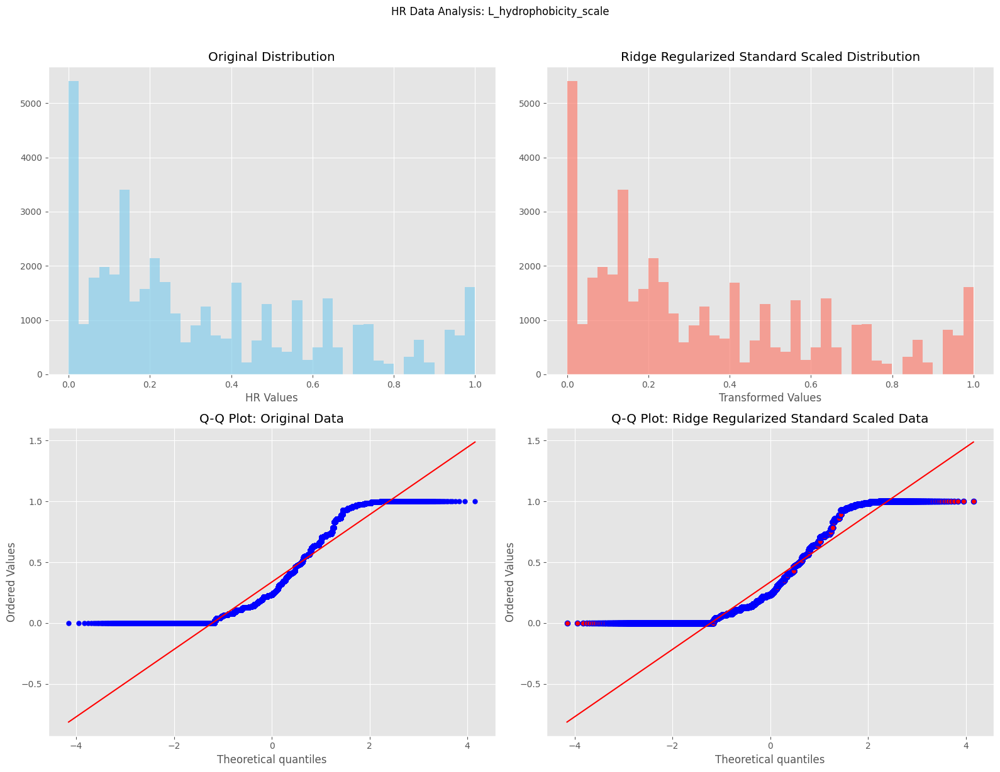

Processing files:  61%|██████████████████████████████████████▊                         | 17/28 [01:11<00:46,  4.22s/it]

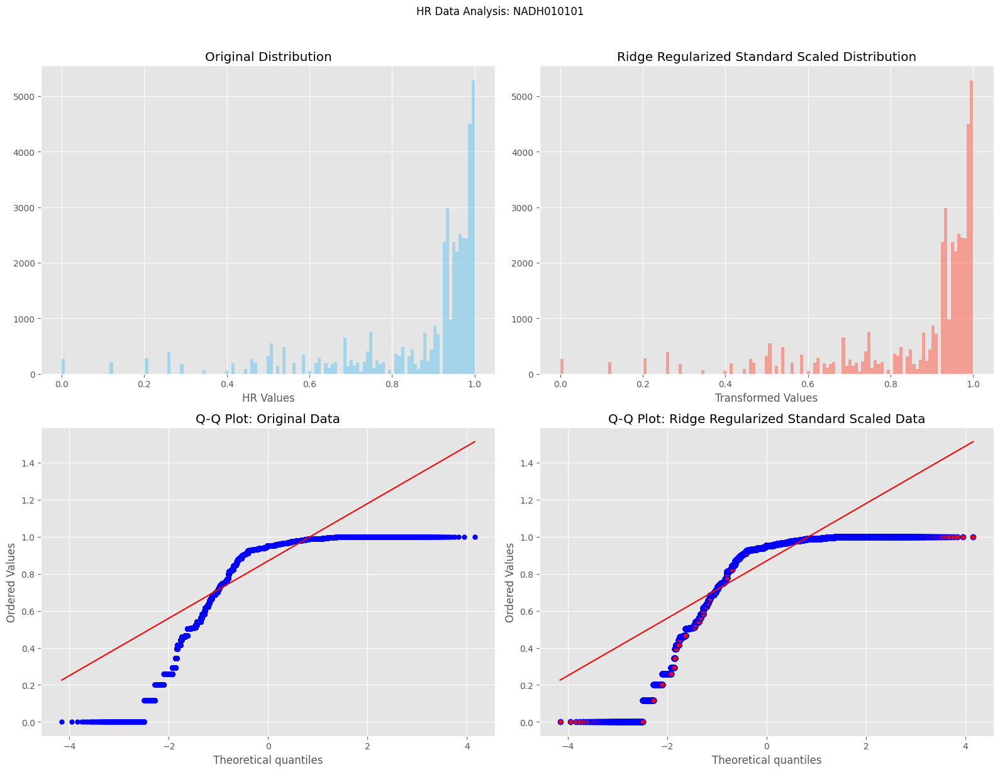

Processing files:  64%|█████████████████████████████████████████▏                      | 18/28 [01:16<00:42,  4.29s/it]

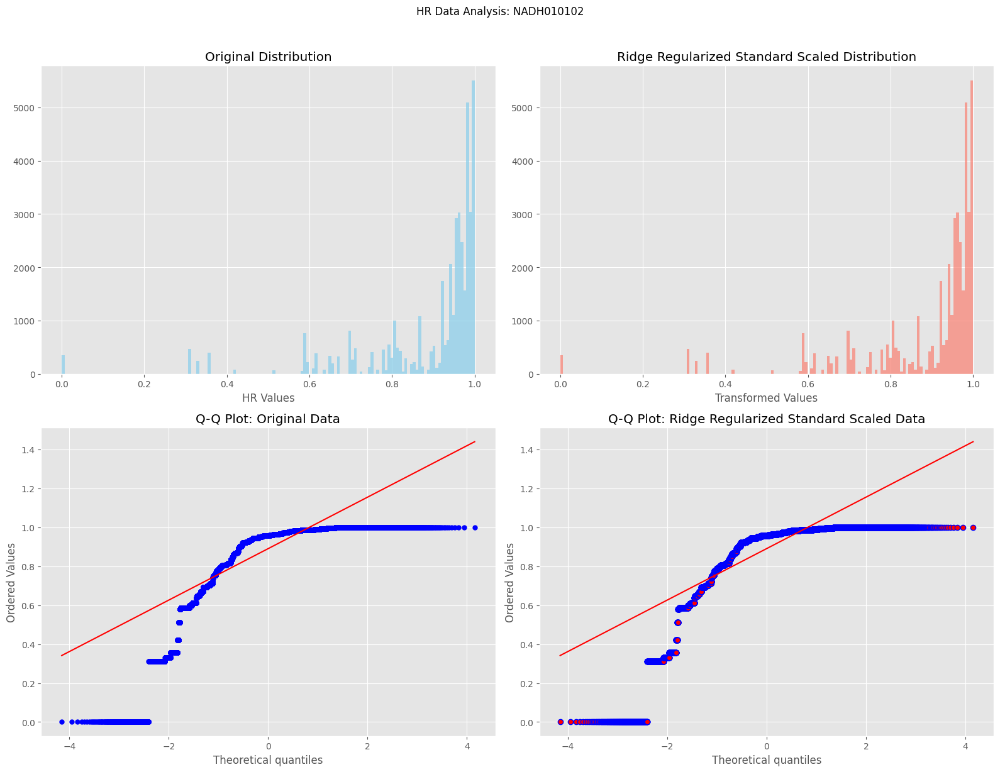

Processing files:  68%|███████████████████████████████████████████▍                    | 19/28 [01:20<00:38,  4.25s/it]

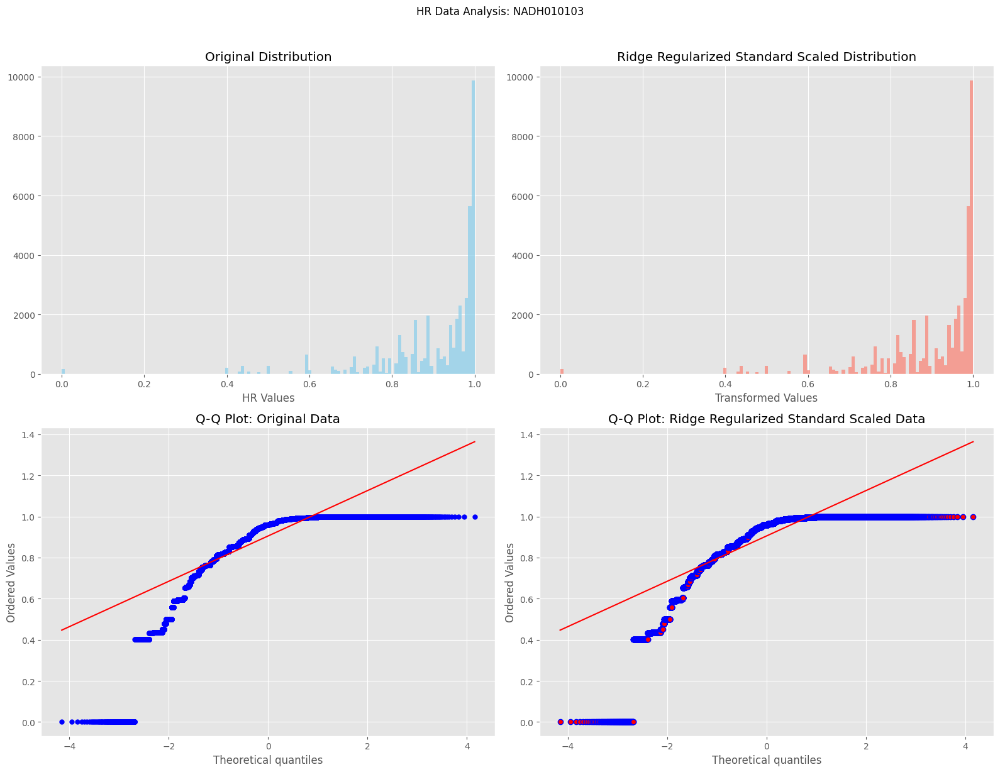

Processing files:  71%|█████████████████████████████████████████████▋                  | 20/28 [01:24<00:33,  4.16s/it]

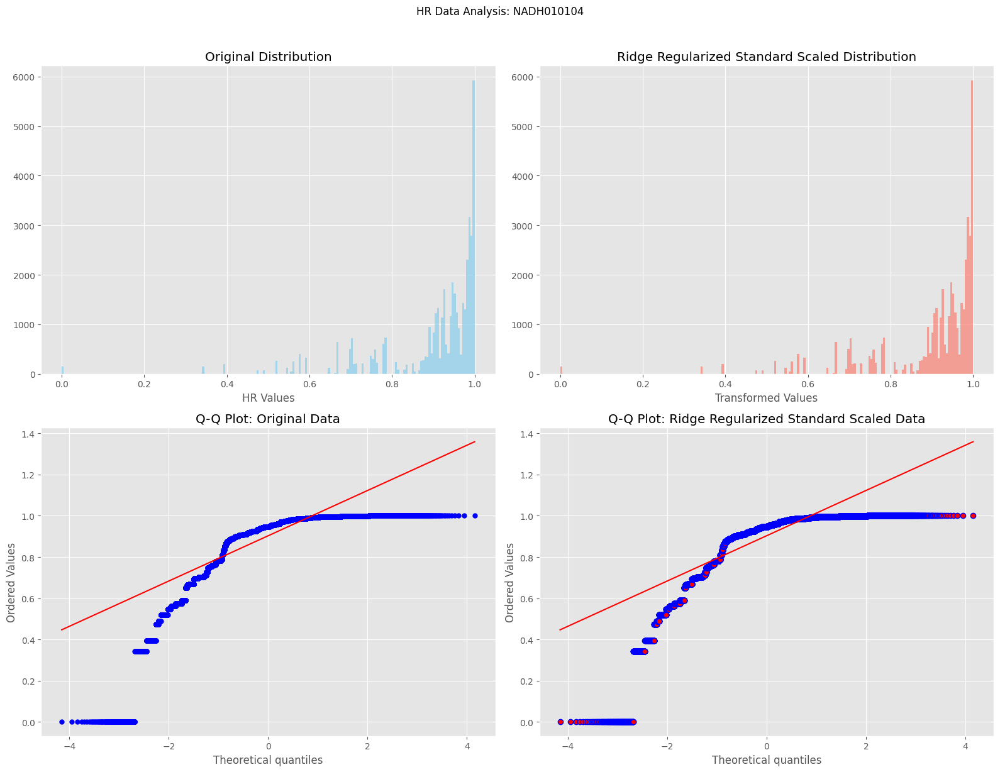

Processing files:  75%|████████████████████████████████████████████████                | 21/28 [01:29<00:30,  4.40s/it]

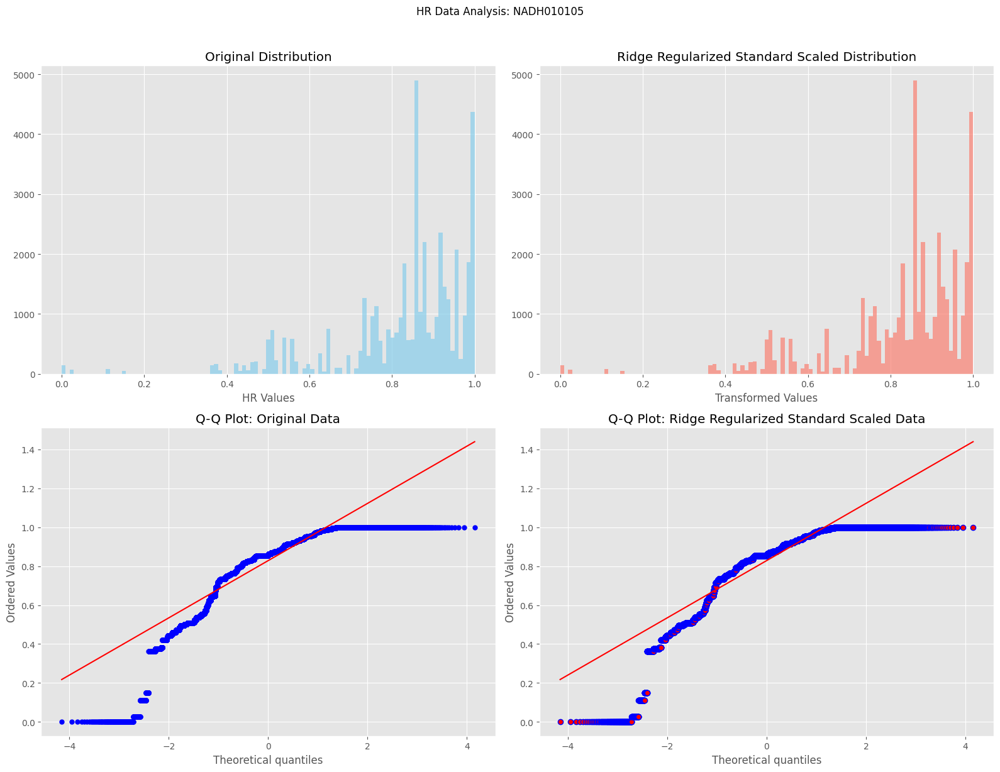

Processing files:  79%|██████████████████████████████████████████████████▎             | 22/28 [01:33<00:26,  4.38s/it]

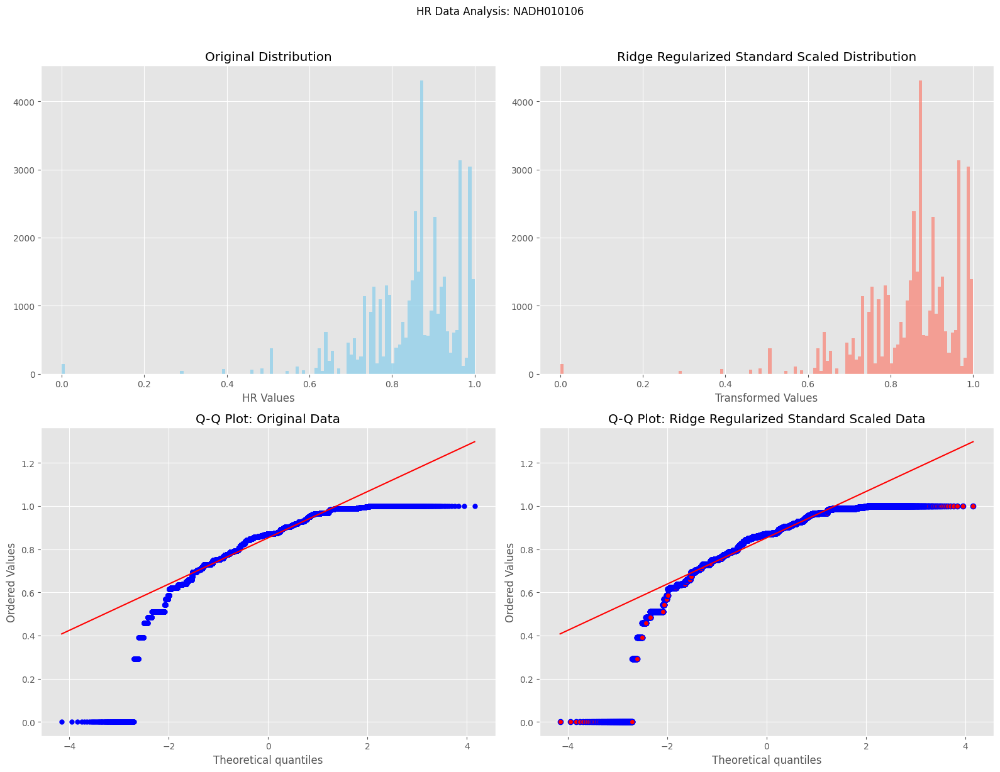

Processing files:  82%|████████████████████████████████████████████████████▌           | 23/28 [01:39<00:23,  4.77s/it]

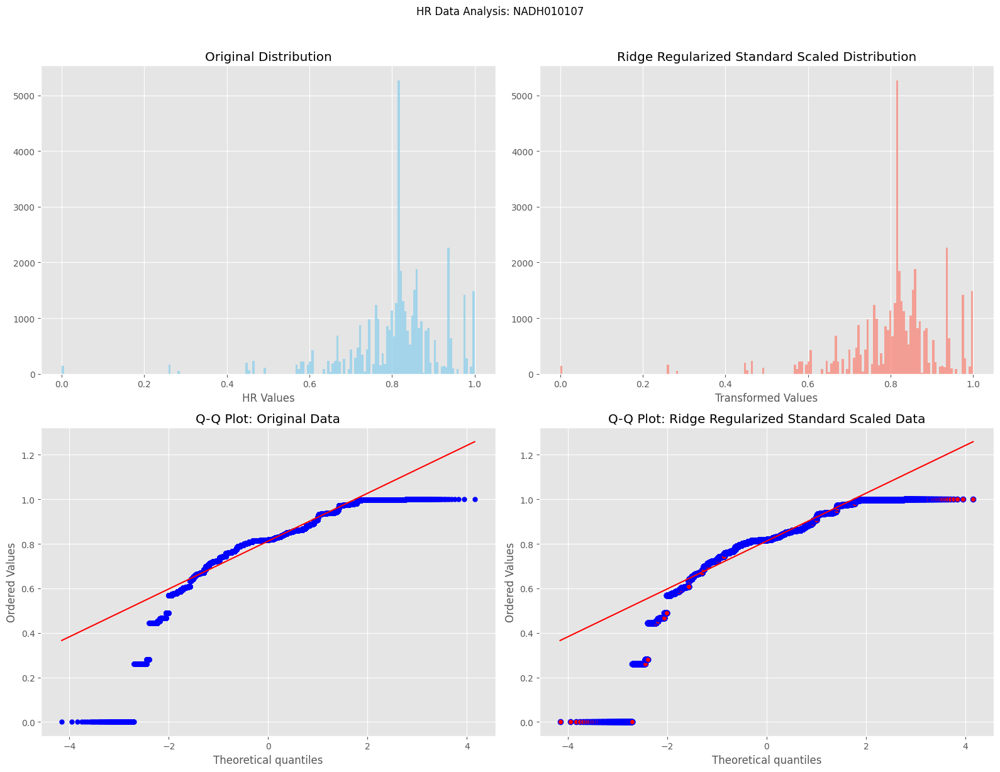

Processing files:  86%|██████████████████████████████████████████████████████▊         | 24/28 [01:44<00:20,  5.07s/it]

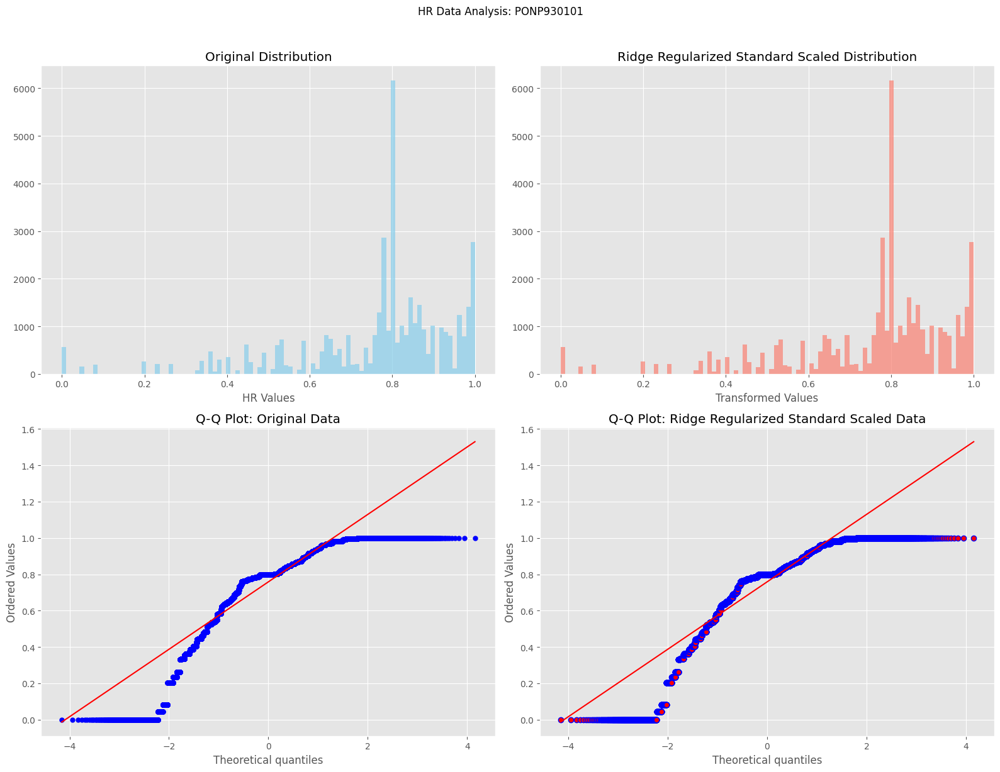

Processing files:  89%|█████████████████████████████████████████████████████████▏      | 25/28 [01:48<00:14,  4.71s/it]

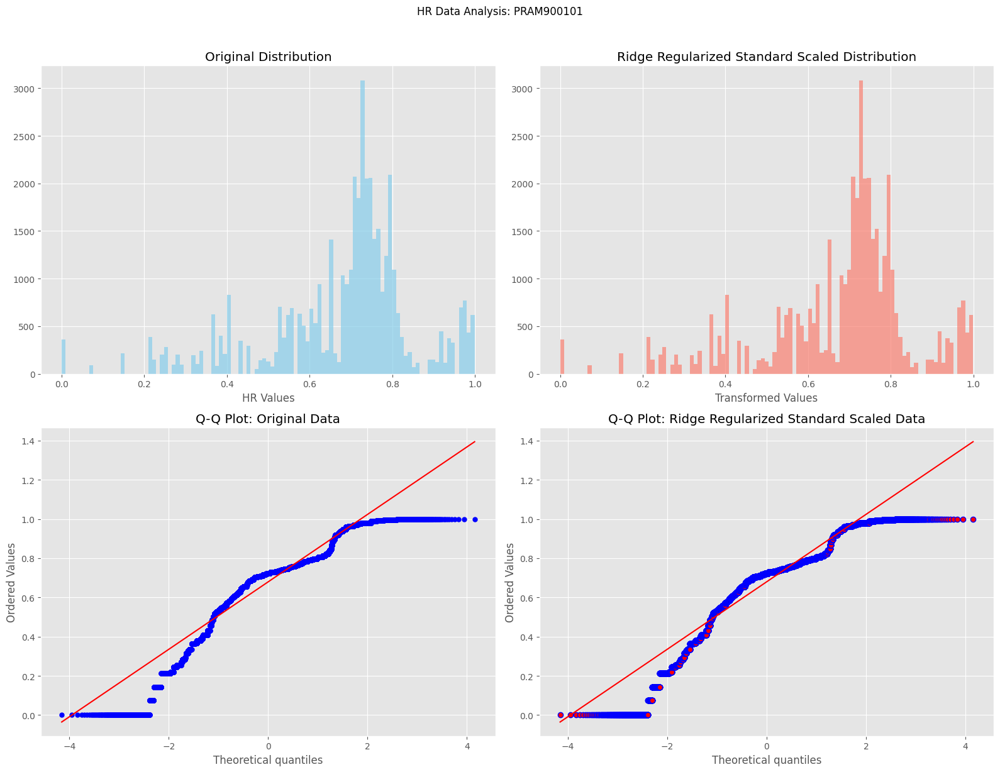

Processing files:  93%|███████████████████████████████████████████████████████████▍    | 26/28 [01:53<00:09,  4.58s/it]

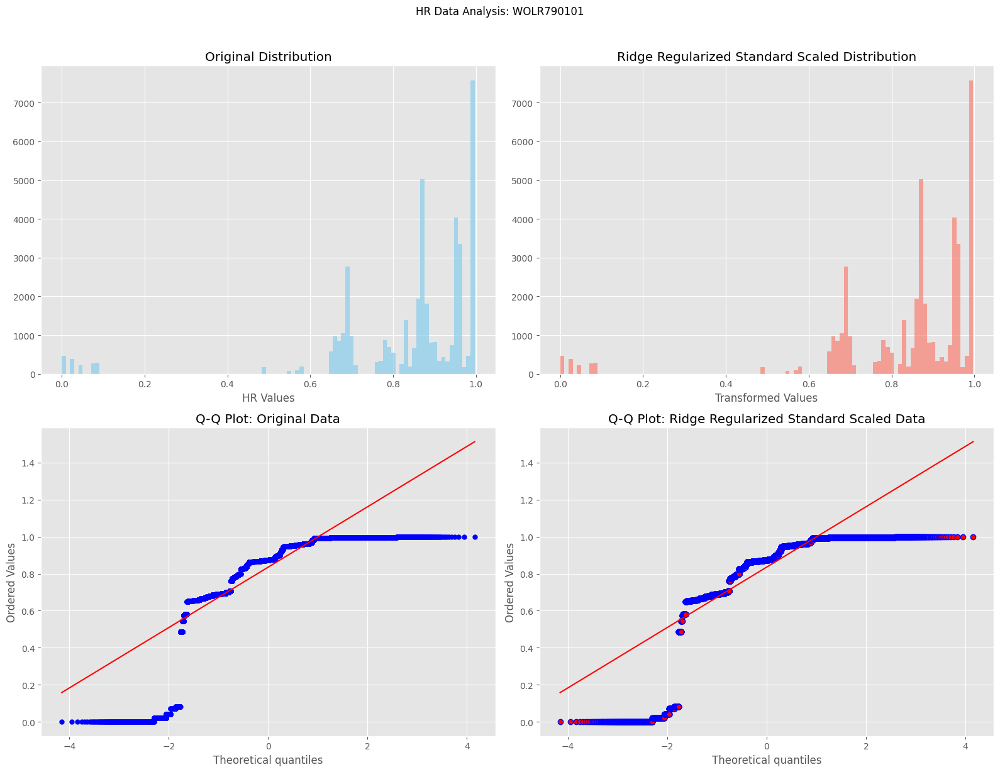

Processing files:  96%|█████████████████████████████████████████████████████████████▋  | 27/28 [01:57<00:04,  4.39s/it]

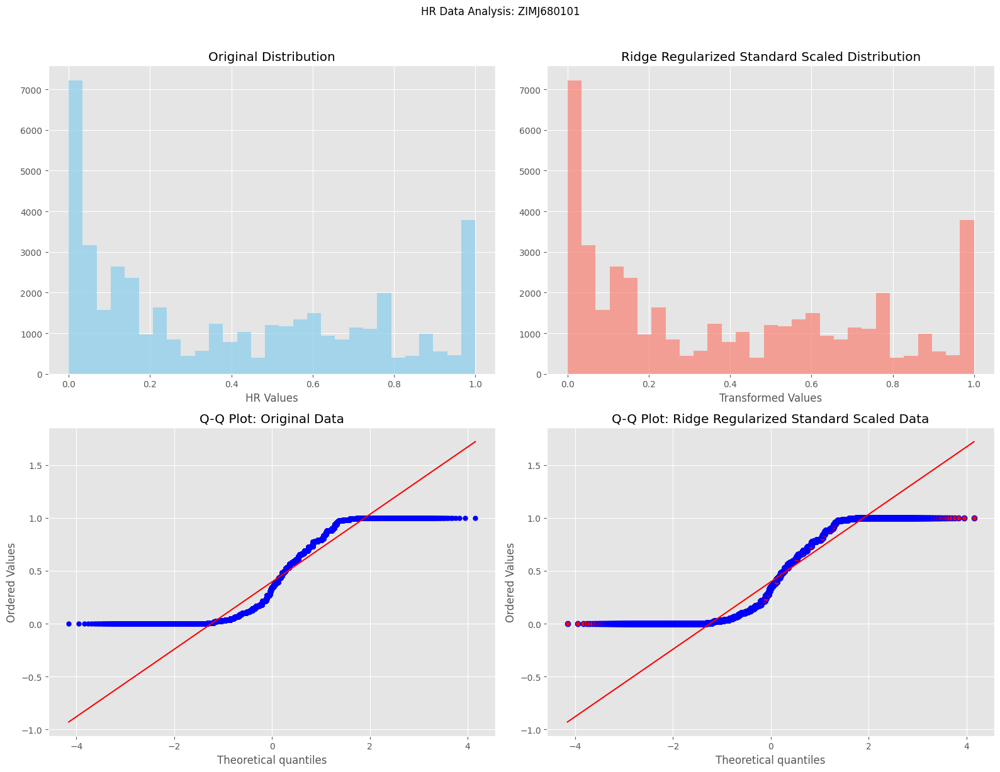

Processing files: 100%|████████████████████████████████████████████████████████████████| 28/28 [02:00<00:00,  4.30s/it]


Analysis complete!


In [11]:

# Directory setup
base_dir = "../generated_data/"
train_hr_dir = os.path.join(base_dir, "train/Hr_modified/")
test_hr_dir = os.path.join(base_dir, "test/Hr_modified/")

# Get all files
def get_file_list(directory):
    return {f.replace('.txt', '') for f in os.listdir(directory) if f.endswith('.txt')}

common_files = get_file_list(train_hr_dir) & get_file_list(test_hr_dir)

if not common_files:
    print("No common files found!")
    exit()

print(f"Found {len(common_files)} files to process")

plt.style.use('ggplot')
plt.rcParams['figure.figsize'] = [16, 8]

for file_name in tqdm(sorted(common_files), desc="Processing files"):
    try:
        # Load and combine data
        train_hr = np.loadtxt(os.path.join(train_hr_dir, f"{file_name}.txt"))
        test_hr = np.loadtxt(os.path.join(test_hr_dir, f"{file_name}.txt"))
        combined_hr = np.concatenate([train_hr.ravel(), test_hr.ravel()])
        
        # Apply L2 (Ridge) transformation using Standard Scaler
        scaler = StandardScaler()
        hr_transformed = scaler.fit_transform(combined_hr.reshape(-1, 1)).flatten()
        
        # Apply Ridge (L2 Regularization)
        ridge = Ridge(alpha=0.1)
        hr_transformed = hr_transformed.reshape(-1, 1)
        ridge.fit(hr_transformed, combined_hr)  # Fit Ridge on transformed data
        hr_ridge = ridge.predict(hr_transformed)  # Get Ridge predictions
        
        # Create figure
        fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(16, 12))
        fig.suptitle(f'HR Data Analysis: {file_name}', y=1.02)
        
        # Original histogram
        ax1.hist(combined_hr, bins='auto', color='skyblue', alpha=0.7)
        ax1.set_title('Original Distribution')
        ax1.set_xlabel('HR Values')
        
        # Transformed histogram
        ax2.hist(hr_ridge, bins='auto', color='salmon', alpha=0.7)
        ax2.set_title('Ridge Regularized Standard Scaled Distribution')
        ax2.set_xlabel('Transformed Values')
        
        # Original Q-Q plot
        stats.probplot(combined_hr, dist="norm", plot=ax3)
        ax3.set_title('Q-Q Plot: Original Data')
        ax3.get_lines()[0].set_markerfacecolor('blue')
        ax3.get_lines()[0].set_markersize(5.0)
        
        # Transformed Q-Q plot
        stats.probplot(hr_ridge, dist="norm", plot=ax4)
        ax4.set_title('Q-Q Plot: Ridge Regularized Standard Scaled Data')
        ax4.get_lines()[0].set_markerfacecolor('red')
        
        plt.tight_layout()
        plt.show()
        
    except Exception as e:
        print(f"\nError processing {file_name}: {str(e)}")
        continue

print("\nAnalysis complete!")

# HaHb Data Transformation Analysis

This code analyzes HaHb data using bod power transformations, comparing their effects on distribution normalization.

  0%|                                                                                           | 0/28 [00:00<?, ?it/s]

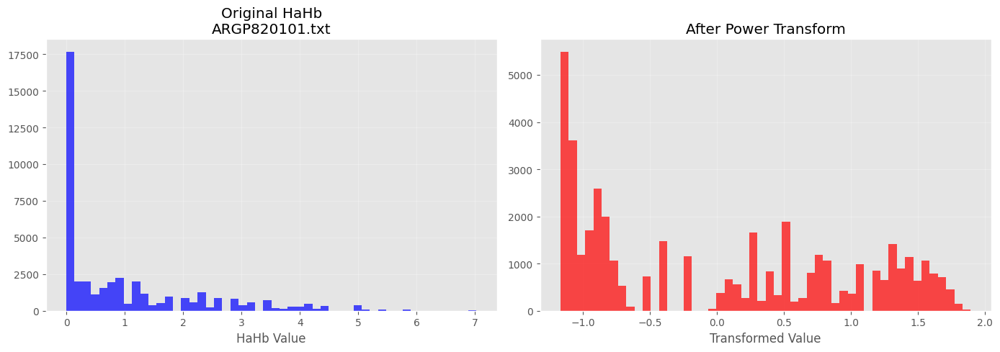

  4%|██▉                                                                                | 1/28 [00:02<00:57,  2.14s/it]

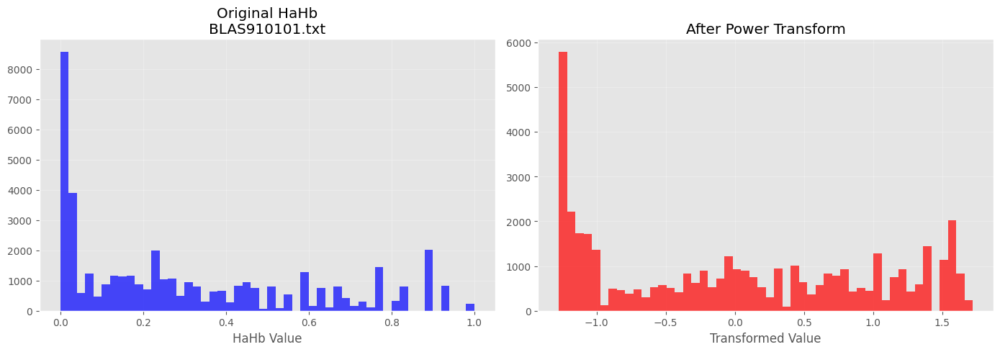

  7%|█████▉                                                                             | 2/28 [00:03<00:48,  1.86s/it]

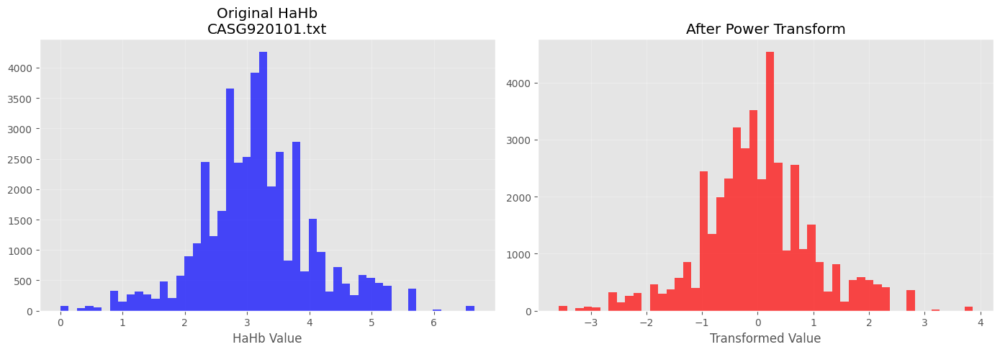

 11%|████████▉                                                                          | 3/28 [00:05<00:42,  1.71s/it]

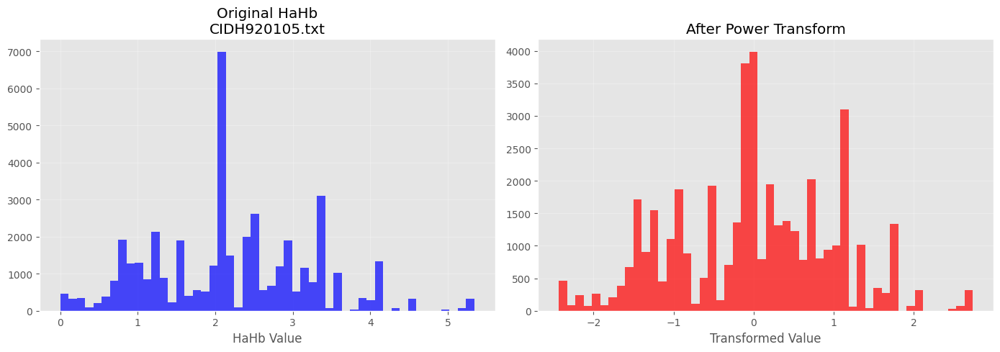

 14%|███████████▊                                                                       | 4/28 [00:07<00:42,  1.76s/it]

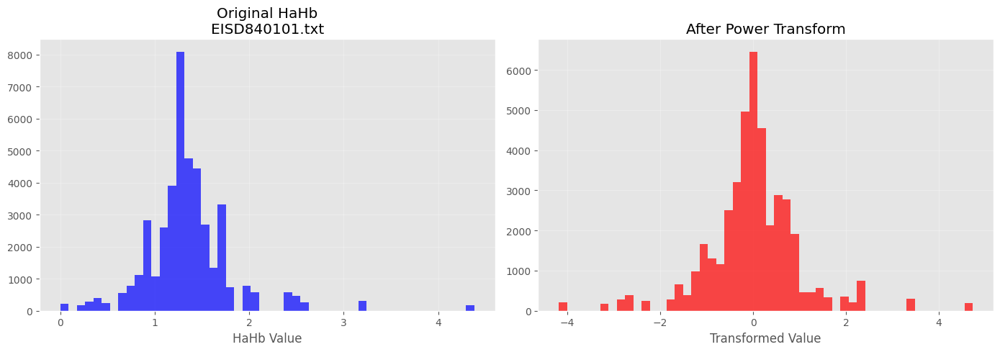

 18%|██████████████▊                                                                    | 5/28 [00:08<00:40,  1.74s/it]

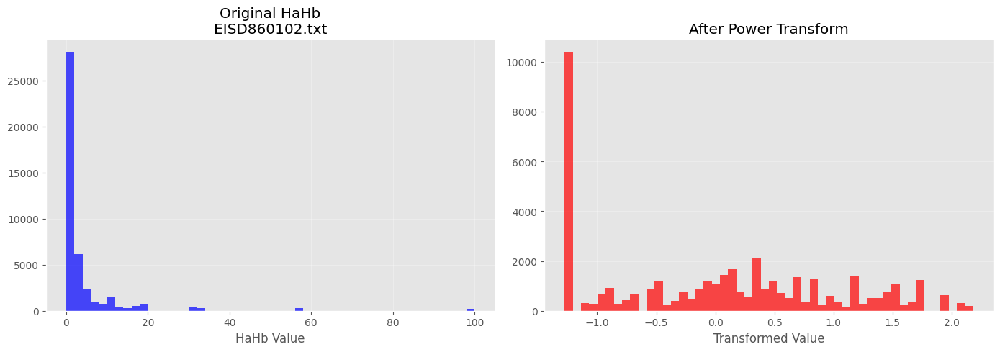

 21%|█████████████████▊                                                                 | 6/28 [00:10<00:40,  1.83s/it]

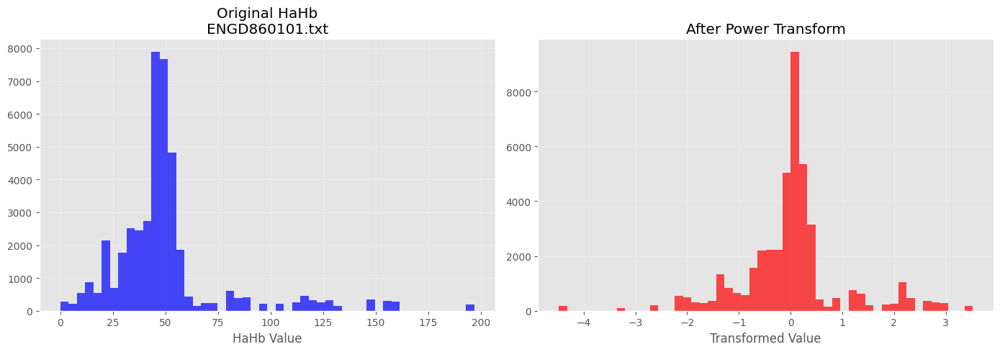

 25%|████████████████████▊                                                              | 7/28 [00:12<00:38,  1.84s/it]

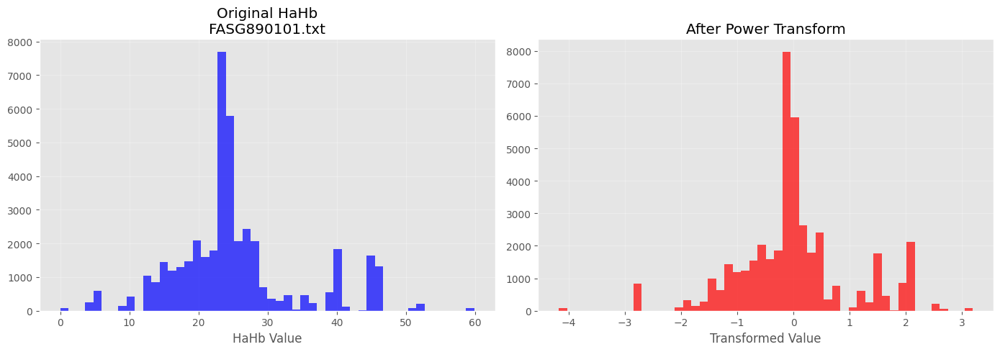

 29%|███████████████████████▋                                                           | 8/28 [00:14<00:36,  1.81s/it]

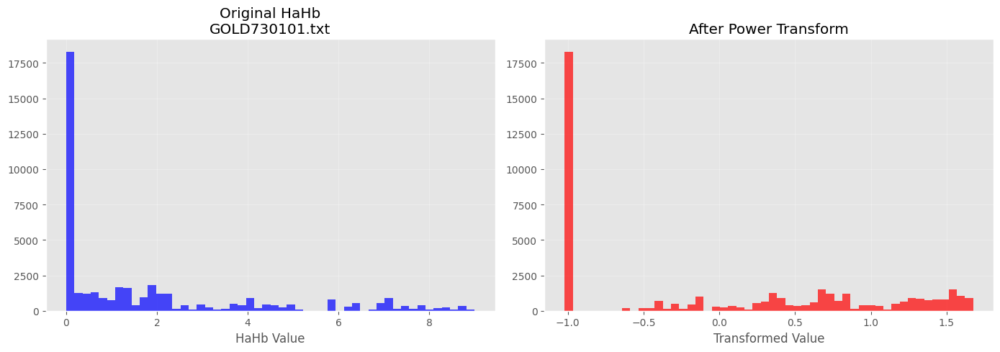

 32%|██████████████████████████▋                                                        | 9/28 [00:16<00:33,  1.75s/it]

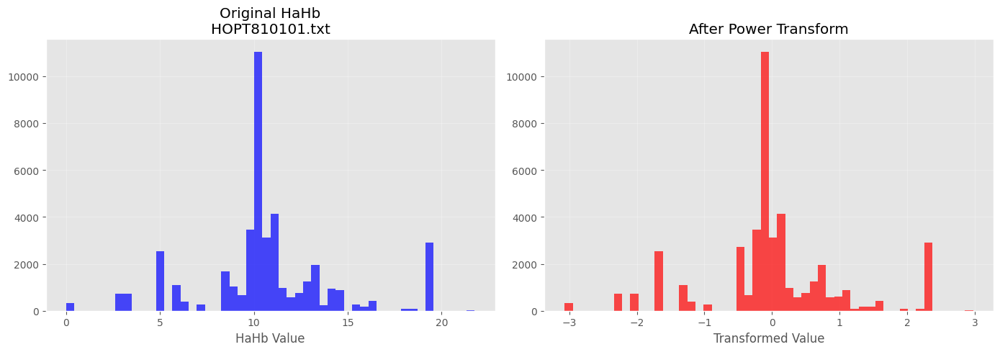

 36%|█████████████████████████████▎                                                    | 10/28 [00:17<00:30,  1.72s/it]

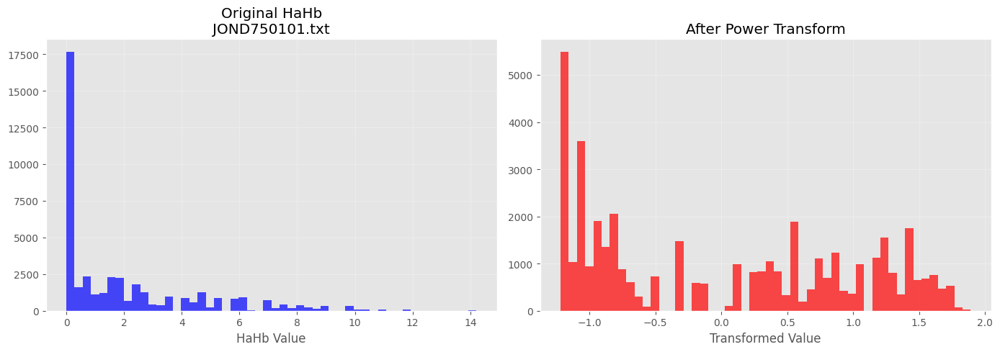

 39%|████████████████████████████████▏                                                 | 11/28 [00:20<00:32,  1.94s/it]

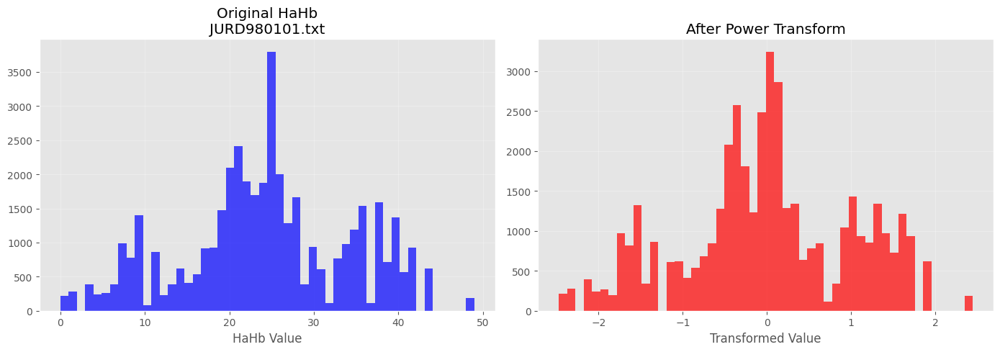

 43%|███████████████████████████████████▏                                              | 12/28 [00:22<00:30,  1.90s/it]

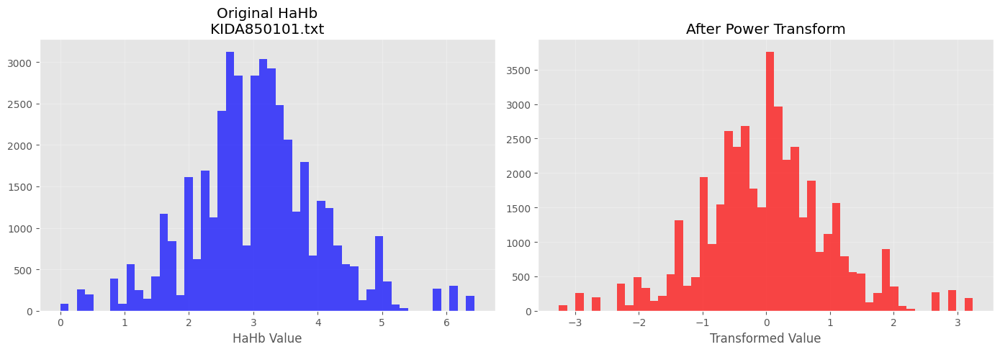

 46%|██████████████████████████████████████                                            | 13/28 [00:23<00:27,  1.84s/it]

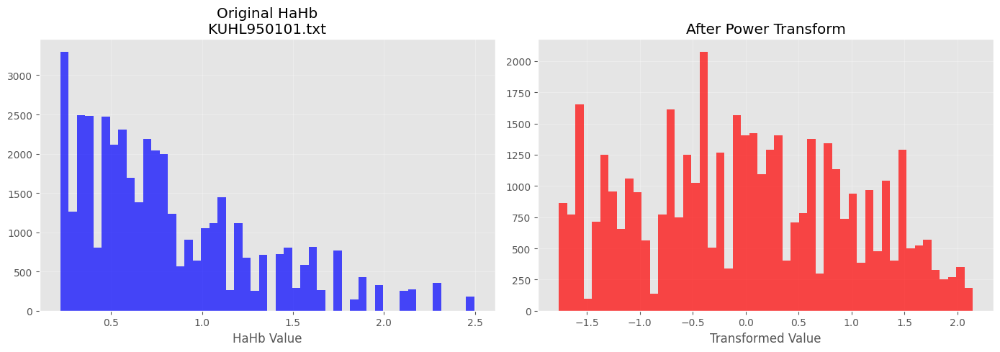

 50%|█████████████████████████████████████████                                         | 14/28 [00:25<00:25,  1.80s/it]

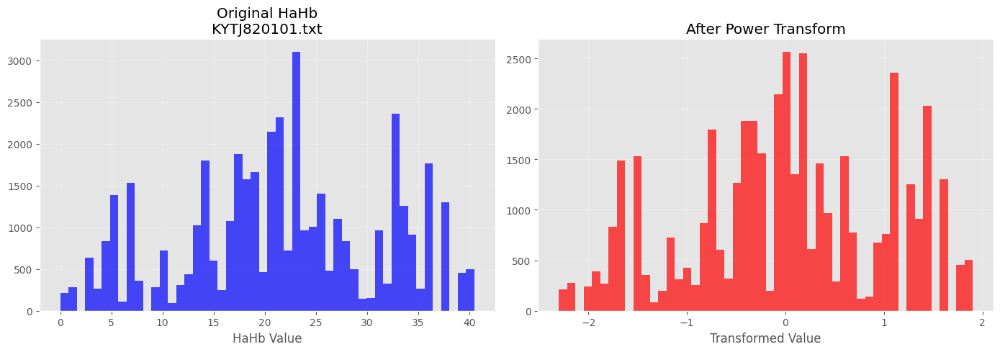

 54%|███████████████████████████████████████████▉                                      | 15/28 [00:27<00:23,  1.80s/it]

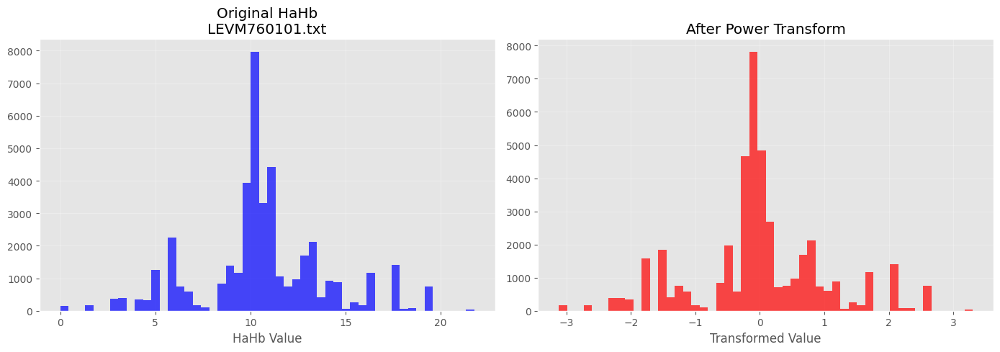

 57%|██████████████████████████████████████████████▊                                   | 16/28 [00:28<00:21,  1.79s/it]

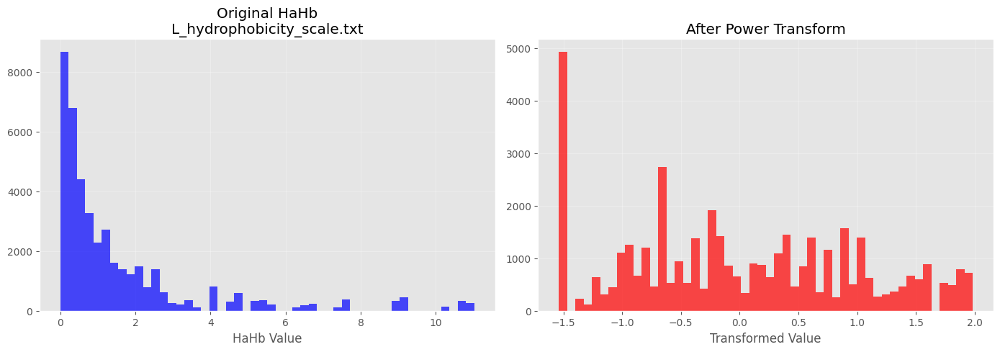

 61%|█████████████████████████████████████████████████▊                                | 17/28 [00:30<00:20,  1.83s/it]

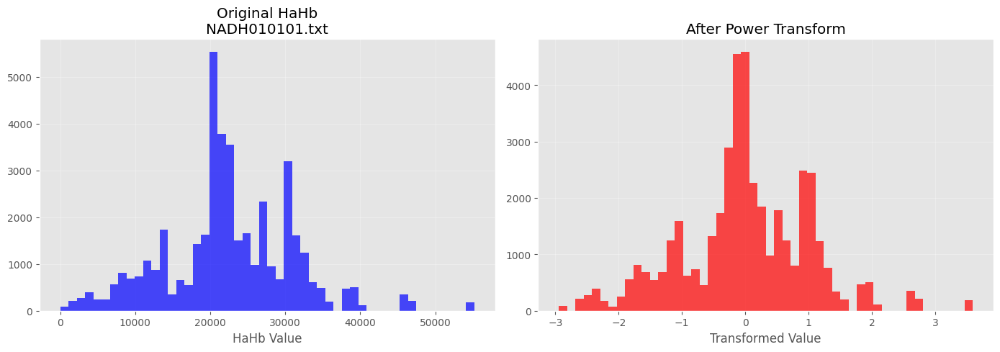

 64%|████████████████████████████████████████████████████▋                             | 18/28 [00:32<00:18,  1.81s/it]

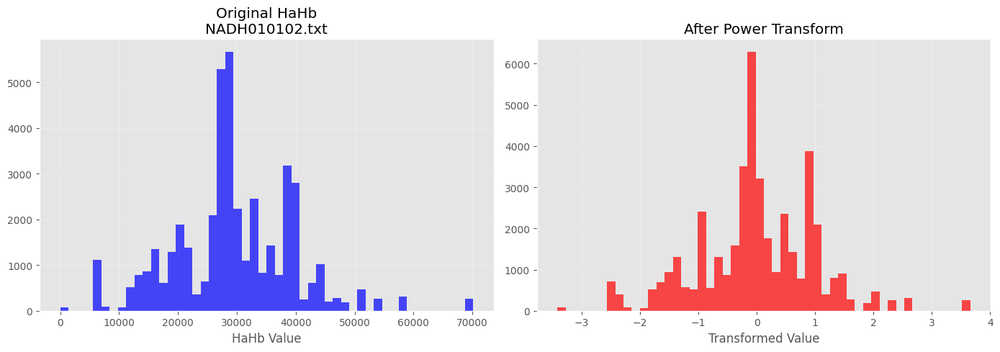

 68%|███████████████████████████████████████████████████████▋                          | 19/28 [00:34<00:15,  1.76s/it]

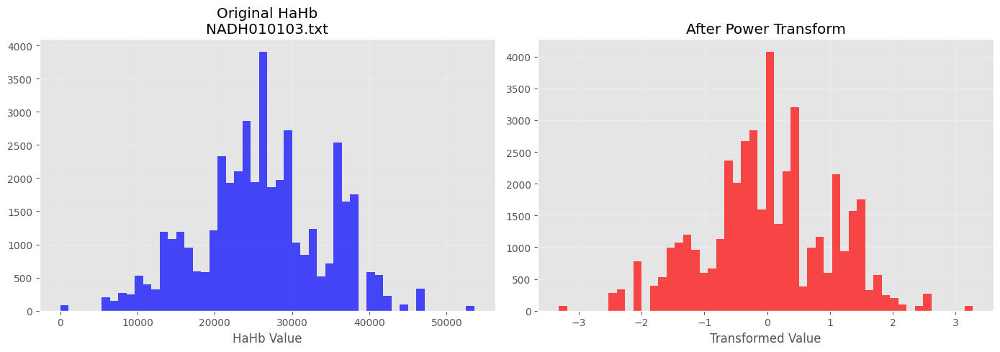

 71%|██████████████████████████████████████████████████████████▌                       | 20/28 [00:36<00:13,  1.75s/it]

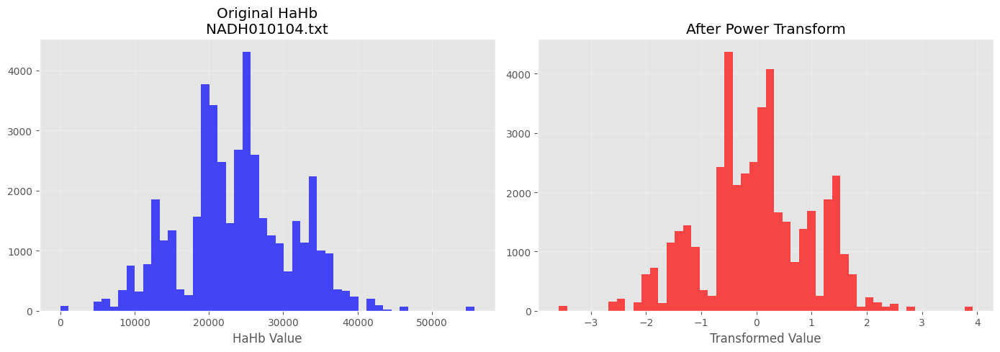

 75%|█████████████████████████████████████████████████████████████▌                    | 21/28 [00:37<00:12,  1.78s/it]

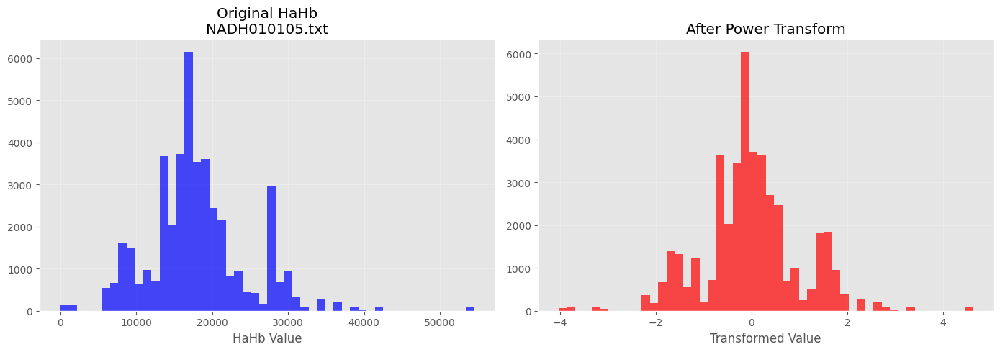

 79%|████████████████████████████████████████████████████████████████▍                 | 22/28 [00:39<00:11,  1.86s/it]

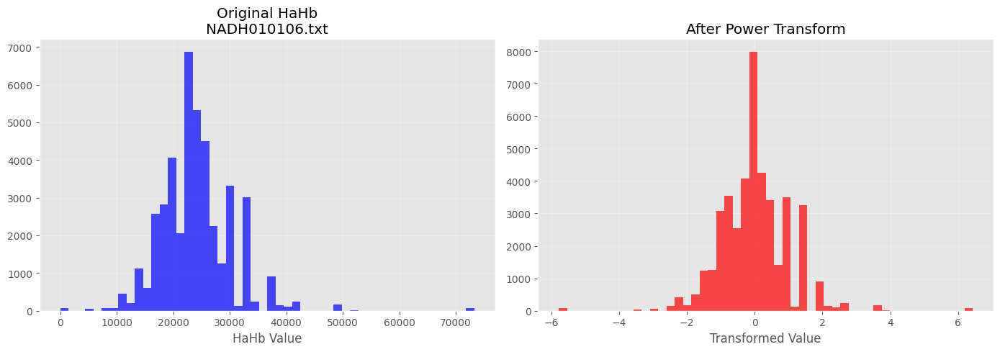

 82%|███████████████████████████████████████████████████████████████████▎              | 23/28 [00:41<00:08,  1.79s/it]

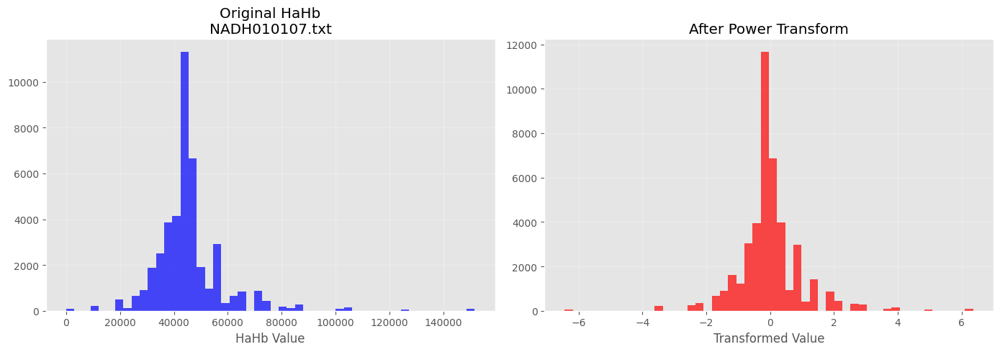

 86%|██████████████████████████████████████████████████████████████████████▎           | 24/28 [00:43<00:06,  1.72s/it]

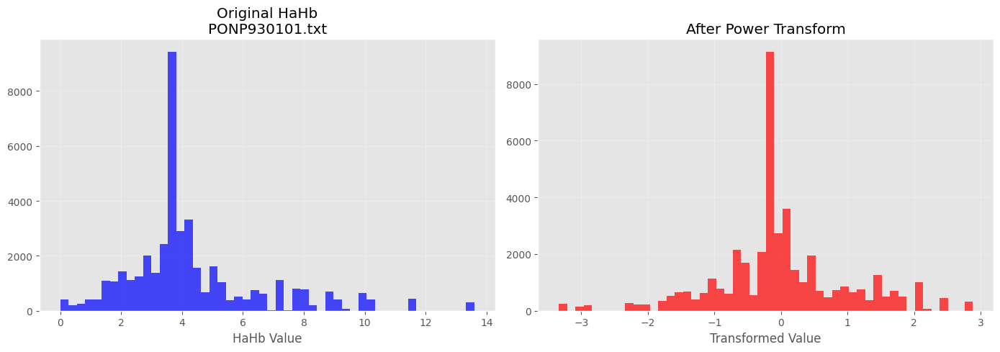

 89%|█████████████████████████████████████████████████████████████████████████▏        | 25/28 [00:44<00:05,  1.74s/it]

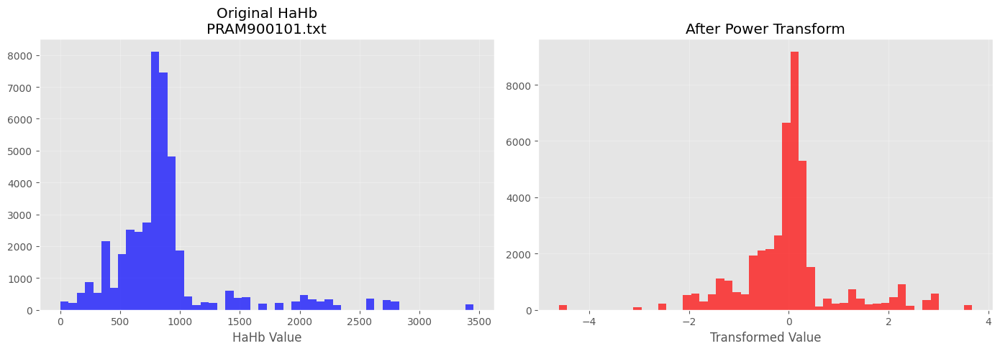

 93%|████████████████████████████████████████████████████████████████████████████▏     | 26/28 [00:46<00:03,  1.83s/it]

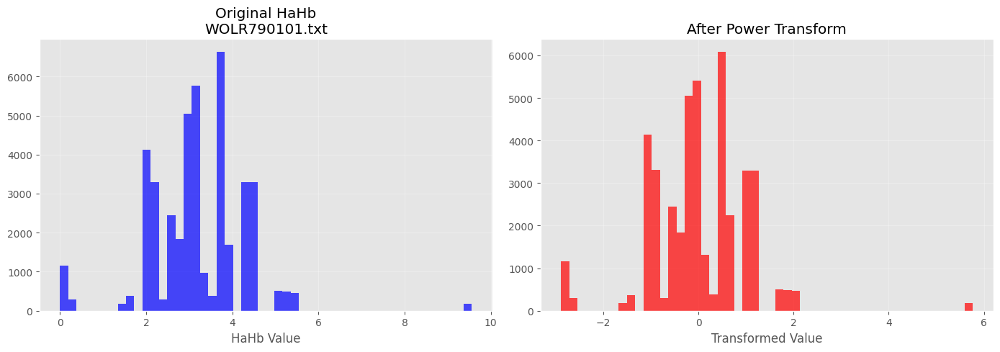

 96%|███████████████████████████████████████████████████████████████████████████████   | 27/28 [00:48<00:01,  1.81s/it]

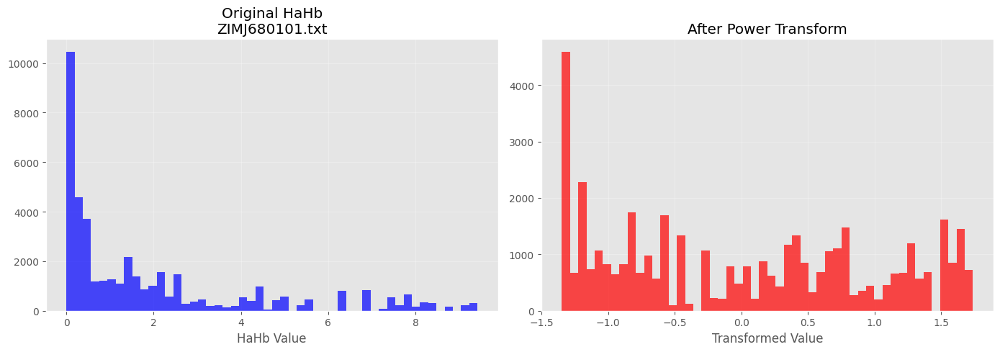

100%|██████████████████████████████████████████████████████████████████████████████████| 28/28 [00:50<00:00,  1.82s/it]


In [34]:
# Directory setup (using your modified HaHb data)
base_dir = "../generated_data/"
train_hahb_dir = os.path.join(base_dir, "train/HaHb_modified/")
test_hahb_dir = os.path.join(base_dir, "test/HaHb_modified/")

# Initialize transformer
transformer = PowerTransformer(method='yeo-johnson')  # Handles positive/negative values

# Process files
for file_name in tqdm(os.listdir(train_hahb_dir)):
    if file_name.endswith('.txt'):
        try:
            # Load HaHb data
            train_hahb = np.loadtxt(os.path.join(train_hahb_dir, file_name))
            test_hahb = np.loadtxt(os.path.join(test_hahb_dir, file_name))
            
            # Combine and transform
            combined_hahb = np.concatenate([train_hahb.ravel(), test_hahb.ravel()])
            hahb_transformed = transformer.fit_transform(combined_hahb.reshape(-1, 1))
            
            # Plot comparison
            fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))
            
            # Original distribution
            ax1.hist(combined_hahb, bins=50, color='blue', alpha=0.7)
            ax1.set_title(f'Original HaHb\n{file_name}')
            ax1.set_xlabel('HaHb Value')
            
            # Transformed distribution
            ax2.hist(hahb_transformed, bins=50, color='red', alpha=0.7)
            ax2.set_title('After Power Transform')
            ax2.set_xlabel('Transformed Value')
            
            plt.tight_layout()
            plt.show()
            
        except Exception as e:
            print(f"Error processing {file_name}: {str(e)}")
            continue

# HR Data Log Transformation Analysis

This code performs log transformation (log(x+1)) on HR data from training and test sets, comparing original and transformed distributions.

## Code Implementation

  0%|                                                                                           | 0/28 [00:00<?, ?it/s]

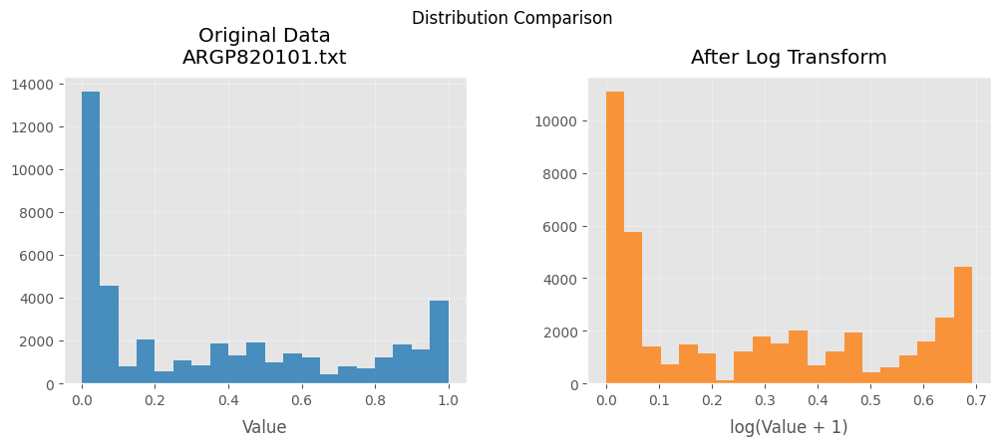

  4%|██▉                                                                                | 1/28 [00:01<00:44,  1.64s/it]

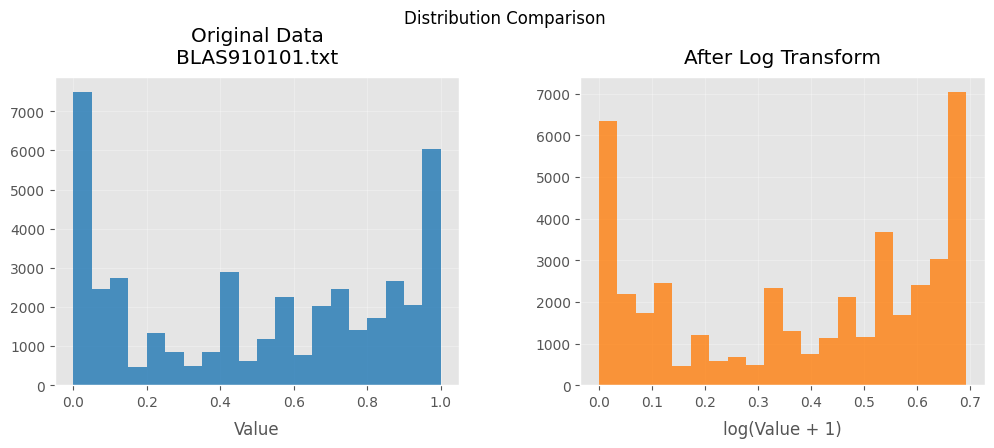

  7%|█████▉                                                                             | 2/28 [00:02<00:35,  1.36s/it]

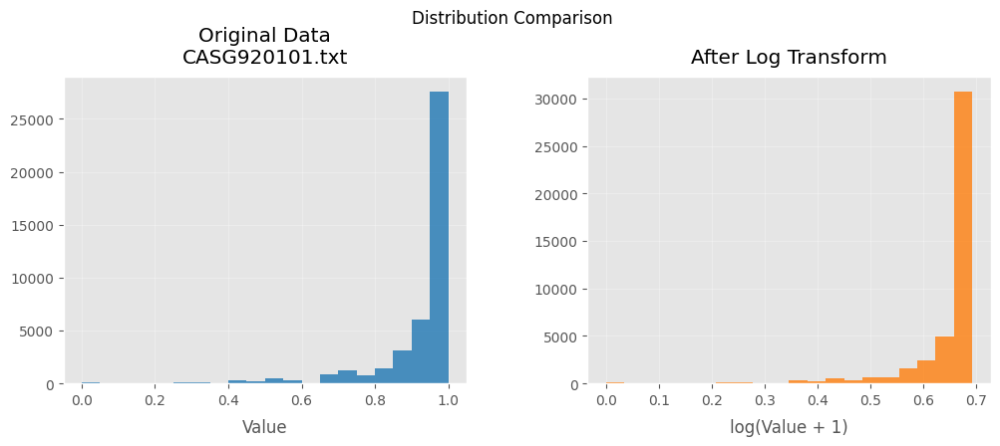

 11%|████████▉                                                                          | 3/28 [00:03<00:31,  1.25s/it]

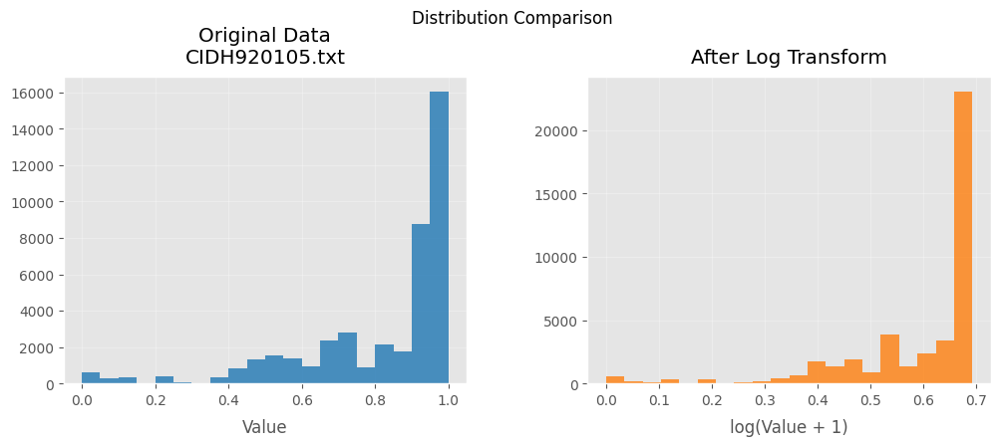

 14%|███████████▊                                                                       | 4/28 [00:05<00:28,  1.18s/it]

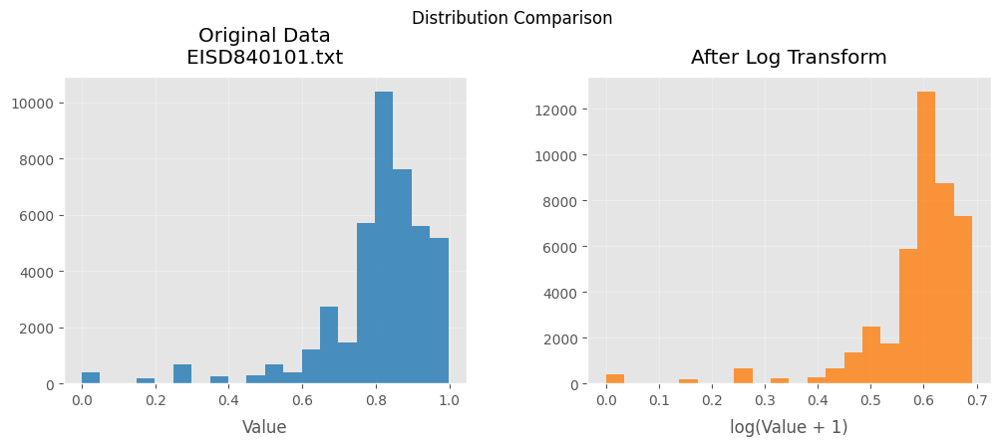

 18%|██████████████▊                                                                    | 5/28 [00:06<00:28,  1.22s/it]

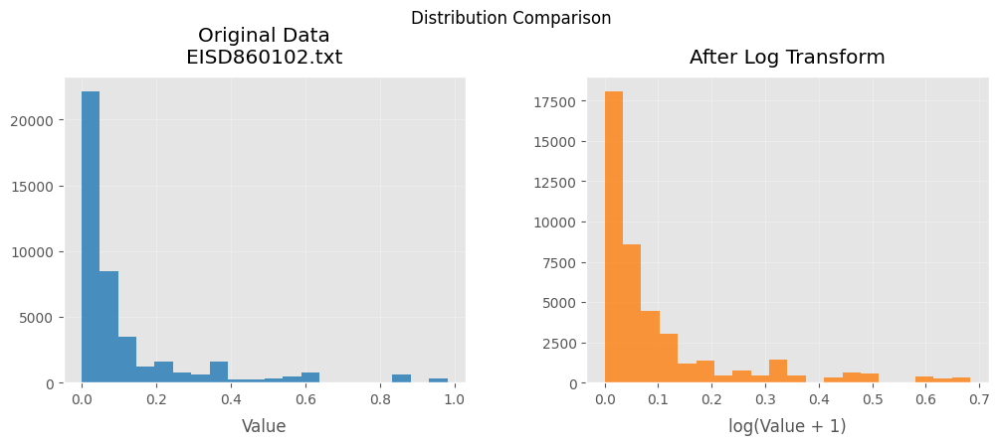

 21%|█████████████████▊                                                                 | 6/28 [00:07<00:26,  1.21s/it]

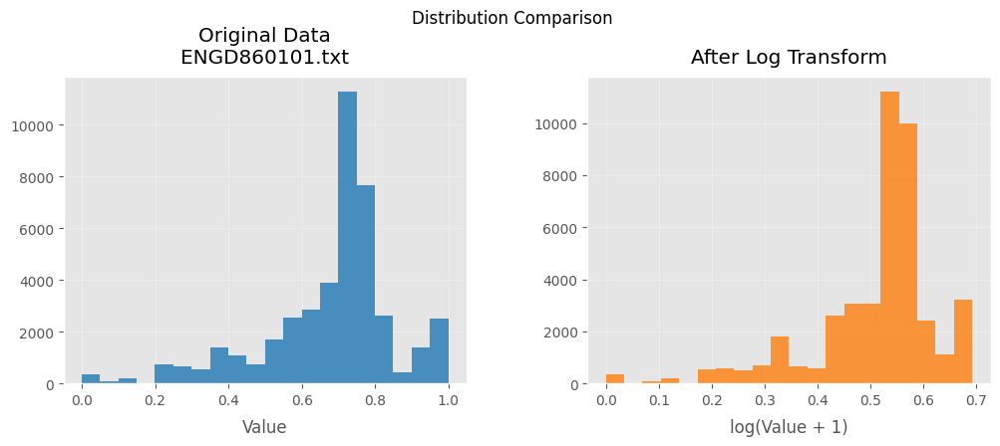

 25%|████████████████████▊                                                              | 7/28 [00:08<00:25,  1.20s/it]

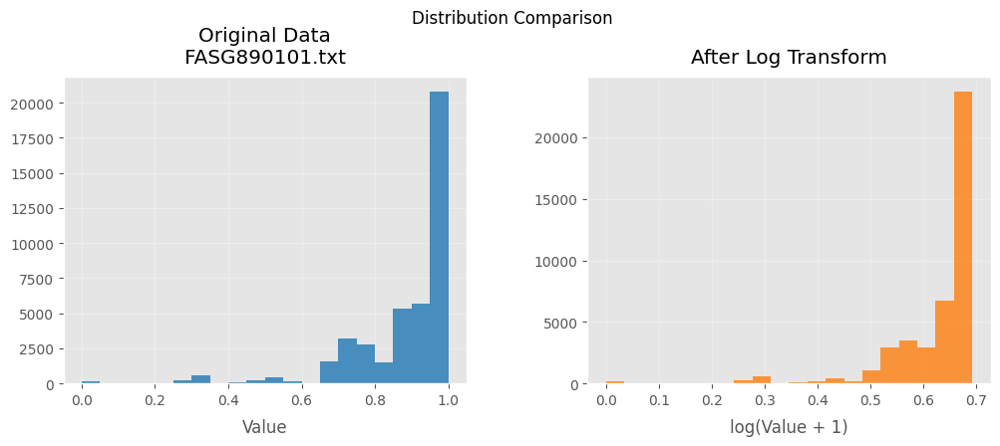

 29%|███████████████████████▋                                                           | 8/28 [00:10<00:25,  1.25s/it]

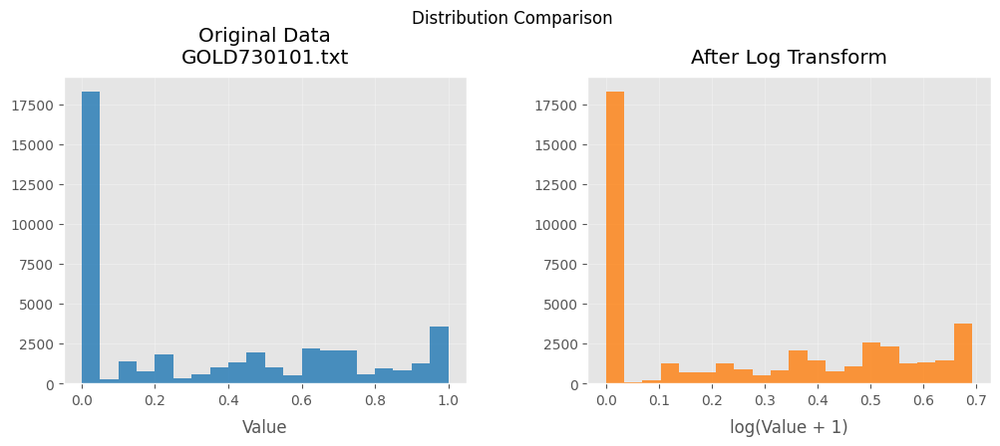

 32%|██████████████████████████▋                                                        | 9/28 [00:11<00:26,  1.41s/it]

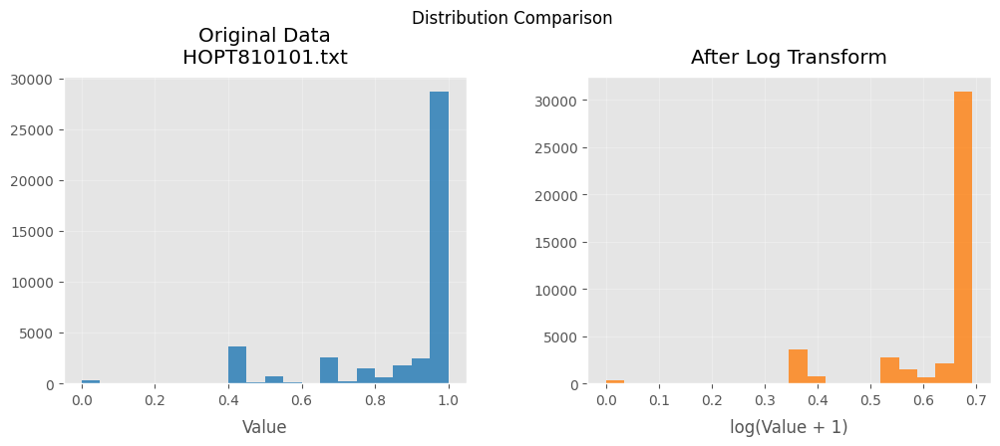

 36%|█████████████████████████████▎                                                    | 10/28 [00:12<00:24,  1.34s/it]

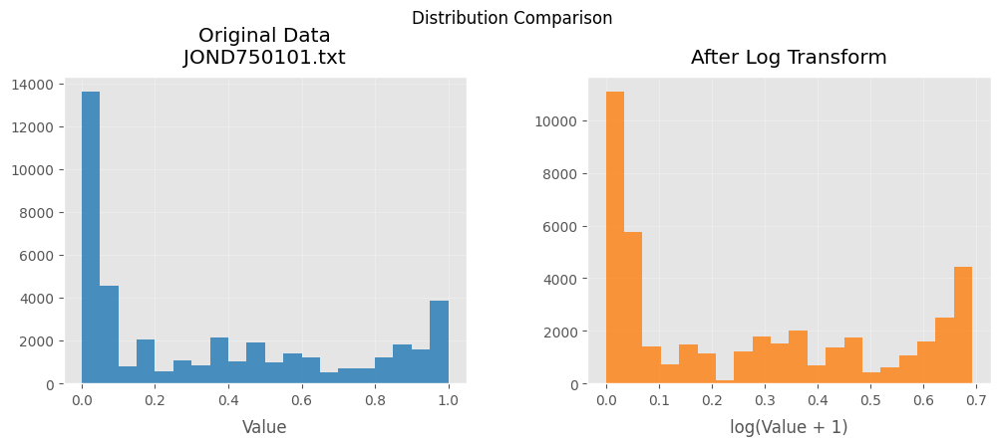

 39%|████████████████████████████████▏                                                 | 11/28 [00:14<00:21,  1.28s/it]

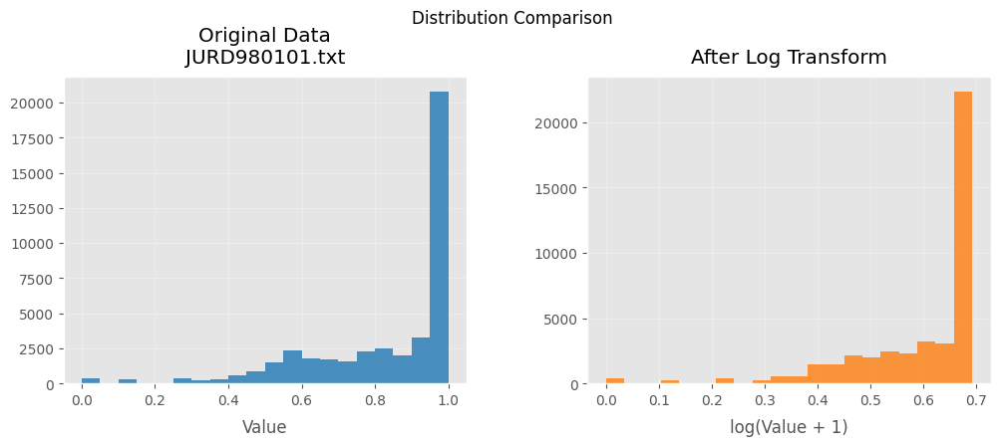

 43%|███████████████████████████████████▏                                              | 12/28 [00:15<00:19,  1.23s/it]

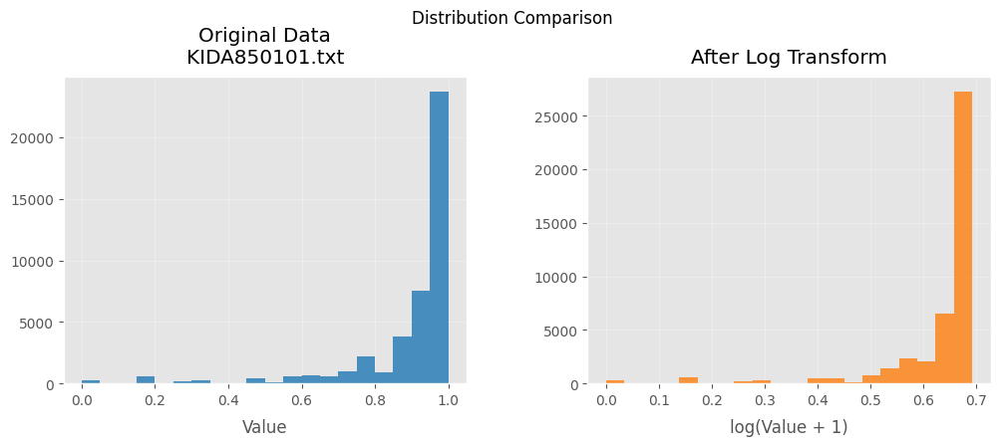

 46%|██████████████████████████████████████                                            | 13/28 [00:16<00:18,  1.22s/it]

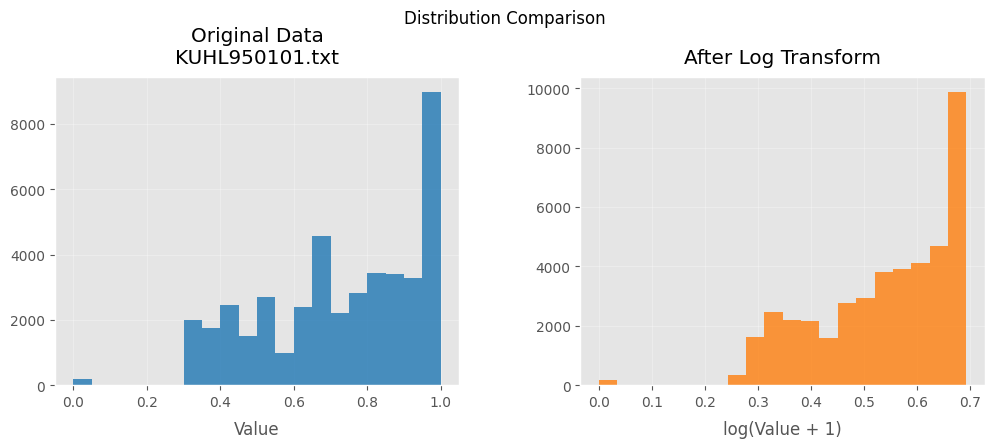

 50%|█████████████████████████████████████████                                         | 14/28 [00:17<00:16,  1.19s/it]

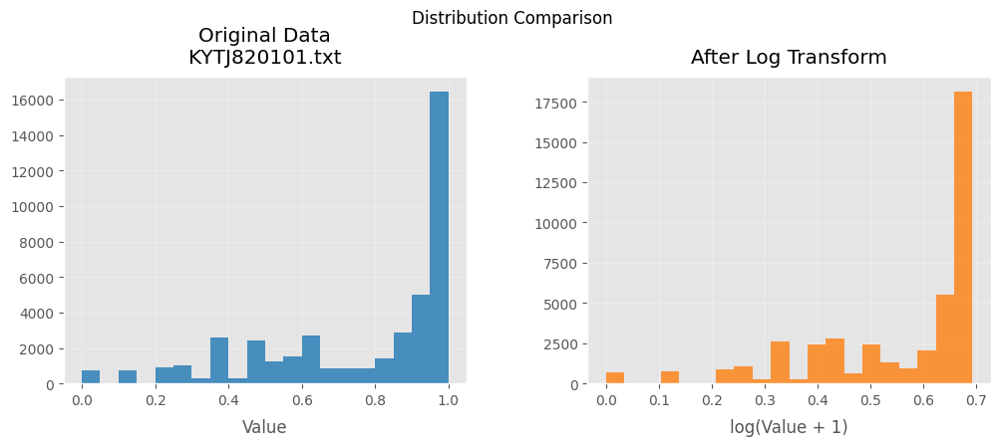

 54%|███████████████████████████████████████████▉                                      | 15/28 [00:18<00:16,  1.25s/it]

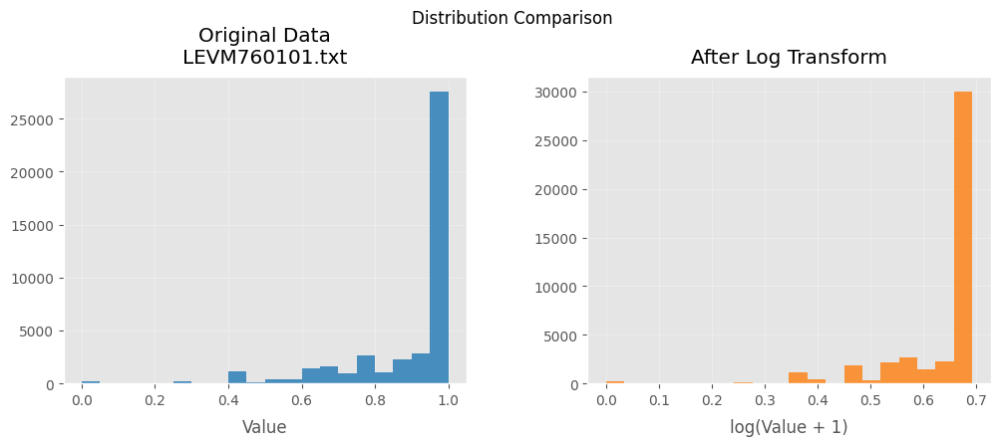

 57%|██████████████████████████████████████████████▊                                   | 16/28 [00:20<00:14,  1.25s/it]

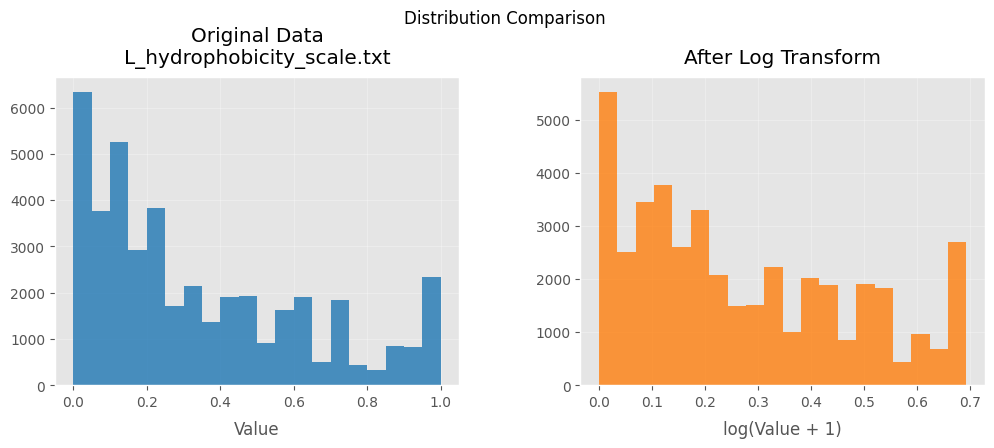

 61%|█████████████████████████████████████████████████▊                                | 17/28 [00:21<00:13,  1.26s/it]

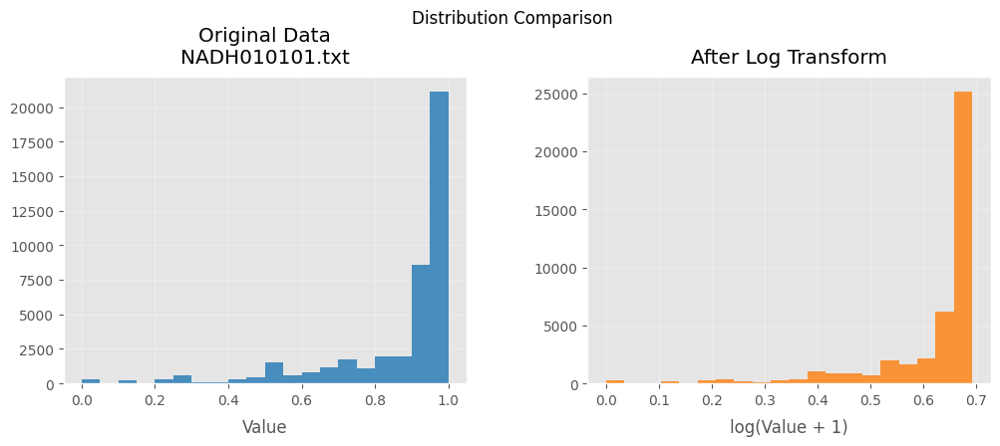

 64%|████████████████████████████████████████████████████▋                             | 18/28 [00:22<00:12,  1.26s/it]

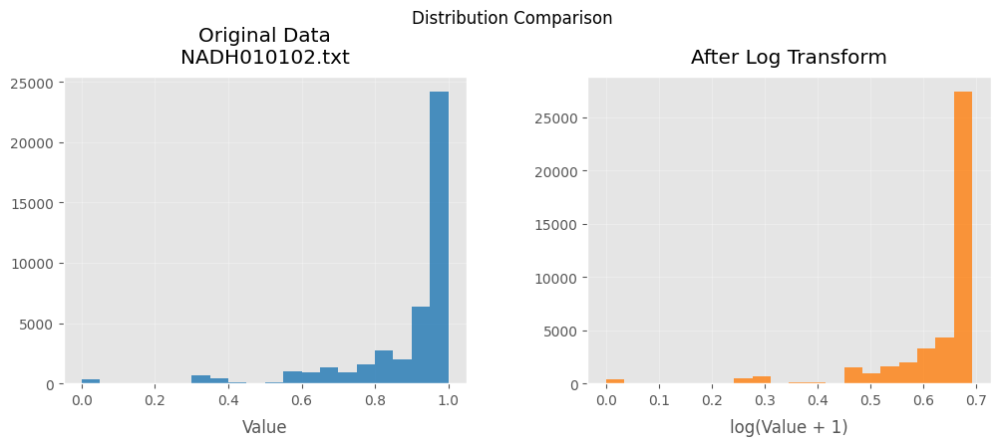

 68%|███████████████████████████████████████████████████████▋                          | 19/28 [00:24<00:12,  1.41s/it]

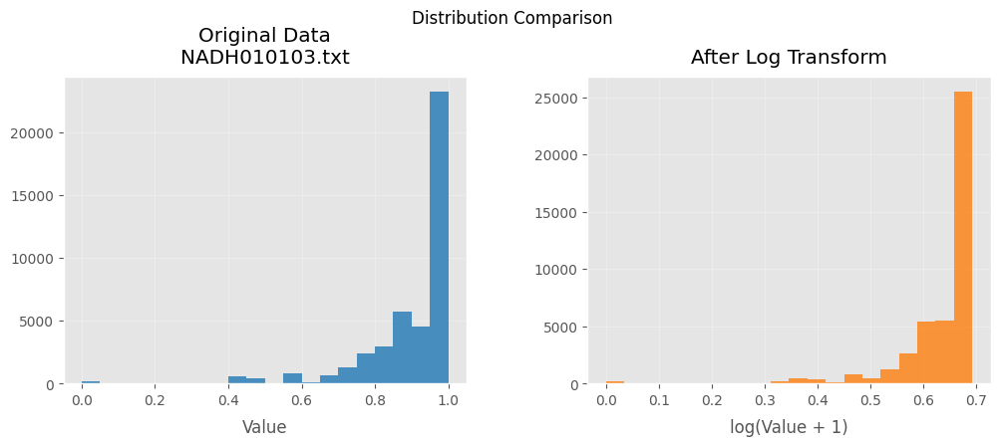

 71%|██████████████████████████████████████████████████████████▌                       | 20/28 [00:25<00:11,  1.41s/it]

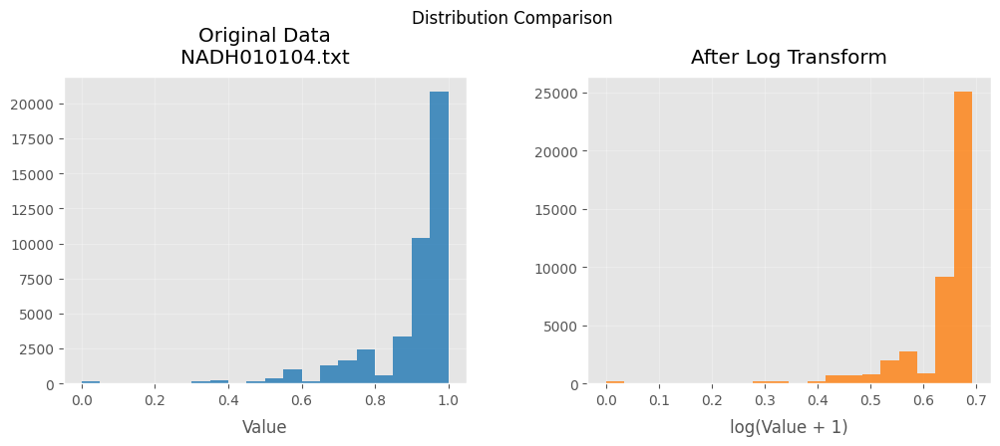

 75%|█████████████████████████████████████████████████████████████▌                    | 21/28 [00:27<00:09,  1.43s/it]

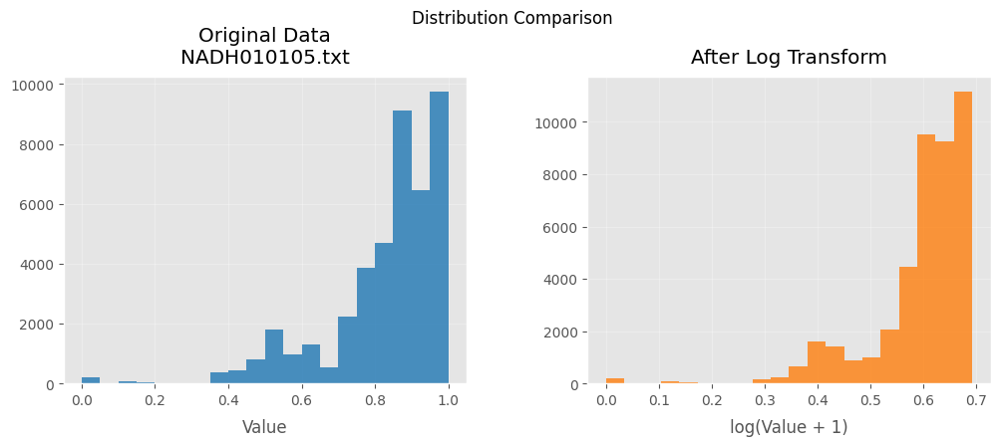

 79%|████████████████████████████████████████████████████████████████▍                 | 22/28 [00:28<00:08,  1.41s/it]

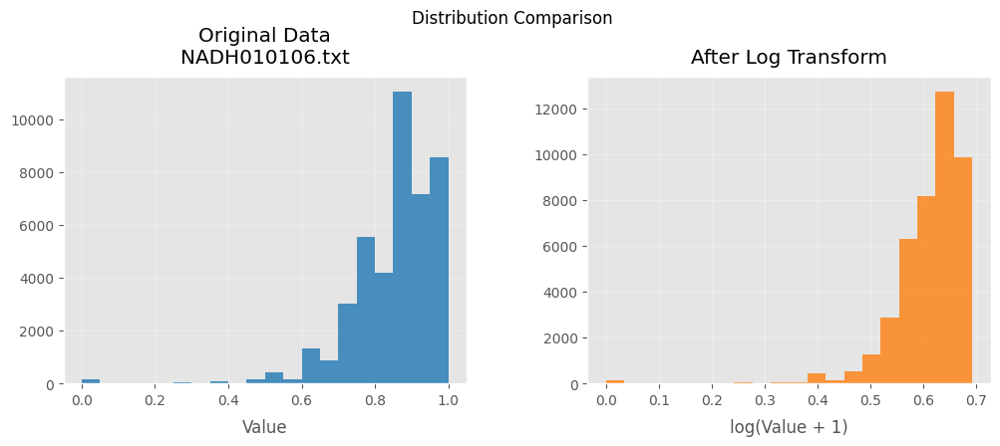

 82%|███████████████████████████████████████████████████████████████████▎              | 23/28 [00:30<00:07,  1.41s/it]

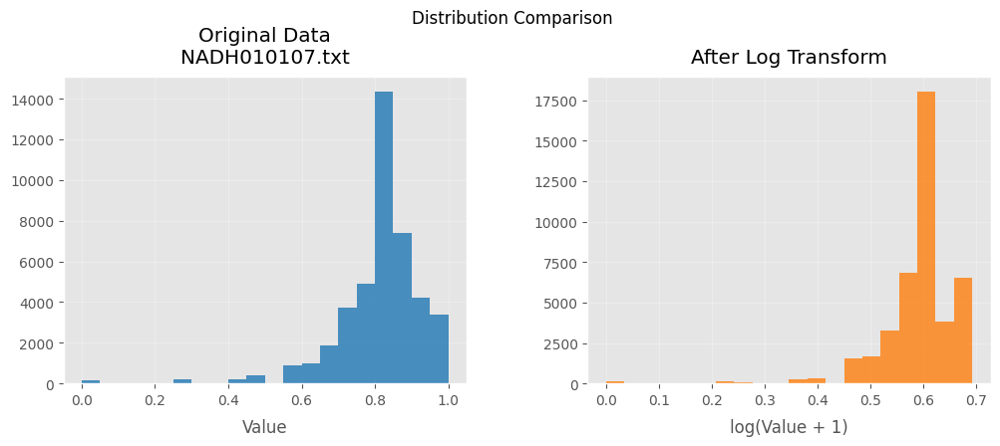

 86%|██████████████████████████████████████████████████████████████████████▎           | 24/28 [00:31<00:05,  1.41s/it]

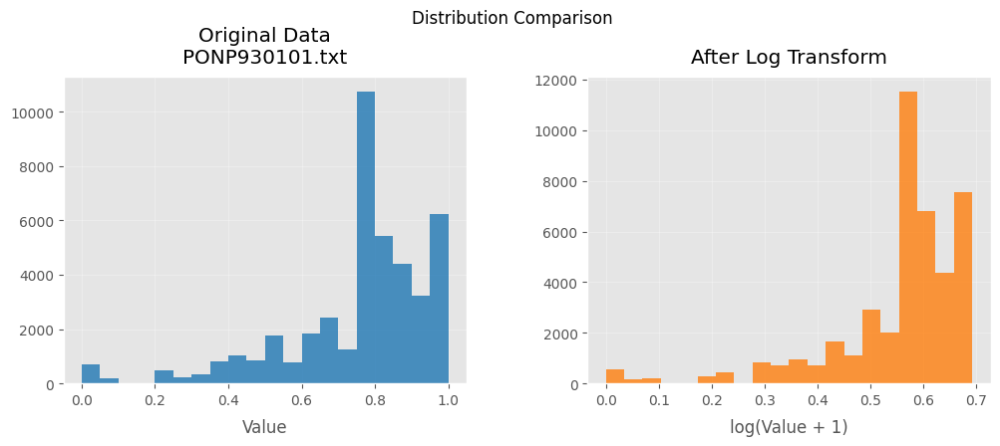

 89%|█████████████████████████████████████████████████████████████████████████▏        | 25/28 [00:32<00:04,  1.36s/it]

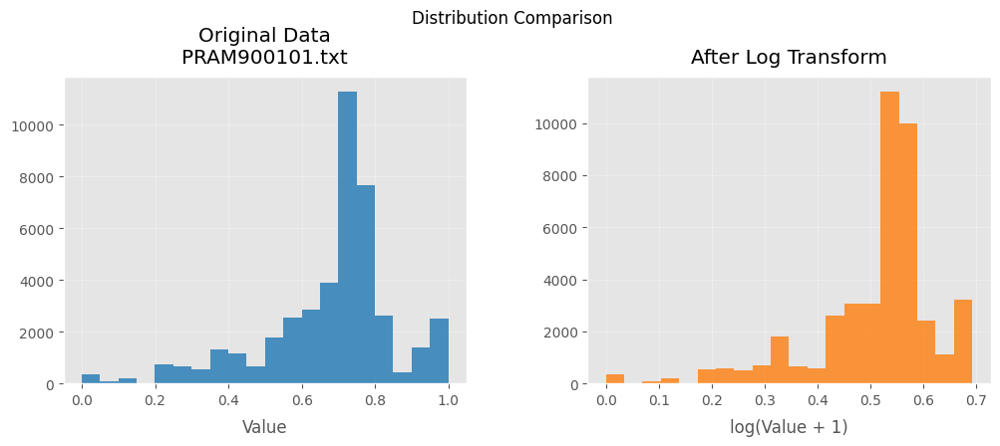

 93%|████████████████████████████████████████████████████████████████████████████▏     | 26/28 [00:33<00:02,  1.27s/it]

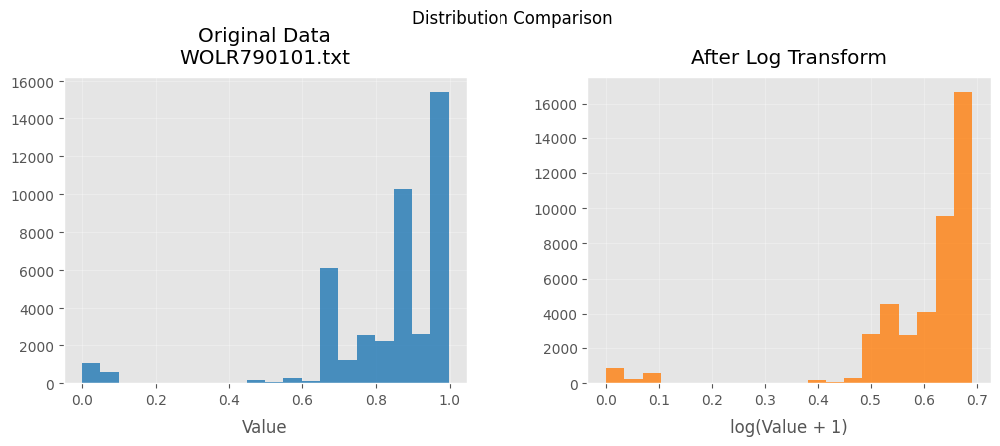

 96%|███████████████████████████████████████████████████████████████████████████████   | 27/28 [00:35<00:01,  1.26s/it]

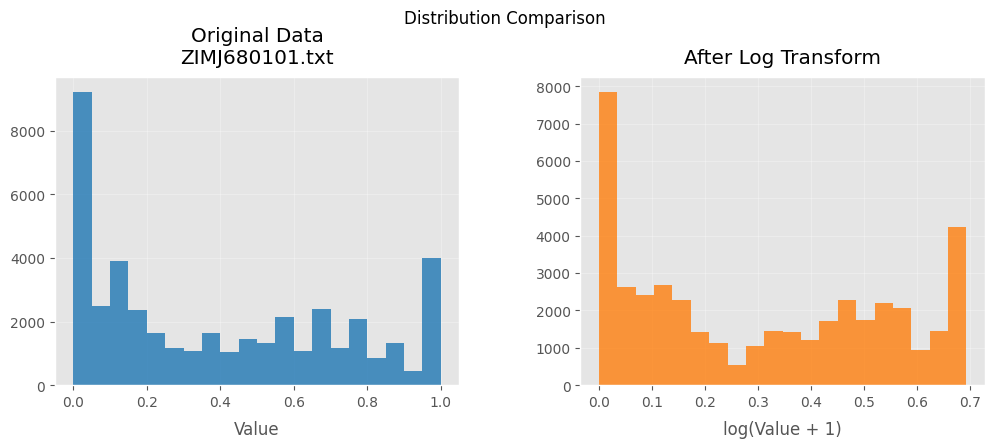

100%|██████████████████████████████████████████████████████████████████████████████████| 28/28 [00:36<00:00,  1.29s/it]


In [46]:
# Directory setup
base_dir = "../generated_data/"
train_dir = os.path.join(base_dir, "train/Hr_modified/")
test_dir = os.path.join(base_dir, "test/Hr_modified/")

def log_transform(x):
    """Simple log(x+1) transformation"""
    return np.log1p(x)

# Process files
for file_name in tqdm(os.listdir(train_dir)):
    if file_name.endswith('.txt'):
        try:
            # Load and combine data
            train_data = np.loadtxt(os.path.join(train_dir, file_name))
            test_data = np.loadtxt(os.path.join(test_dir, file_name))
            combined = np.concatenate([train_data.ravel(), test_data.ravel()])
            
            # Clean data (remove non-finite values)
            combined = combined[np.isfinite(combined)]
            
            # Apply transformation
            transformed = log_transform(combined)
            
            # Create figure
            fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4), 
                                          gridspec_kw={'wspace': 0.3})
            
            # Original data plot
            ax1.hist(combined, bins=20, color='#1f77b4', alpha=0.8)
            ax1.set_title(f'Original Data\n{file_name}', pad=10)
            ax1.set_xlabel('Value', labelpad=8)
            ax1.grid(True, alpha=0.3)
            
            # Transformed data plot
            ax2.hist(transformed, bins=20, color='#ff7f0e', alpha=0.8)
            ax2.set_title('After Log Transform', pad=10)
            ax2.set_xlabel('log(Value + 1)', labelpad=8)
            ax2.grid(True, alpha=0.3)
            
            plt.suptitle("Distribution Comparison", y=1.05)
            plt.show()
            
        except Exception as e:
            print(f"Error in {file_name}: {str(e)}")

# HR Data Power Transformation Pipeline

## Objective
Store power-transformed HR data while maintaining original train/test separation in dedicated output directories.

In [24]:
from sklearn.preprocessing import PowerTransformer
# Directory setup
base_dir = "../generated_data/"
train_hr_dir = os.path.join(base_dir, "train/Hr_modified/")
test_hr_dir = os.path.join(base_dir, "test/Hr_modified/")

# Output directories for transformed data
output_base = "../generated_data/"
train_output_dir = os.path.join(output_base, "train/Hr_modified_Power_transformation/")
test_output_dir = os.path.join(output_base, "test/Hr_modified_Power_transformation/")

# Create output directories if they don't exist
os.makedirs(train_output_dir, exist_ok=True)
os.makedirs(test_output_dir, exist_ok=True)

# Initialize transformer
transformer = PowerTransformer(method='yeo-johnson')

# First pass: Fit transformer on combined data
print("Fitting transformer on all data...")
all_data = []

# Load and collect data from both train and test sets
for dir_path in [train_hr_dir, test_hr_dir]:
    for file_name in tqdm(os.listdir(dir_path)):
        if file_name.endswith('.txt'):
            data = np.loadtxt(os.path.join(dir_path, file_name))
            
            # Replace NaN with 0 (null handling)
            data = np.nan_to_num(data, nan=0)
            
            all_data.append(data.flatten())

# Fit transformer once on all collected data
transformer.fit(np.concatenate(all_data).reshape(-1, 1))

# Second pass: Transform and save data
print("\nTransforming and saving data...")
for data_type, src_dir, output_dir in [('train', train_hr_dir, train_output_dir), ('test', test_hr_dir, test_output_dir)]:
    for file_name in tqdm(os.listdir(src_dir)):
        if file_name.endswith('.txt'):
            try:
                # Load data
                data = np.loadtxt(os.path.join(src_dir, file_name))
                
                # Handle NaNs: Replace NaN with 0
                data = np.nan_to_num(data, nan=0)
                
                # Transform only finite values, keep infinities unchanged
                finite_mask = np.isfinite(data)
                transformed_data = data.copy()  # Copy original data
                transformed_data[finite_mask] = transformer.transform(data[finite_mask].reshape(-1, 1)).flatten()
                
                # Save transformed data
                output_path = os.path.join(output_dir, f"{file_name}")
                np.savetxt(output_path, transformed_data)
                
            except Exception as e:
                print(f"Error processing {file_name}: {str(e)}")

print("\nTransformation complete!")
print(f"Transformed data saved to:\n{train_output_dir}\n{test_output_dir}")


Fitting transformer on all data...


100%|██████████████████████████████████████████████████████████████████████████████████| 28/28 [00:00<00:00, 41.80it/s]



Transforming and saving data...


100%|██████████████████████████████████████████████████████████████████████████████████| 28/28 [00:03<00:00,  8.98it/s]


Transformation complete!
Transformed data saved to:
../generated_data/train/Hr_modified_Power_transformation/
../generated_data/test/Hr_modified_Power_transformation/


Found 28 files to process


Processing files:   0%|                                                                         | 0/28 [00:00<?, ?it/s]

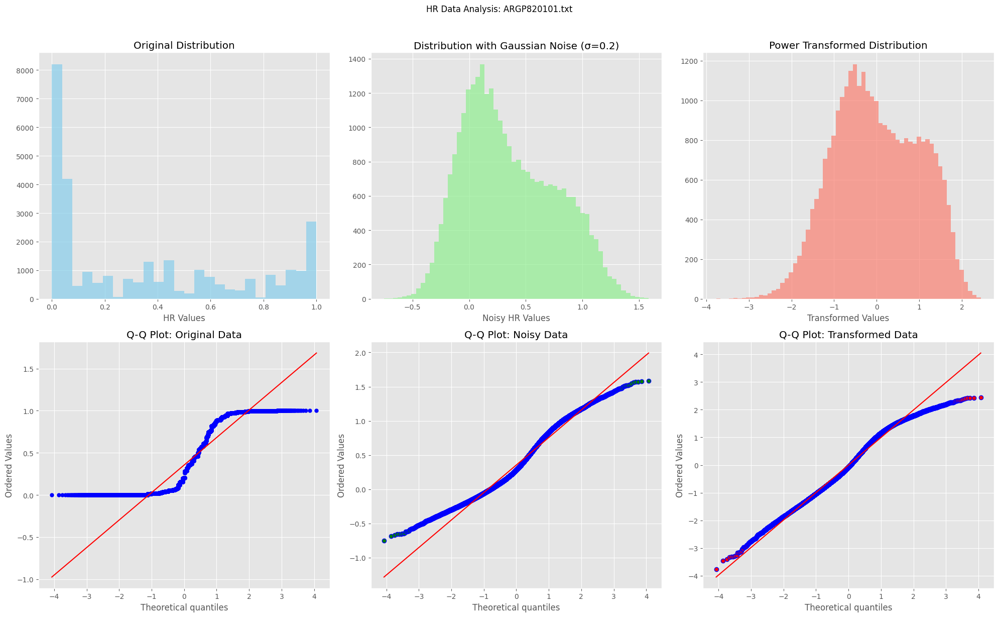

Processing files:   4%|██▎                                                              | 1/28 [00:05<02:31,  5.61s/it]

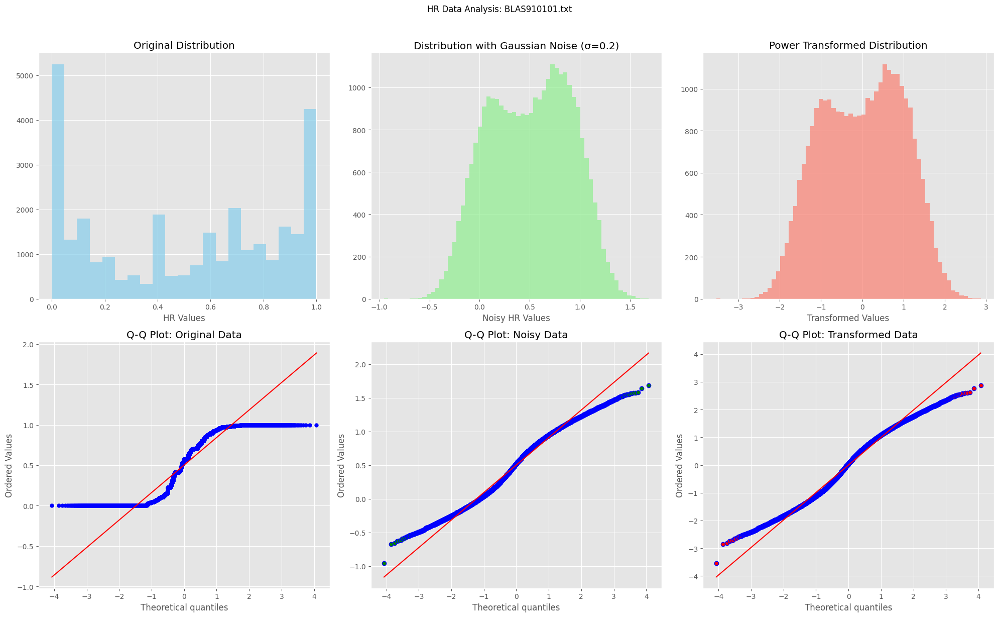

Processing files:   7%|████▋                                                            | 2/28 [00:10<02:14,  5.18s/it]

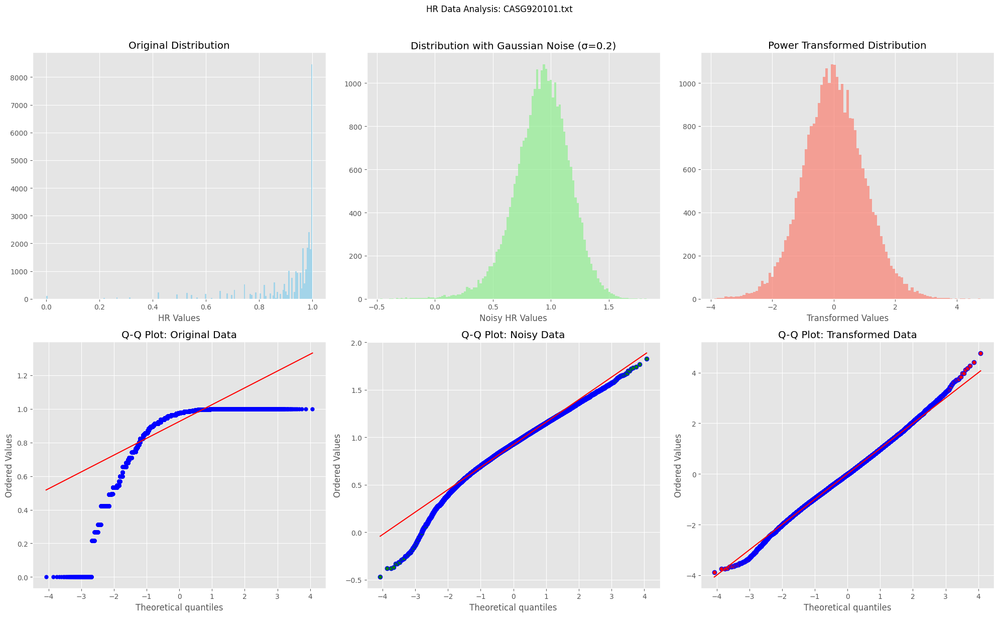

Processing files:  11%|██████▉                                                          | 3/28 [00:16<02:23,  5.72s/it]

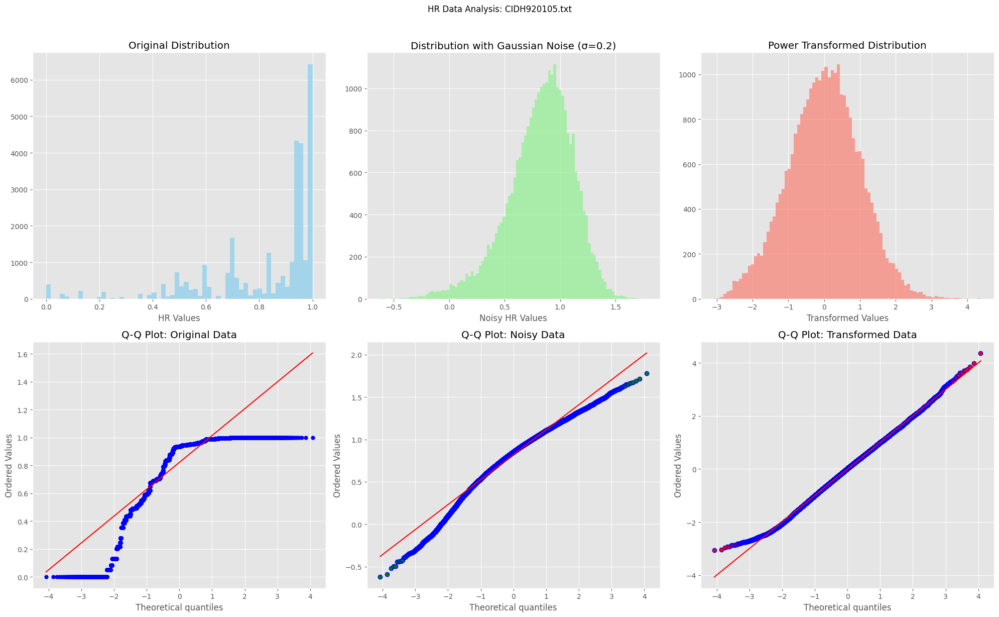

Processing files:  14%|█████████▎                                                       | 4/28 [00:23<02:22,  5.93s/it]

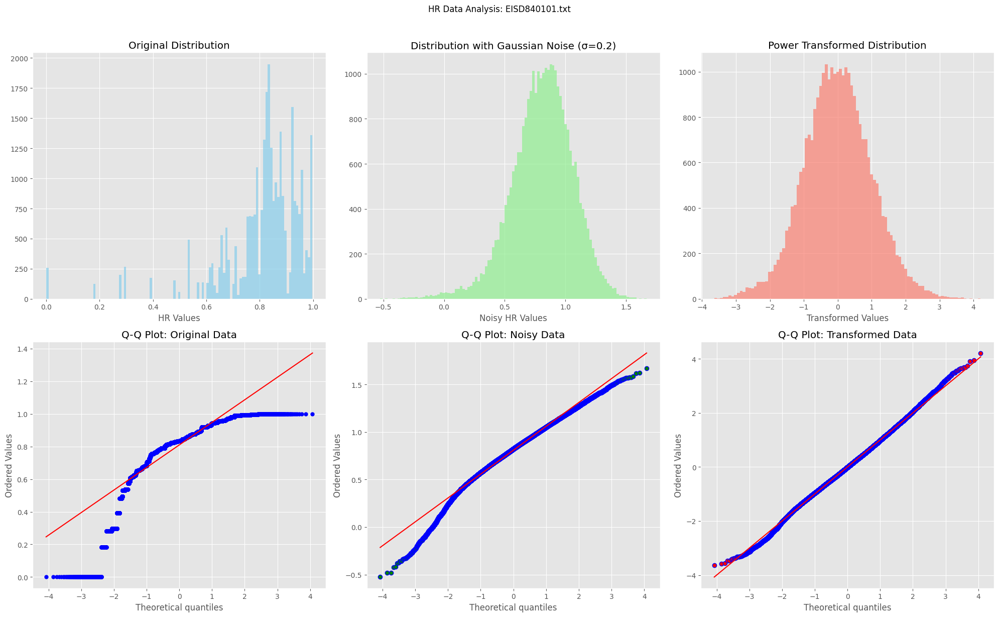

Processing files:  18%|███████████▌                                                     | 5/28 [00:29<02:23,  6.22s/it]

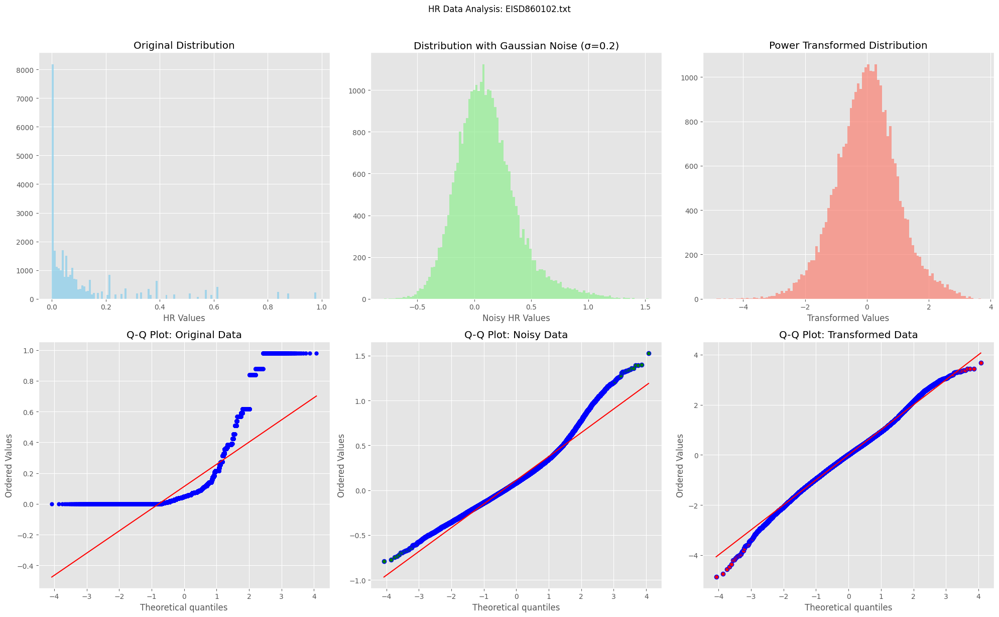

Processing files:  21%|█████████████▉                                                   | 6/28 [00:36<02:22,  6.46s/it]

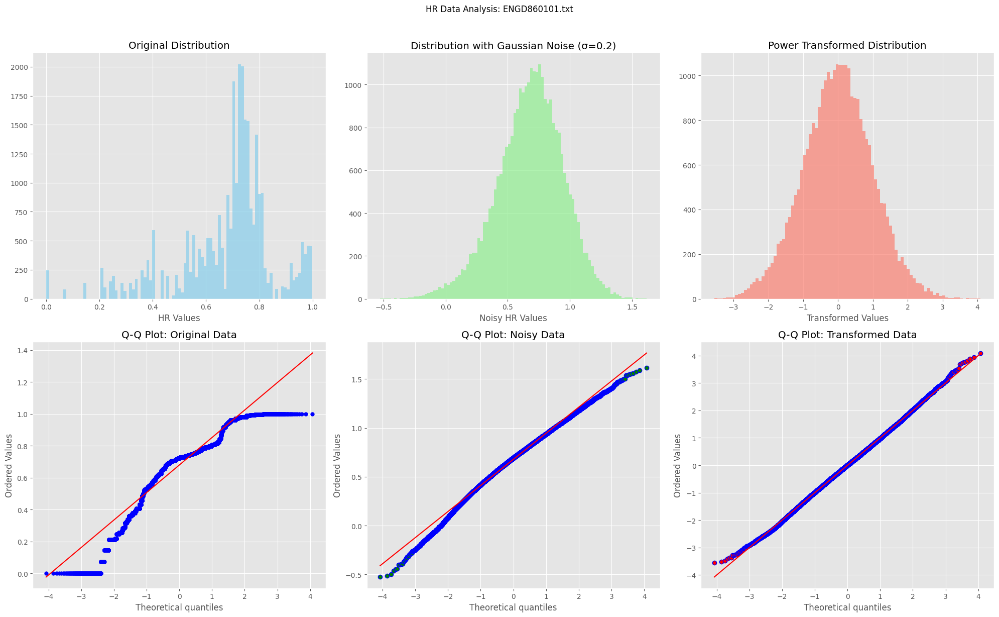

Processing files:  25%|████████████████▎                                                | 7/28 [00:42<02:09,  6.18s/it]

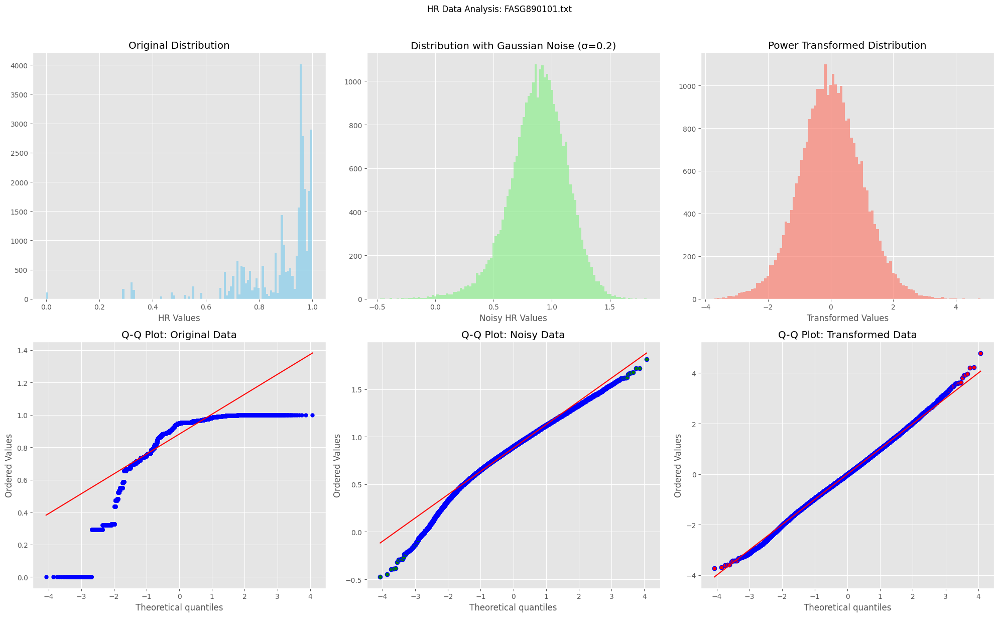

Processing files:  29%|██████████████████▌                                              | 8/28 [00:49<02:06,  6.32s/it]

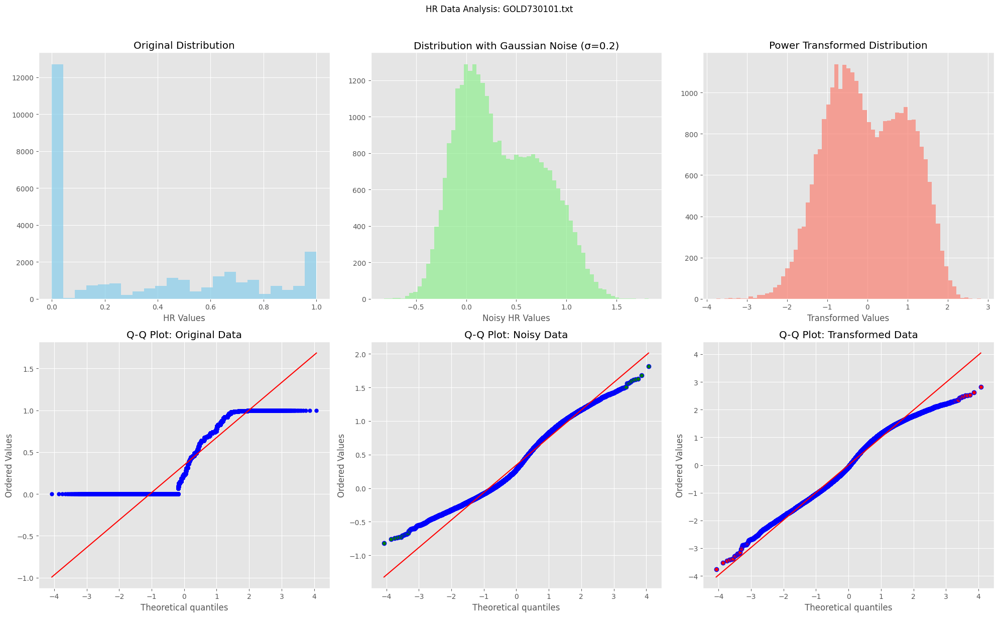

Processing files:  32%|████████████████████▉                                            | 9/28 [00:54<01:54,  6.04s/it]

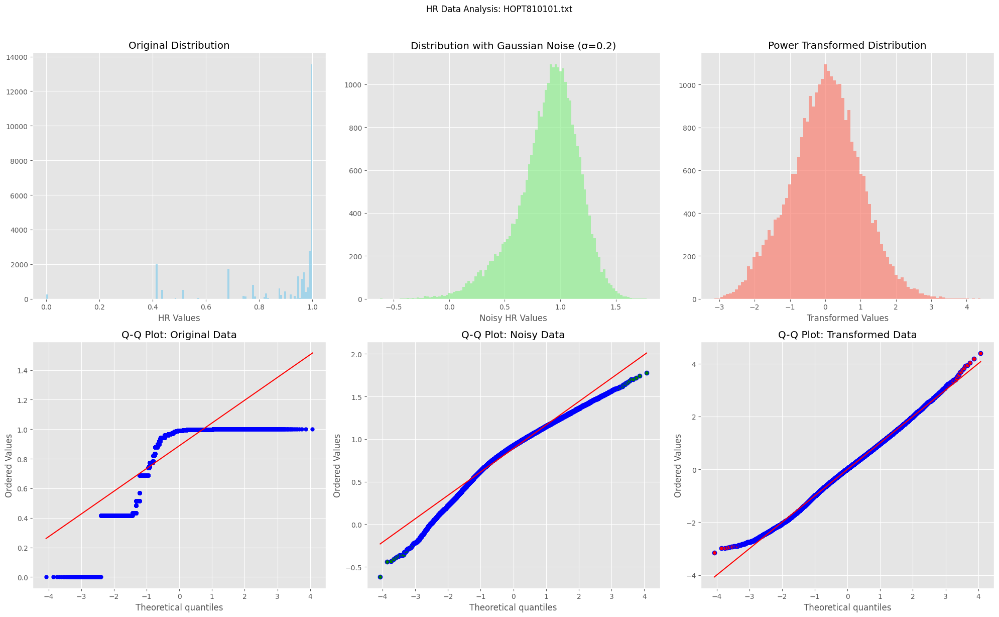

Processing files:  36%|██████████████████████▊                                         | 10/28 [01:00<01:49,  6.09s/it]

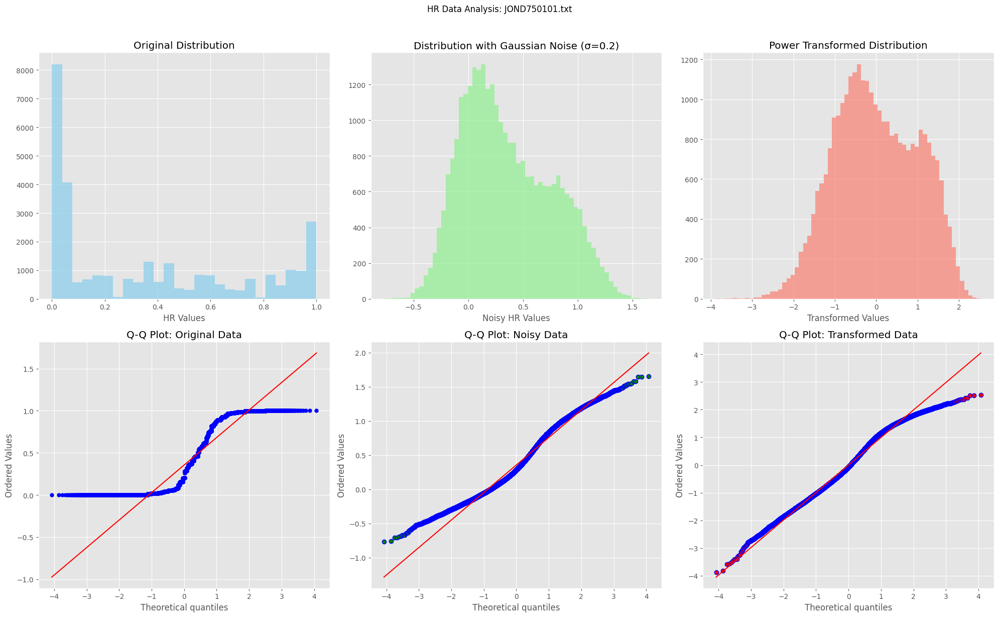

Processing files:  39%|█████████████████████████▏                                      | 11/28 [01:05<01:37,  5.75s/it]

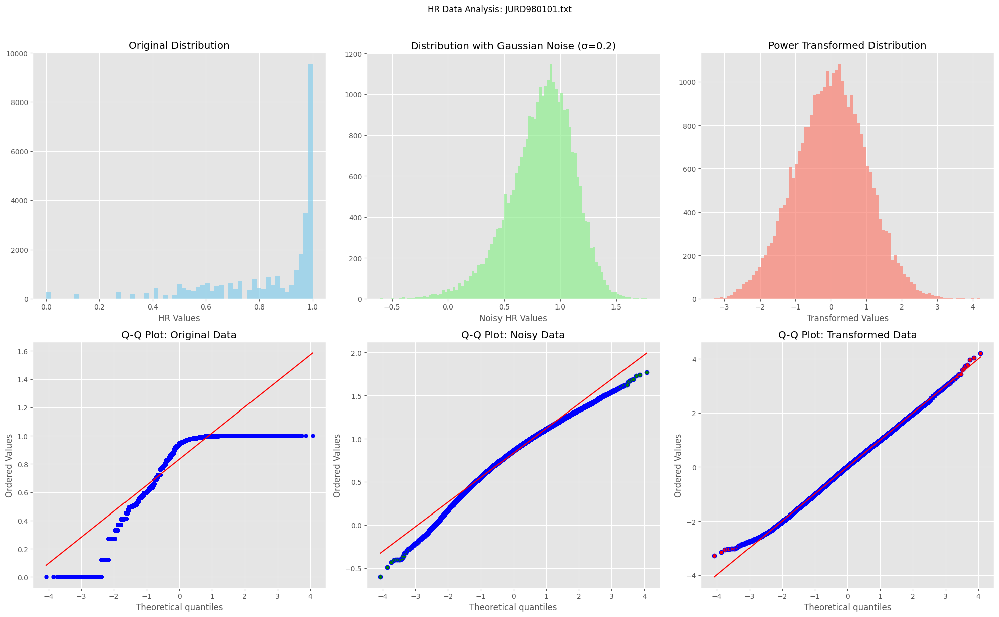

Processing files:  43%|███████████████████████████▍                                    | 12/28 [01:10<01:29,  5.61s/it]

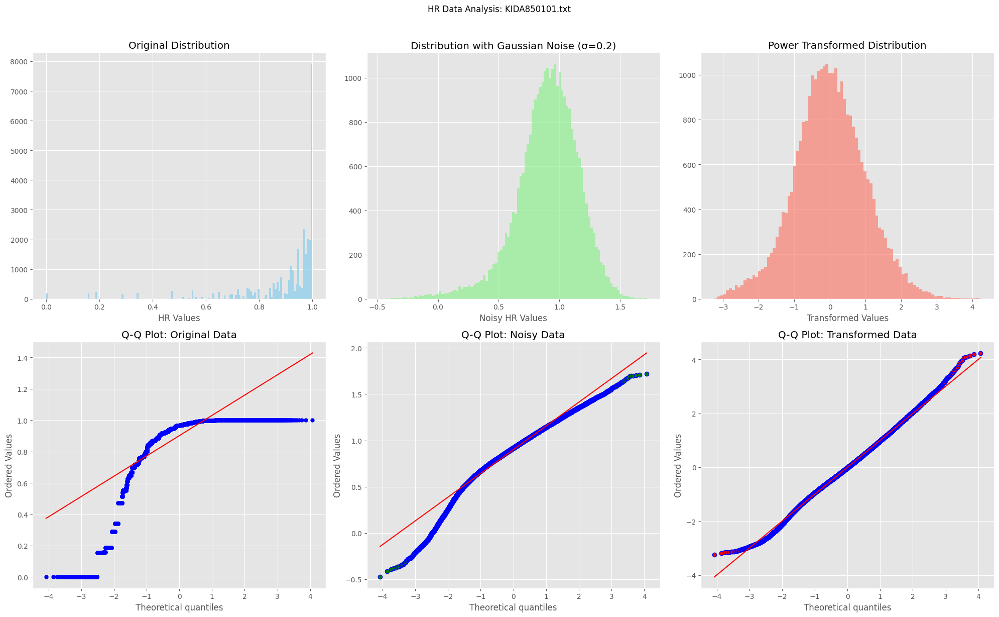

Processing files:  46%|█████████████████████████████▋                                  | 13/28 [01:16<01:23,  5.59s/it]

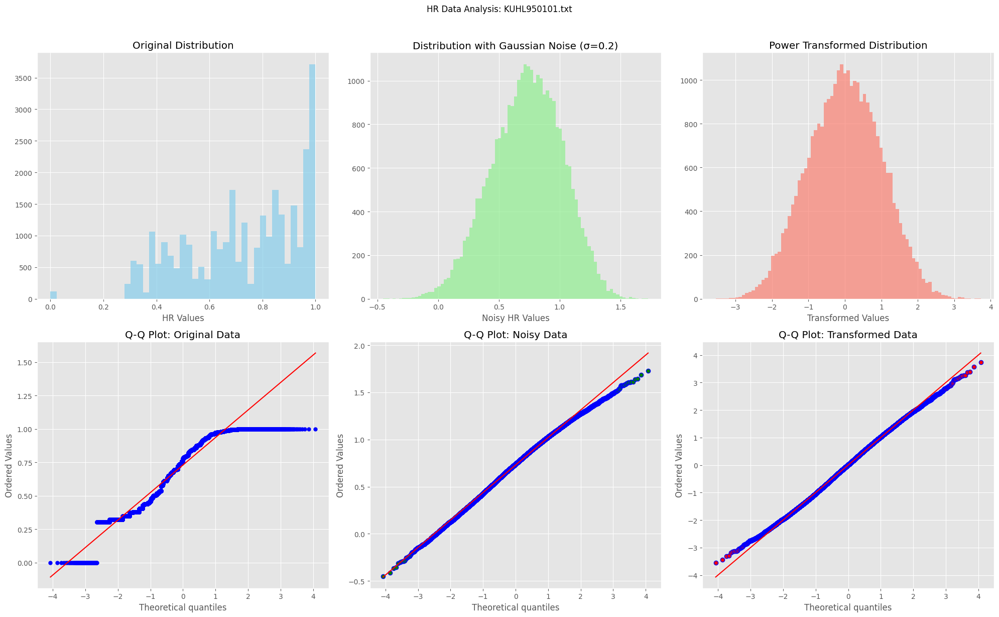

Processing files:  50%|████████████████████████████████                                | 14/28 [01:21<01:17,  5.51s/it]

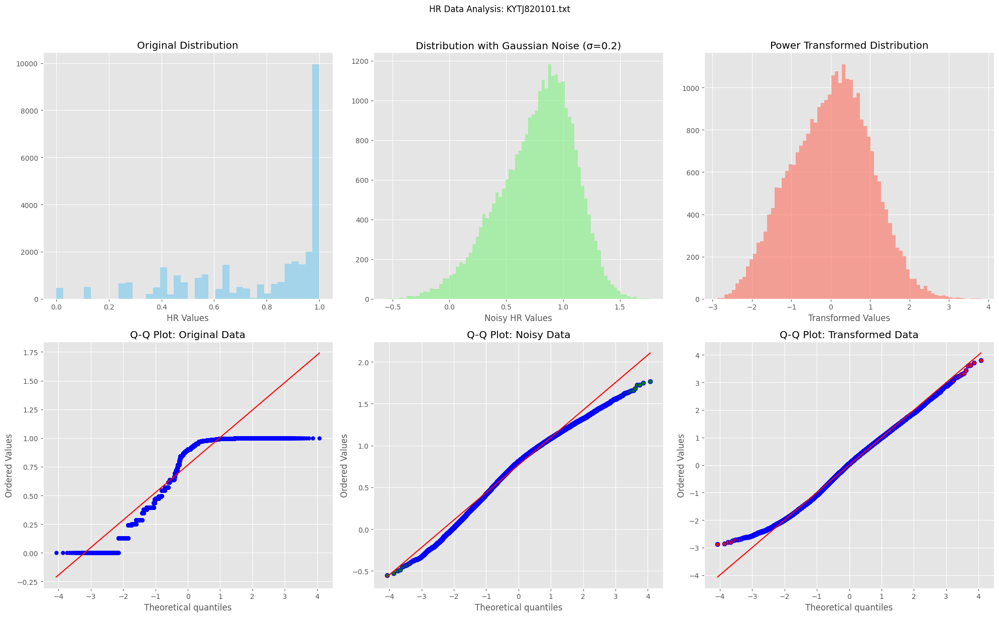

Processing files:  54%|██████████████████████████████████▎                             | 15/28 [01:26<01:09,  5.36s/it]

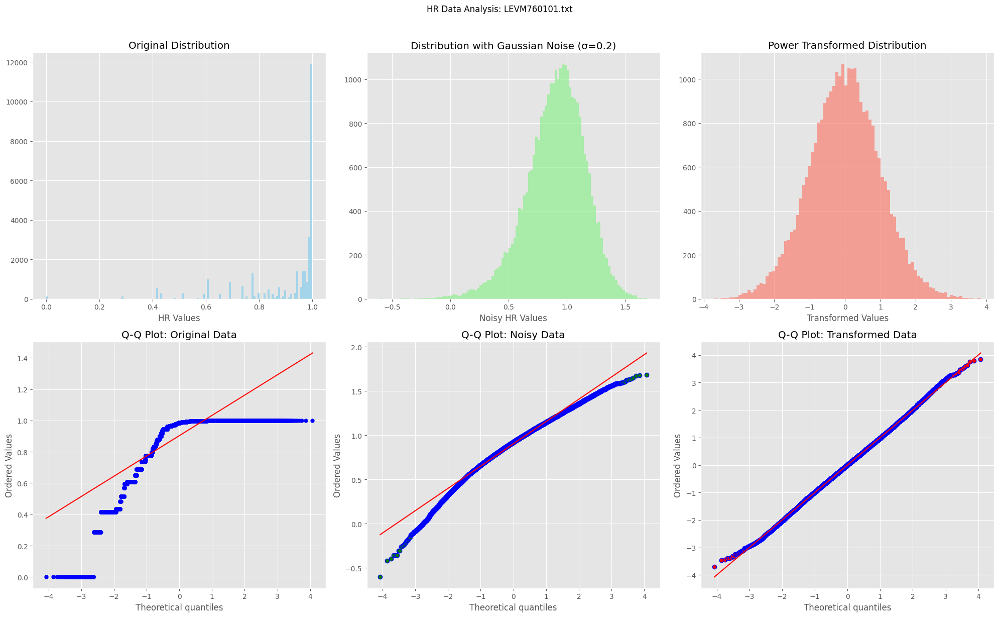

Processing files:  57%|████████████████████████████████████▌                           | 16/28 [01:32<01:05,  5.45s/it]

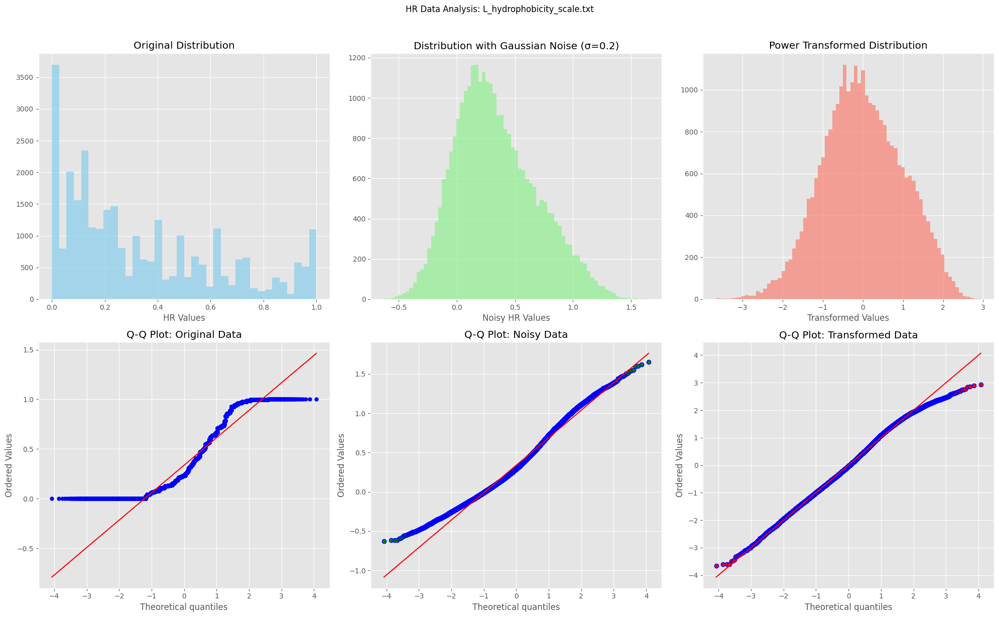

Processing files:  61%|██████████████████████████████████████▊                         | 17/28 [01:37<00:58,  5.29s/it]

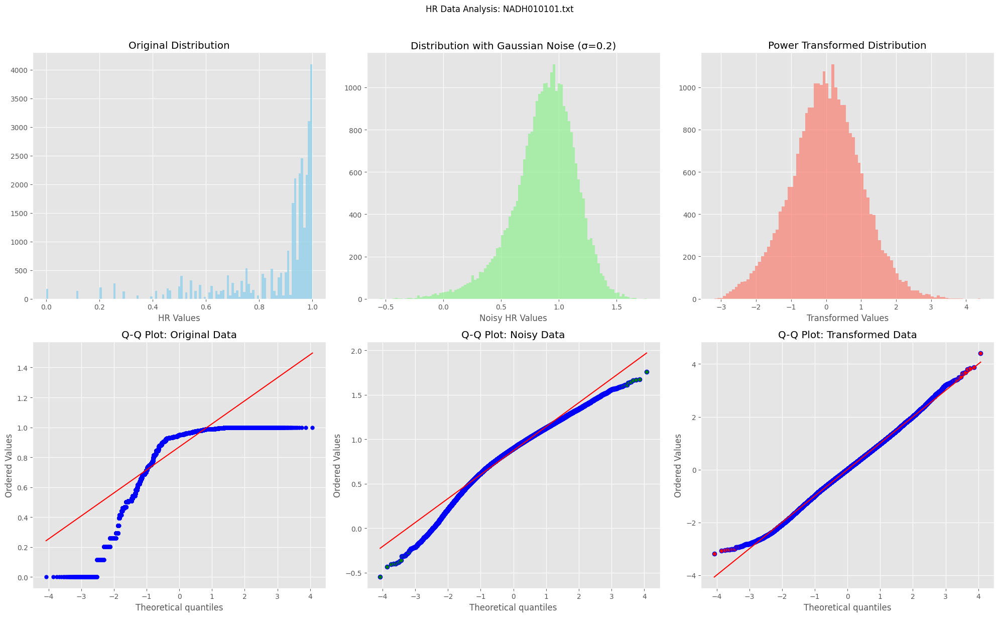

Processing files:  64%|█████████████████████████████████████████▏                      | 18/28 [01:43<00:56,  5.67s/it]

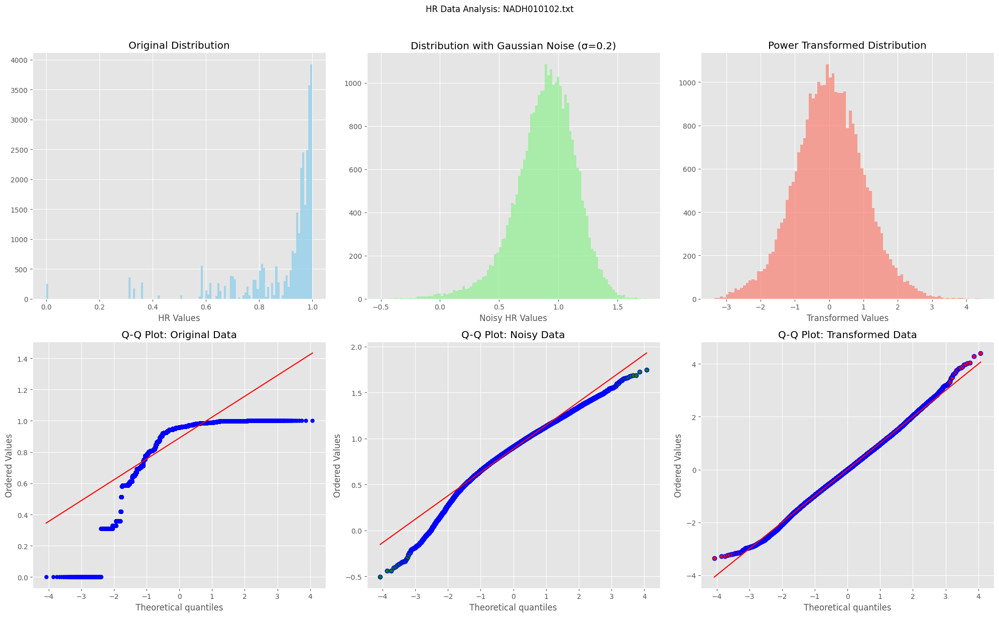

Processing files:  68%|███████████████████████████████████████████▍                    | 19/28 [01:49<00:51,  5.71s/it]

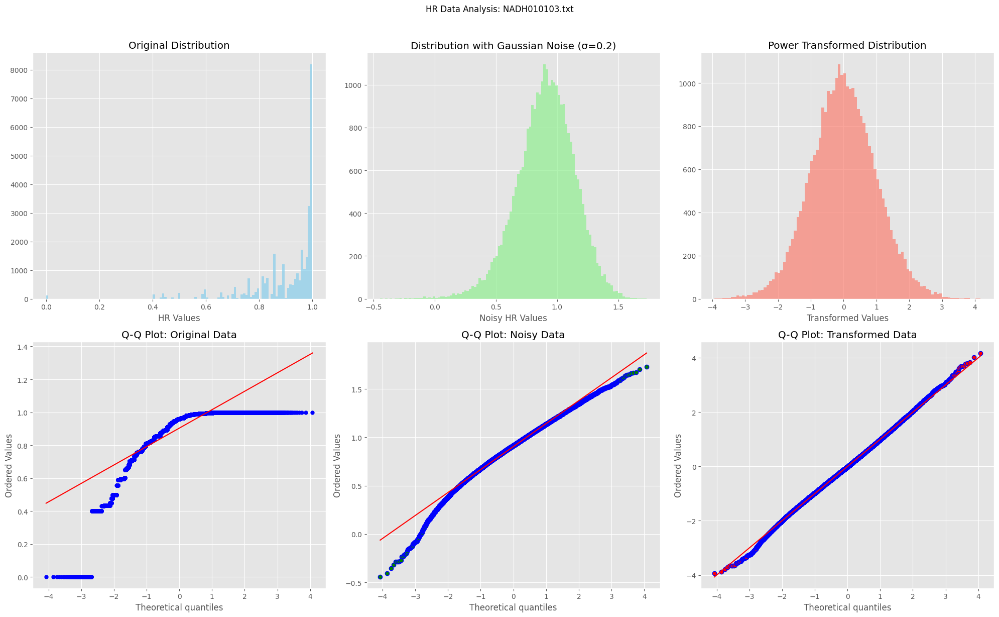

Processing files:  71%|█████████████████████████████████████████████▋                  | 20/28 [01:56<00:47,  6.00s/it]

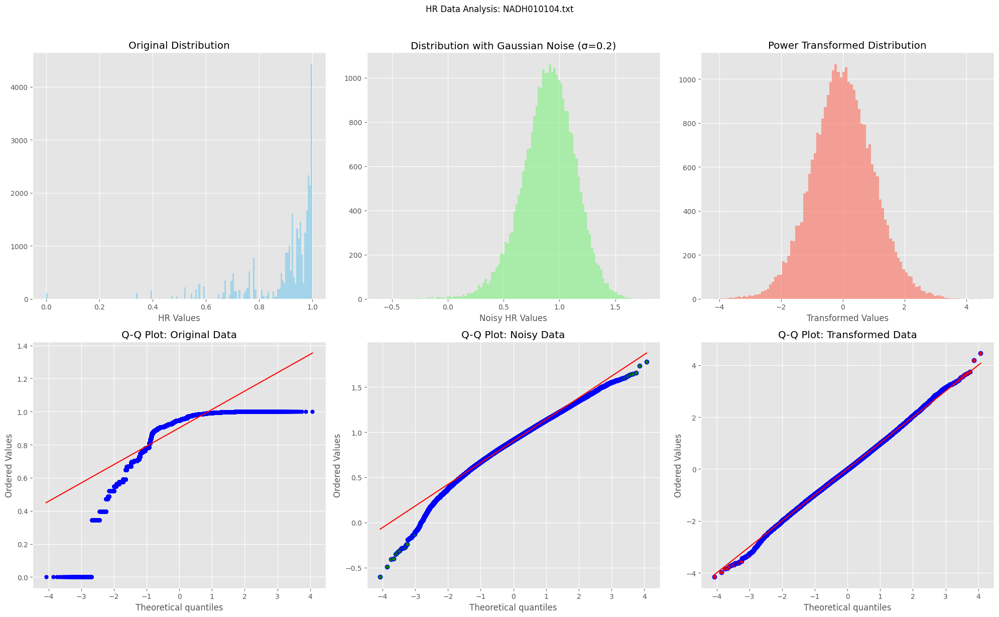

Processing files:  75%|████████████████████████████████████████████████                | 21/28 [02:03<00:43,  6.23s/it]

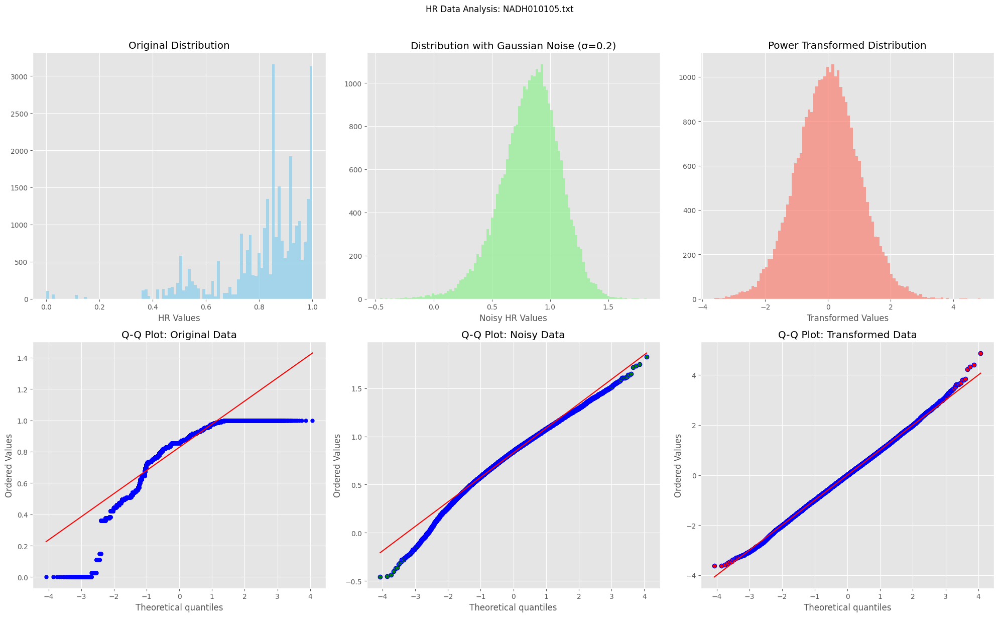

Processing files:  79%|██████████████████████████████████████████████████▎             | 22/28 [02:09<00:37,  6.19s/it]

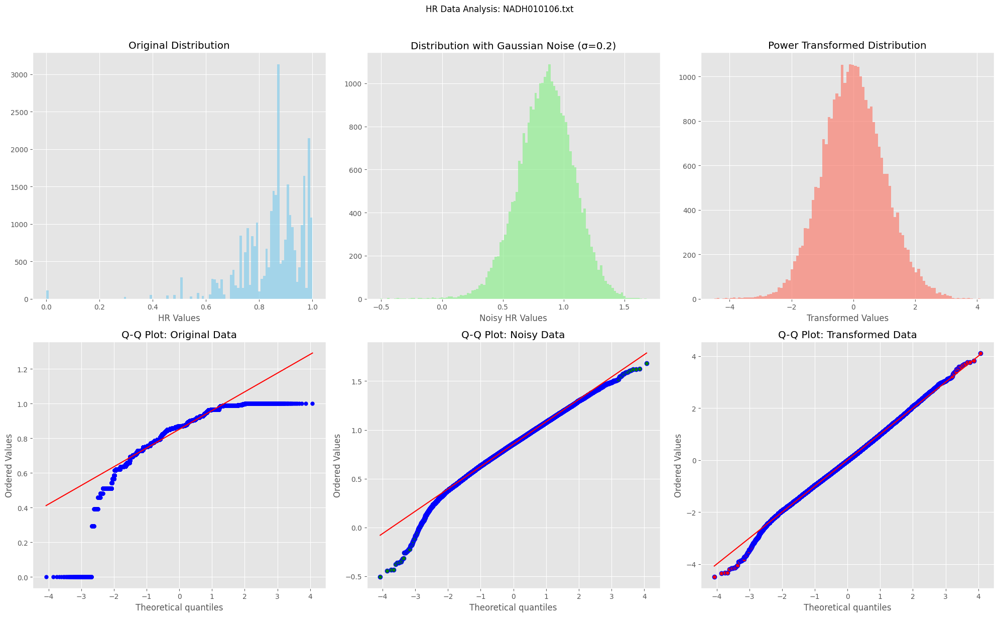

Processing files:  82%|████████████████████████████████████████████████████▌           | 23/28 [02:14<00:30,  6.01s/it]

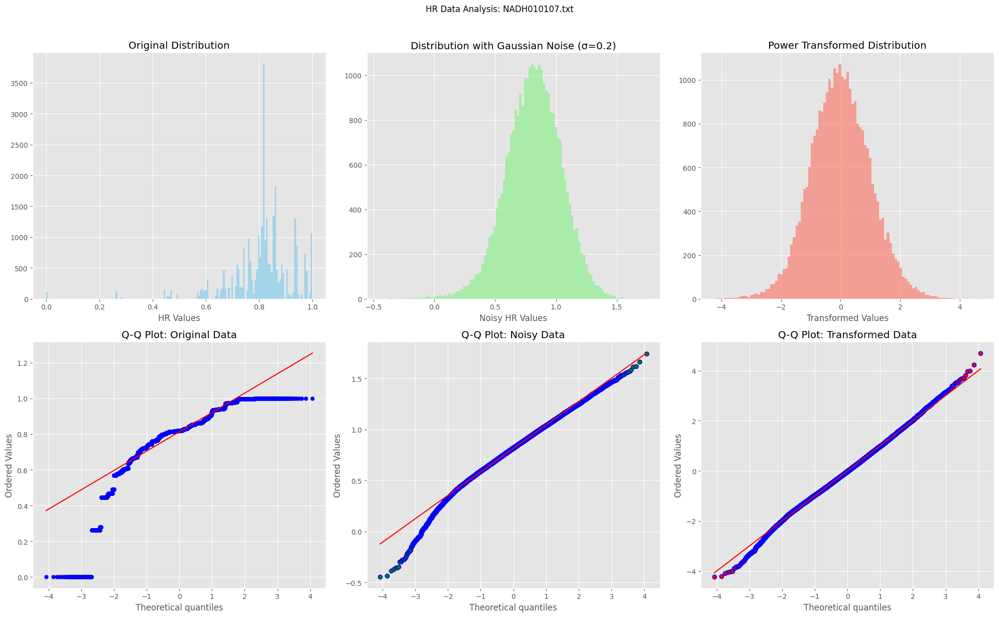

Processing files:  86%|██████████████████████████████████████████████████████▊         | 24/28 [02:20<00:23,  5.96s/it]

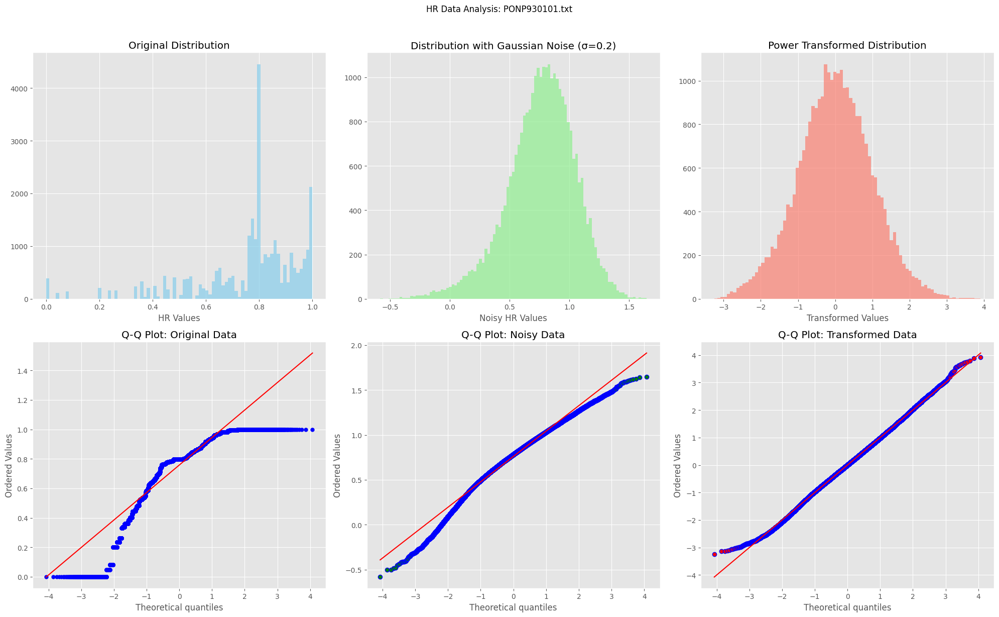

Processing files:  89%|█████████████████████████████████████████████████████████▏      | 25/28 [02:26<00:17,  5.91s/it]

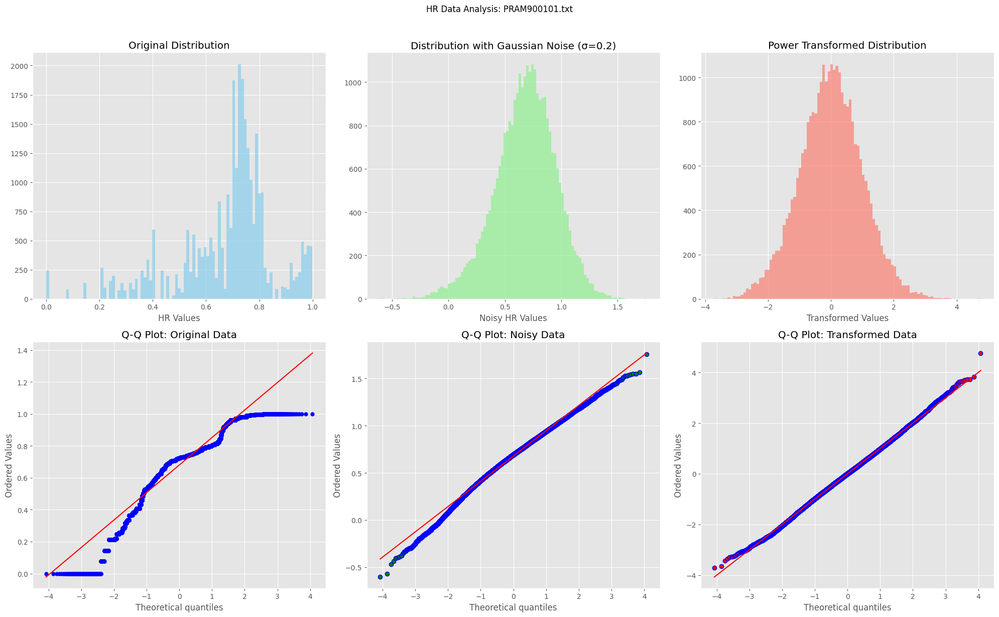

Processing files:  93%|███████████████████████████████████████████████████████████▍    | 26/28 [02:31<00:11,  5.72s/it]

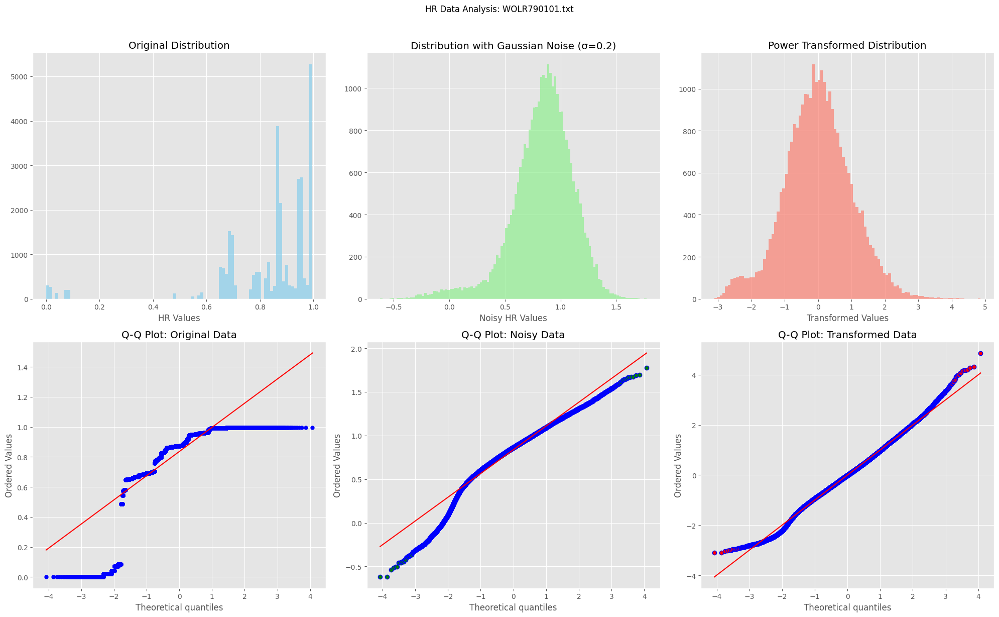

Processing files:  96%|█████████████████████████████████████████████████████████████▋  | 27/28 [02:37<00:05,  5.73s/it]

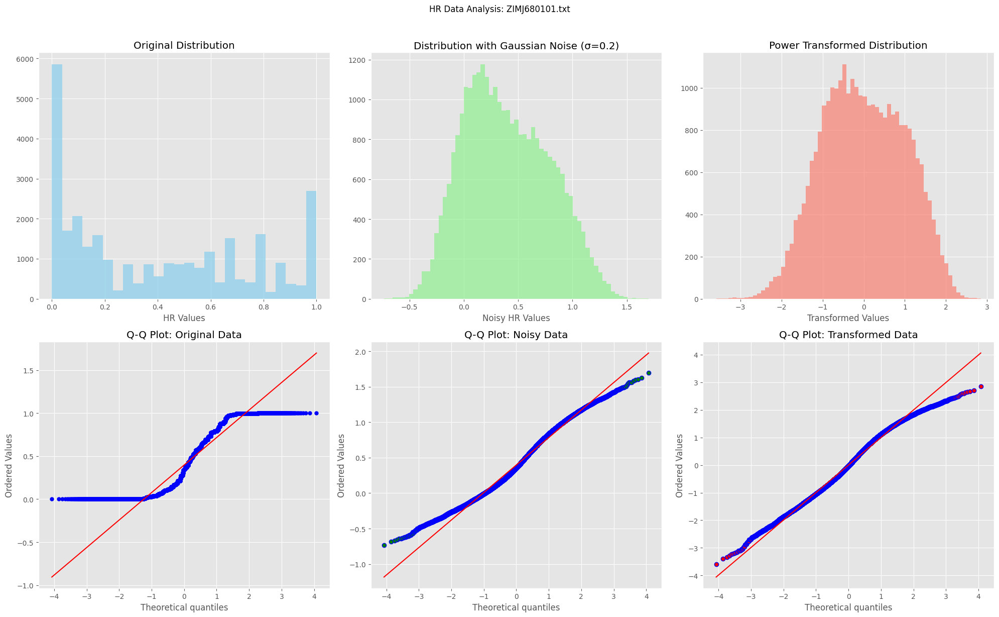

Processing files: 100%|████████████████████████████████████████████████████████████████| 28/28 [02:42<00:00,  5.79s/it]


Analysis complete!


In [1]:
# Directory setup
base_dir = "../generated_data/"
train_hr_dir = os.path.join(base_dir, "train/Hr_modified/") 

# Get all files
def get_file_list(directory):
    return [f for f in os.listdir(directory) if f.endswith('.txt')]

train_files = get_file_list(train_hr_dir)

if not train_files:
    print("No training files found!")
    exit()

print(f"Found {len(train_files)} files to process")

plt.style.use('ggplot')
plt.rcParams['figure.figsize'] = [16, 8]

for file_name in tqdm(sorted(train_files), desc="Processing files"):
    try:
        # Load training data
        train_hr = np.loadtxt(os.path.join(train_hr_dir, file_name))
        original_data = train_hr.ravel()
        
        # Add Gaussian noise
        noisy_data = original_data + np.random.normal(0, 0.2, original_data.shape)
        # Clip the noisy data to maintain the range between 0 and 1
        #noisy_data = np.clip(noisy_data, 0, 1)
        
        # Power transformation
        transformer = PowerTransformer(method='yeo-johnson')
        transformed_data = transformer.fit_transform(noisy_data.reshape(-1, 1)).flatten()
        
        # Create figure
        fig, ((ax1, ax2, ax3), (ax4, ax5, ax6)) = plt.subplots(2, 3, figsize=(20, 12))
        fig.suptitle(f'HR Data Analysis: {file_name}', y=1.02)
        
        # Original histogram
        ax1.hist(original_data, bins='auto', color='skyblue', alpha=0.7)
        ax1.set_title('Original Distribution')
        ax1.set_xlabel('HR Values')
        
        # Noisy histogram
        ax2.hist(noisy_data, bins='auto', color='lightgreen', alpha=0.7)
        ax2.set_title('Distribution with Gaussian Noise (σ=0.2)')
        ax2.set_xlabel('Noisy HR Values')
        
        # Transformed histogram
        ax3.hist(transformed_data, bins='auto', color='salmon', alpha=0.7)
        ax3.set_title('Power Transformed Distribution')
        ax3.set_xlabel('Transformed Values')
        
        # Original Q-Q plot
        stats.probplot(original_data, dist="norm", plot=ax4)
        ax4.set_title('Q-Q Plot: Original Data')
        ax4.get_lines()[0].set_markerfacecolor('blue')
        ax4.get_lines()[0].set_markersize(5.0)
        
        # Noisy Q-Q plot
        stats.probplot(noisy_data, dist="norm", plot=ax5)
        ax5.set_title('Q-Q Plot: Noisy Data')
        ax5.get_lines()[0].set_markerfacecolor('green')
        
        # Transformed Q-Q plot
        stats.probplot(transformed_data, dist="norm", plot=ax6)
        ax6.set_title('Q-Q Plot: Transformed Data')
        ax6.get_lines()[0].set_markerfacecolor('red')
        
        plt.tight_layout()
        plt.show()
        
    except Exception as e:
        print(f"\nError processing {file_name}: {str(e)}")
        continue

print("\nAnalysis complete!")


In [16]:
original_data.shape, noisy_data.shape

((29900,), (29900,))

In [5]:
# === Configuration ===
BASE_DIR = "../generated_data/"
HANDLE_LENGTH_MISMATCH = "pad"  # Choose "pad", "truncate", or "error"

# === Path Setup ===
train_input_dir = os.path.join(BASE_DIR, "train/Hr_modified/")
test_input_dir = os.path.join(BASE_DIR, "test/Hr_modified/")

train_output_dir = os.path.join(BASE_DIR, "train/Hr_modified_gaussian_Power_transformed/")
test_output_dir = os.path.join(BASE_DIR, "test/Hr_modified_gaussian_Power_transformed/")

os.makedirs(train_output_dir, exist_ok=True)
os.makedirs(test_output_dir, exist_ok=True)

def validate_and_load_files(directory):
    """Load files with consistent length validation"""
    file_list = sorted([f for f in os.listdir(directory) if f.endswith('.txt')])
    if not file_list:
        raise ValueError(f"No files found in {directory}")
    
    # Load files with length validation
    data = []
    lengths = []
    for file_name in tqdm(file_list, desc=f"Loading {os.path.basename(directory)}"):
        try:
            arr = np.loadtxt(os.path.join(directory, file_name)).ravel()
            data.append(arr)
            lengths.append(len(arr))
        except Exception as e:
            print(f"Error loading {file_name}: {e}")
            continue
    
    # Check length consistency
    if len(set(lengths)) != 1:
        print(f"⚠️ Warning: Varying lengths in {directory} - {min(lengths)} to {max(lengths)}")
        return None, lengths, file_list
    return data[0].shape[0], data, file_list

# === Load and Validate Data ===
# Training Data
train_feat_count, train_data, train_files = validate_and_load_files(train_input_dir)
if train_feat_count is None:
    print("❌ Training data has inconsistent lengths")
    exit()

# Test Data
test_feat_count, test_data, test_files = validate_and_load_files(test_input_dir)
if test_feat_count is None:
    print("❌ Test data has inconsistent lengths")
    exit()

# === Handle Train-Test Length Mismatch ===
if train_feat_count != test_feat_count:
    print(f"🚨 Feature mismatch: Train({train_feat_count}) vs Test({test_feat_count})")
    
    if HANDLE_LENGTH_MISMATCH == "pad":
        target_length = max(train_feat_count, test_feat_count)
        print(f"Padding to {target_length} features")
        train_data = [np.pad(arr, (0, target_length - len(arr))) for arr in train_data]
        test_data = [np.pad(arr, (0, target_length - len(arr))) for arr in test_data]
    elif HANDLE_LENGTH_MISMATCH == "truncate":
        target_length = min(train_feat_count, test_feat_count)
        print(f"Truncating to {target_length} features")
        train_data = [arr[:target_length] for arr in train_data]
        test_data = [arr[:target_length] for arr in test_data]
    else:
        print("❌ Mismatch handling set to 'error'")
        exit()

# === Final Validation ===
final_train_length = len(train_data[0])
final_test_length = len(test_data[0])
assert final_train_length == final_test_length, "Final length mismatch"
print(f"✅ Final feature count: {final_train_length}")

# === Processing Functions ===
def add_deterministic_noise(data, seed):
    rng = np.random.default_rng(seed)
    return data + rng.normal(scale=0.1, size=data.shape)

def process_dataset(data, files, output_dir, transformer=None):
    """Process and save dataset"""
    # Add noise
    noisy_data = [add_deterministic_noise(arr, idx) for idx, arr in enumerate(data)]
    
    # Transform
    arr = np.array(noisy_data)
    if transformer is None:  # Training mode
        transformer = PowerTransformer(method='yeo-johnson')
        transformed = transformer.fit_transform(arr)
    else:  # Test mode
        transformed = transformer.transform(arr)
    
    # Save files
    for file_name, features in zip(files, transformed):
        np.savetxt(os.path.join(output_dir, file_name), features)
    
    return transformer

# === Execute Pipeline ===
# Process training data
transformer = process_dataset(train_data, train_files, train_output_dir)

# Process test data with same transformer
_ = process_dataset(test_data, test_files, test_output_dir, transformer)

print("\n✅ Processing complete with consistent features!")
print(f"Training files: {len(train_files)}")
print(f"Test files: {len(test_files)}")
print(f"Final feature dimension: {final_train_length}")

Loading : 100%|████████████████████████████████████████████████████████████████████████| 28/28 [00:00<00:00, 41.68it/s]


🚨 Feature mismatch: Train(29900) vs Test(12820)
Padding to 29900 features
✅ Final feature count: 29900

✅ Processing complete with consistent features!
Training files: 28
Test files: 28
Final feature dimension: 29900


Found 28 files to process


Processing files:   0%|                                                                         | 0/28 [00:00<?, ?it/s]

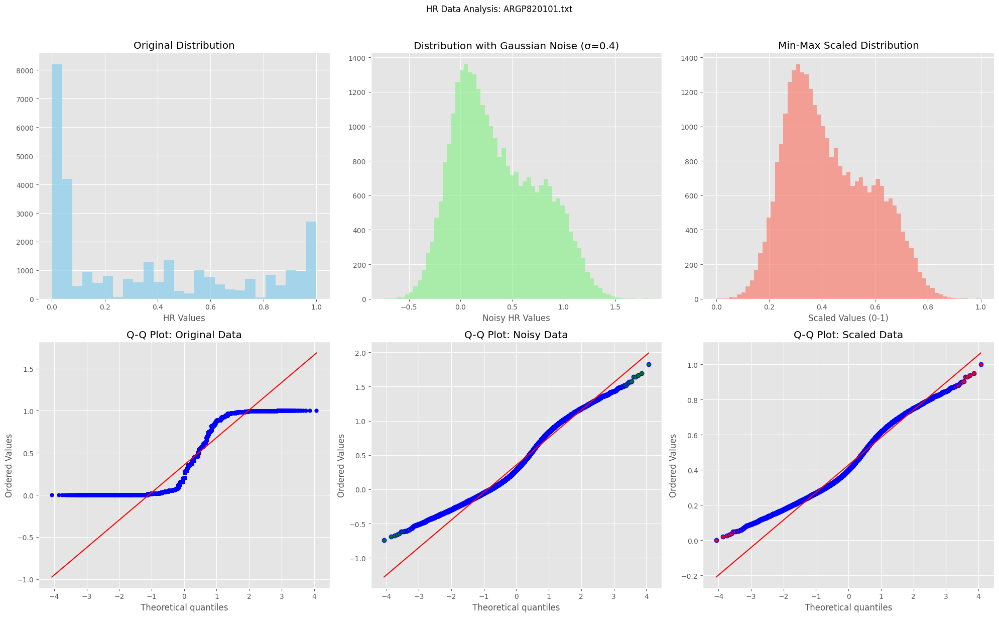

Processing files:   4%|██▎                                                              | 1/28 [00:04<02:14,  4.98s/it]

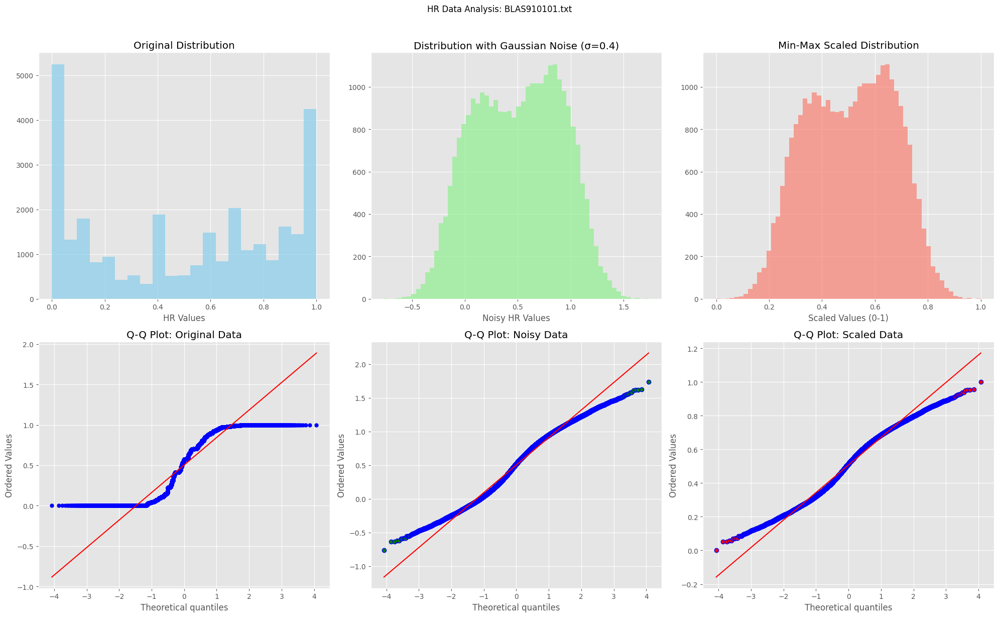

Processing files:   7%|████▋                                                            | 2/28 [00:11<02:33,  5.91s/it]

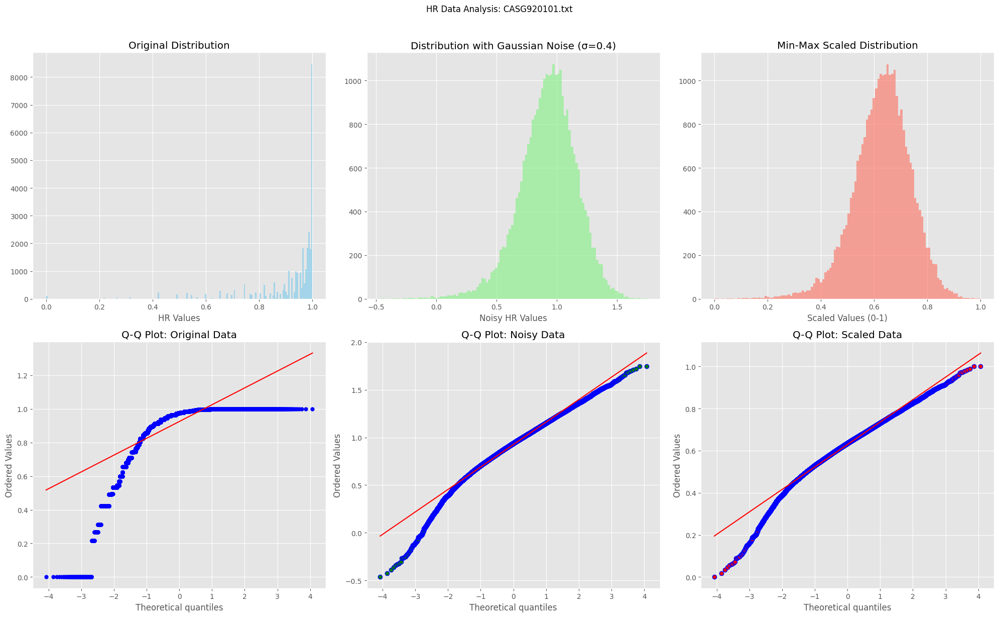

Processing files:  11%|██████▉                                                          | 3/28 [00:18<02:40,  6.40s/it]

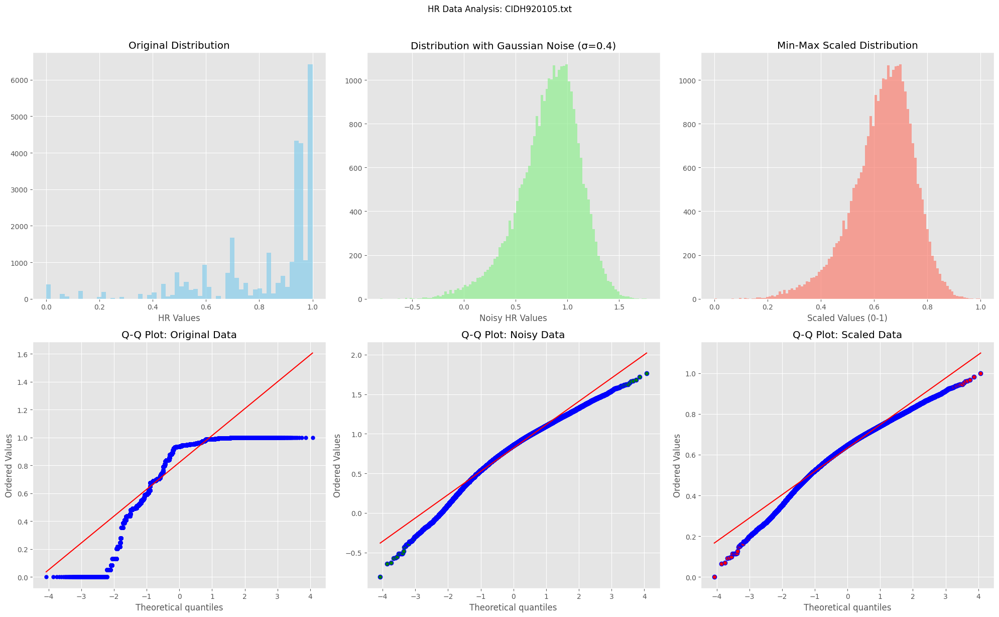

Processing files:  14%|█████████▎                                                       | 4/28 [00:24<02:29,  6.21s/it]

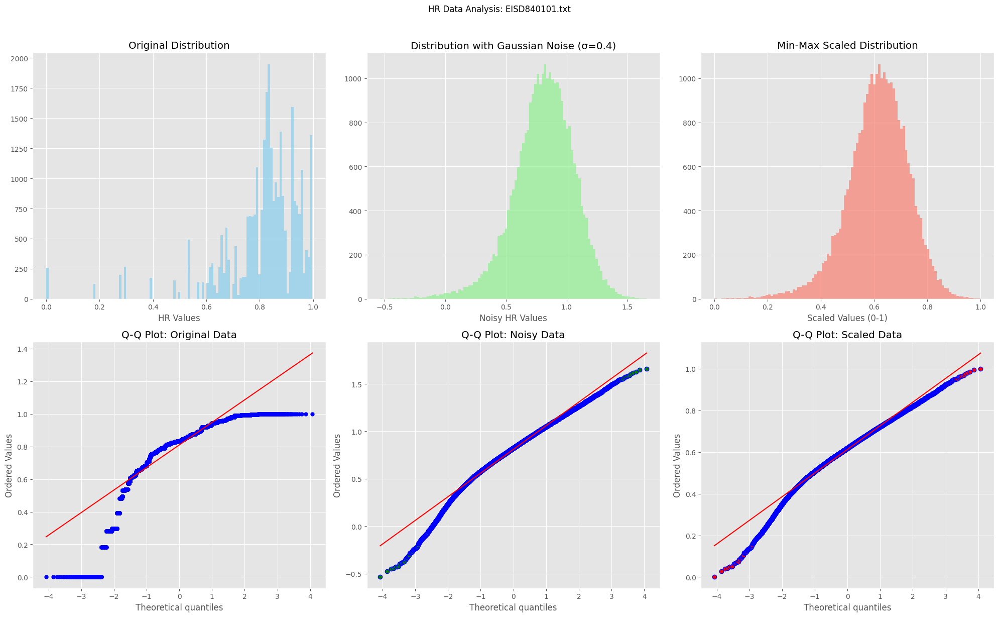

Processing files:  18%|███████████▌                                                     | 5/28 [00:30<02:24,  6.30s/it]

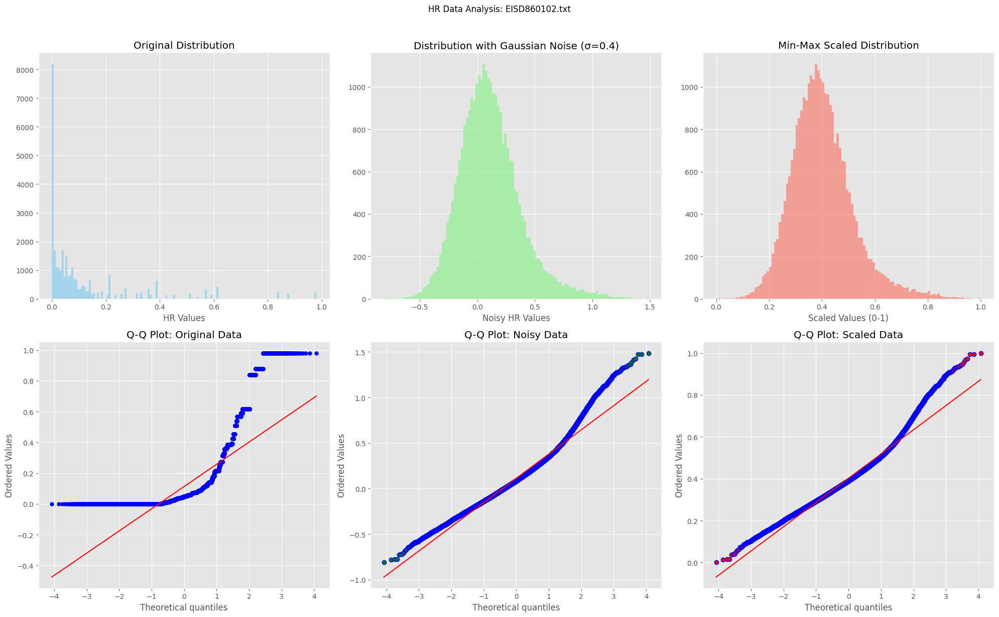

Processing files:  21%|█████████████▉                                                   | 6/28 [00:37<02:18,  6.31s/it]

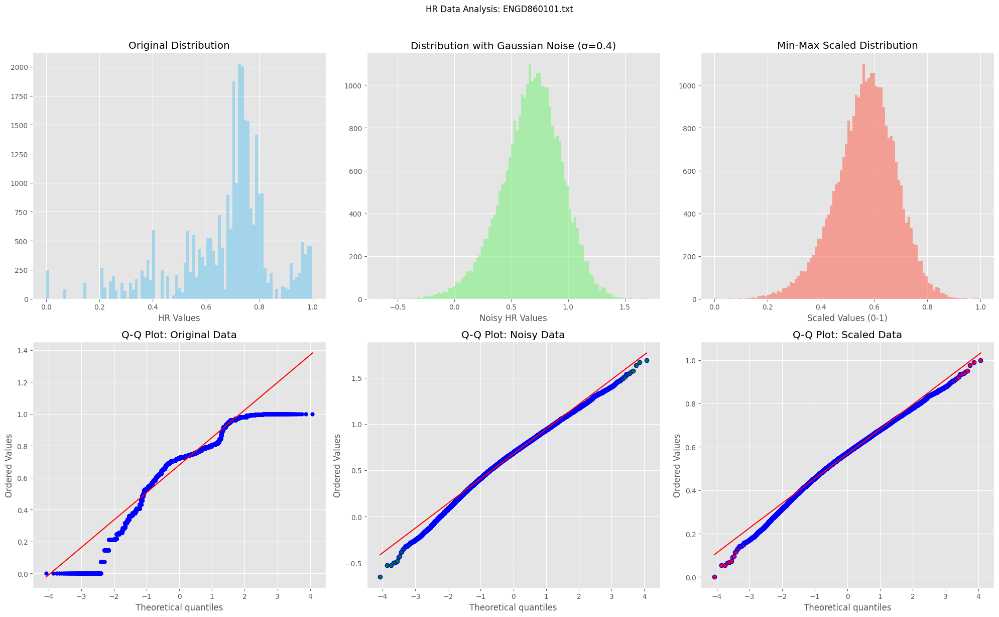

Processing files:  25%|████████████████▎                                                | 7/28 [00:43<02:12,  6.29s/it]

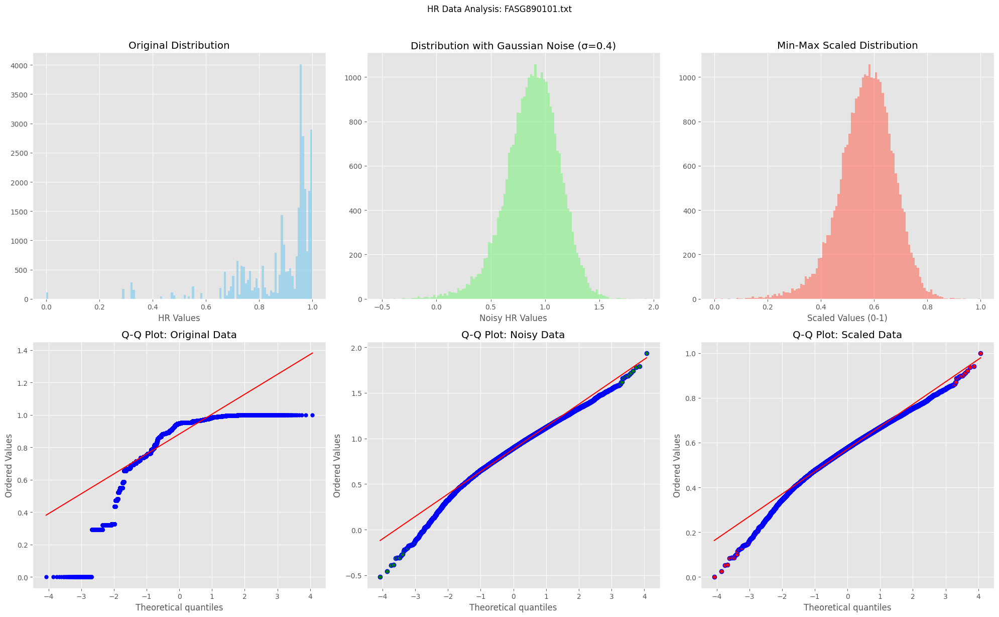

Processing files:  29%|██████████████████▌                                              | 8/28 [00:50<02:10,  6.53s/it]

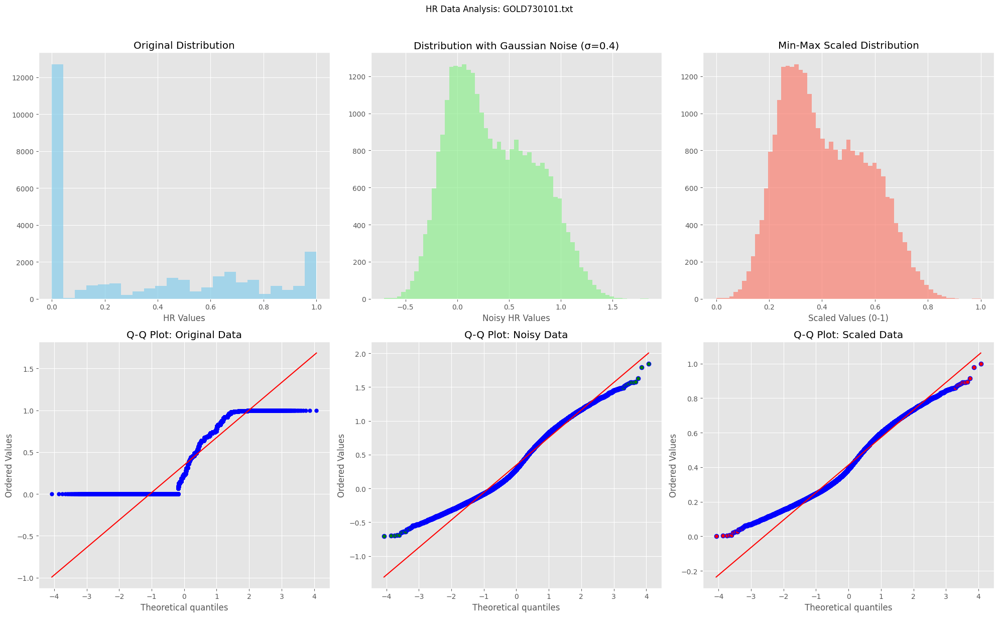

Processing files:  32%|████████████████████▉                                            | 9/28 [00:55<01:53,  5.98s/it]

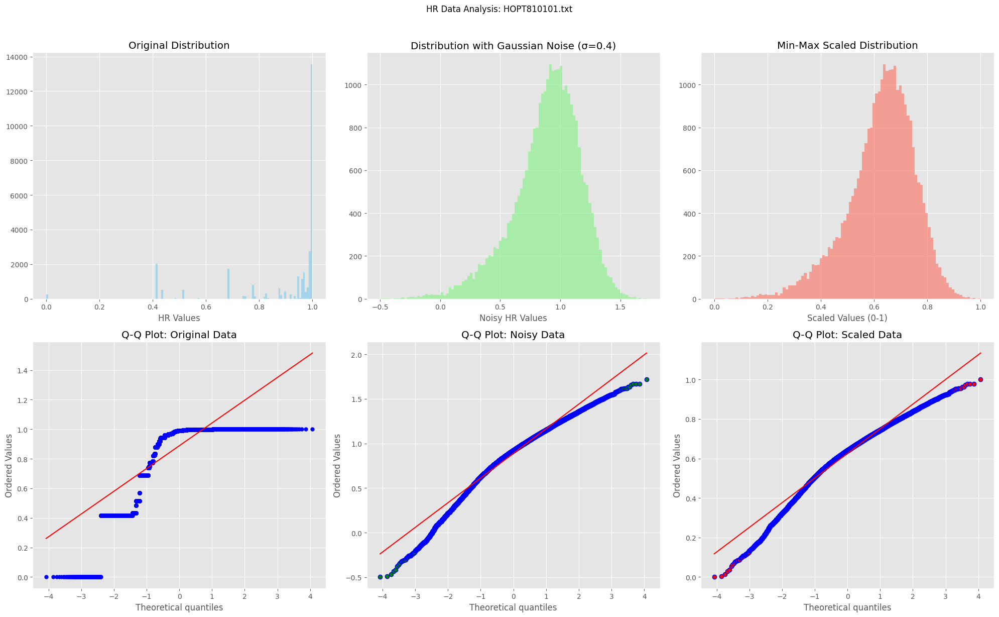

Processing files:  36%|██████████████████████▊                                         | 10/28 [01:01<01:46,  5.90s/it]

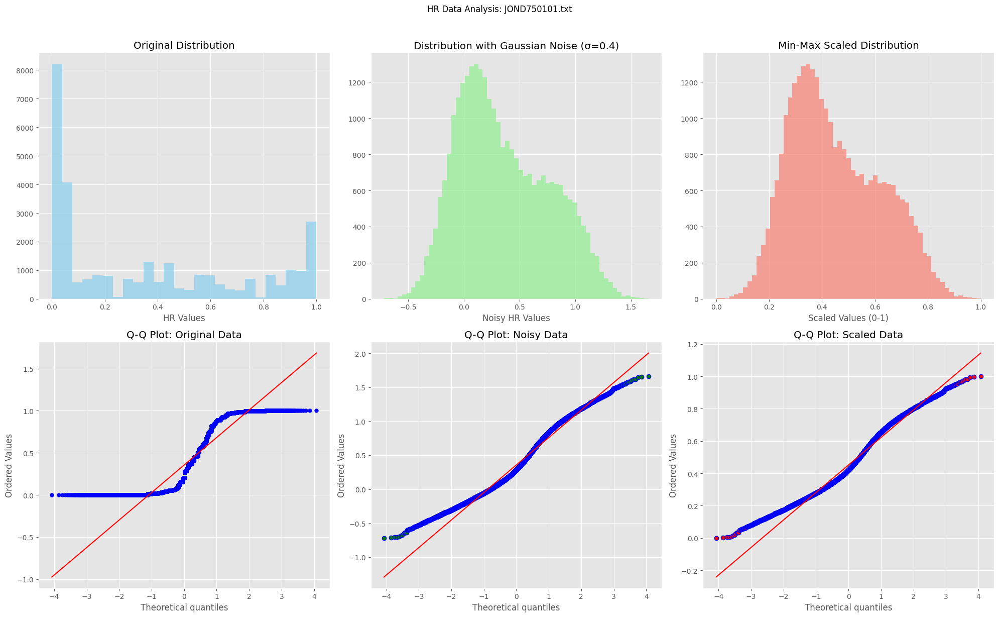

Processing files:  39%|█████████████████████████▏                                      | 11/28 [01:05<01:34,  5.56s/it]

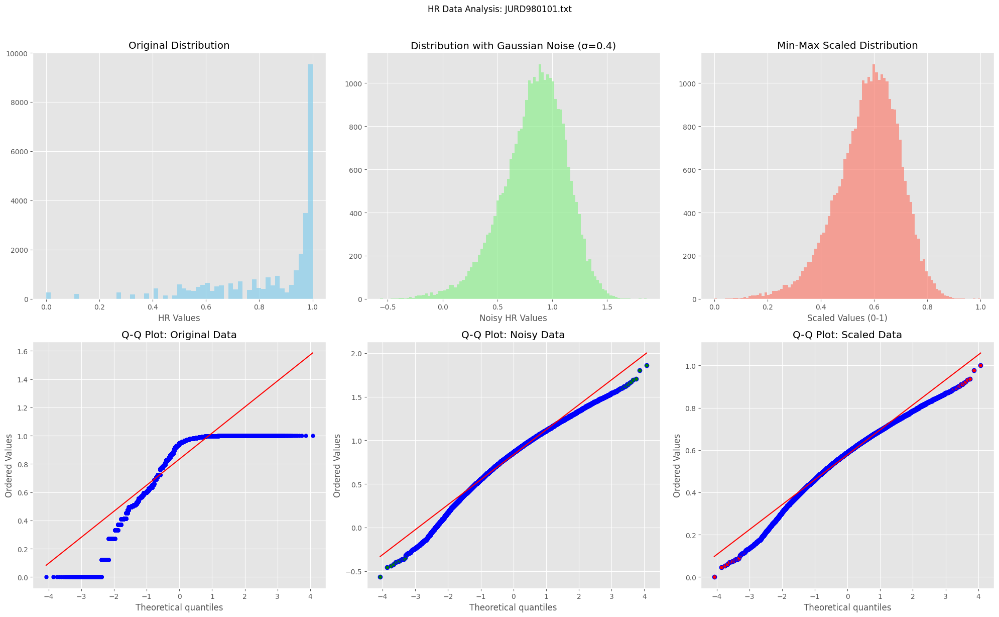

Processing files:  43%|███████████████████████████▍                                    | 12/28 [01:11<01:28,  5.54s/it]

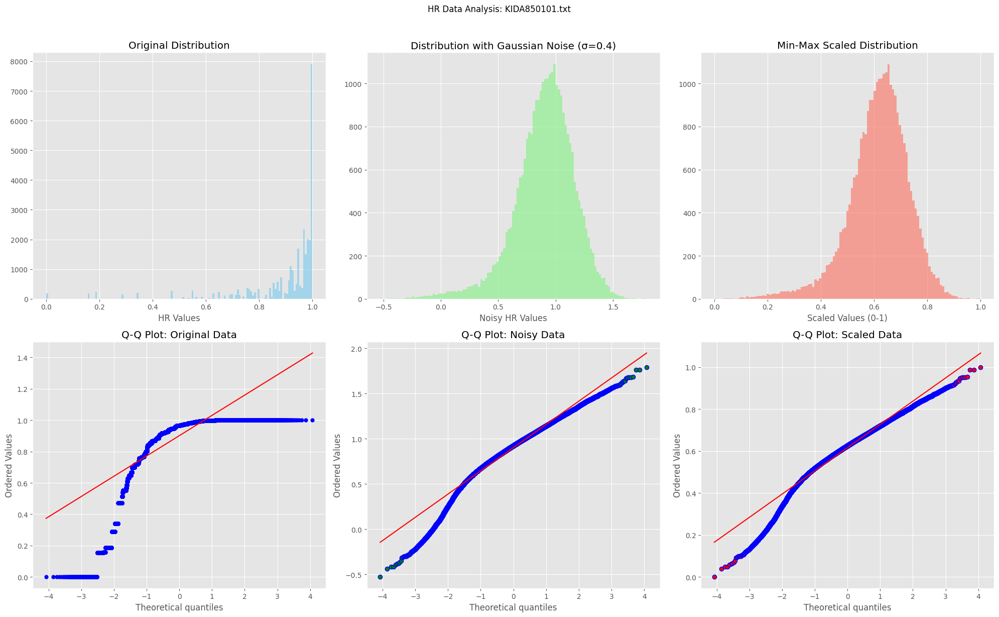

Processing files:  46%|█████████████████████████████▋                                  | 13/28 [01:17<01:25,  5.70s/it]

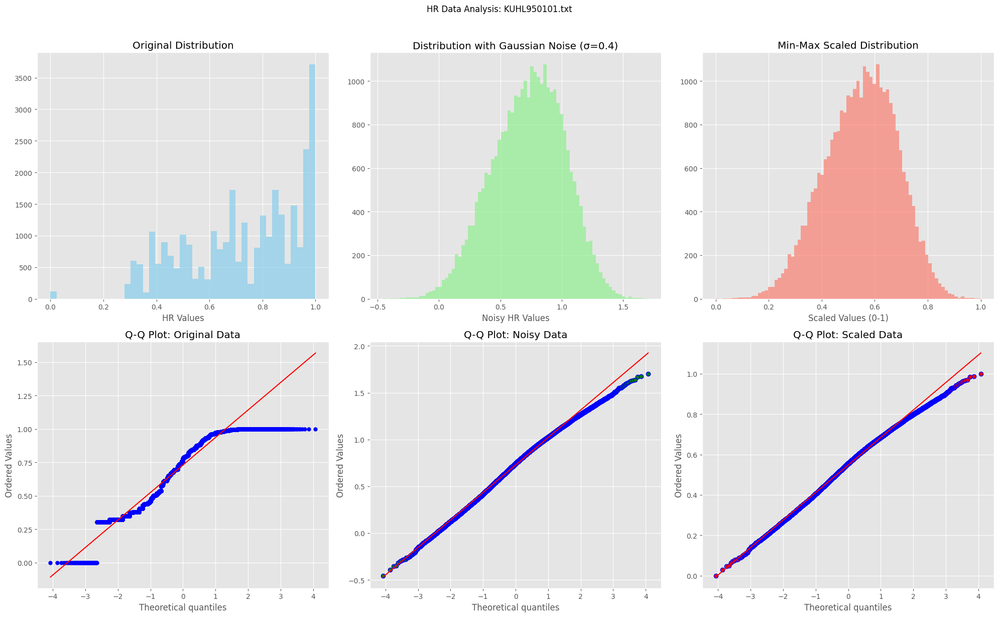

Processing files:  50%|████████████████████████████████                                | 14/28 [01:23<01:19,  5.68s/it]

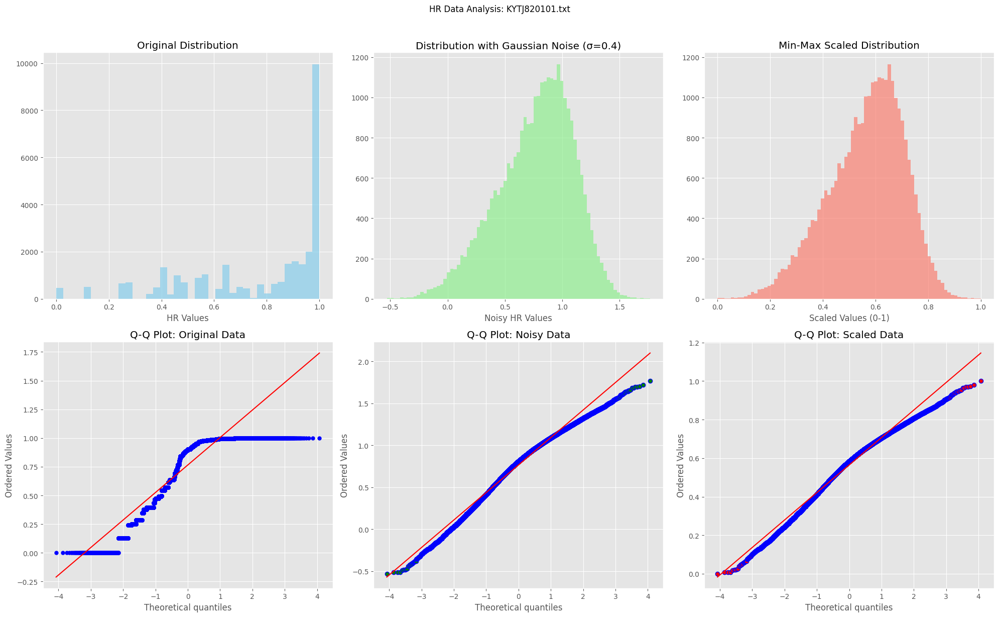

Processing files:  54%|██████████████████████████████████▎                             | 15/28 [01:29<01:17,  5.92s/it]

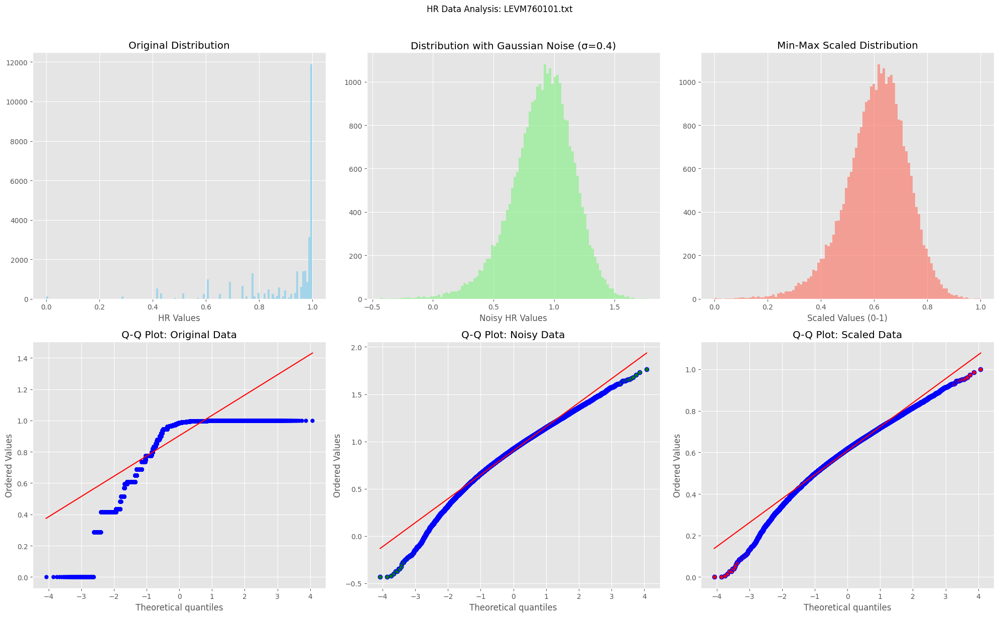

Processing files:  57%|████████████████████████████████████▌                           | 16/28 [01:35<01:10,  5.89s/it]

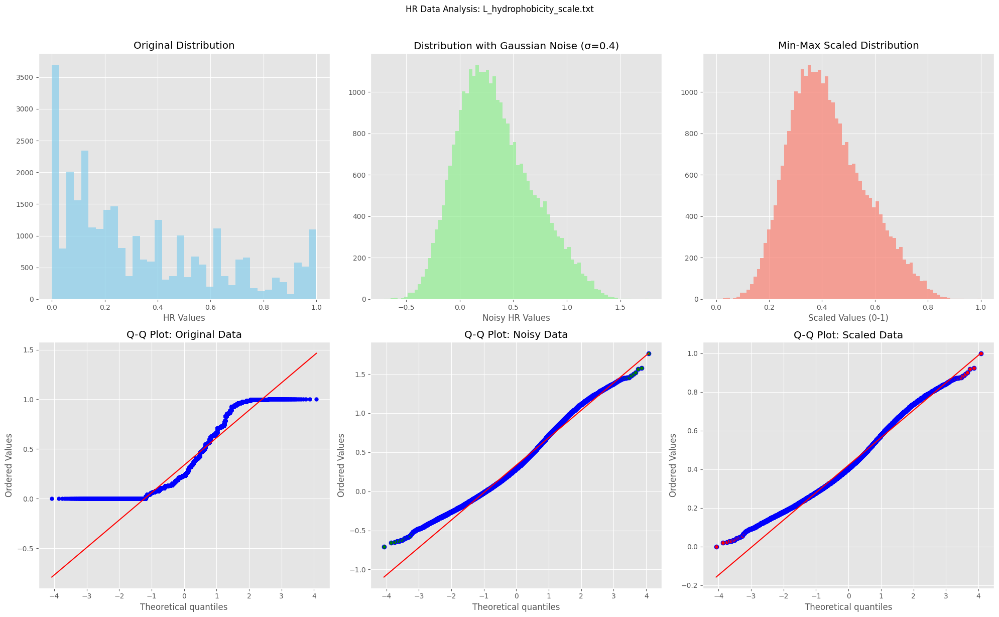

Processing files:  61%|██████████████████████████████████████▊                         | 17/28 [01:40<01:02,  5.64s/it]

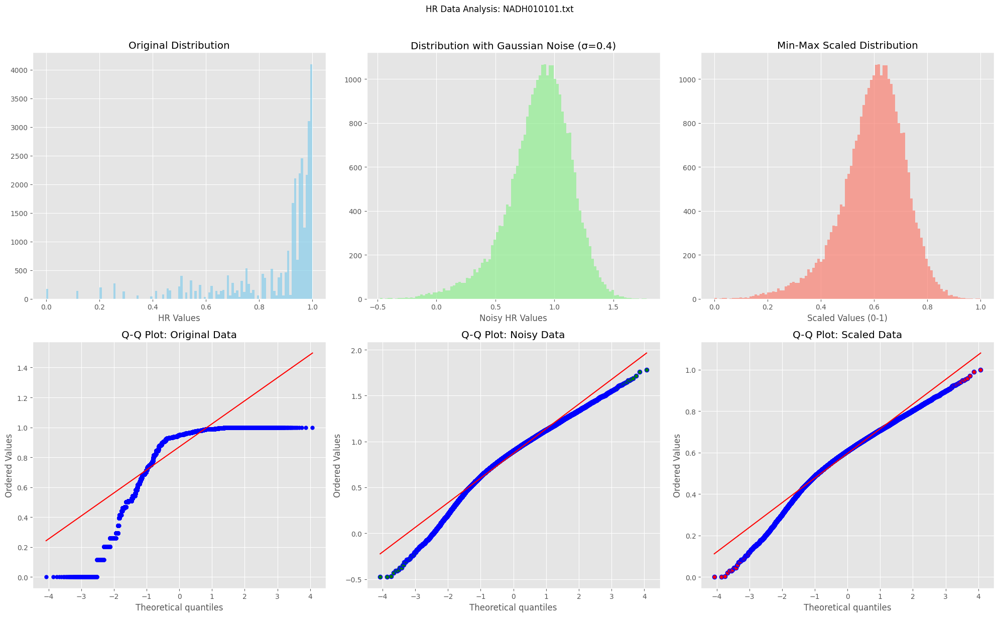

Processing files:  64%|█████████████████████████████████████████▏                      | 18/28 [01:46<00:57,  5.75s/it]

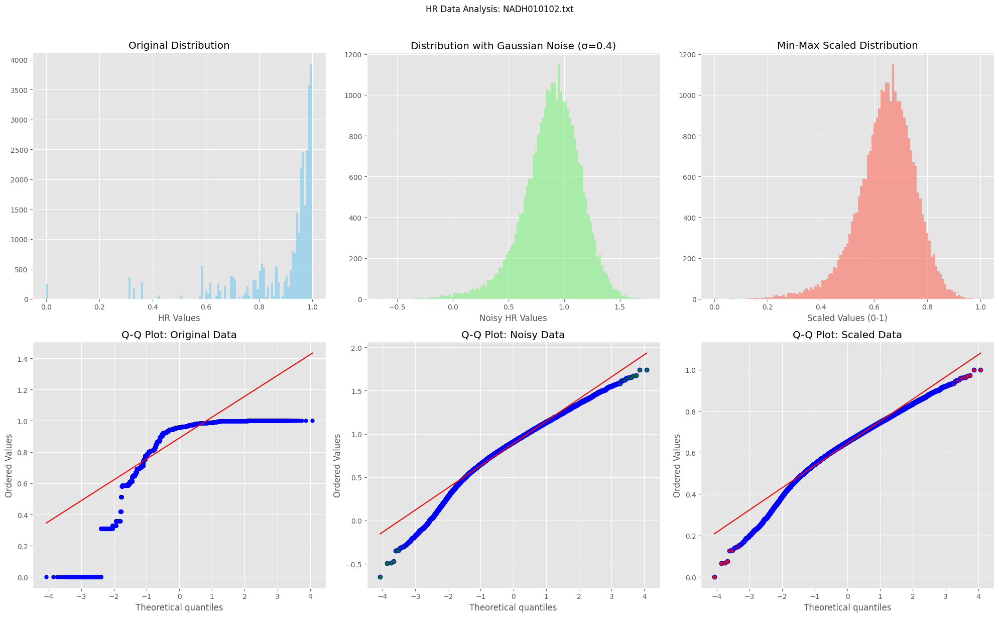

Processing files:  68%|███████████████████████████████████████████▍                    | 19/28 [01:53<00:54,  6.09s/it]

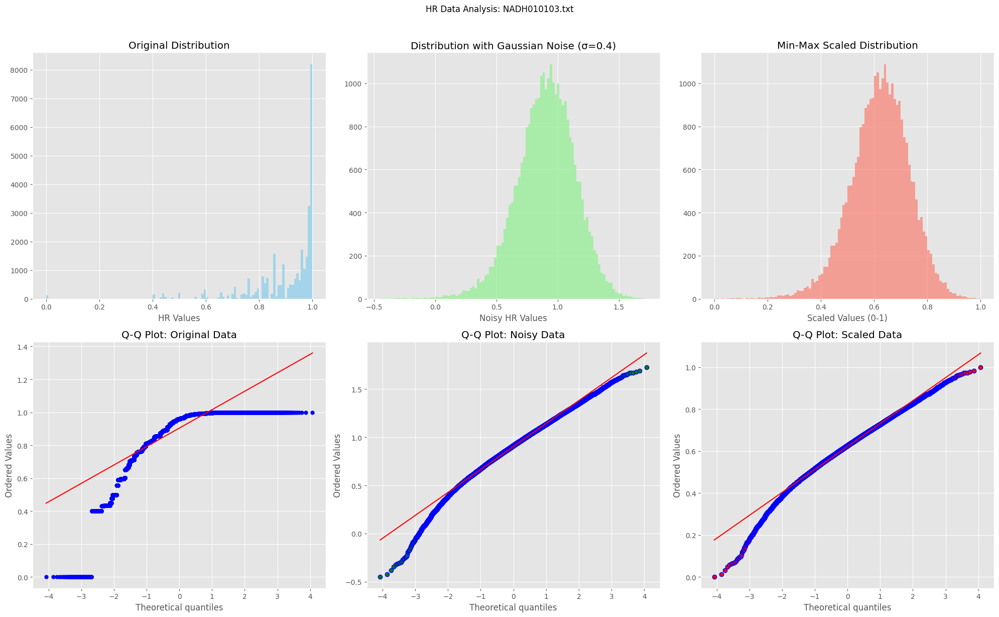

Processing files:  71%|█████████████████████████████████████████████▋                  | 20/28 [01:59<00:49,  6.19s/it]

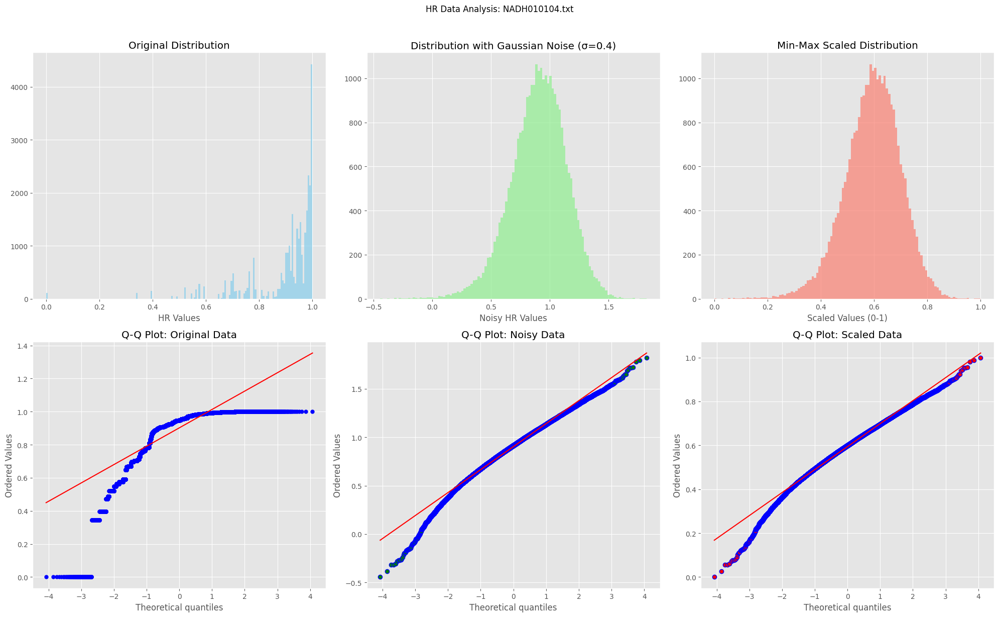

Processing files:  75%|████████████████████████████████████████████████                | 21/28 [02:05<00:42,  6.13s/it]

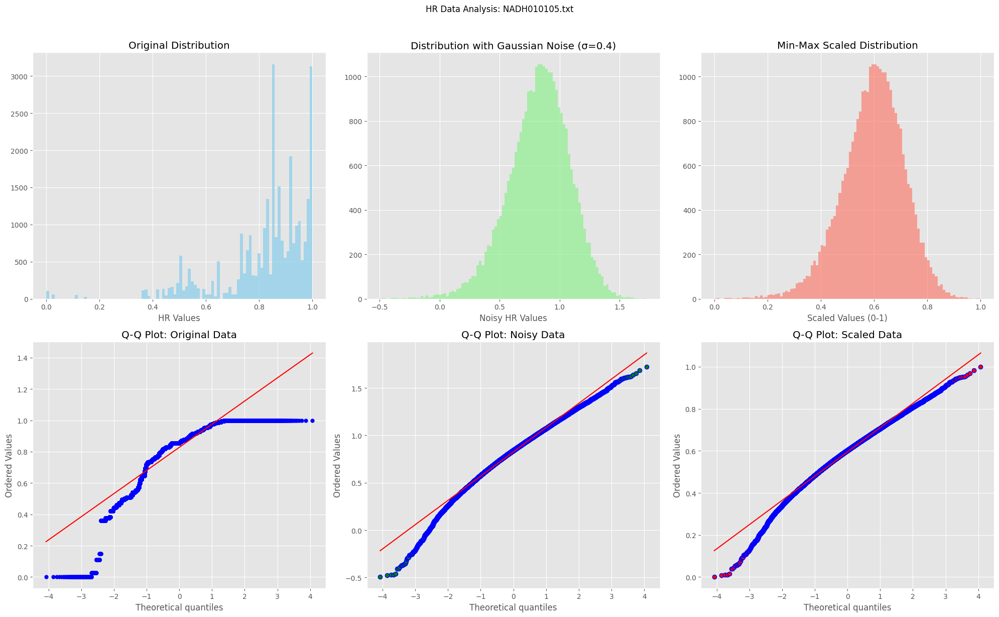

Processing files:  79%|██████████████████████████████████████████████████▎             | 22/28 [02:10<00:35,  5.85s/it]

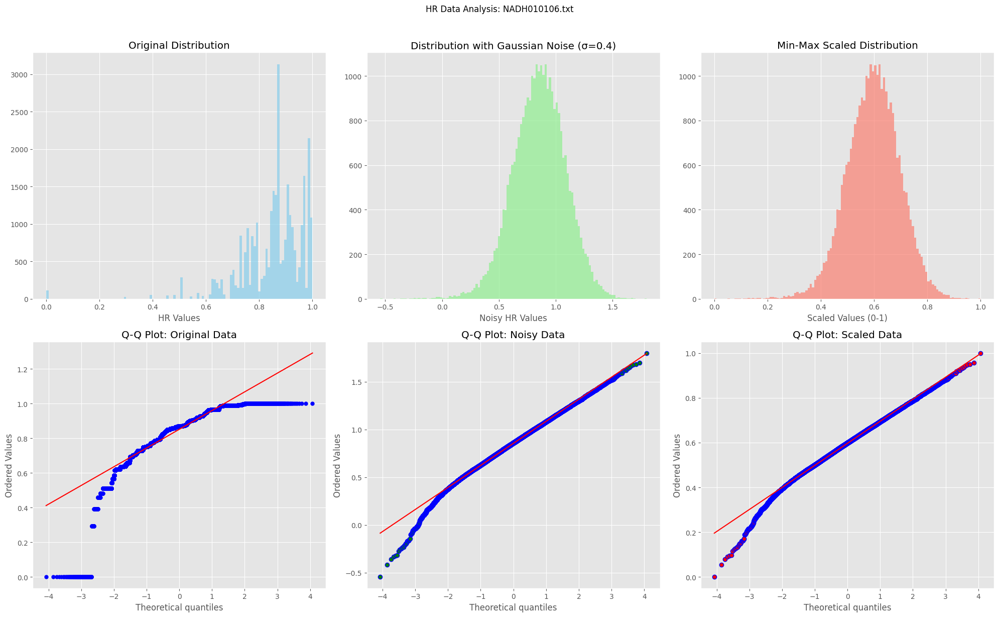

Processing files:  82%|████████████████████████████████████████████████████▌           | 23/28 [02:16<00:28,  5.73s/it]

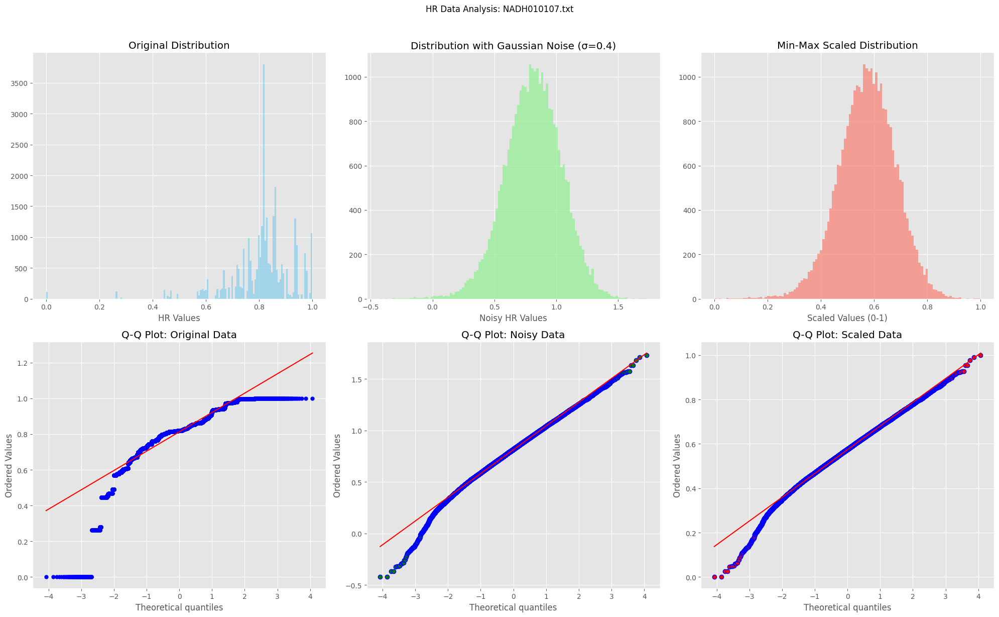

Processing files:  86%|██████████████████████████████████████████████████████▊         | 24/28 [02:22<00:23,  5.76s/it]

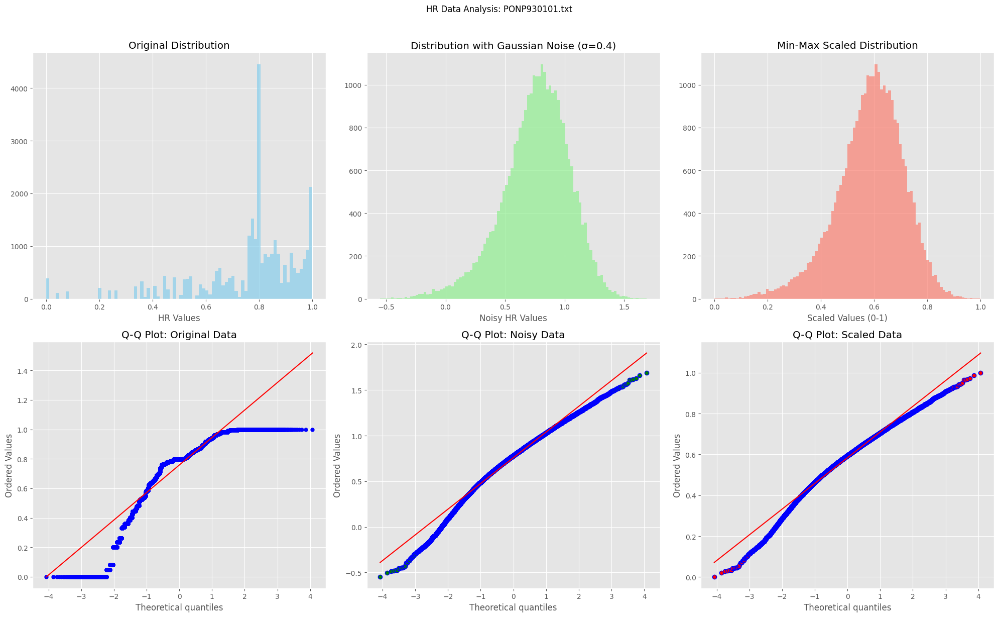

Processing files:  89%|█████████████████████████████████████████████████████████▏      | 25/28 [02:27<00:16,  5.63s/it]

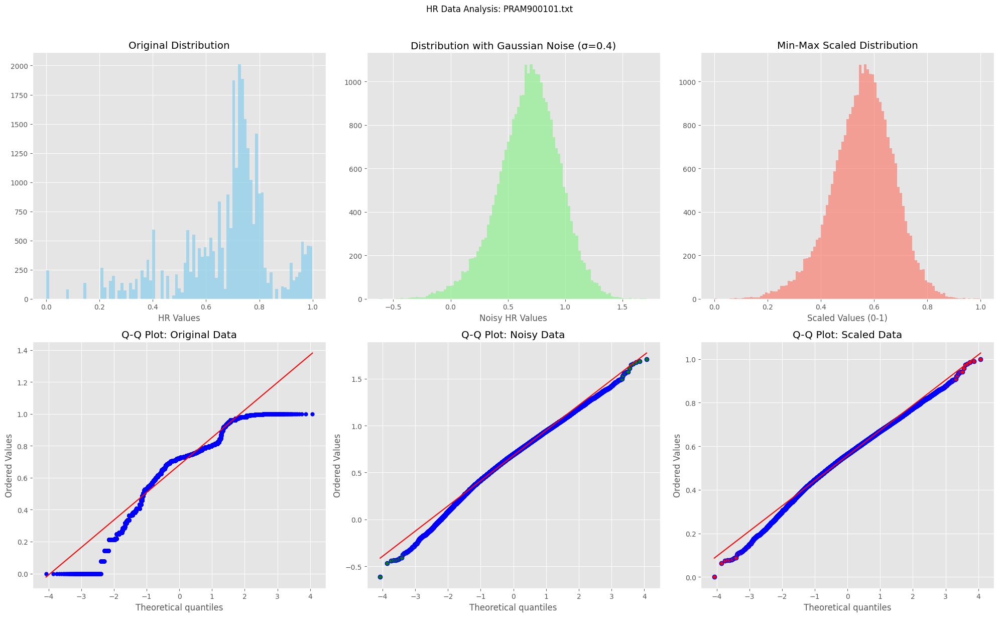

Processing files:  93%|███████████████████████████████████████████████████████████▍    | 26/28 [02:33<00:11,  5.66s/it]

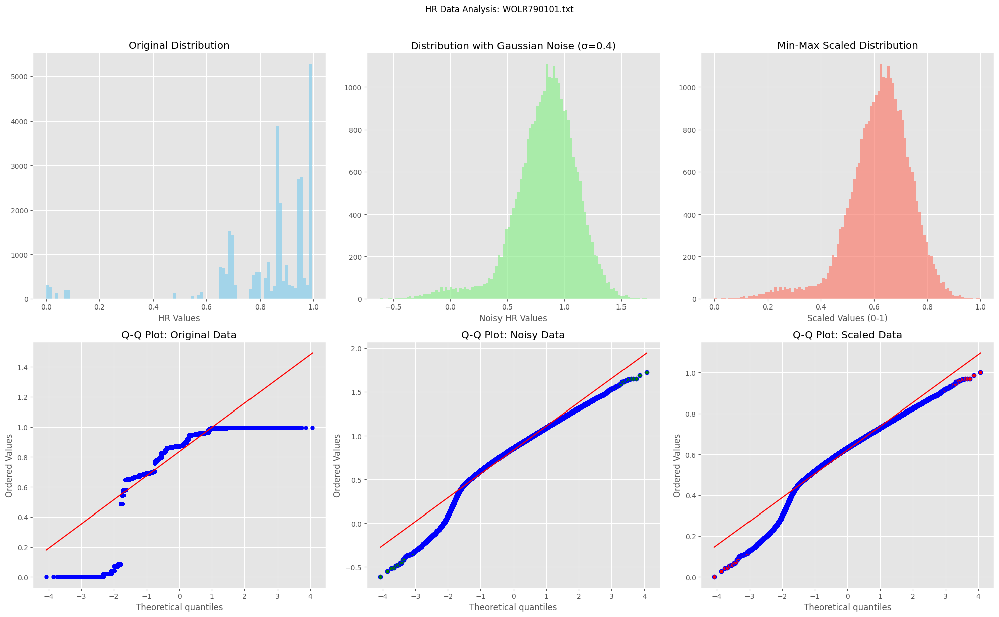

Processing files:  96%|█████████████████████████████████████████████████████████████▋  | 27/28 [02:39<00:05,  5.83s/it]

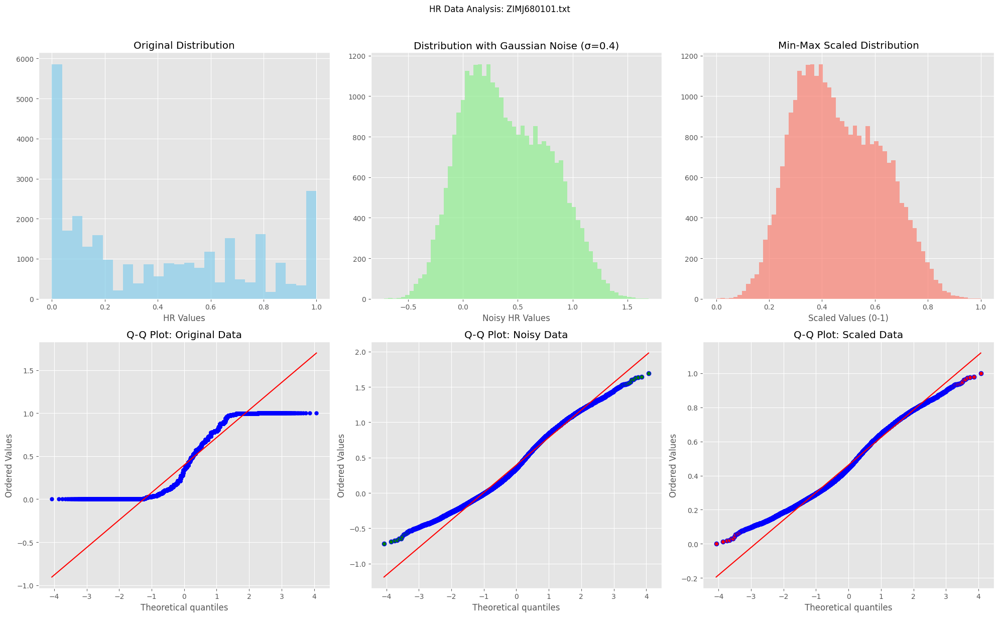

Processing files: 100%|████████████████████████████████████████████████████████████████| 28/28 [02:47<00:00,  5.98s/it]


Analysis complete!


In [3]:

# Directory setup
base_dir = "../generated_data/"
train_hr_dir = os.path.join(base_dir, "train/Hr_modified/") 

# Get all files
def get_file_list(directory):
    return [f for f in os.listdir(directory) if f.endswith('.txt')]

train_files = get_file_list(train_hr_dir)

if not train_files:
    print("No training files found!")
    exit()

print(f"Found {len(train_files)} files to process")

plt.style.use('ggplot')
plt.rcParams['figure.figsize'] = [16, 8]

for file_name in tqdm(sorted(train_files), desc="Processing files"):
    try:
        # Load training data
        train_hr = np.loadtxt(os.path.join(train_hr_dir, file_name))
        original_data = train_hr.ravel()
        
        # Add Gaussian noise
        noisy_data = original_data - np.random.normal(0, 0.2, original_data.shape)
        
        # Apply Min-Max scaling
        scaler = MinMaxScaler()
        scaled_data = scaler.fit_transform(noisy_data.reshape(-1, 1)).flatten()
        
        # Create figure
        fig, ((ax1, ax2, ax3), (ax4, ax5, ax6)) = plt.subplots(2, 3, figsize=(20, 12))
        fig.suptitle(f'HR Data Analysis: {file_name}', y=1.02)
        
        # Original histogram
        ax1.hist(original_data, bins='auto', color='skyblue', alpha=0.7)
        ax1.set_title('Original Distribution')
        ax1.set_xlabel('HR Values')
        
        # Noisy histogram
        ax2.hist(noisy_data, bins='auto', color='lightgreen', alpha=0.7)
        ax2.set_title('Distribution with Gaussian Noise (σ=0.4)')
        ax2.set_xlabel('Noisy HR Values')
        
        # Scaled histogram
        ax3.hist(scaled_data, bins='auto', color='salmon', alpha=0.7)
        ax3.set_title('Min-Max Scaled Distribution')
        ax3.set_xlabel('Scaled Values (0-1)')
        
        # Original Q-Q plot
        stats.probplot(original_data, dist="norm", plot=ax4)
        ax4.set_title('Q-Q Plot: Original Data')
        ax4.get_lines()[0].set_markerfacecolor('blue')
        ax4.get_lines()[0].set_markersize(5.0)
        
        # Noisy Q-Q plot
        stats.probplot(noisy_data, dist="norm", plot=ax5)
        ax5.set_title('Q-Q Plot: Noisy Data')
        ax5.get_lines()[0].set_markerfacecolor('green')
        
        # Scaled Q-Q plot
        stats.probplot(scaled_data, dist="norm", plot=ax6)
        ax6.set_title('Q-Q Plot: Scaled Data')
        ax6.get_lines()[0].set_markerfacecolor('red')
        
        plt.tight_layout()
        plt.show()
        
    except Exception as e:
        print(f"\nError processing {file_name}: {str(e)}")
        continue

print("\nAnalysis complete!")

Found 28 files to process


Processing files:   0%|                                                                         | 0/28 [00:00<?, ?it/s]

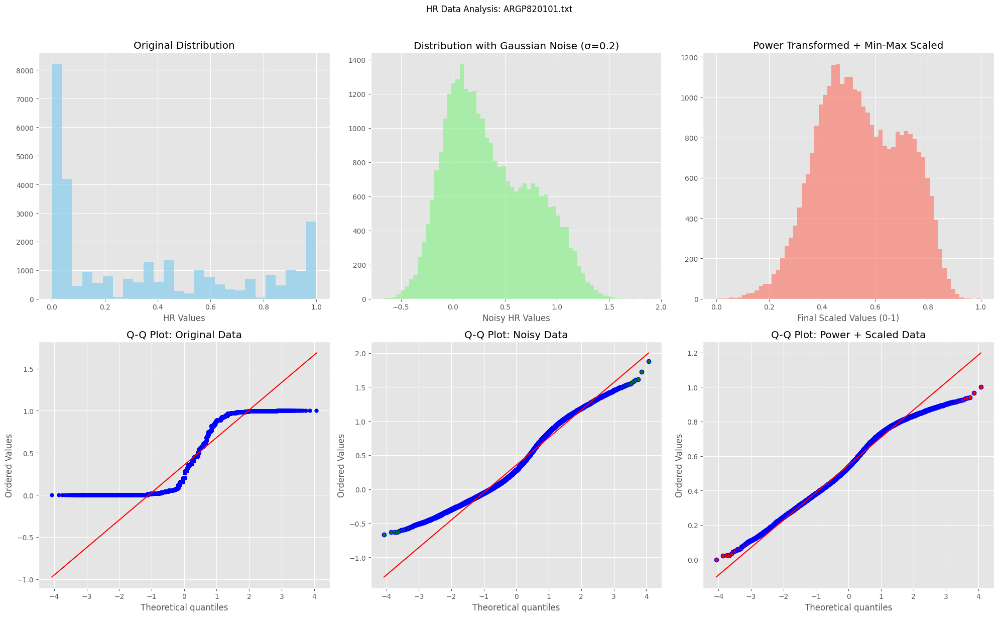

Processing files:   4%|██▎                                                              | 1/28 [00:05<02:18,  5.13s/it]

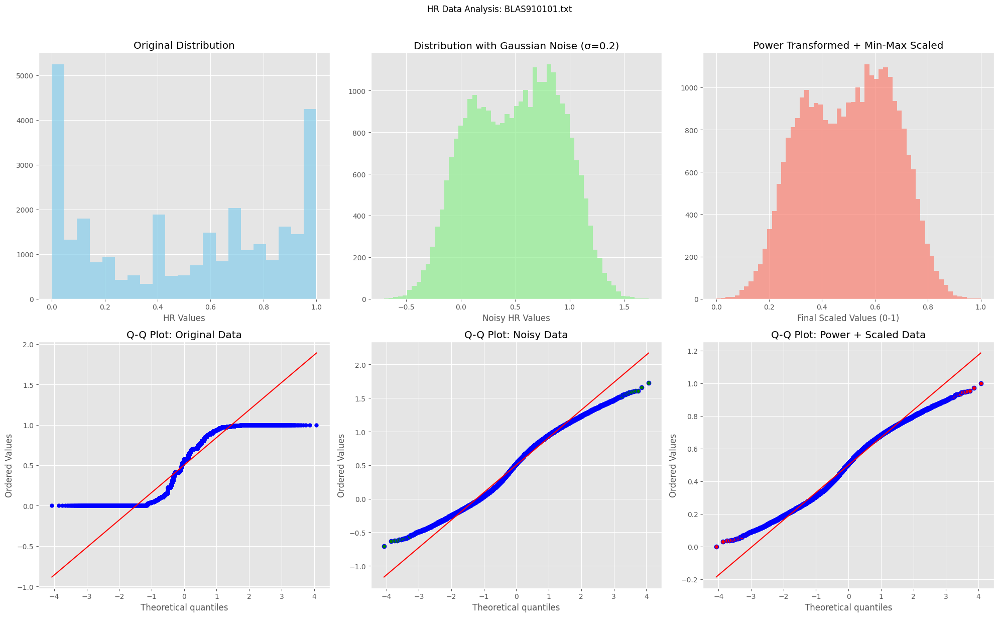

Processing files:   7%|████▋                                                            | 2/28 [00:09<02:09,  4.97s/it]

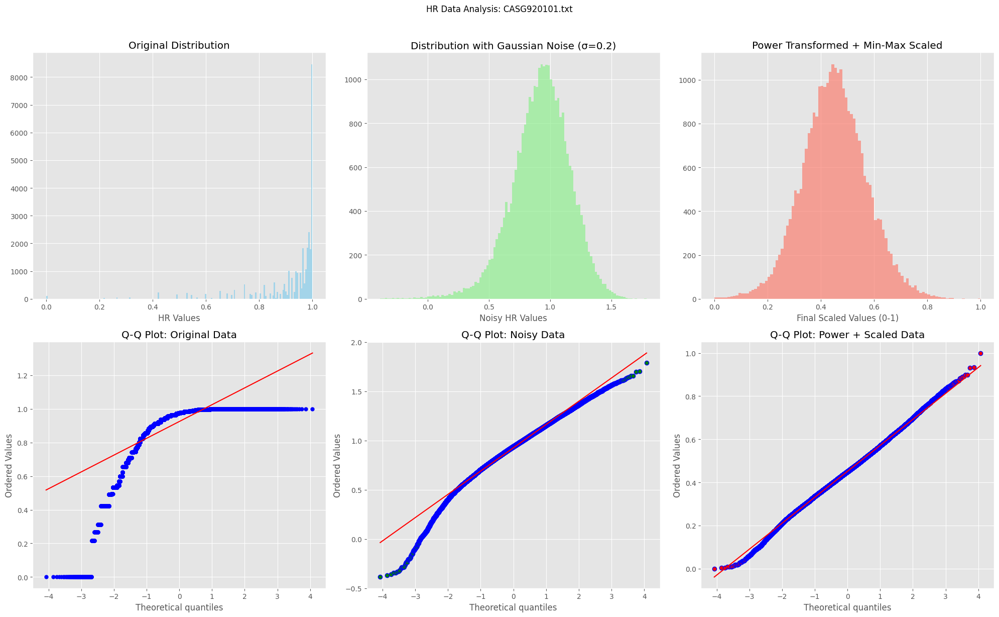

Processing files:  11%|██████▉                                                          | 3/28 [00:16<02:18,  5.53s/it]

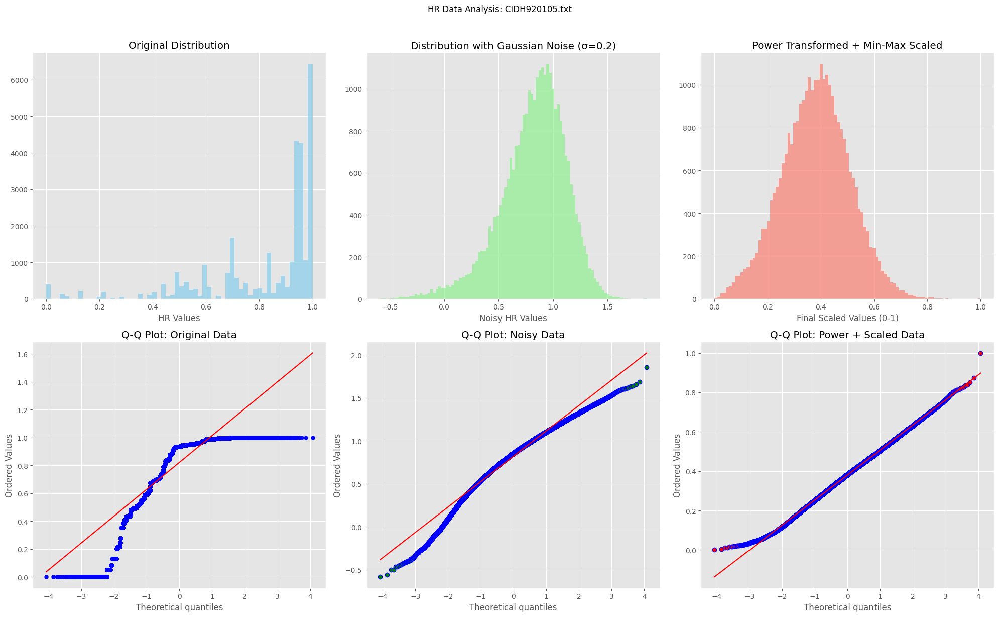

Processing files:  14%|█████████▎                                                       | 4/28 [00:21<02:14,  5.60s/it]

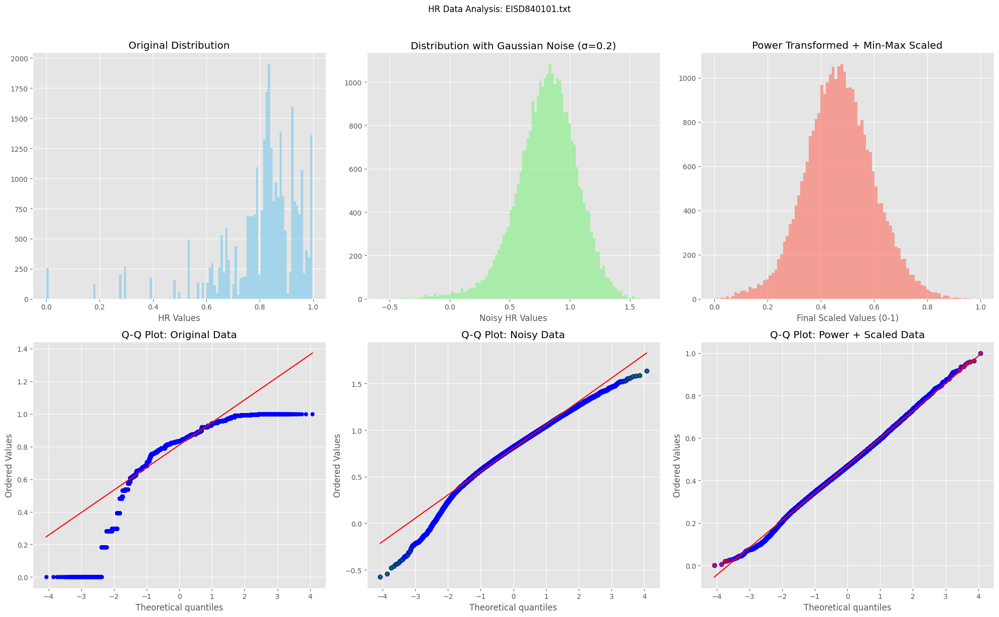

Processing files:  18%|███████████▌                                                     | 5/28 [00:27<02:07,  5.55s/it]

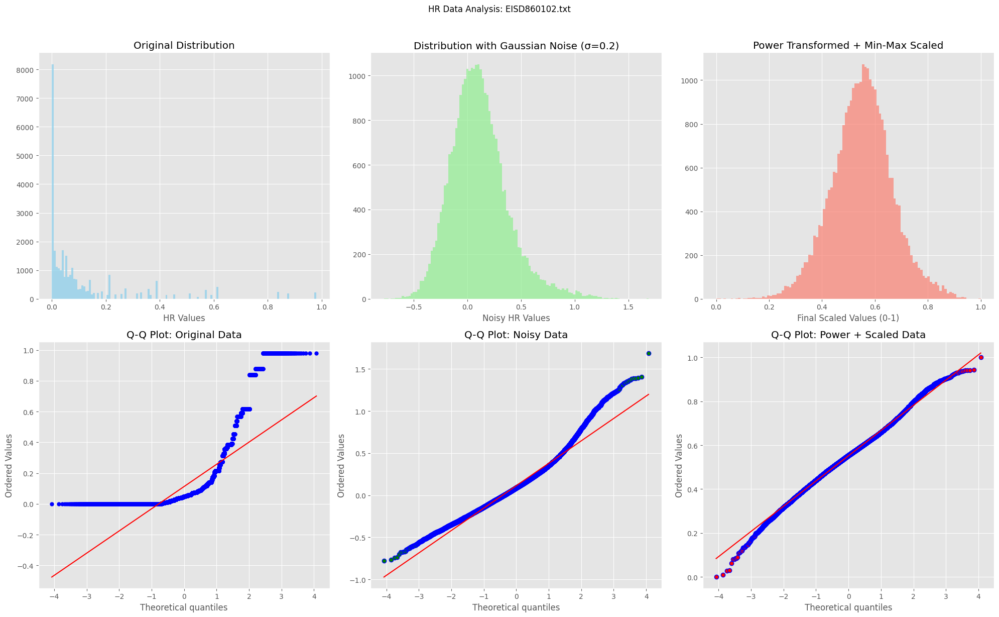

Processing files:  21%|█████████████▉                                                   | 6/28 [00:34<02:14,  6.13s/it]

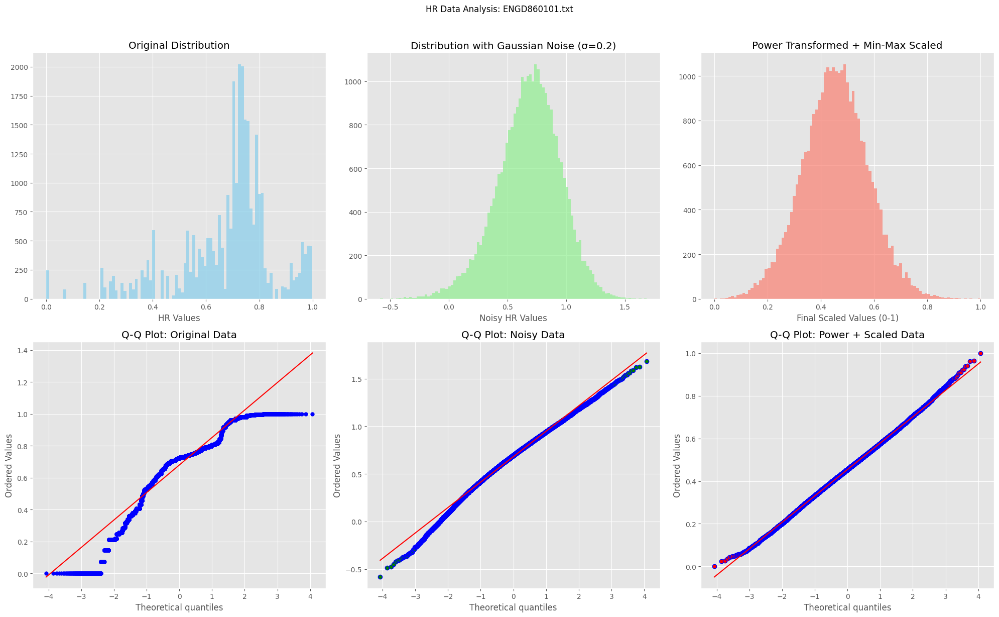

Processing files:  25%|████████████████▎                                                | 7/28 [00:40<02:07,  6.09s/it]

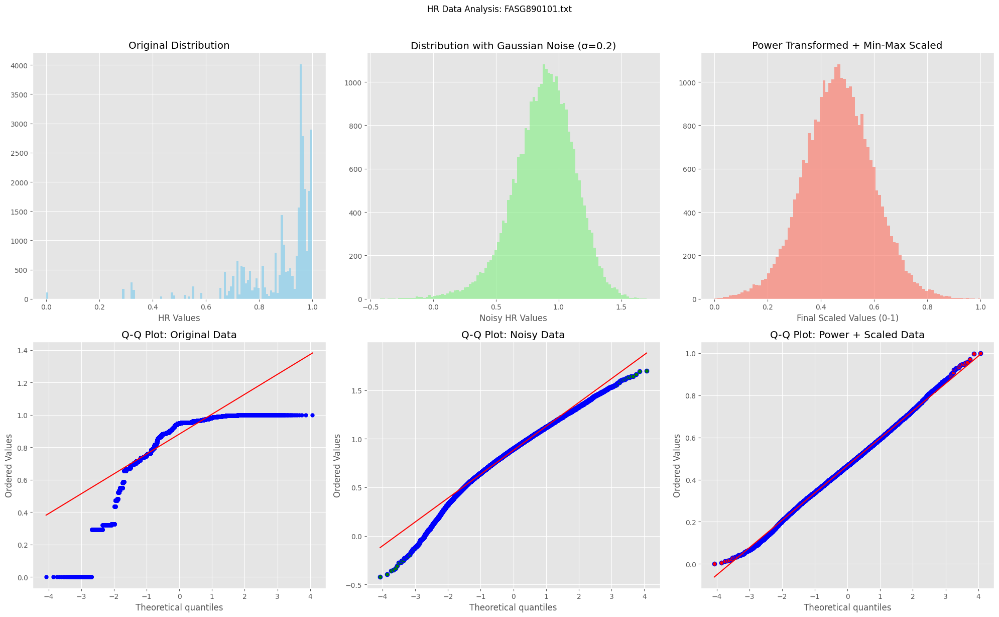

Processing files:  29%|██████████████████▌                                              | 8/28 [00:48<02:10,  6.52s/it]

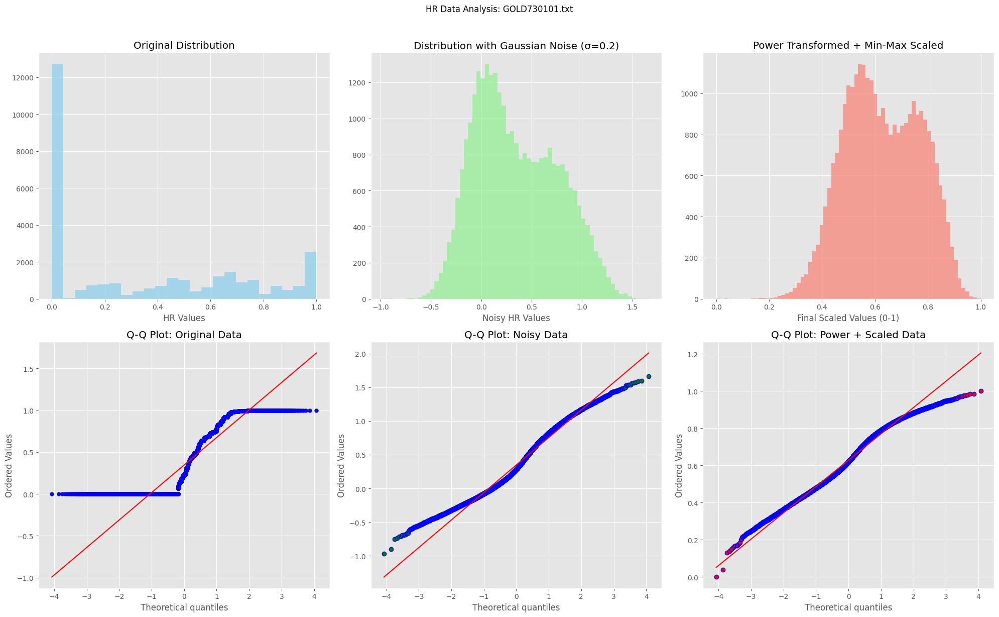

Processing files:  32%|████████████████████▉                                            | 9/28 [00:52<01:53,  5.95s/it]

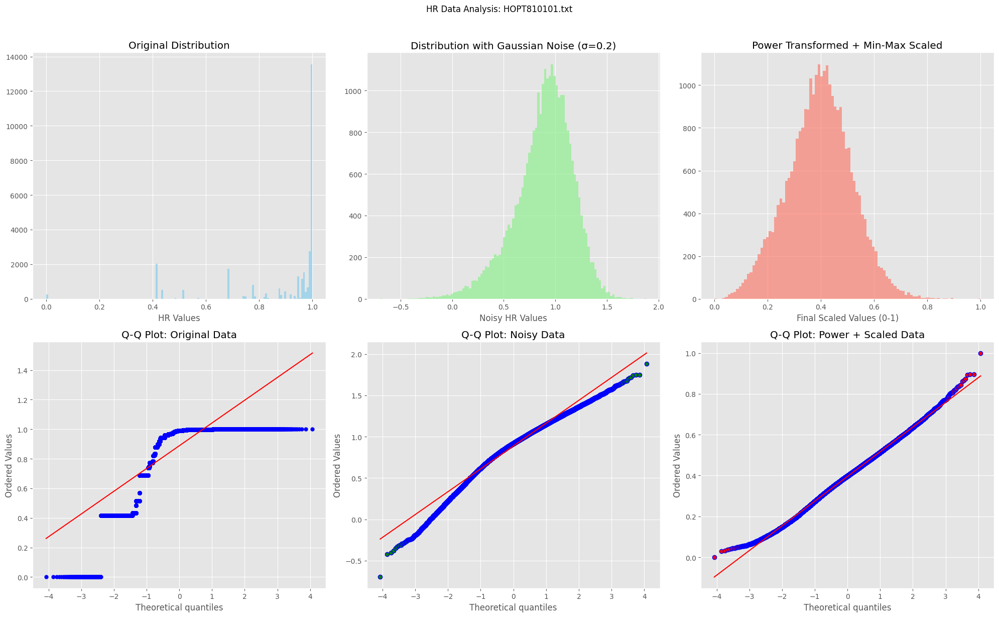

Processing files:  36%|██████████████████████▊                                         | 10/28 [00:59<01:53,  6.33s/it]

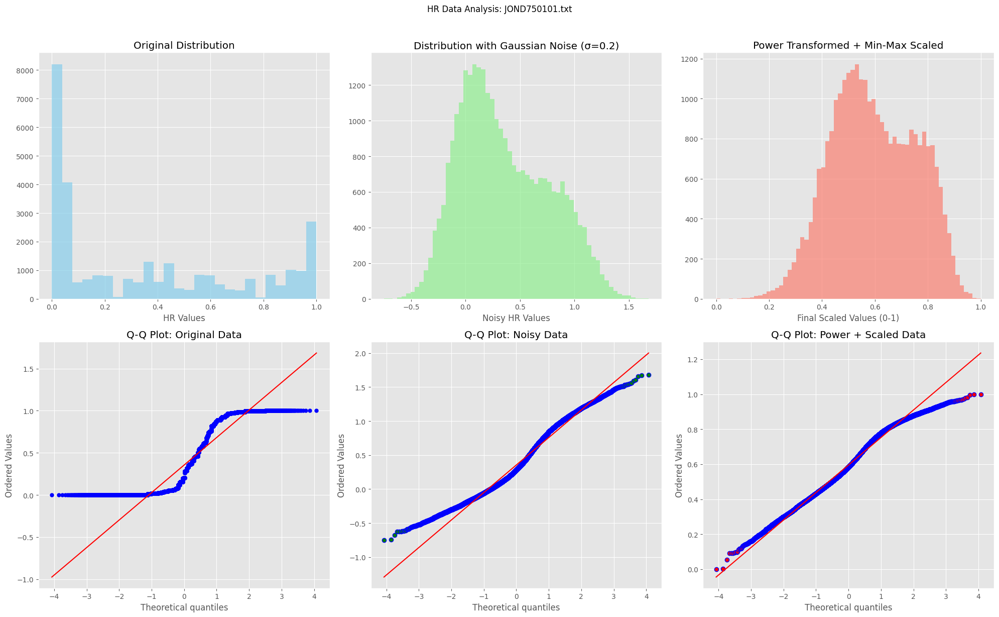

Processing files:  39%|█████████████████████████▏                                      | 11/28 [01:05<01:41,  5.97s/it]

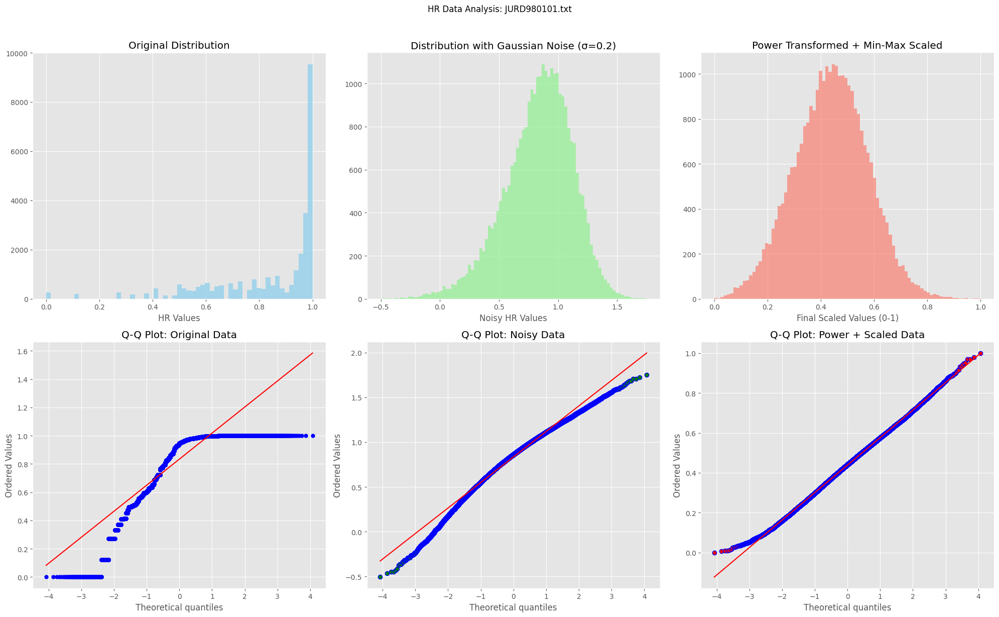

Processing files:  43%|███████████████████████████▍                                    | 12/28 [01:10<01:34,  5.91s/it]

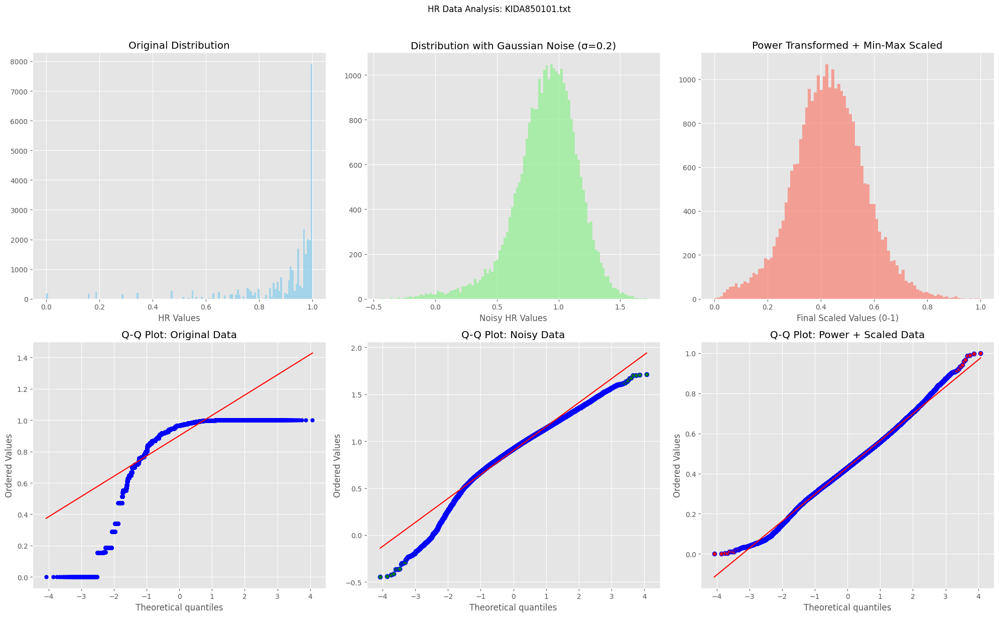

Processing files:  46%|█████████████████████████████▋                                  | 13/28 [01:16<01:29,  5.94s/it]

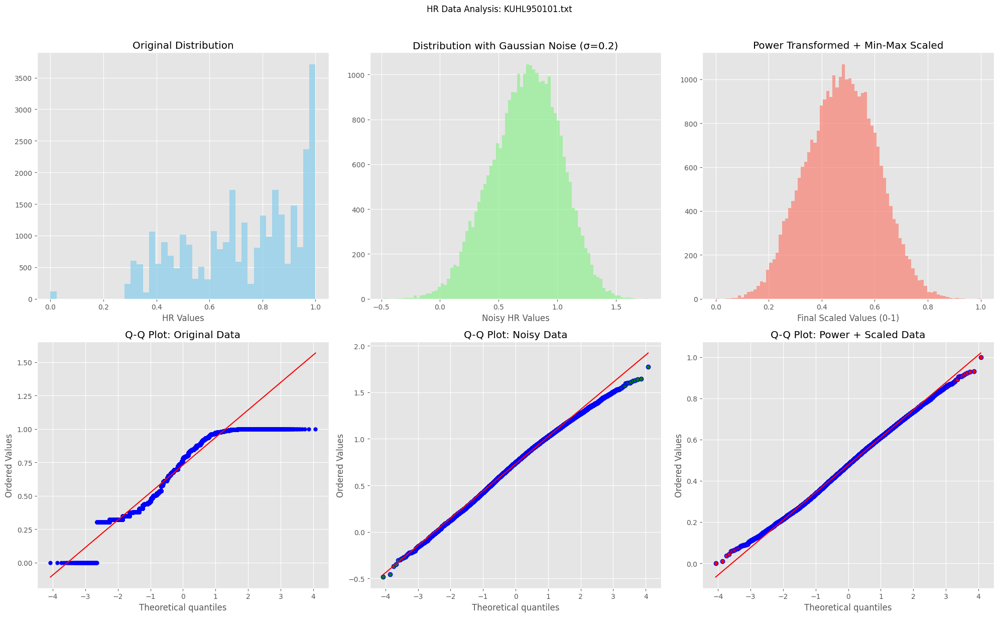

Processing files:  50%|████████████████████████████████                                | 14/28 [01:22<01:22,  5.86s/it]

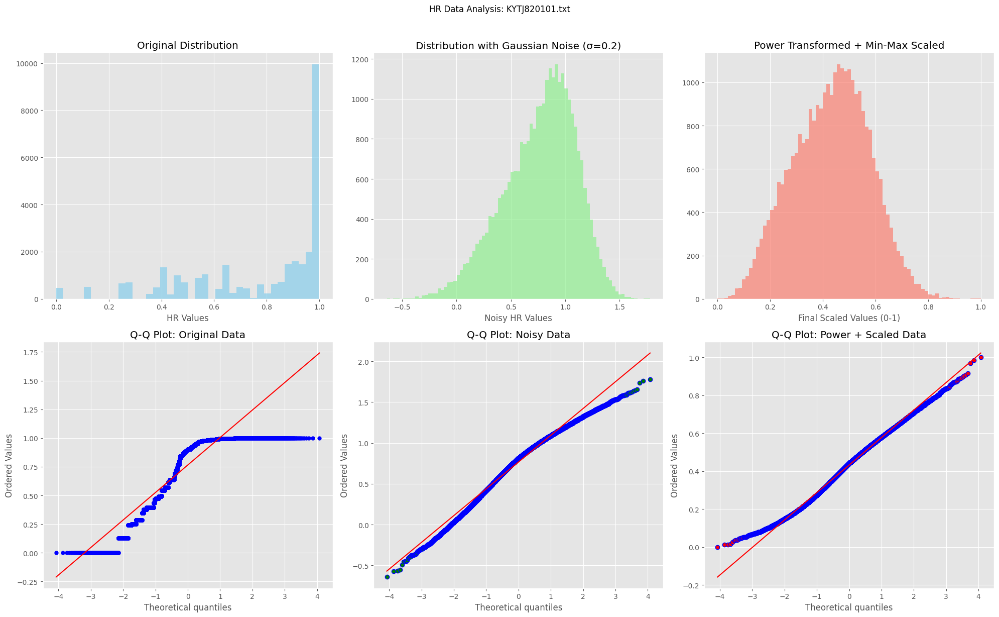

Processing files:  54%|██████████████████████████████████▎                             | 15/28 [01:27<01:13,  5.62s/it]

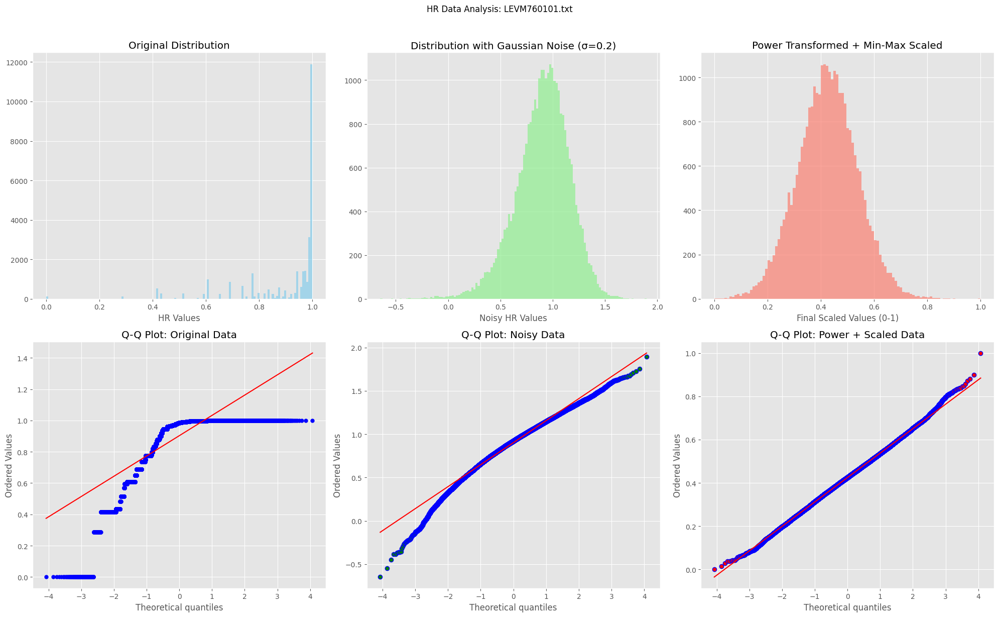

Processing files:  57%|████████████████████████████████████▌                           | 16/28 [01:33<01:10,  5.84s/it]

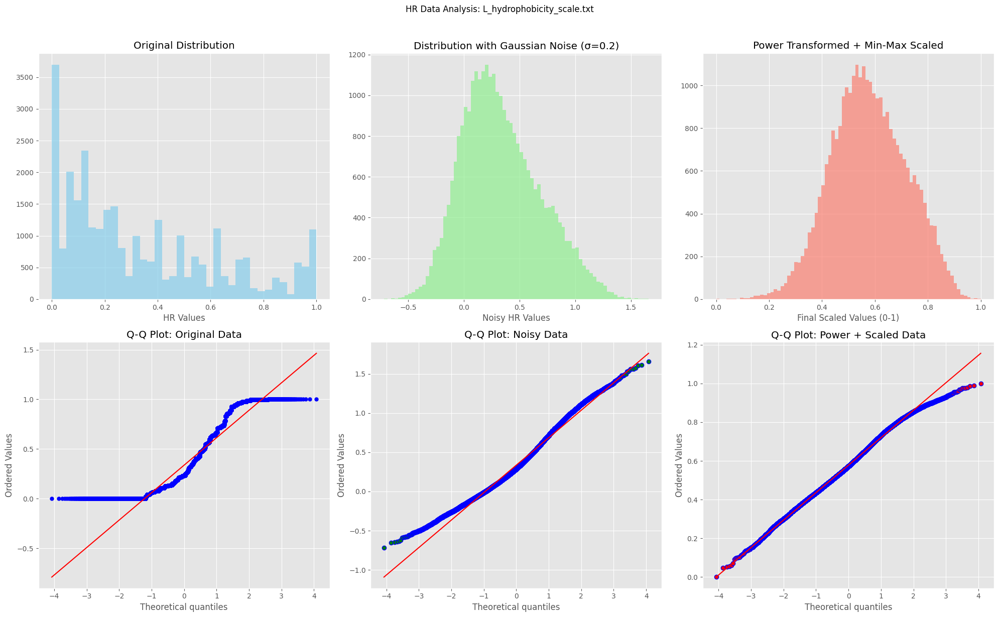

Processing files:  61%|██████████████████████████████████████▊                         | 17/28 [01:39<01:02,  5.68s/it]

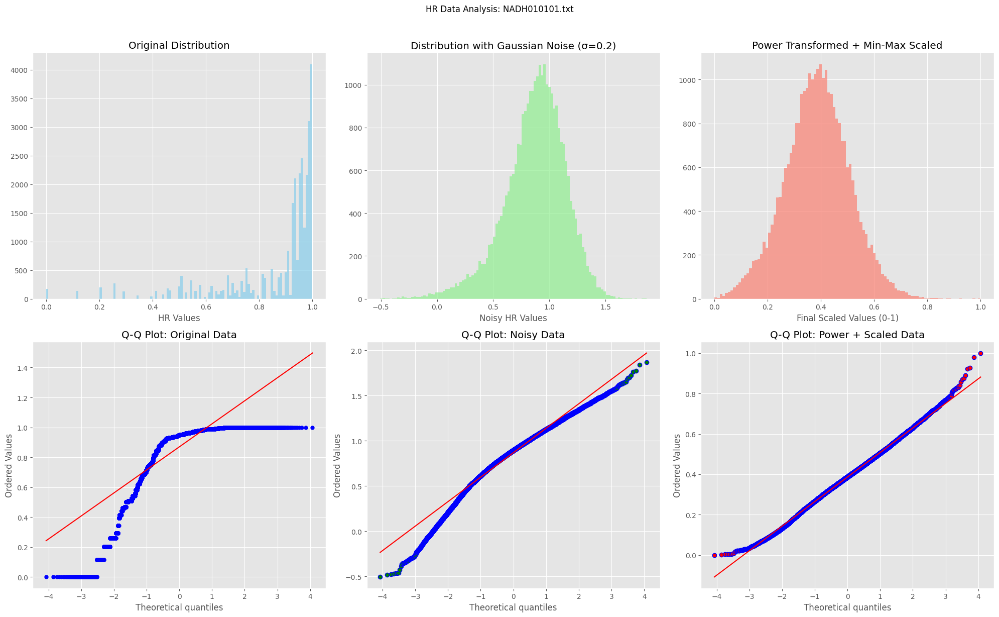

Processing files:  64%|█████████████████████████████████████████▏                      | 18/28 [01:45<00:59,  5.97s/it]

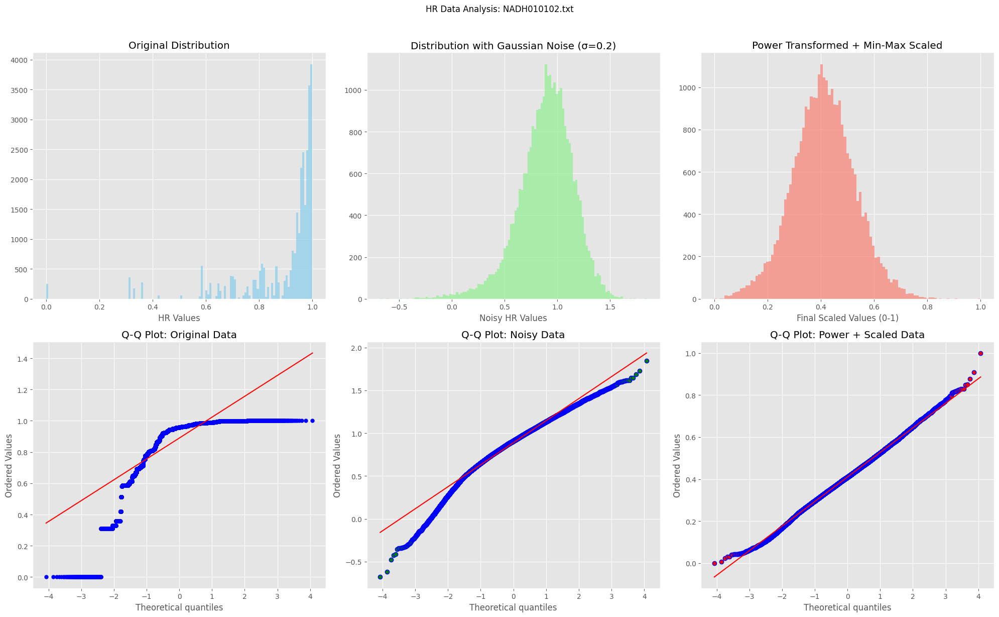

Processing files:  68%|███████████████████████████████████████████▍                    | 19/28 [01:52<00:55,  6.15s/it]

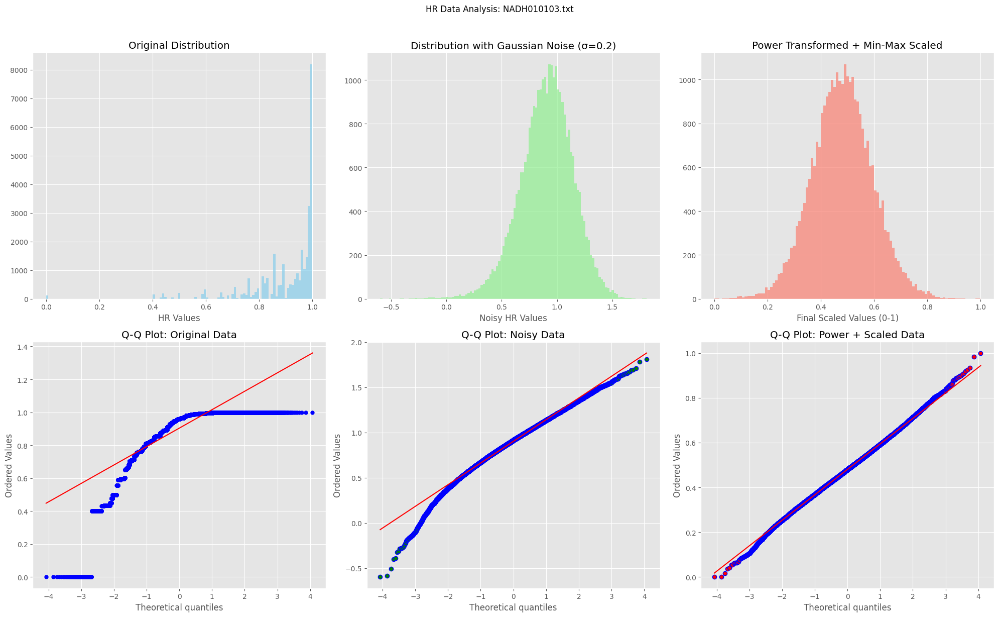

Processing files:  71%|█████████████████████████████████████████████▋                  | 20/28 [01:58<00:49,  6.16s/it]

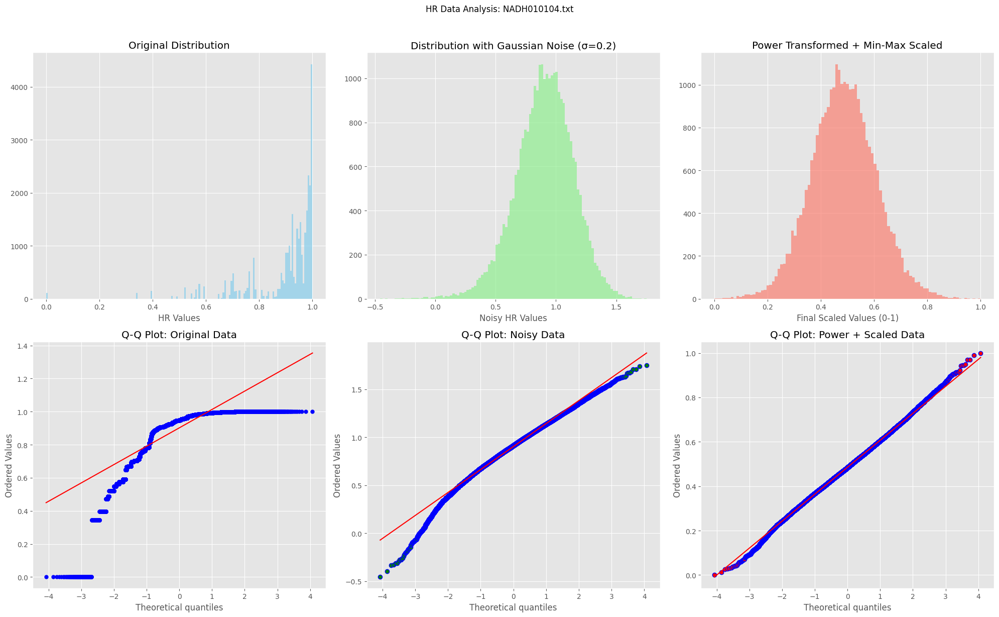

Processing files:  75%|████████████████████████████████████████████████                | 21/28 [02:06<00:45,  6.54s/it]

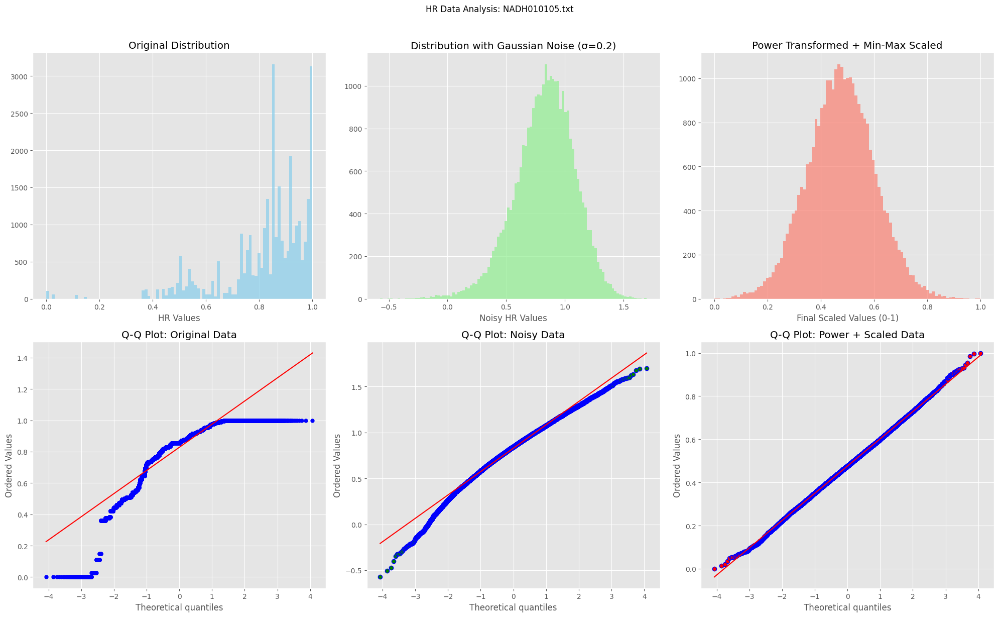

Processing files:  79%|██████████████████████████████████████████████████▎             | 22/28 [02:11<00:37,  6.25s/it]

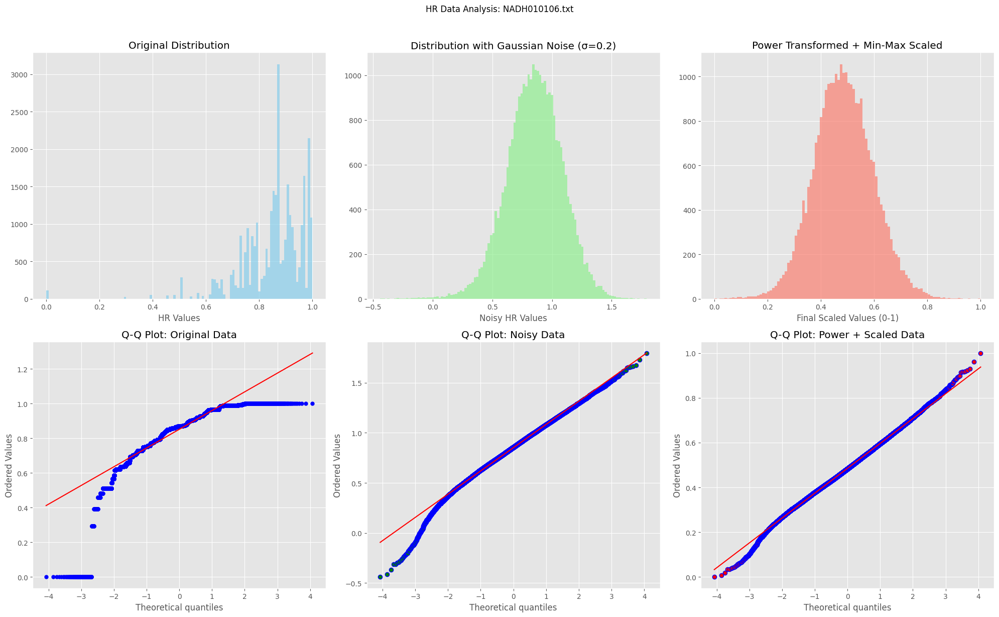

Processing files:  82%|████████████████████████████████████████████████████▌           | 23/28 [02:17<00:30,  6.15s/it]

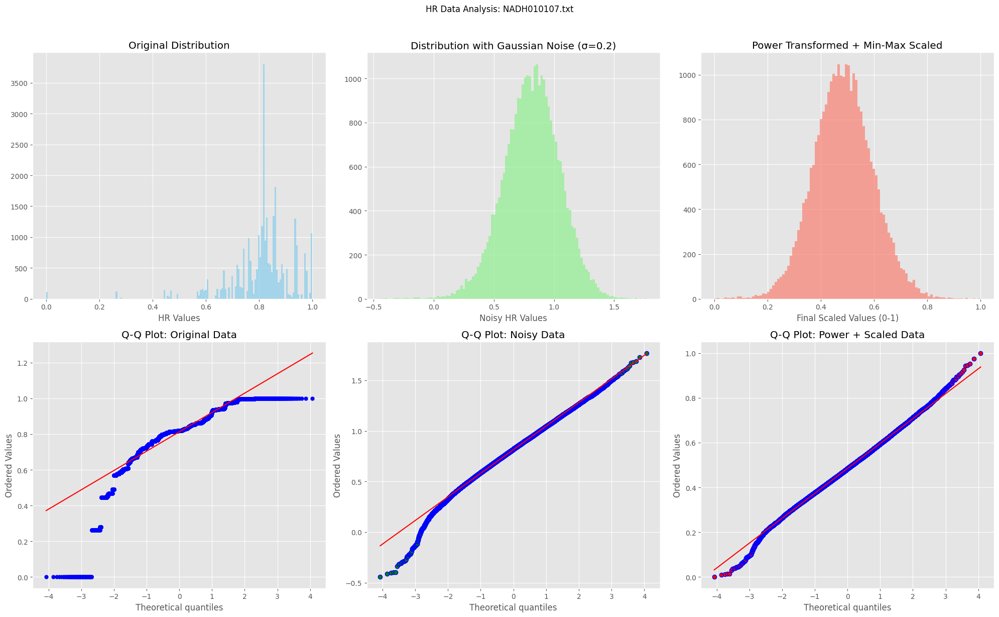

Processing files:  86%|██████████████████████████████████████████████████████▊         | 24/28 [02:23<00:24,  6.11s/it]

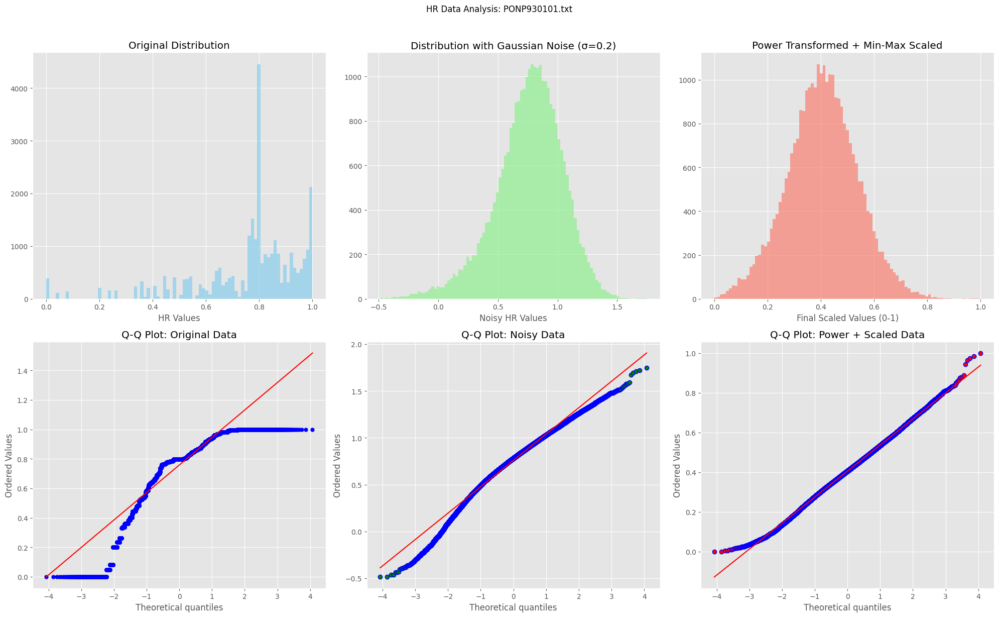

Processing files:  89%|█████████████████████████████████████████████████████████▏      | 25/28 [02:29<00:17,  6.00s/it]

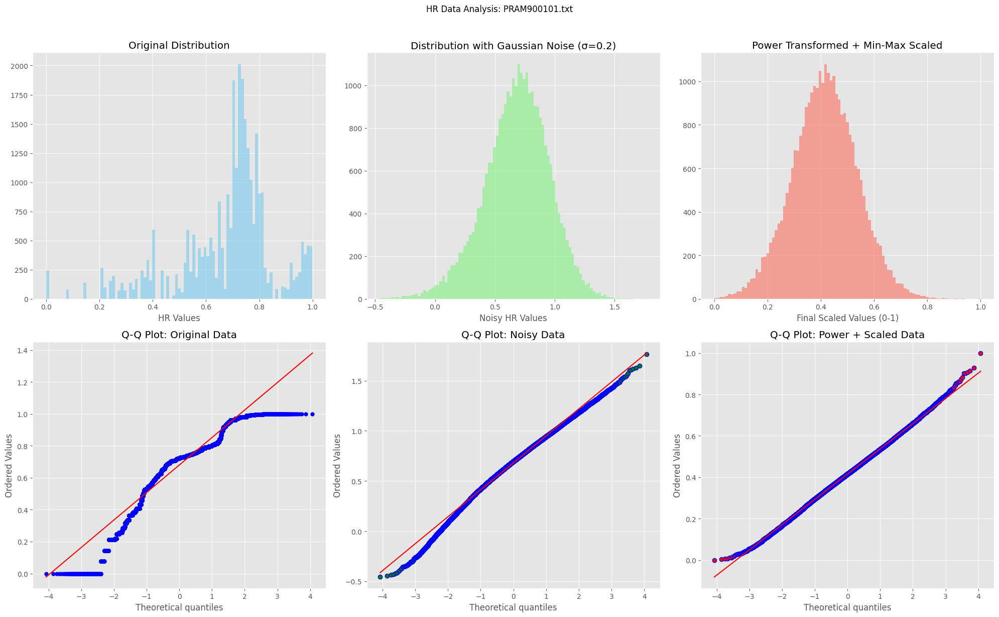

Processing files:  93%|███████████████████████████████████████████████████████████▍    | 26/28 [02:34<00:11,  5.83s/it]

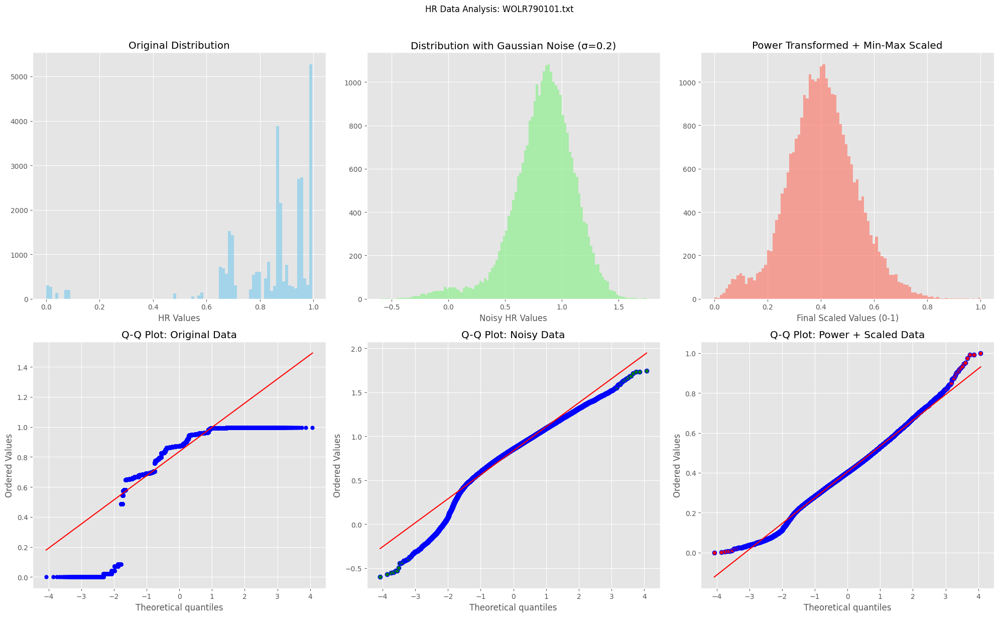

Processing files:  96%|█████████████████████████████████████████████████████████████▋  | 27/28 [02:40<00:05,  5.91s/it]

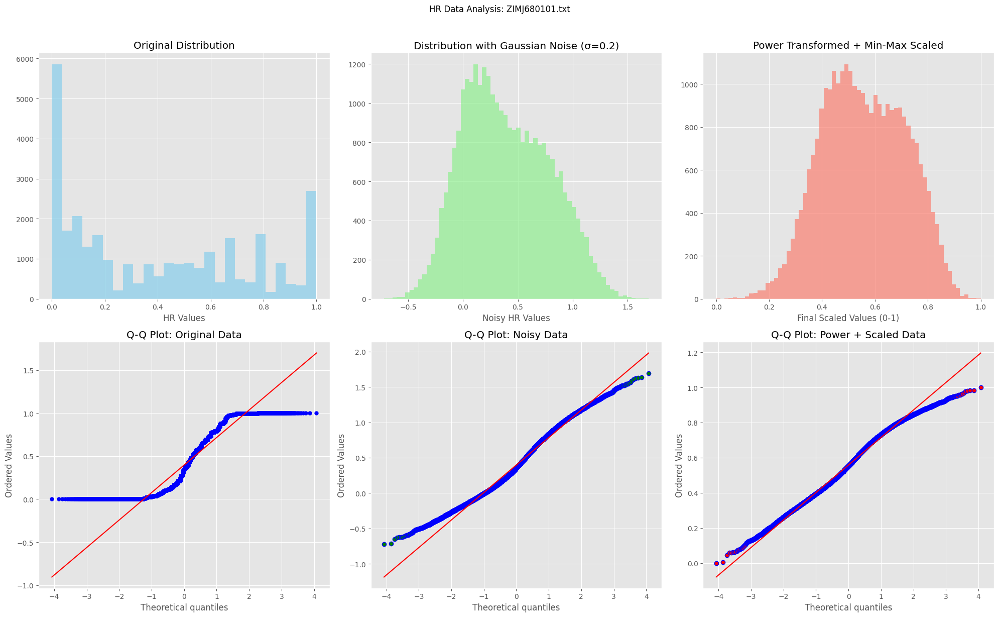

Processing files: 100%|████████████████████████████████████████████████████████████████| 28/28 [02:46<00:00,  5.93s/it]


Analysis complete!


In [5]:
# Directory setup
base_dir = "../generated_data/"
train_hr_dir = os.path.join(base_dir, "train/Hr_modified/") 

# Get all files
def get_file_list(directory):
    return [f for f in os.listdir(directory) if f.endswith('.txt')]

train_files = get_file_list(train_hr_dir)

if not train_files:
    print("No training files found!")
    exit()

print(f"Found {len(train_files)} files to process")

plt.style.use('ggplot')
plt.rcParams['figure.figsize'] = [16, 8]

for file_name in tqdm(sorted(train_files), desc="Processing files"):
    try:
        # Load training data
        train_hr = np.loadtxt(os.path.join(train_hr_dir, file_name))
        original_data = train_hr.ravel()
        
        # Add Gaussian noise
        noisy_data = original_data + np.random.normal(0, 0.2, original_data.shape)
        
        # Apply Power Transformation (Yeo-Johnson handles both +ve and -ve values)
        power_transformer = PowerTransformer(method='yeo-johnson')
        power_data = power_transformer.fit_transform(noisy_data.reshape(-1, 1)).flatten()
        
        # Apply Min-Max scaling
        scaler = MinMaxScaler()
        scaled_data = scaler.fit_transform(power_data.reshape(-1, 1)).flatten()
        
        # Create figure
        fig, ((ax1, ax2, ax3), (ax4, ax5, ax6)) = plt.subplots(2, 3, figsize=(20, 12))
        fig.suptitle(f'HR Data Analysis: {file_name}', y=1.02)
        
        # Original histogram
        ax1.hist(original_data, bins='auto', color='skyblue', alpha=0.7)
        ax1.set_title('Original Distribution')
        ax1.set_xlabel('HR Values')
        
        # Noisy histogram
        ax2.hist(noisy_data, bins='auto', color='lightgreen', alpha=0.7)
        ax2.set_title('Distribution with Gaussian Noise (σ=0.2)')
        ax2.set_xlabel('Noisy HR Values')
        
        # Scaled histogram
        ax3.hist(scaled_data, bins='auto', color='salmon', alpha=0.7)
        ax3.set_title('Power Transformed + Min-Max Scaled')
        ax3.set_xlabel('Final Scaled Values (0-1)')
        
        # Original Q-Q plot
        stats.probplot(original_data, dist="norm", plot=ax4)
        ax4.set_title('Q-Q Plot: Original Data')
        ax4.get_lines()[0].set_markerfacecolor('blue')
        ax4.get_lines()[0].set_markersize(5.0)
        
        # Noisy Q-Q plot
        stats.probplot(noisy_data, dist="norm", plot=ax5)
        ax5.set_title('Q-Q Plot: Noisy Data')
        ax5.get_lines()[0].set_markerfacecolor('green')
        
        # Scaled Q-Q plot
        stats.probplot(scaled_data, dist="norm", plot=ax6)
        ax6.set_title('Q-Q Plot: Power + Scaled Data')
        ax6.get_lines()[0].set_markerfacecolor('red')
        
        plt.tight_layout()
        plt.show()
        
    except Exception as e:
        print(f"\nError processing {file_name}: {str(e)}")
        continue

print("\nAnalysis complete!")


In [5]:
# Directory setup
base_dir = "../generated_data/"
train_hr_dir = os.path.join(base_dir, "train/Hr_modified/")
save_dir = base_dir  # Save plots directly in the base folder

# Get all files
def get_file_list(directory):
    return [f for f in os.listdir(directory) if f.endswith('.txt')]

train_files = get_file_list(train_hr_dir)

if not train_files:
    print("No training files found!")
    exit()

print(f"Found {len(train_files)} files to process")

plt.style.use('ggplot')
plt.rcParams['figure.figsize'] = [16, 8]

for file_name in tqdm(sorted(train_files), desc="Processing files"):
    try:
        # Load training data
        train_hr = np.loadtxt(os.path.join(train_hr_dir, file_name))
        original_data = train_hr.ravel()
        
        # Add Gaussian noise
        noisy_data = original_data + np.random.normal(0, 0.2, original_data.shape)
        
        # Power Transformation
        power_transformer = PowerTransformer(method='yeo-johnson')
        power_data = power_transformer.fit_transform(noisy_data.reshape(-1, 1)).flatten()
        
        # Min-Max Scaling
        scaler = MinMaxScaler()
        scaled_data = scaler.fit_transform(power_data.reshape(-1, 1)).flatten()
        
        # Create figure
        fig, ((ax1, ax2, ax3), (ax4, ax5, ax6)) = plt.subplots(2, 3, figsize=(20, 12))
        fig.suptitle(f'HR Data Analysis: {file_name}', y=1.02)
        
        # Histogram: Original
        ax1.hist(original_data, bins='auto', color='skyblue', alpha=0.7)
        ax1.set_title('Original Distribution')
        ax1.set_xlabel('HR Values')
        
        # Histogram: Noisy
        ax2.hist(noisy_data, bins='auto', color='lightgreen', alpha=0.7)
        ax2.set_title('Distribution with Gaussian Noise (σ=0.2)')
        ax2.set_xlabel('Noisy HR Values')
        
        # Histogram: Scaled
        ax3.hist(scaled_data, bins='auto', color='salmon', alpha=0.7)
        ax3.set_title('Power Transformed + Min-Max Scaled')
        ax3.set_xlabel('Final Scaled Values (0-1)')
        
        # Q-Q: Original
        stats.probplot(original_data, dist="norm", plot=ax4)
        ax4.set_title('Q-Q Plot: Original Data')
        ax4.get_lines()[0].set_markerfacecolor('blue')
        ax4.get_lines()[0].set_markersize(5.0)
        
        # Q-Q: Noisy
        stats.probplot(noisy_data, dist="norm", plot=ax5)
        ax5.set_title('Q-Q Plot: Noisy Data')
        ax5.get_lines()[0].set_markerfacecolor('green')
        
        # Q-Q: Scaled
        stats.probplot(scaled_data, dist="norm", plot=ax6)
        ax6.set_title('Q-Q Plot: Power + Scaled Data')
        ax6.get_lines()[0].set_markerfacecolor('red')
        
        plt.tight_layout()

        # Save figure as PNG in base_dir
        save_path = os.path.join(save_dir, f"{os.path.splitext(file_name)[0]}_preprocessing_analysis.png")
        plt.savefig(save_path, dpi=300)
        plt.close()  # Close the figure to free memory
        
    except Exception as e:
        print(f"\nError processing {file_name}: {str(e)}")
        continue

print("\n✅ Analysis complete! All plots saved in base folder.")


Found 28 files to process


Processing files: 100%|████████████████████████████████████████████████████████████████| 28/28 [04:34<00:00,  9.82s/it]


✅ Analysis complete! All plots saved in base folder.
